# Initial Approach

At first we tried to apply some classification models and in particular we focused on the random forest, which ensured the best F1 score in the previous Work Packages. However, testing it on the dataset we discovered that it was due to a not correct reason. In fact, testing datasets could be biased: if the cross validation is performed taking random data from all the datasets, then some data of a dataset are used to fit the model for data in the same dataset in each folder. 

This phenomenon gives better results than the actual ones, so after fitting the models they have to be tested on the test datasets separately. Doing this we noticed how the model is not able to detect failures, and this is due to the fact that the dataset is highly unbalanced. There are four ways to solve this problem.

First of all we could train the model eliminating some data (both entire datasets or just randomly), but we would lose important information. Then we could use balanced form of models, but in the previous WP this approach didn't provide satisfying results. Then we could add some copies or interpolation data, but it would give more importance to already existing data with no proof of improving in datasets with different kinds of operations. Finally, we could collect more data, but in previous work packages we understood how operation mode are important to predict failures. For example, when transferring goods temperature is very stressed, while in not moving it's not, so this information would be necessary to predict failures. Collecting data with failures for each production mode for all motors could be the most optimazed solution, so we decided to try regression based alghoritms.

In order to better adopt the described methodology, the first step has been the subdivision and classification of the experiments in three categories, with the omologation of these in the testing and training datasets:
- Not moving, when the robot was completely stop;
- Moving one motor, when only one motor has been activated;
- Transfer goods, when the robot was perforing operations through the movement of all the motors.

# Methodology

After obtaining the previous results with classification models we decided to use regression-based models so that we could train the dataset without failures and then test it on datasets with failures. We decided to collect a huge amount of data according to this reason to perform better forecasting in normal conditions. 

However, with this model it is important to verify if the introduction of the window is creating problems in the testing phase. In fact, if the prediction is too based on the previous data, then it would be accurate also in case of abnormal conditions. Additionally, the threshold influences a lot the possible results, so we decided to perform hyperparameter tuning using F1 score as metric for the selection. We trained the model on all datasets without failures for each motor divided by opration mode. The main reason of our chooice is that we believe that the division for operation mode increase a lot performances, since temperature is very affected by movement. We also performed feature selection according to our previous work pakages for each motor. 

Then we tested models on the datasets with at least one failure for each motor dividing per each operation mode. Then we looked at the avarage F1 score selecting the best models. We noticed that having high F1 values is not always correlated with good results looking at the graphs. So we performed also a qualitative analysis to see if high scores where justified looking at the predictions.

In [1]:
# Import libraries

import numpy as np
from numpy import quantile, where, random

import pandas as pd
import random

import matplotlib.pyplot as plt
%matplotlib inline

from scipy.stats import multivariate_normal

from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.metrics import max_error, mean_squared_error, accuracy_score, precision_score, recall_score, f1_score
from sklearn.neighbors import LocalOutlierFactor
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier

from imblearn.over_sampling import SMOTE

from itertools import combinations

import warnings

import sys

sys.path.insert(0, 'C:/Users/gioca/GitHub/projects/maintenance_industry_4_2024/supporting_scripts/WP_4_20240528/')
from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg, read_all_csvs_one_test, run_cv_one_motor, show_reg_result, show_clf_result

In [2]:
# Data preprocessing definition (training)

from scipy.signal import butter, filtfilt

def compensate_seq_bias(df: pd.DataFrame):
    ''' # Description
    Adjust for the sequence-to-sequence bias.
    '''
    # Tranform the features relative to the first data point.
    df['temperature'] = df['temperature'] - df['temperature'].iloc[0]
    df['voltage'] = df['voltage'] - df['voltage'].iloc[0]
    df['position'] = df['position'] - df['position'].iloc[0]

# Function to design a Butterworth low-pass filter
def butter_lowpass(cutoff, fs, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

# Function to apply the Butterworth low-pass filter
def lowpass_filter(data, cutoff_freq, sampling_freq, order=5):
    b, a = butter_lowpass(cutoff_freq, sampling_freq, order=order)
    filtered_data = filtfilt(b, a, data)
    return filtered_data

# Set parameters for the low-pass filter
cutoff_frequency = .5  # Adjust as needed
sampling_frequency = 10  # Assuming your data is evenly spaced in time

def customized_outlier_removal(df: pd.DataFrame):
    ''' # Description
    Remove outliers from the dataframe based on defined valid ranges. 
    Define a valid range of temperature and voltage. 
    Use ffil function to replace the invalid measurement with the previous value.
    '''
    df['position'] = df['position'].where(df['position'] <= 1000, np.nan)
    df['position'] = df['position'].where(df['position'] >= 0, np.nan)
    df['position'] = df['position'].ffill()
    df['position'] = lowpass_filter(df['position'], cutoff_frequency, sampling_frequency)
    df['position'] = df['position'].rolling(window=10, min_periods=1).mean()
    df['position'] = df['position'].round()

    df['temperature'] = df['temperature'].where(df['temperature'] <= 100, np.nan)
    df['temperature'] = df['temperature'].where(df['temperature'] >= 0, np.nan)
    df['temperature'] = df['temperature'].rolling(window=10, min_periods=1).mean()

    # Make sure that the difference between the current and previous temperature cannot be too large.
    # Define your threshold
    threshold = 10
    # Shift the 'temperature' column by one row to get the previous temperature
    prev_tmp = df['temperature'].shift(1)
    # Calculate the absolute difference between current and previous temperature
    temp_diff = np.abs(df['temperature'] - prev_tmp)
    # Set the temperature to NaN where the difference is larger than the threshold
    df.loc[temp_diff > threshold, 'temperature'] = np.nan
    df['temperature'] = df['temperature'].ffill()

    df['voltage'] = df['voltage'].where(df['voltage'] >= 6000, np.nan)
    df['voltage'] = df['voltage'].where(df['voltage'] <= 8000, np.nan)
    df['voltage'] = df['voltage'].ffill()
    df['voltage'] = lowpass_filter(df['voltage'], cutoff_frequency, sampling_frequency)
    df['voltage'] = df['voltage'].rolling(window=5, min_periods=1).mean()

def pre_processing(df: pd.DataFrame):
    ''' ### Description
    Preprocess the data:
    - remove outliers
    - Adjust for the sequence-to-sequence bias.
    - add new features about the difference between the current and previous n data point.
    '''     
    # Start processing.
    customized_outlier_removal(df)
    compensate_seq_bias(df)

from utility import read_all_csvs_one_test
import matplotlib.pyplot as plt
import os

base_dictionary = 'C:/Users/gioca/OneDrive - Politecnico di Milano/POLISSS/CentraleSupelec/Maintenance&I4.0/training_data/'

# Get all the folders in the base_dictionary
path_list = os.listdir(base_dictionary)
# Only keep the folders, not the excel file.
path_list = path_list[:-1]

# Read the data.
df_data_smooth = pd.DataFrame()
for tmp_path in path_list:
    path = base_dictionary + tmp_path
    # Read the data with the customized outlier removal function.
    tmp_df = read_all_csvs_one_test(path, tmp_path, pre_processing)
    df_data_smooth = pd.concat([df_data_smooth, tmp_df])
    df_data_smooth = df_data_smooth.reset_index(drop=True)

# df_data_smooth_tr = df_data_smooth[df_data_smooth['test_condition'].isin(normal_test_id)]

In [3]:
# Finding non-failure conditions

def find_train_conditions_for_motor_x(dataset, motor_number):
    """
    Trova le condizioni di test per le quali, riducendo il dataset, compare almeno un data_motor_x_label = 1.
    
    Args:
    - dataset (pd.DataFrame): Il dataset da analizzare.
    - motor_number (int): Il numero del motore da considerare.
    
    Returns:
    - List: Lista delle test_condition che soddisfano il criterio.
    """
    # Nome della colonna da cercare
    target_column = f'data_motor_{motor_number}_label'
    
    # Trova tutte le condizioni di test uniche
    test_conditions = dataset['test_condition'].unique()
    
    # Lista per memorizzare le condizioni di test valide
    valid_conditions = []
    
    # Verifica ogni condizione di test
    for condition in test_conditions:
        # Filtra il dataset per la condizione di test corrente
        filtered_dataset = dataset[dataset['test_condition'] == condition]
        
        # Verifica se esiste almeno una riga con data_motor_x_label = 1
        if not (filtered_dataset[target_column] == 1).any():
            valid_conditions.append(condition)
    
    return valid_conditions

In [4]:
# Finding failure conditions

def find_test_conditions_for_motor_x(dataset, motor_number):
    """
    Trova le condizioni di test per le quali, riducendo il dataset, compare almeno un data_motor_x_label = 1.
    
    Args:
    - dataset (pd.DataFrame): Il dataset da analizzare.
    - motor_number (int): Il numero del motore da considerare.
    
    Returns:
    - List: Lista delle test_condition che soddisfano il criterio.
    """
    # Nome della colonna da cercare
    target_column = f'data_motor_{motor_number}_label'
    
    # Trova tutte le condizioni di test uniche
    test_conditions = dataset['test_condition'].unique()
    
    # Lista per memorizzare le condizioni di test valide
    valid_conditions = []
    
    # Verifica ogni condizione di test
    for condition in test_conditions:
        # Filtra il dataset per la condizione di test corrente
        filtered_dataset = dataset[dataset['test_condition'] == condition]
        
        # Verifica se esiste almeno una riga con data_motor_x_label = 1
        if (filtered_dataset[target_column] == 1).any():
            valid_conditions.append(condition)
    
    return valid_conditions

In [5]:
# Data reading and pre-processing (training)

# Read the data.
df_tr = pd.DataFrame()
for tmp_path in path_list:
    path = base_dictionary + tmp_path
    # Read the data with the customized outlier removal function.
    tmp_df = read_all_csvs_one_test(path, tmp_path, customized_outlier_removal)
    df_tr = pd.concat([df_tr, tmp_df])
    df_tr = df_tr.reset_index(drop=True)

conditions_path = r'C:/Users/gioca/OneDrive - Politecnico di Milano/POLISSS/CentraleSupelec/Maintenance&I4.0/training_data/Test conditions.xlsx'
conditions = pd.read_excel(conditions_path)
df_merged = df_tr.merge(conditions, how='left', left_on='test_condition', right_on='Test id')
df_tr['operation'] = df_merged['Description']
list_operations = pd.unique(conditions.Description).tolist()

In [6]:
# Data preprocessing definition (testing)

from scipy.signal import butter, filtfilt

def compensate_seq_bias(df: pd.DataFrame):
    ''' # Description
    Adjust for the sequence-to-sequence bias.
    '''
    # Tranform the features relative to the first data point.
    df['temperature'] = df['temperature'] - df['temperature'].iloc[0]
    df['voltage'] = df['voltage'] - df['voltage'].iloc[0]
    df['position'] = df['position'] - df['position'].iloc[0]

# Function to design a Butterworth low-pass filter
def butter_lowpass(cutoff, fs, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

# Function to apply the Butterworth low-pass filter
def lowpass_filter(data, cutoff_freq, sampling_freq, order=5):
    b, a = butter_lowpass(cutoff_freq, sampling_freq, order=order)
    filtered_data = filtfilt(b, a, data)
    return filtered_data

# Set parameters for the low-pass filter
cutoff_frequency = .5  # Adjust as needed
sampling_frequency = 10  # Assuming your data is evenly spaced in time

def customized_outlier_removal(df: pd.DataFrame):
    ''' # Description
    Remove outliers from the dataframe based on defined valid ranges. 
    Define a valid range of temperature and voltage. 
    Use ffil function to replace the invalid measurement with the previous value.
    '''
    df['position'] = df['position'].where(df['position'] <= 1000, np.nan)
    df['position'] = df['position'].where(df['position'] >= 0, np.nan)
    df['position'] = df['position'].ffill()
    df['position'] = lowpass_filter(df['position'], cutoff_frequency, sampling_frequency)
    df['position'] = df['position'].rolling(window=10, min_periods=1).mean()
    df['position'] = df['position'].round()

    df['temperature'] = df['temperature'].where(df['temperature'] <= 100, np.nan)
    df['temperature'] = df['temperature'].where(df['temperature'] >= 0, np.nan)
    df['temperature'] = df['temperature'].rolling(window=10, min_periods=1).mean()

    # Make sure that the difference between the current and previous temperature cannot be too large.
    # Define your threshold
    threshold = 10
    # Shift the 'temperature' column by one row to get the previous temperature
    prev_tmp = df['temperature'].shift(1)
    # Calculate the absolute difference between current and previous temperature
    temp_diff = np.abs(df['temperature'] - prev_tmp)
    # Set the temperature to NaN where the difference is larger than the threshold
    df.loc[temp_diff > threshold, 'temperature'] = np.nan
    df['temperature'] = df['temperature'].ffill()

    df['voltage'] = df['voltage'].where(df['voltage'] >= 6000, np.nan)
    df['voltage'] = df['voltage'].where(df['voltage'] <= 8000, np.nan)
    df['voltage'] = df['voltage'].ffill()
    df['voltage'] = lowpass_filter(df['voltage'], cutoff_frequency, sampling_frequency)
    df['voltage'] = df['voltage'].rolling(window=5, min_periods=1).mean()

def pre_processing(df: pd.DataFrame):
    ''' ### Description
    Preprocess the data:
    - remove outliers
    - Adjust for the sequence-to-sequence bias.
    - add new features about the difference between the current and previous n data point.
    '''     
    # Start processing.
    customized_outlier_removal(df)
    compensate_seq_bias(df)

from utility import read_all_csvs_one_test
import matplotlib.pyplot as plt
import os

base_dictionary = 'C:/Users/gioca/OneDrive - Politecnico di Milano/POLISSS/CentraleSupelec/Maintenance&I4.0/testing_data/'

# Get all the folders in the base_dictionary
path_list = os.listdir(base_dictionary)
# Only keep the folders, not the excel file.
path_list = path_list[:-1]

# Read the data.
df_data_smooth = pd.DataFrame()
for tmp_path in path_list:
    path = base_dictionary + tmp_path
    # Read the data with the customized outlier removal function.
    tmp_df = read_all_csvs_one_test(path, tmp_path, pre_processing)
    df_data_smooth = pd.concat([df_data_smooth, tmp_df])
    df_data_smooth = df_data_smooth.reset_index(drop=True)

# df_data_smooth_tr = df_data_smooth[df_data_smooth['test_condition'].isin(normal_test_id)]

In [7]:
# Data reading and pre-processing (test)

# Read the data.

df_te = pd.DataFrame()
for tmp_path in path_list:
    path = base_dictionary + tmp_path
    # Read the data with the customized outlier removal function.
    tmp_df_test = read_all_csvs_one_test(path, tmp_path, customized_outlier_removal)
    df_te = pd.concat([df_te, tmp_df_test])
    df_te = df_te.reset_index(drop=True)

conditions_path = r'C:/Users/gioca/OneDrive - Politecnico di Milano/POLISSS/CentraleSupelec/Maintenance&I4.0/testing_data/Test conditions.xlsx'
test_conditions = pd.read_excel(conditions_path)
df_merged = df_te.merge(test_conditions, how='left', left_on='test_condition', right_on='Test id')
df_te['operation'] = df_merged['Description']
list_operations = pd.unique(test_conditions.Description).tolist()
list_test_conditions = test_conditions['Test id'].to_list()

In [8]:
# Model function definition

def rbmodel (ds_training, ds_test, features_task, ws, ss, plt, thr, al, testid, motor):
    
    df_tr = ds_training
    x_tr_org, y_temp_tr_org = extract_selected_feature(df_data=df_tr, feature_list=features_task, motor_idx=6, mdl_type='reg')
    x_tr, y_temp_tr = prepare_sliding_window(df_x=x_tr_org, y=y_temp_tr_org, window_size=ws, sample_step=ss, prediction_lead_time=plt, mdl_type='reg')

    # Define the steps of the pipeline
    steps = [
        ('standardizer', StandardScaler()),  # Step 1: StandardScaler
        ('regressor', LinearRegression())    # Step 2: Linear Regression
    ]

    # Create the pipeline
    mdl_linear_regreession = Pipeline(steps)
    # Fit the model
    mdl = mdl_linear_regreession.fit(x_tr, y_temp_tr)

    df_test = ds_test
    detector_reg = FaultDetectReg(reg_mdl=mdl, threshold=thr, abnormal_limit=al, window_size=ws, sample_step=ss, pred_lead_time=plt)

    # Test
    _, y_label_test_org = extract_selected_feature(df_data=df_test, feature_list=features_task, motor_idx=motor, mdl_type='clf')
    x_test_org, y_temp_test_org = extract_selected_feature(df_data=df_test, feature_list=features_task, motor_idx=motor, mdl_type='reg')

    # Predict the temperature 
    detector_reg.threshold = 1
    y_label_pred_tr, y_temp_pred_tr = detector_reg.predict(df_x_test=x_tr_org, y_response_test=y_temp_tr_org)
    y_label_pred_tmp, y_temp_pred_tmp = detector_reg.predict(df_x_test=x_test_org, y_response_test=y_temp_test_org)

    test_id = testid

    # Get the true values.
    _, y_label_test = prepare_sliding_window(df_x=x_test_org, y=y_label_test_org, sequence_name_list=test_id, window_size=ws, sample_step=ss, prediction_lead_time=plt, mdl_type='clf')
    _, y_temp_test_seq = prepare_sliding_window(df_x=x_test_org, y=y_temp_test_org, sequence_name_list=test_id, window_size=ws, sample_step=ss, prediction_lead_time=plt, mdl_type='reg')


    show_reg_result(y_tr=y_temp_tr, y_test=y_temp_test_seq, y_pred_tr=y_temp_pred_tr, y_pred=y_temp_pred_tmp, threshold=detector_reg.threshold)
    # show_clf_result(y_tr=np.zeros(len(y_label_pred_tr)), y_test=y_label_test, y_pred_tr=y_label_pred_tr, y_pred=y_label_pred_tmp)

    n_fold = len(test_id)
    _, y_label_test_org = extract_selected_feature(df_data=df_test, feature_list=features_task,  motor_idx=motor, mdl_type='clf')
    x_test_org, y_temp_test_org = extract_selected_feature(df_data=df_test, feature_list=features_task, motor_idx=motor, mdl_type='reg')

    # Run cross validation.
    # if(n_fold>1):
        # df_perf = detector_reg.run_cross_val(df_x=x_test_org, y_label=y_label_test_org, y_response=y_temp_test_org, n_fold=n_fold, single_run_result=False)
        # print(df_perf)
        # print('\n')
        # Print the mean performance and standard error.
        # print('Mean performance metric and standard error:')
        # for name, metric, error in zip(df_perf.columns, df_perf.mean(), df_perf.std()):
            # print(f'{name}: {metric:.4f} +- {error:.4f}') 
        # print('\n')

    return y_label_pred_tmp

import warnings
warnings.filterwarnings('ignore')

In [7]:
# Hyper parameter tuning

parameters = [ [ 25, 5, 1],
    [ 12,  4,  1    ],
    [ 10, 10,  1    ],
    [ 16,  8,  0.15 ],
    [ 16,  8,  0.5  ],
    [ 10,  5,  0.5  ],
    [ 20, 10,  0.2  ],
    [ 20, 10,  0.5  ],
    [ 50, 10,  1    ],
    [100, 50,  1    ],
    [  6,  3,  1    ],
    [  6,  3,  0.5  ],
    [ 10,  3,  0.15 ],
    [ 20,  5,  0.5  ],
    [ 20,  5,  0.15 ]
]

all_f1 = {}

for i in range(len(parameters)):

    print('Iterazione: ', i+1)

    df_pred_dict = {}
    f1_scores = []

    fin, camp, sog = parameters[i]

    for motor_number in range(1, 7):
        print("Motor ", motor_number)

        # Inizializzazione di all_results
        all_results = []

        # Trova le condizioni di test valide per il motore corrente
        train_conditions = find_train_conditions_for_motor_x(df_tr, motor_number)
        test_conditions = find_test_conditions_for_motor_x(df_tr, motor_number)

        df_train_motor = df_tr[df_tr['test_condition'].isin(train_conditions)]
        df_test_motor = df_tr[df_tr['test_condition'].isin(test_conditions)]

        df_pred = pd.DataFrame(columns=['time', f'data_motor_{motor_number}_label', 'test_condition'])
        df_pred['time'] = df_test_motor['time']
        df_pred['test_condition'] = df_test_motor['test_condition']

        for operation in list_operations:

            print("Operation: ", operation)

            df_train = df_train_motor[df_train_motor['operation']==operation]
            df_test = df_test_motor[df_test_motor['operation']==operation]

            features_x = [f'data_motor_{motor_number}_position', f'data_motor_{motor_number}_voltage']

            tests = pd.unique(df_test.test_condition).tolist()
            print(tests)

            if(len(tests)!=0):
                results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=fin, ss=camp, plt=1, thr=sog, al=3, testid=tests, motor=motor_number)

            # Aggiungiamo il tempo ai risultati
            results_with_time = [(time, result) for time, result in zip(df_test['time'], results)]
            
            # Concateniamo i risultati a all_results
            all_results.extend(results_with_time)

        # Inseriamo i valori di all_results nella colonna corrispondente di df_pred
        for time, result in all_results:
            df_pred.loc[df_pred['time'] == time, f'data_motor_{motor_number}_label'] = result

        # Dove non c'è corrispondenza, inseriamo 0
        df_pred[f'data_motor_{motor_number}_label'].fillna(0, inplace=True)

        y_true = df_test_motor[f'data_motor_{motor_number}_label']
        y_pred = df_pred[f'data_motor_{motor_number}_label']
        
        # Calcola l'F1 score
        score = f1_score(y_true, y_pred)
        
        # Aggiungi il risultato al vettore
        f1_scores.append(score)

    all_f1[i] = f1_scores

    print(f'Il modello utilizzato è: ws = {fin}, ss = {camp}, thr = {sog}')
    print('I risultati f1 score sono: ', f1_scores)

f1scores = pd.DataFrame.from_dict(all_f1, orient='index')

# Assegnazione dei nomi delle colonne
f1scores.columns = ['motor 1', 'motor 2', 'motor 3', 'motor 4', 'motor 5', 'motor 6']

Iterazione:  1
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.28s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:15<00:00,  7.69s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:07<00:00,  7.43s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.43s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:16<00:00,  8.27s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.68s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:16<00:00,  8.02s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.62s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:14<00:00,  7.25s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:14<00:00,  7.14s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.19it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:15<00:00,  5.32s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.11it/s]


Il modello utilizzato è: ws = 25, ss = 5, thr = 1
I risultati f1 score sono:  [0.011440457618304733, 0.015596087761036213, 0.0, 0.015782105129184168, 0.0, 0.10534069981583795]
Iterazione:  2
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.18s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:15<00:00,  7.61s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:09<00:00,  9.50s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.84s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:15<00:00,  7.94s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.78s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:15<00:00,  7.81s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:14<00:00,  7.49s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:16<00:00,  8.32s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.15it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:16<00:00,  5.61s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.01it/s]


Il modello utilizzato è: ws = 12, ss = 4, thr = 1
I risultati f1 score sono:  [0.016260162601626018, 0.00804103701649799, 0.0, 0.012135295636457526, 0.0, 0.035142522452167126]
Iterazione:  3
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.19s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:15<00:00,  7.62s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:07<00:00,  7.02s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.66s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:15<00:00,  7.88s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.57s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:15<00:00,  7.63s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.50s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:14<00:00,  7.22s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.59s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:15<00:00,  7.56s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.22it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:17<00:00,  5.96s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.04it/s]


Il modello utilizzato è: ws = 10, ss = 10, thr = 1
I risultati f1 score sono:  [0.30046430377419203, 0.7906738697753768, 0.08248257980878301, 0.7885906040268456, 0.13643480205770522, 0.28147672552166936]
Iterazione:  4
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.01s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.75s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.11s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.65s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.58s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.46s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.28s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.67s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:01<00:00,  1.51it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.76s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.30it/s]


Il modello utilizzato è: ws = 16, ss = 8, thr = 0.15
I risultati f1 score sono:  [0.3590923617769255, 0.7335507161989053, 0.09909099990010989, 0.6304203686513725, 0.14541053807484638, 0.3225472813238771]
Iterazione:  5
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:01<00:00,  1.01it/s]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.56s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:05<00:00,  5.94s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.87s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:15<00:00,  7.73s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:14<00:00,  7.15s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:14<00:00,  7.13s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.67s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.42it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.97s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.00it/s]


Il modello utilizzato è: ws = 16, ss = 8, thr = 0.5
I risultati f1 score sono:  [0.40039725233799556, 0.7109047526923326, 0.10897435897435896, 0.5178003108578195, 0.1311212814645309, 0.3402216795040391]
Iterazione:  6
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.02s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.52s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.17s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.51s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.99s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.44s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.61s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.28it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.78s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.16it/s]


Il modello utilizzato è: ws = 10, ss = 5, thr = 0.5
I risultati f1 score sono:  [0.42983498349834987, 0.5081585081585083, 0.09393414211438475, 0.4098834662227285, 0.09473335541570058, 0.5286500967405864]
Iterazione:  7
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.02s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.60s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.18s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.67s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.65s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.57s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.72s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.49it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.86s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.20it/s]


Il modello utilizzato è: ws = 20, ss = 10, thr = 0.2
I risultati f1 score sono:  [0.3677136012776151, 0.7405535499398315, 0.10052576235541535, 0.6154869611495477, 0.1423019985196151, 0.32634499768768305]
Iterazione:  8
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.26s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.68s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.10s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.71s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.62s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.42s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.62s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.68s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.43it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.92s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.30it/s]


Il modello utilizzato è: ws = 20, ss = 10, thr = 0.5
I risultati f1 score sono:  [0.3948875425346502, 0.7088446620461626, 0.10422070266446593, 0.5310420475319927, 0.125, 0.3173873045078197]
Iterazione:  9
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:01<00:00,  1.14it/s]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.40s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.04s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.36s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.14s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.39s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.18s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.37s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.33s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:01<00:00,  1.59it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.73s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.37it/s]


Il modello utilizzato è: ws = 50, ss = 10, thr = 1
I risultati f1 score sono:  [0.19058098591549297, 0.07227969097813276, 0.044851258581235696, 0.0790946992257296, 0.1111821086261981, 0.3338330834582709]
Iterazione:  10
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:01<00:00,  1.05it/s]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.35s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.18s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.42s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.42s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.05s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.38s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.45s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:01<00:00,  1.67it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:13<00:00,  4.65s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.35it/s]


Il modello utilizzato è: ws = 100, ss = 50, thr = 1
I risultati f1 score sono:  [0.35729455971246527, 0.3307367433129986, 0.0840418574231524, 0.30392156862745096, 0.10844661677104017, 0.3165795469776169]
Iterazione:  11
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.01s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.39s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.02s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.36s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.30s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.19s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.38s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.31s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.43it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.79s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.28it/s]


Il modello utilizzato è: ws = 6, ss = 3, thr = 1
I risultati f1 score sono:  [0.007198560287942413, 0.006803685329553509, 0.0, 0.006871943967226114, 0.0, 0.01434834595456357]
Iterazione:  12
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.02s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.31s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.05s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.27s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.13s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.52s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.64s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.30s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.38s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.44it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.72s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.31it/s]


Il modello utilizzato è: ws = 6, ss = 3, thr = 0.5
I risultati f1 score sono:  [0.07413743940690048, 0.019975372828020248, 0.11153358681875793, 0.031492063492063495, 0.07773109243697478, 0.43102977328598746]
Iterazione:  13
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.04s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.79s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.55s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.32s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.84s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.81s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.81s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.79s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.46it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:15<00:00,  5.05s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.24it/s]


Il modello utilizzato è: ws = 10, ss = 3, thr = 0.15
I risultati f1 score sono:  [0.3510408770190682, 0.7351469488698453, 0.08837168606177269, 0.7130675270799723, 0.14665266898166843, 0.31860756692971465]
Iterazione:  14
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.03s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.98s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.14s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.42s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.47s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.58s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.54s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:12<00:00,  6.44s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:03<00:00,  1.02s/it]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.83s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.21it/s]


Il modello utilizzato è: ws = 20, ss = 5, thr = 0.5
I risultati f1 score sono:  [0.4362880886426593, 0.17054263565891473, 0.09547813194959229, 0.488603636962067, 0.1530330882352941, 0.48019323671497577]
Iterazione:  15
Motor  1
Operation:  Not moving
['20240426_140055', '20240524_094877']


100%|██████████| 2/2 [00:02<00:00,  1.10s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.93s/it]


Operation:  Moving one motor
['20240524_100052']


100%|██████████| 1/1 [00:06<00:00,  6.27s/it]


Motor  2
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.78s/it]


Operation:  Moving one motor
[]
Motor  3
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.81s/it]


Operation:  Moving one motor
[]
Motor  4
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.68s/it]


Operation:  Moving one motor
[]
Motor  5
Operation:  Not moving
['20240426_140055']


100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


Operation:  Transfer goods
['20240325_155003', '20240524_110994']


100%|██████████| 2/2 [00:13<00:00,  6.87s/it]


Operation:  Moving one motor
[]
Motor  6
Operation:  Not moving
['20240425_093699', '20240425_094425', '20240426_140055']


100%|██████████| 3/3 [00:02<00:00,  1.48it/s]


Operation:  Transfer goods
['20240325_155003', '20240503_163963', '20240524_110994']


100%|██████████| 3/3 [00:14<00:00,  4.98s/it]


Operation:  Moving one motor
['20240503_164675', '20240503_165189']


100%|██████████| 2/2 [00:01<00:00,  1.27it/s]


Il modello utilizzato è: ws = 20, ss = 5, thr = 0.15
I risultati f1 score sono:  [0.3446905167518456, 0.7606660312832875, 0.08816075307748009, 0.6686926468835658, 0.14802065404475045, 0.34306241580601704]


Motor  1
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:09<00:00,  3.25s/it]



 New run:

training performance, max error is: 8.355014261407735
training performance, mean root square error is: 1.0092372641166392
training performance, residual error > 1: 19.03674960054782%

 New run:

testing performance, max error is: 7.348249999724537
testing performance, mean root square error is: 1.681138603767784
testing performance, residual error > 1: 32.64490339773484%


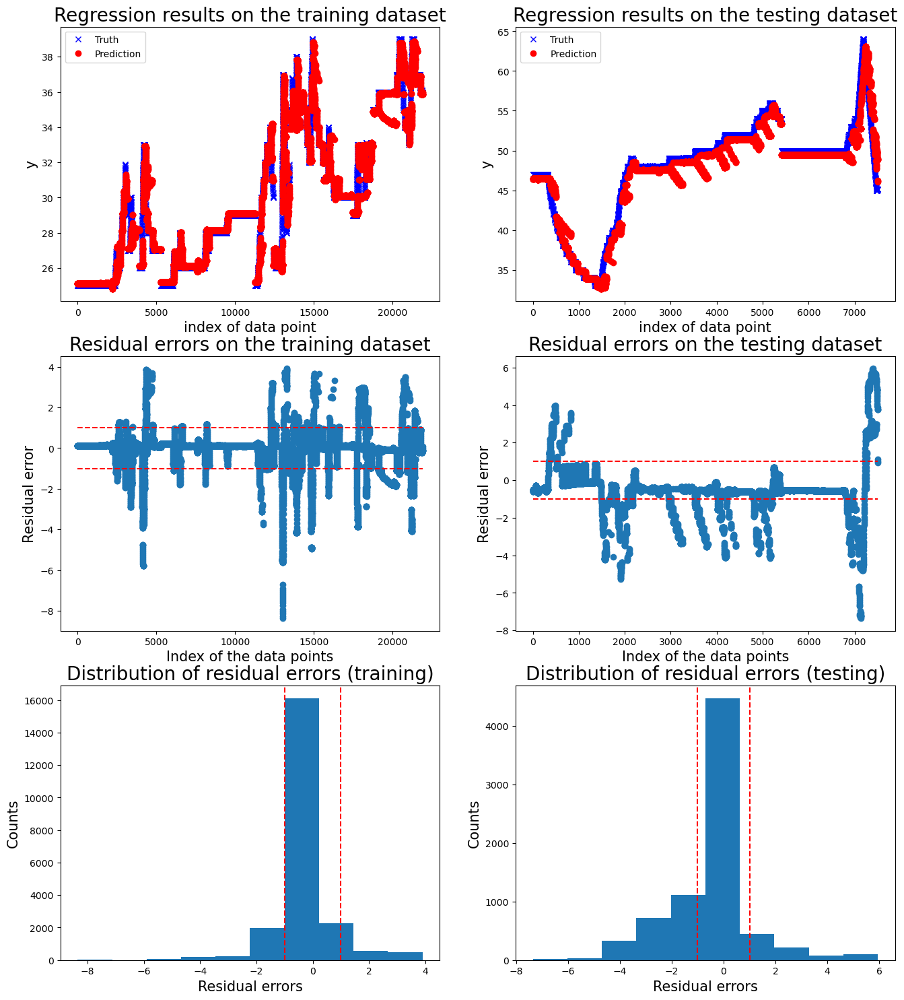

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:03<00:00,  1.31s/it]



 New run:

training performance, max error is: 8.749130876415279
training performance, mean root square error is: 0.6865298780723554
training performance, residual error > 1: 4.234073844724824%

 New run:

testing performance, max error is: 2.231843220668651
testing performance, mean root square error is: 0.4751724289425286
testing performance, residual error > 1: 0.877742946708464%


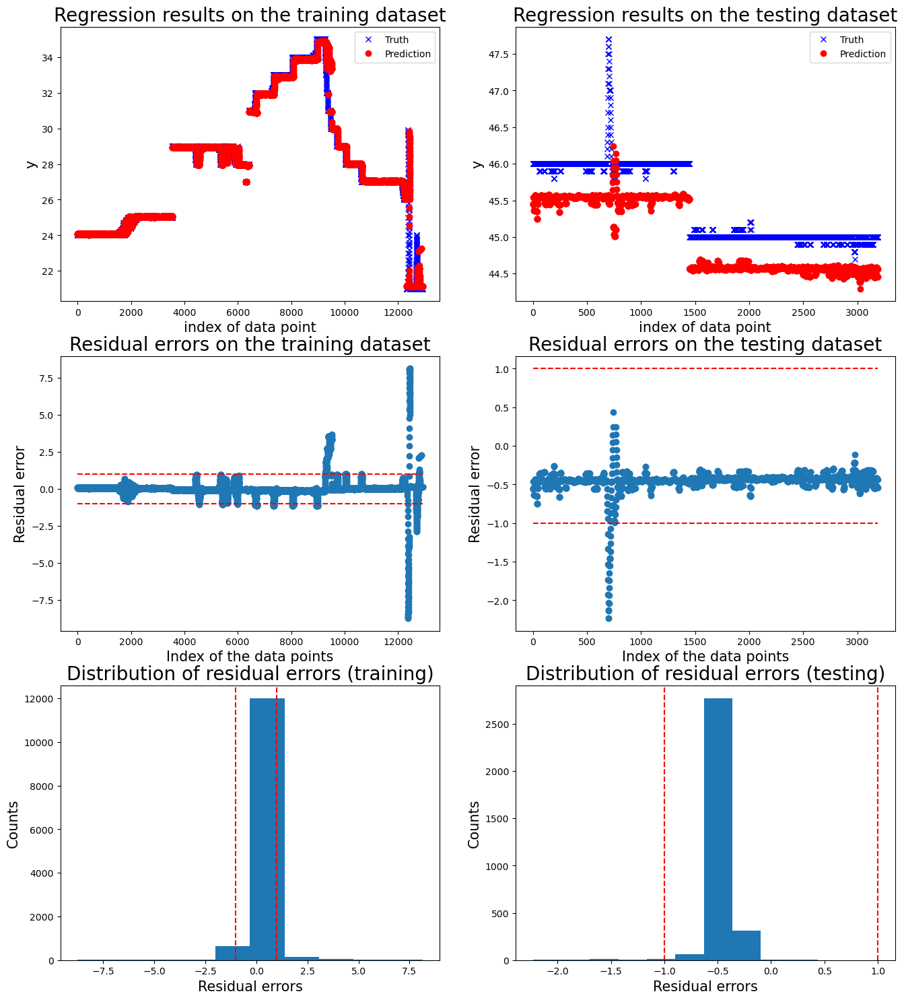

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:03<00:00,  1.62s/it]



 New run:

training performance, max error is: 7.710076608333242
training performance, mean root square error is: 1.0295371452524746
training performance, residual error > 1: 14.723584485064645%

 New run:

testing performance, max error is: 8.441750375168482
testing performance, mean root square error is: 1.7544283633063376
testing performance, residual error > 1: 40.48689138576779%


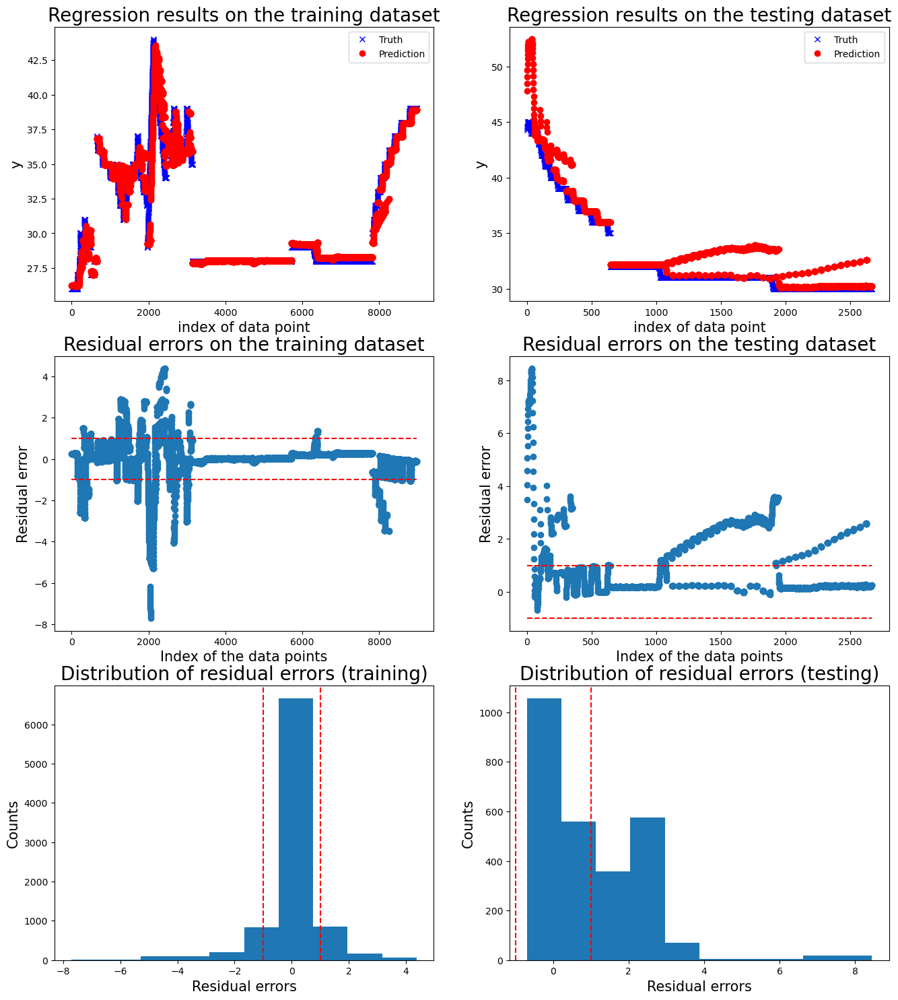

Motor  2
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:09<00:00,  3.26s/it]



 New run:

training performance, max error is: 8.374472033828717
training performance, mean root square error is: 0.9603601472274272
training performance, residual error > 1: 14.836795252225517%

 New run:

testing performance, max error is: 1.0747715343784492
testing performance, mean root square error is: 0.300546652212898
testing performance, residual error > 1: 1.8121252498334444%


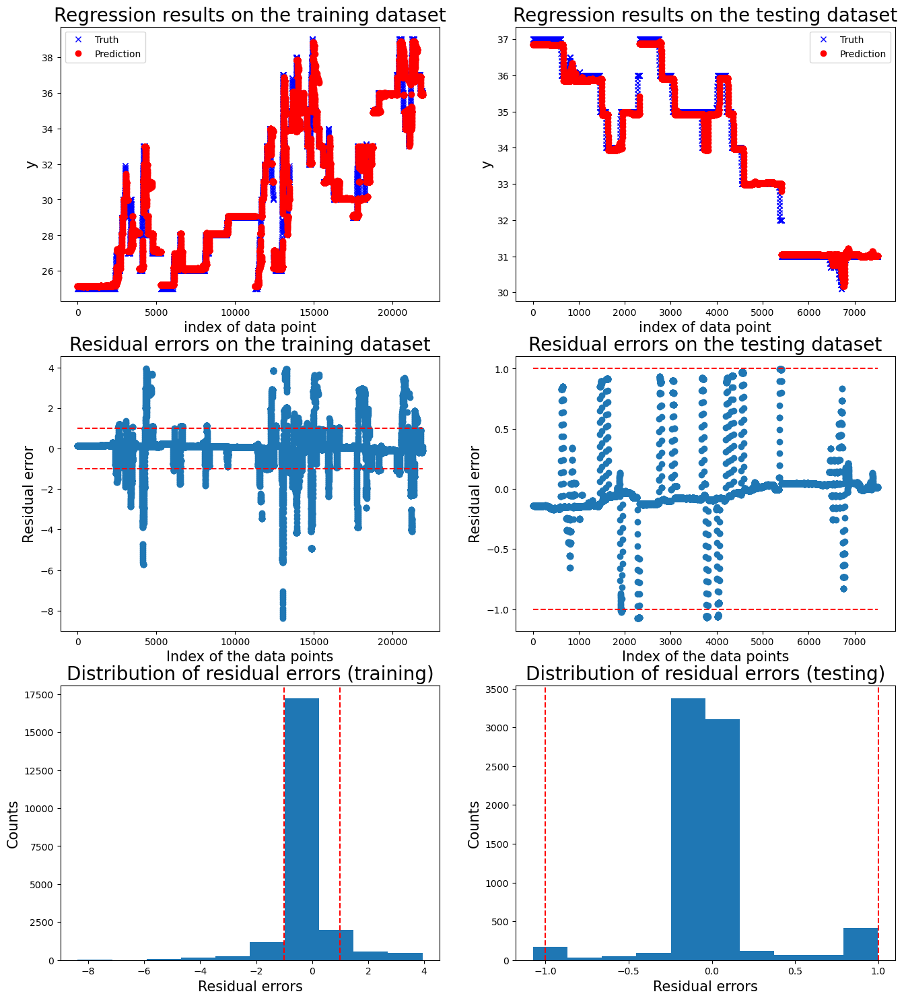

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:03<00:00,  1.31s/it]



 New run:

training performance, max error is: 8.708641301494868
training performance, mean root square error is: 0.6694687303142034
training performance, residual error > 1: 4.269880235066577%

 New run:

testing performance, max error is: 8.97140920461538
testing performance, mean root square error is: 0.9104110936038503
testing performance, residual error > 1: 4.545454545454546%


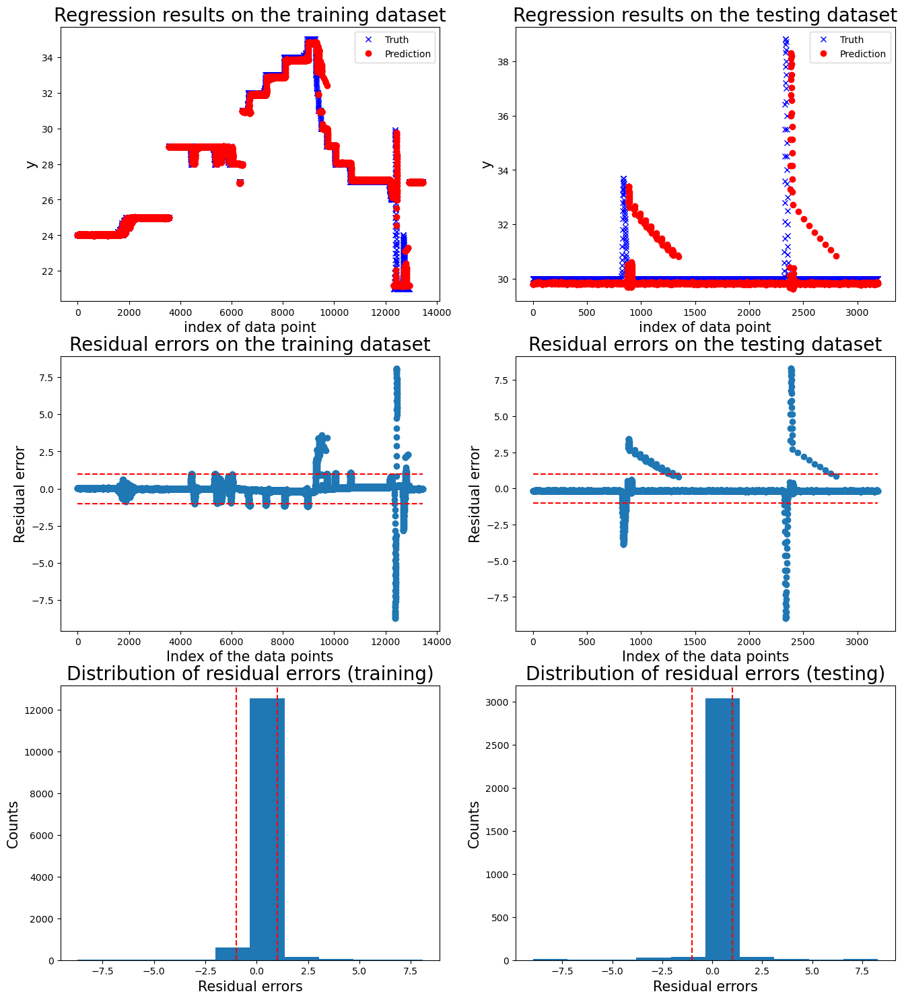

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:03<00:00,  1.66s/it]



 New run:

training performance, max error is: 7.891886470123897
training performance, mean root square error is: 0.8218483533011849
training performance, residual error > 1.495366492238331: 5.436688881094353%

 New run:

testing performance, max error is: 11.951484070833356
testing performance, mean root square error is: 1.6268198665295268
testing performance, residual error > 1.495366492238331: 9.288389513108614%


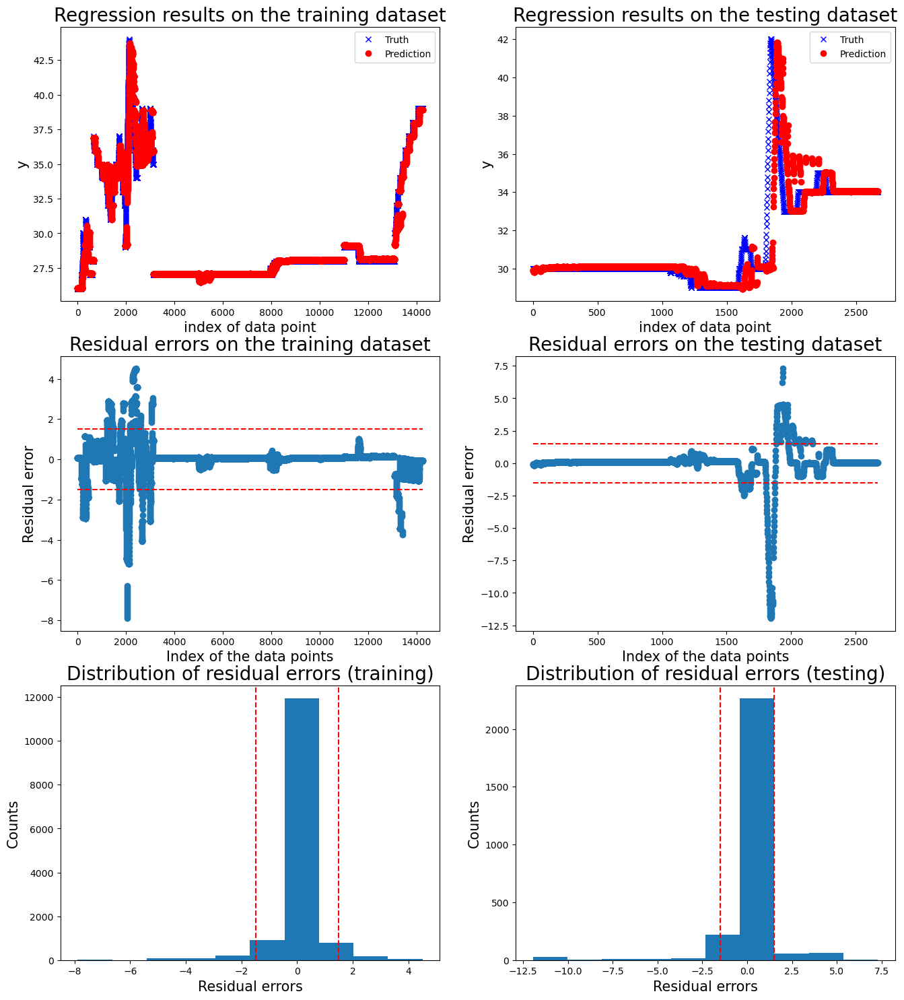

Motor  3
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:09<00:00,  3.20s/it]



 New run:

training performance, max error is: 8.359532595268742
training performance, mean root square error is: 1.0203892515980506
training performance, residual error > 1.117352787006024: 14.973750285322984%

 New run:

testing performance, max error is: 6.434566692437556
testing performance, mean root square error is: 1.4114411044504847
testing performance, residual error > 1.117352787006024: 25.436375749500336%


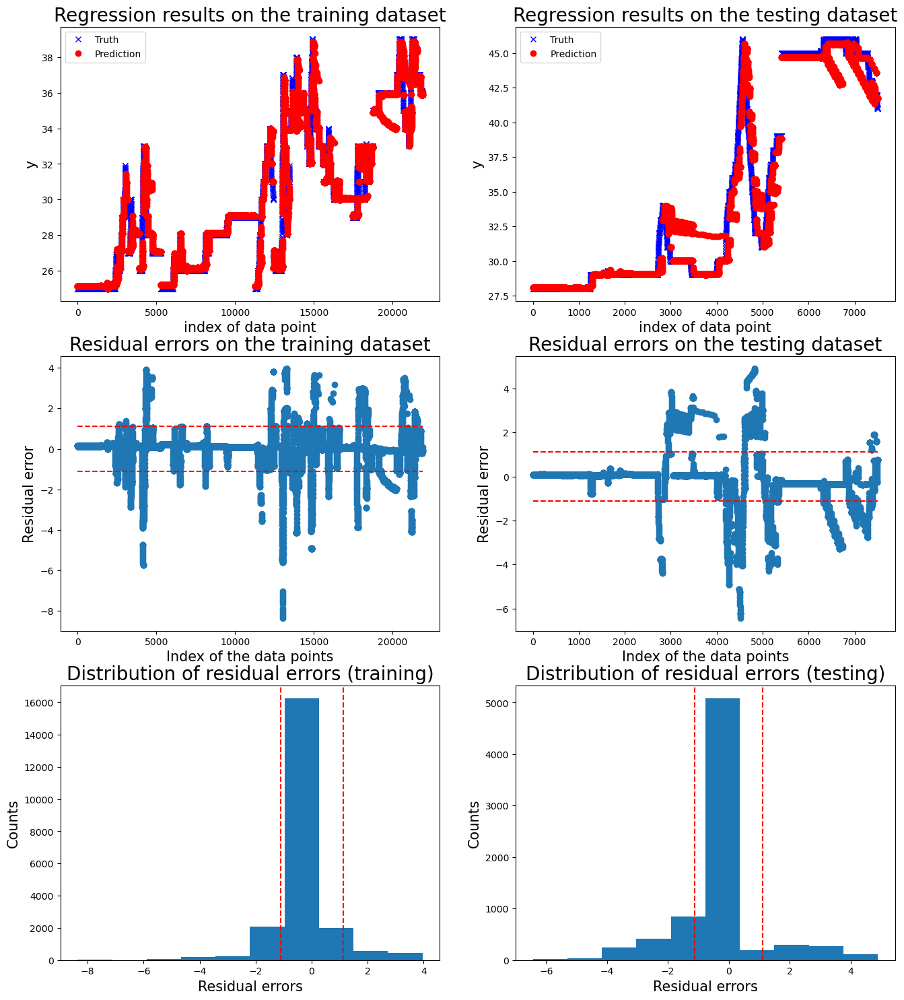

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:03<00:00,  1.32s/it]



 New run:

training performance, max error is: 8.753868835668204
training performance, mean root square error is: 0.6724822152492242
training performance, residual error > 1: 3.9202558952614743%

 New run:

testing performance, max error is: 5.161628306725554
testing performance, mean root square error is: 0.44847361940909086
testing performance, residual error > 1: 1.4106583072100314%


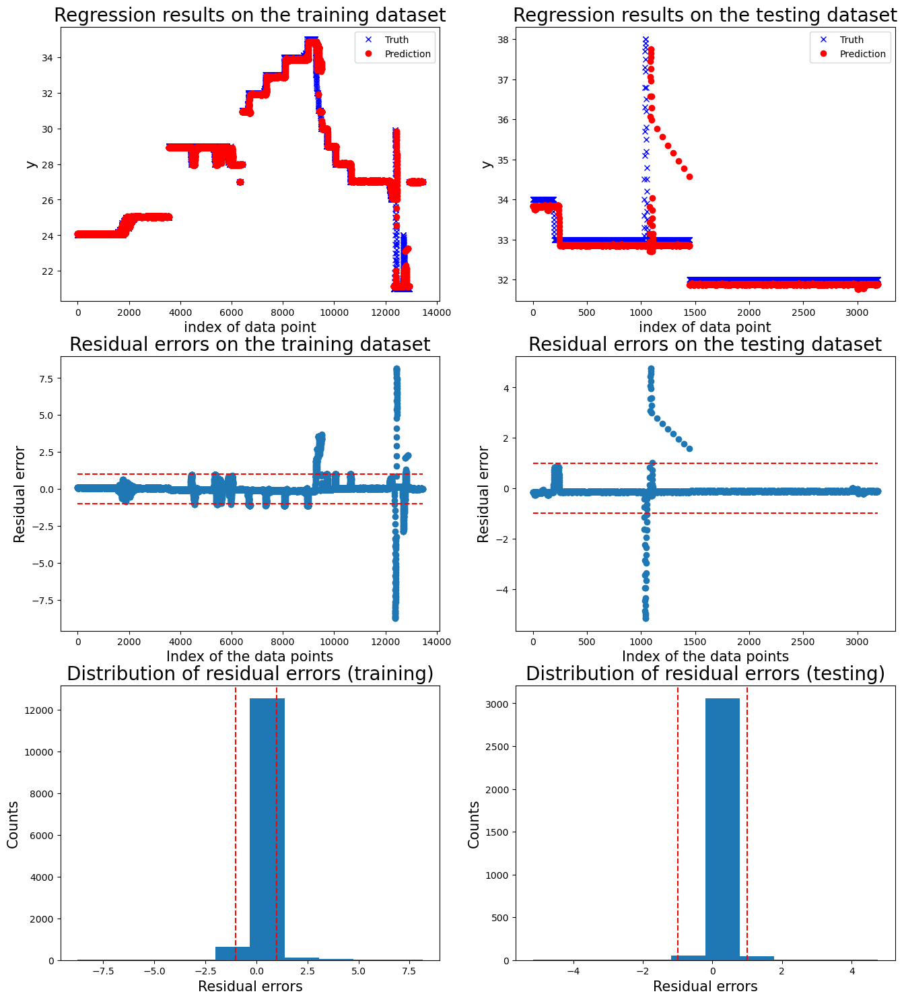

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:03<00:00,  1.67s/it]



 New run:

training performance, max error is: 7.820195580449262
training performance, mean root square error is: 0.8177157910107686
training performance, residual error > 1: 9.266923886355665%

 New run:

testing performance, max error is: 2.075481496005459
testing performance, mean root square error is: 0.27474086898928335
testing performance, residual error > 1: 3.033707865168539%


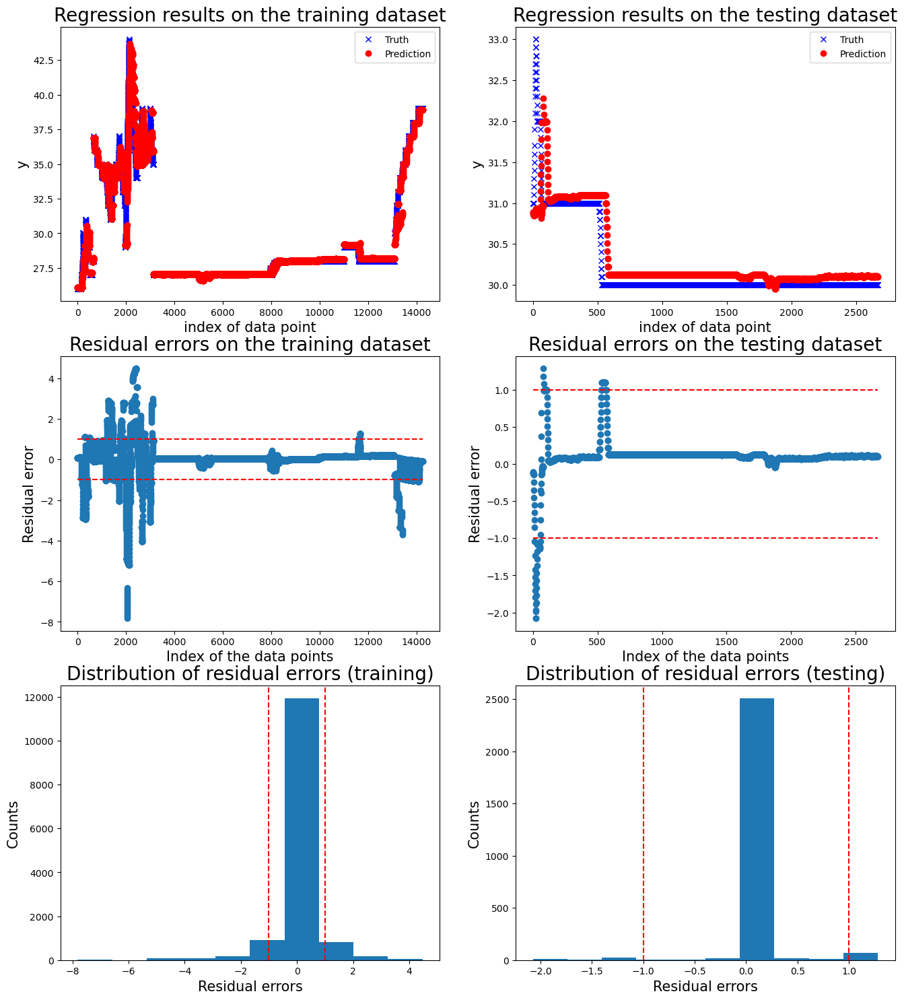

Motor  4
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:09<00:00,  3.24s/it]



 New run:

training performance, max error is: 8.230556115949838
training performance, mean root square error is: 0.9658236392238632
training performance, residual error > 1.4938857709367088: 9.249029901848893%

 New run:

testing performance, max error is: 7.649023659316754
testing performance, mean root square error is: 1.2498624590701788
testing performance, residual error > 1.4938857709367088: 18.334443704197202%


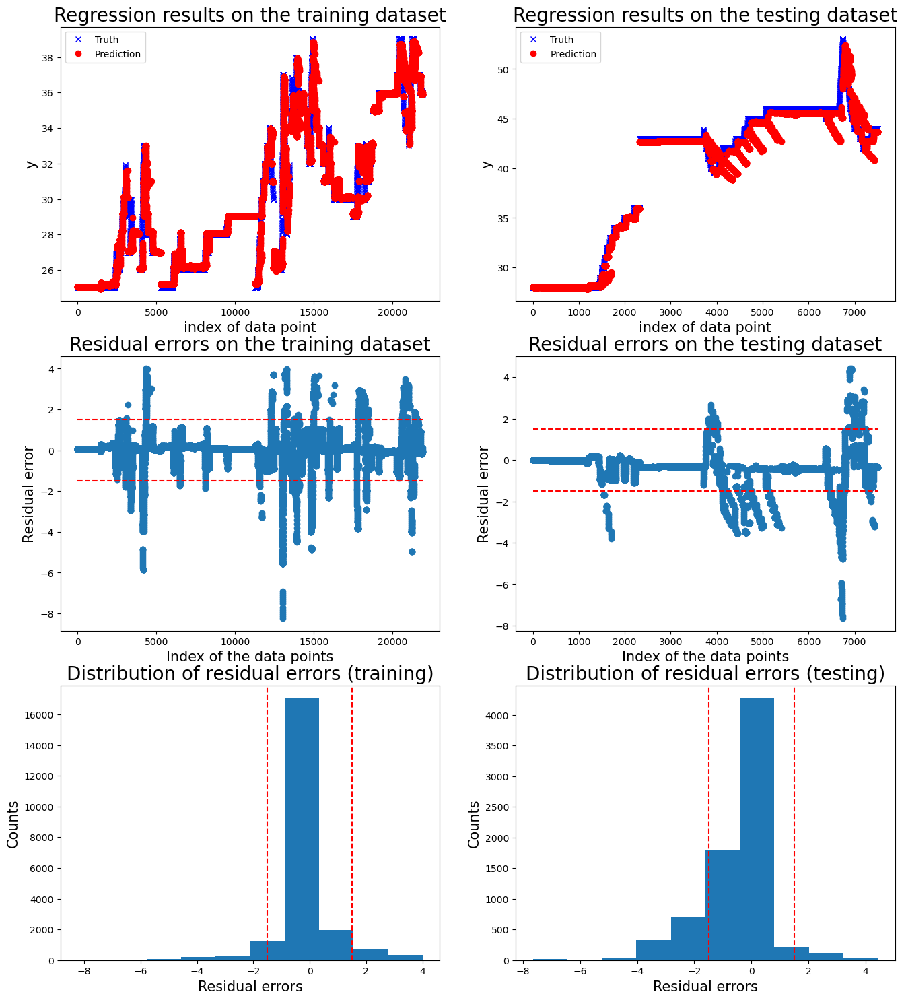

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:04<00:00,  1.34s/it]



 New run:

training performance, max error is: 8.751021057586755
training performance, mean root square error is: 0.6716903792974683
training performance, residual error > 1: 4.210369709142305%

 New run:

testing performance, max error is: 10.460331427076873
testing performance, mean root square error is: 1.2535886555904736
testing performance, residual error > 1: 4.545454545454546%


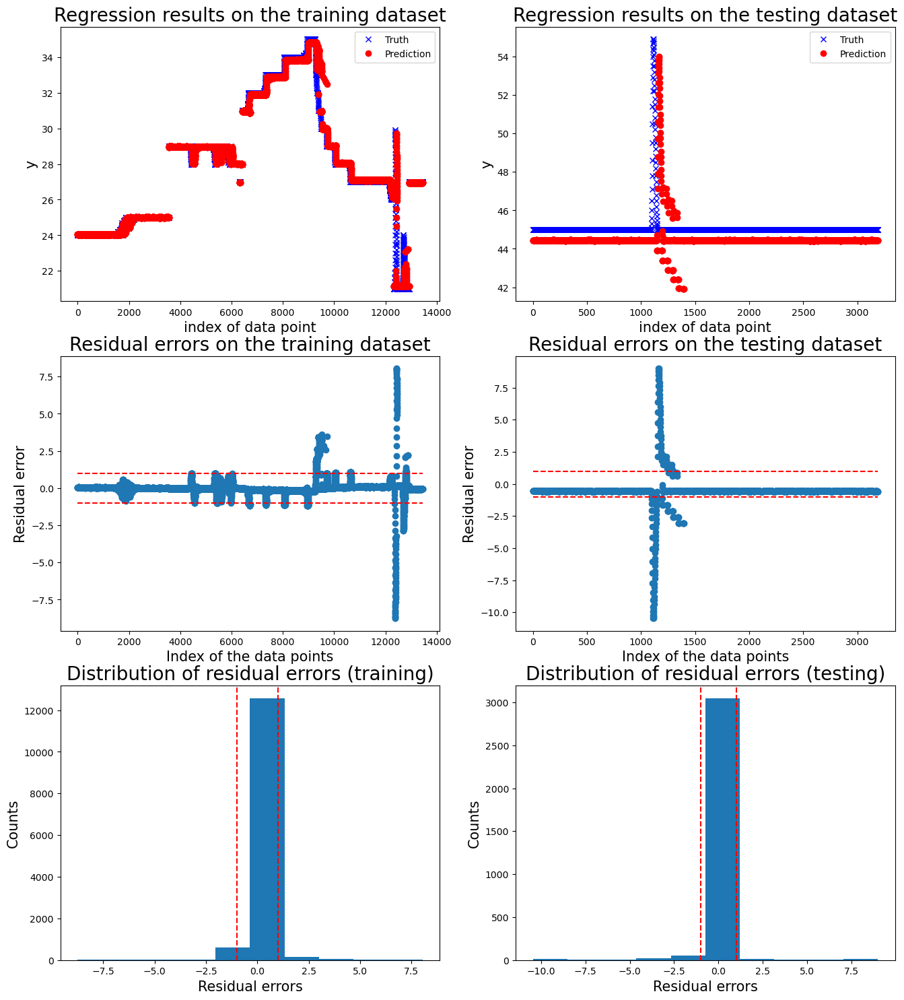

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:03<00:00,  1.91s/it]



 New run:

training performance, max error is: 7.803061959104362
training performance, mean root square error is: 0.8133631875470227
training performance, residual error > 1.4990504390017623: 5.415643633812698%

 New run:

testing performance, max error is: 3.21672841001768
testing performance, mean root square error is: 0.48975737880656894
testing performance, residual error > 1.4990504390017623: 2.0599250936329585%


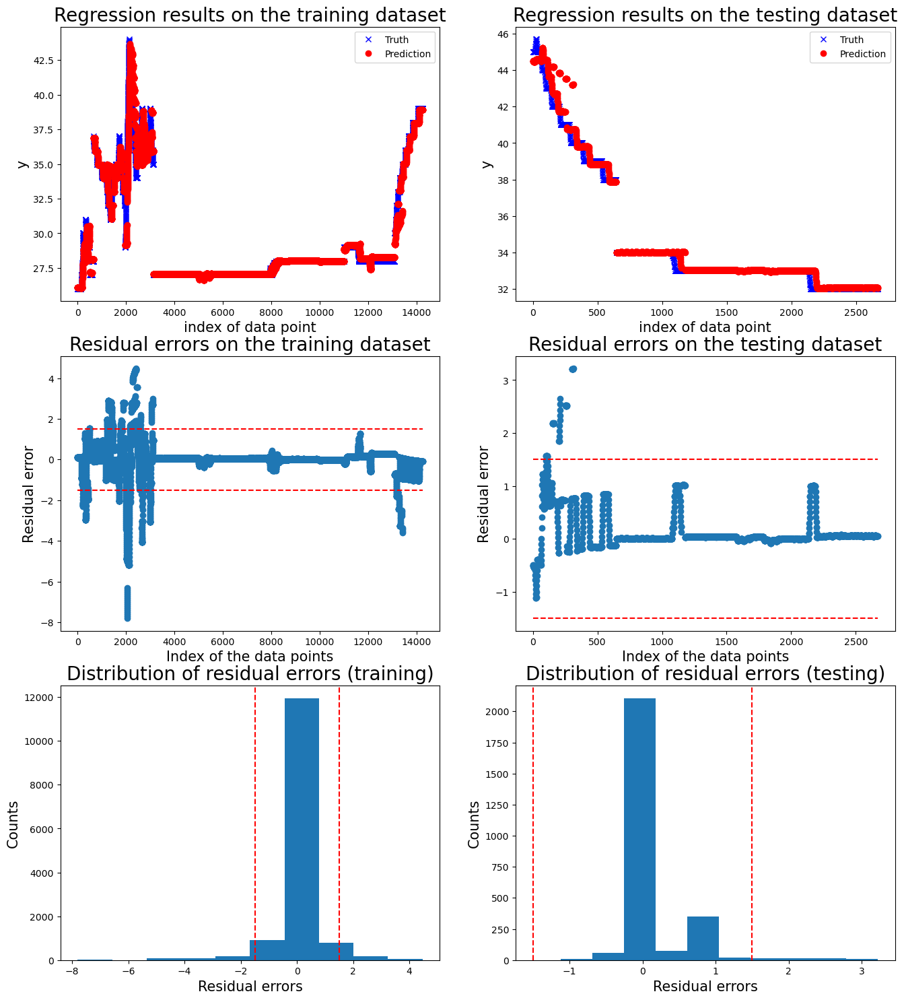

Motor  5
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:09<00:00,  3.20s/it]



 New run:

training performance, max error is: 8.28925787338649
training performance, mean root square error is: 1.0228242485700099
training performance, residual error > 1.4924463383305957: 12.371604656471126%

 New run:

testing performance, max error is: 14.369945725049654
testing performance, mean root square error is: 1.440807727838992
testing performance, residual error > 1.4924463383305957: 11.578947368421053%


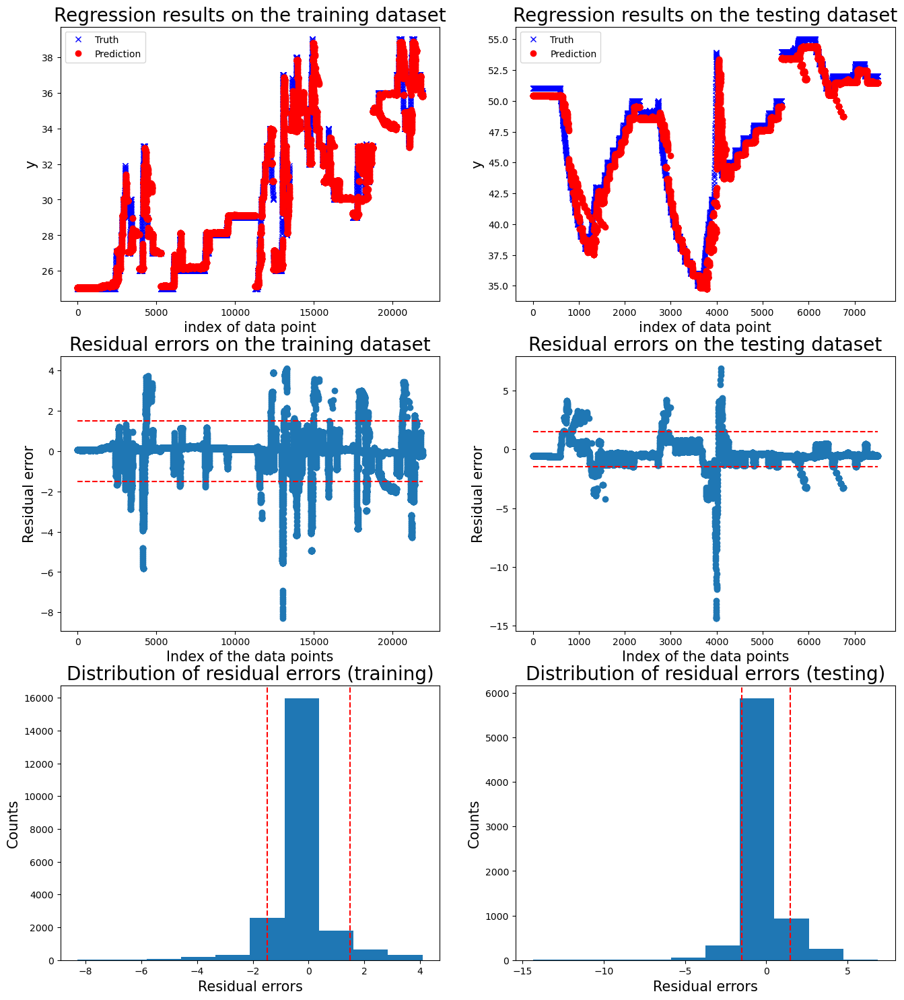

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:03<00:00,  1.33s/it]



 New run:

training performance, max error is: 8.678463023158628
training performance, mean root square error is: 0.6706770660055474
training performance, residual error > 1: 4.024399315628952%

 New run:

testing performance, max error is: 10.541182973541773
testing performance, mean root square error is: 1.400042316500357
testing performance, residual error > 1: 4.5141065830721%


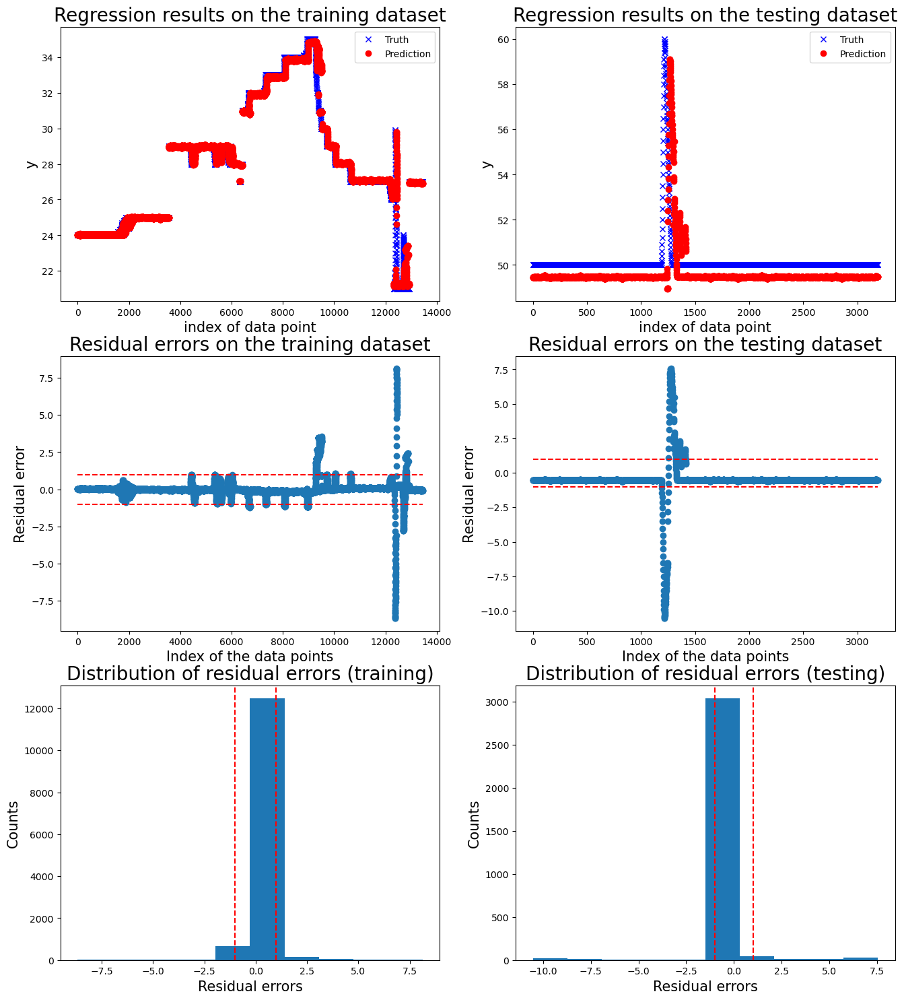

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.12s/it]



 New run:

training performance, max error is: 7.6301093415909875
training performance, mean root square error is: 0.7417545016756106
training performance, residual error > 1.4999402382784883: 4.356366187302701%

 New run:

testing performance, max error is: 3.803844866718862
testing performance, mean root square error is: 0.9348431223387549
testing performance, residual error > 1.4999402382784883: 7.490636704119851%


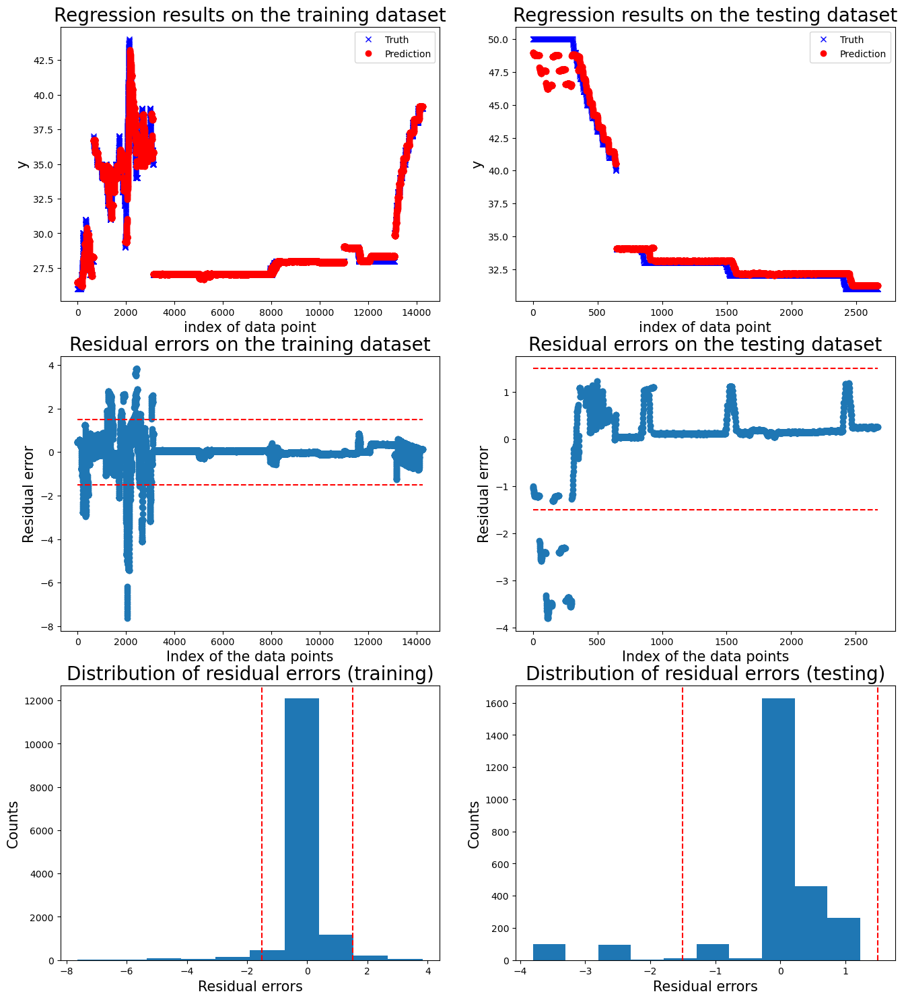

Motor  6
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:11<00:00,  3.81s/it]



 New run:

training performance, max error is: 5.997451770498515
training performance, mean root square error is: 0.8399561504694714
training performance, residual error > 1: 12.706784943658594%

 New run:

testing performance, max error is: 3.9508924475565443
testing performance, mean root square error is: 0.7121953534418205
testing performance, residual error > 1: 11.978680879413723%


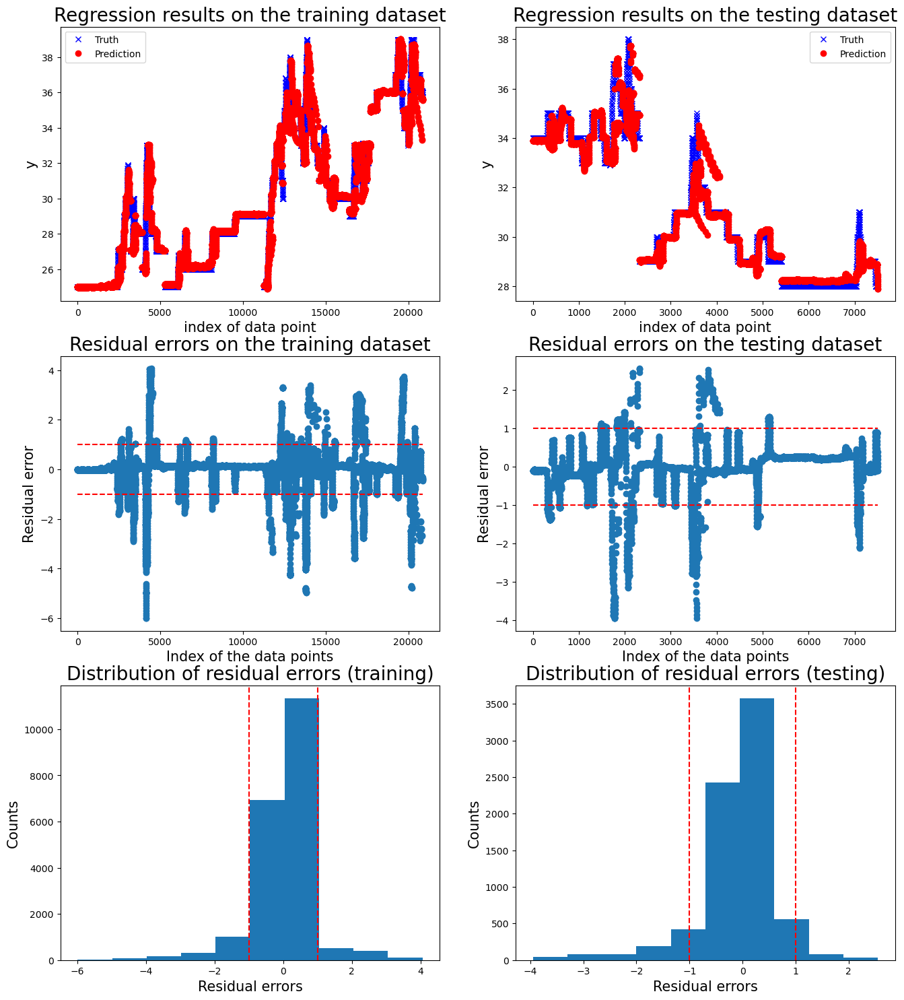

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:04<00:00,  1.36s/it]



 New run:

training performance, max error is: 3.8613807854926776
training performance, mean root square error is: 0.3913828706417
training performance, residual error > 1: 2.5214007782101167%

 New run:

testing performance, max error is: 9.012537729908598
testing performance, mean root square error is: 1.0826157834186902
testing performance, residual error > 1: 3.8244514106583067%


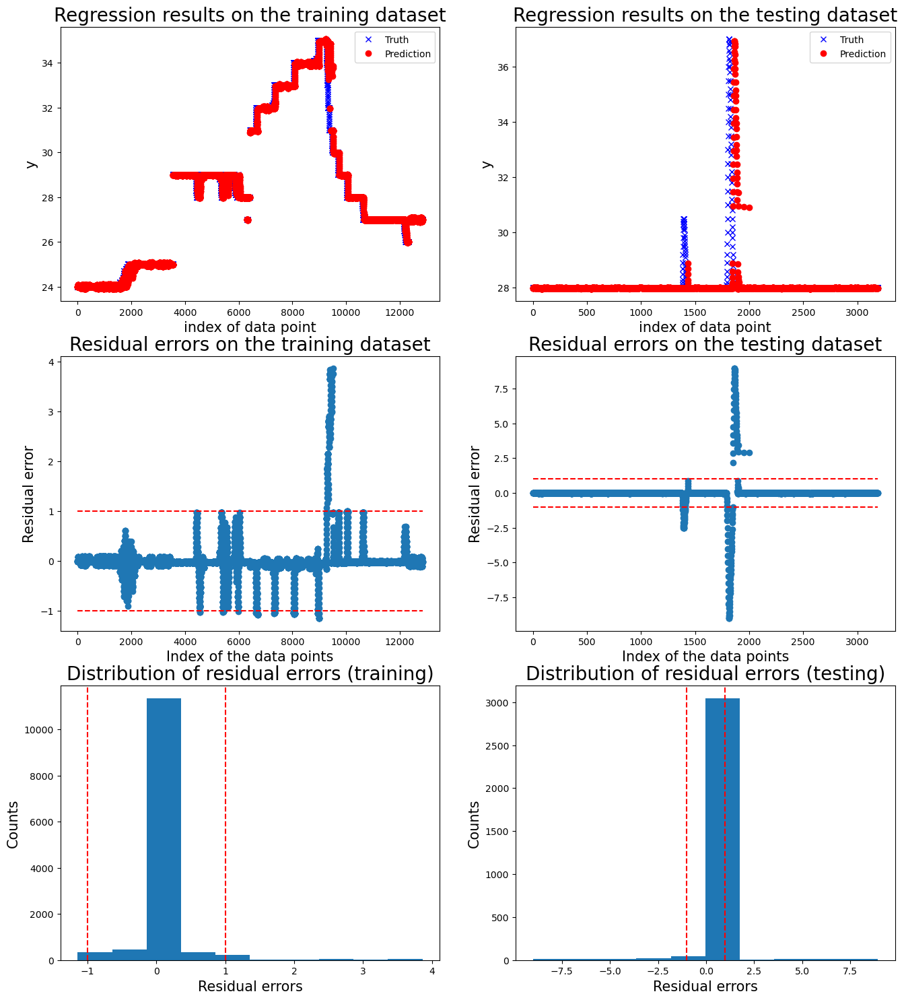

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:03<00:00,  1.66s/it]



 New run:

training performance, max error is: 3.649637213239025
training performance, mean root square error is: 0.43758785913282044
training performance, residual error > 1: 3.433509214651678%

 New run:

testing performance, max error is: 6.8120376026532234
testing performance, mean root square error is: 1.026322276384196
testing performance, residual error > 1: 10.037453183520599%


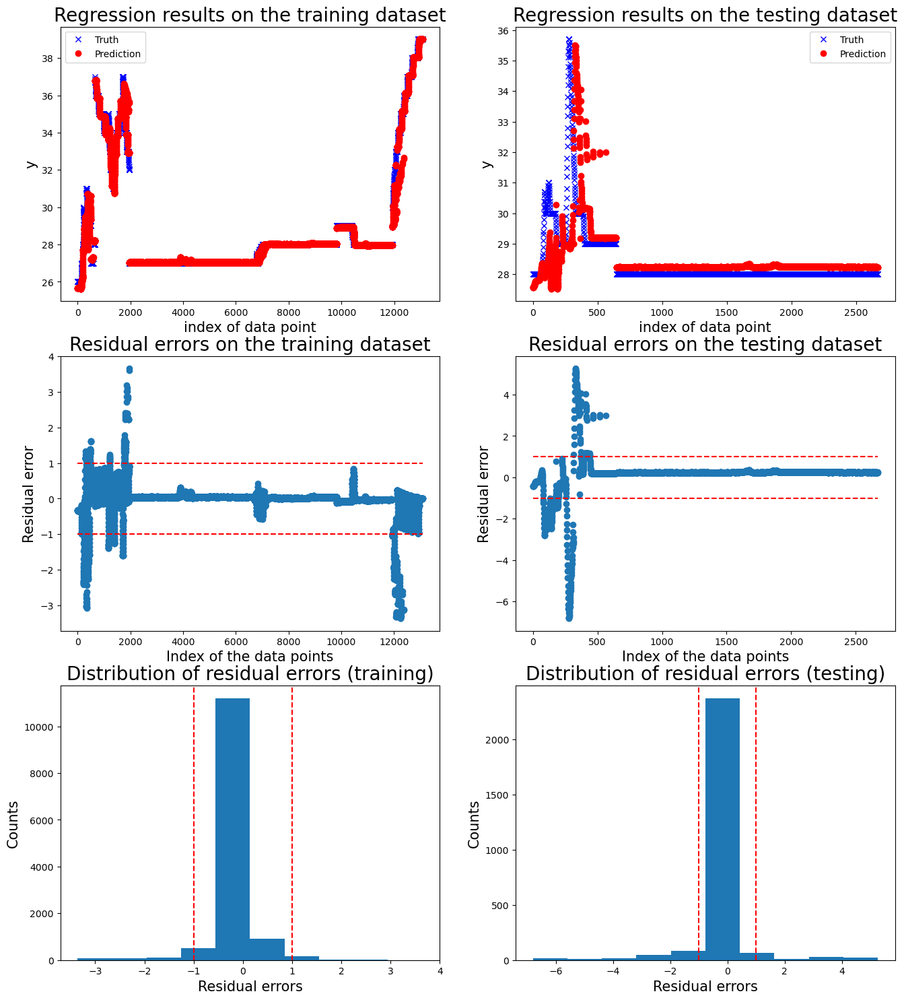

In [13]:
# Attempt 1

df_pred_dict = {}

for motor_number in range(1, 7):
    print("Motor ", motor_number)
    
    df_pred = pd.DataFrame(columns=['time', f'data_motor_{motor_number}_label', 'test_condition'])
    df_pred['time'] = df_te['time']
    df_pred['test_condition'] = df_te['test_condition']

    # Inizializzazione di all_results
    all_results = []

    train_conditions = find_train_conditions_for_motor_x(df_tr, motor_number)
    df_train_motor = df_tr[df_tr['test_condition'].isin(train_conditions)]
    df_test_motor = df_te.copy()

    for operation in list_operations:
        print("Operation: ", operation)

        df_train = df_train_motor[df_train_motor['operation']==operation]
        df_test = df_test_motor[df_test_motor['operation']==operation]

        features_x = [f'data_motor_{motor_number}_position', f'data_motor_{motor_number}_voltage']

        tests = pd.unique(df_test.test_condition).tolist()
        print(tests)

        if len(tests) != 0:

            results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=100, ss=50, plt=1, thr=1, al=3, testid=tests, motor=motor_number)
            
            # Aggiungiamo il tempo ai risultati
            results_with_time = [(time, result) for time, result in zip(df_test['time'], results)]
            
            # Concateniamo i risultati a all_results
            all_results.extend(results_with_time)

    # Inseriamo i valori di all_results nella colonna corrispondente di df_pred
    for time, result in all_results:
        df_pred.loc[df_pred['time'] == time, f'data_motor_{motor_number}_label'] = result

    # Dove non c'è corrispondenza, inseriamo 0
    df_pred[f'data_motor_{motor_number}_label'].fillna(0, inplace=True)
    
    # Salviamo il DataFrame df_pred nel dizionario df_pred_dict
    df_pred_dict[motor_number] = df_pred

df_pred = df_pred_dict[1][['time', 'test_condition']]

for i in range (1, 7):
    df_pred[f'data_motor_{i}_label'] = df_pred_dict[i][[f'data_motor_{i}_label']]

df_pred.drop(columns=['time'], inplace=True)
df_pred.reset_index(inplace=True)
df_pred.rename(columns={'index': 'idx'}, inplace=True)
test_condition = df_pred.pop('test_condition')
df_pred['test_condition'] = test_condition

df_pred.to_csv('df_pred_new.csv', index=False)


Motor  1
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:13<00:00,  4.49s/it]



 New run:

training performance, max error is: 3.0697685809260093
training performance, mean root square error is: 0.3137242045740972
training performance, residual error > 0.8263171913862105: 3.2015723957195896%

 New run:

testing performance, max error is: 3.391035135166277
testing performance, mean root square error is: 0.7029327059852376
testing performance, residual error > 0.8263171913862105: 12.55305466237942%


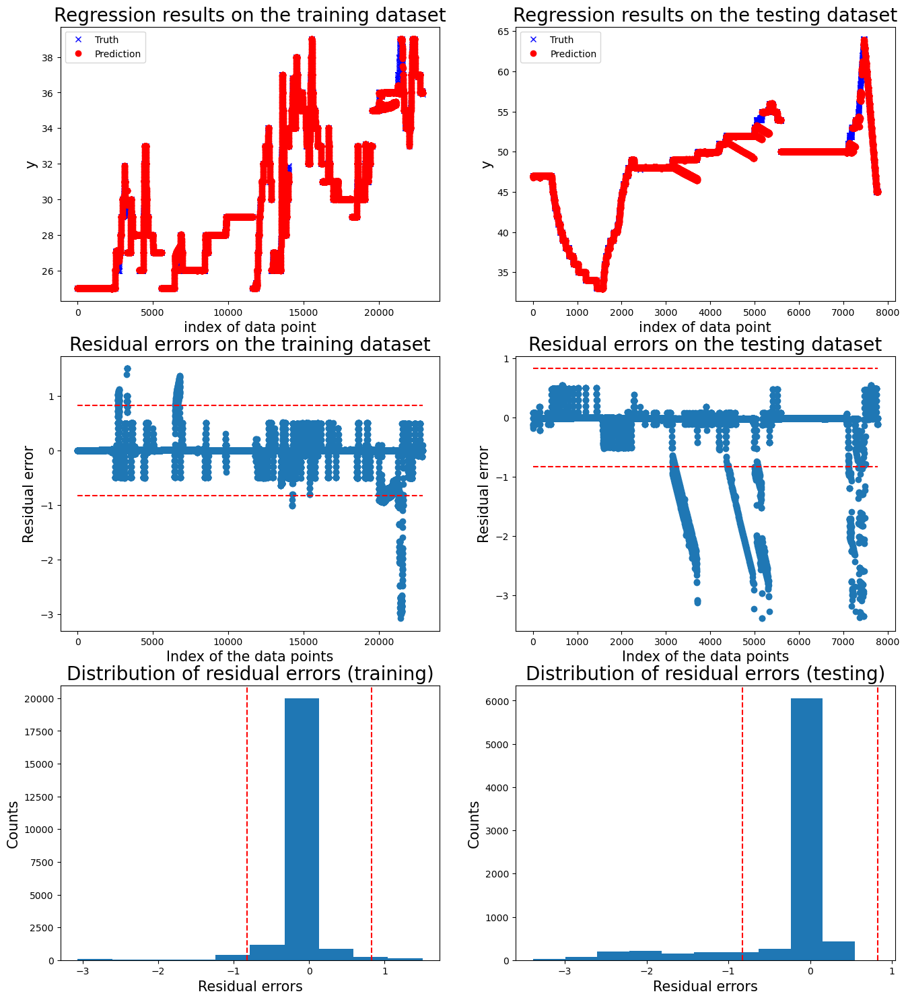

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:05<00:00,  1.84s/it]



 New run:

training performance, max error is: 5.486659115778245
training performance, mean root square error is: 0.7652164358446596
training performance, residual error > 0.5: 16.41449553472581%

 New run:

testing performance, max error is: 1.7467806496417495
testing performance, mean root square error is: 0.11017504541613429
testing performance, residual error > 0.5: 0.838150289017341%


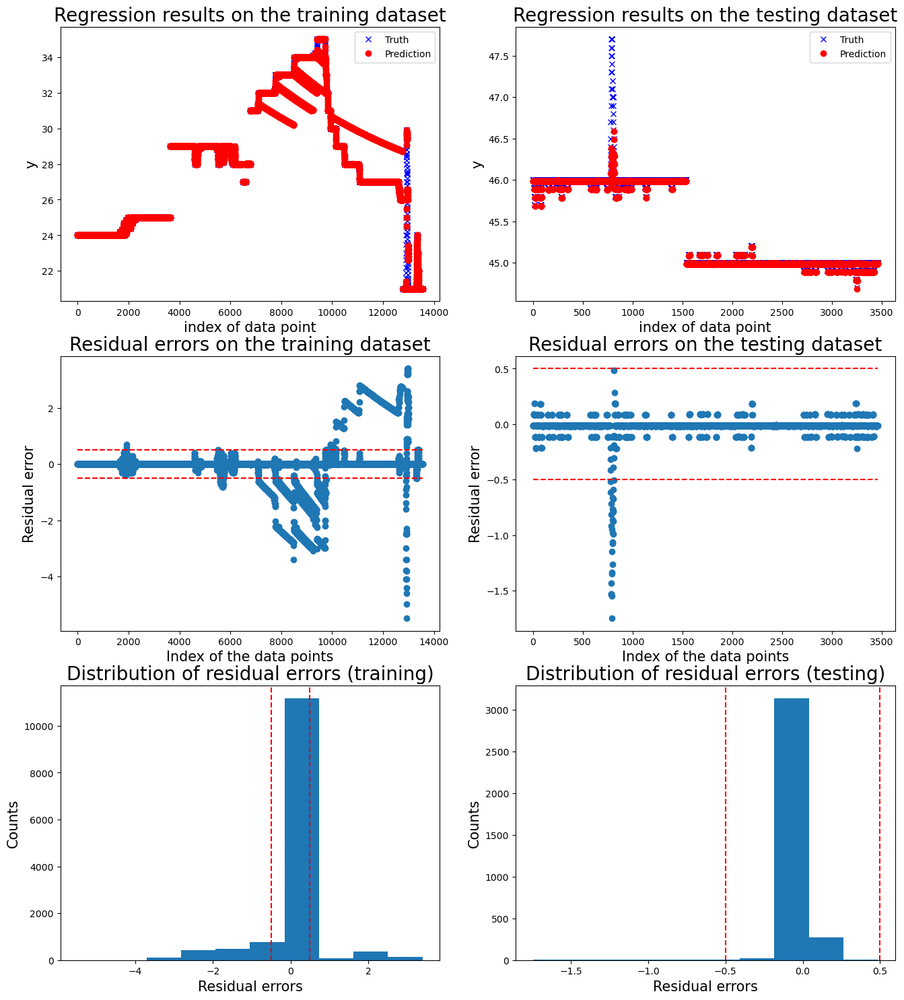

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.10s/it]



 New run:

training performance, max error is: 3.3039996149239883
training performance, mean root square error is: 0.2880650812777739
training performance, residual error > 0.5: 4.594754486294617%

 New run:

testing performance, max error is: 7.6206170762786485
testing performance, mean root square error is: 0.7952229636441436
testing performance, residual error > 0.5: 20.0%


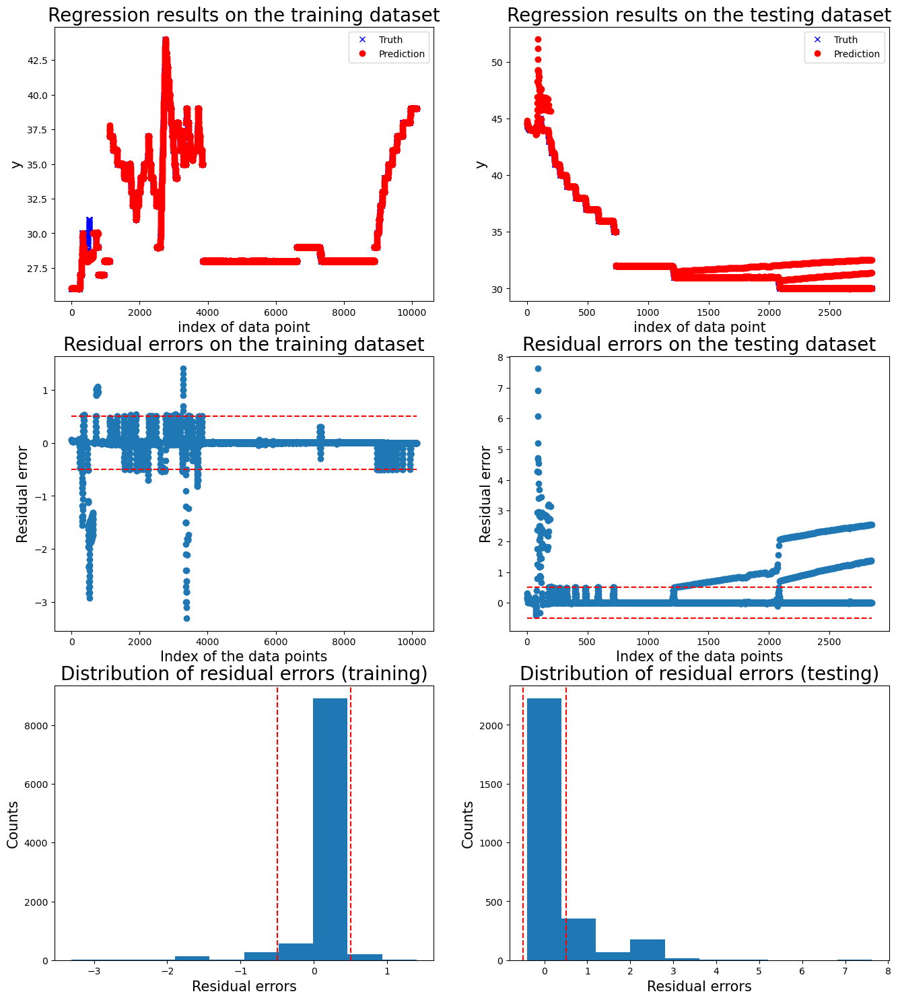

Motor  2
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:12<00:00,  4.25s/it]



 New run:

training performance, max error is: 3.052767198026345
training performance, mean root square error is: 0.6034071294758884
training performance, residual error > 0.5: 12.622843415592925%

 New run:

testing performance, max error is: 3.155957818427524
testing performance, mean root square error is: 0.6668215958681937
testing performance, residual error > 0.5: 18.2508038585209%


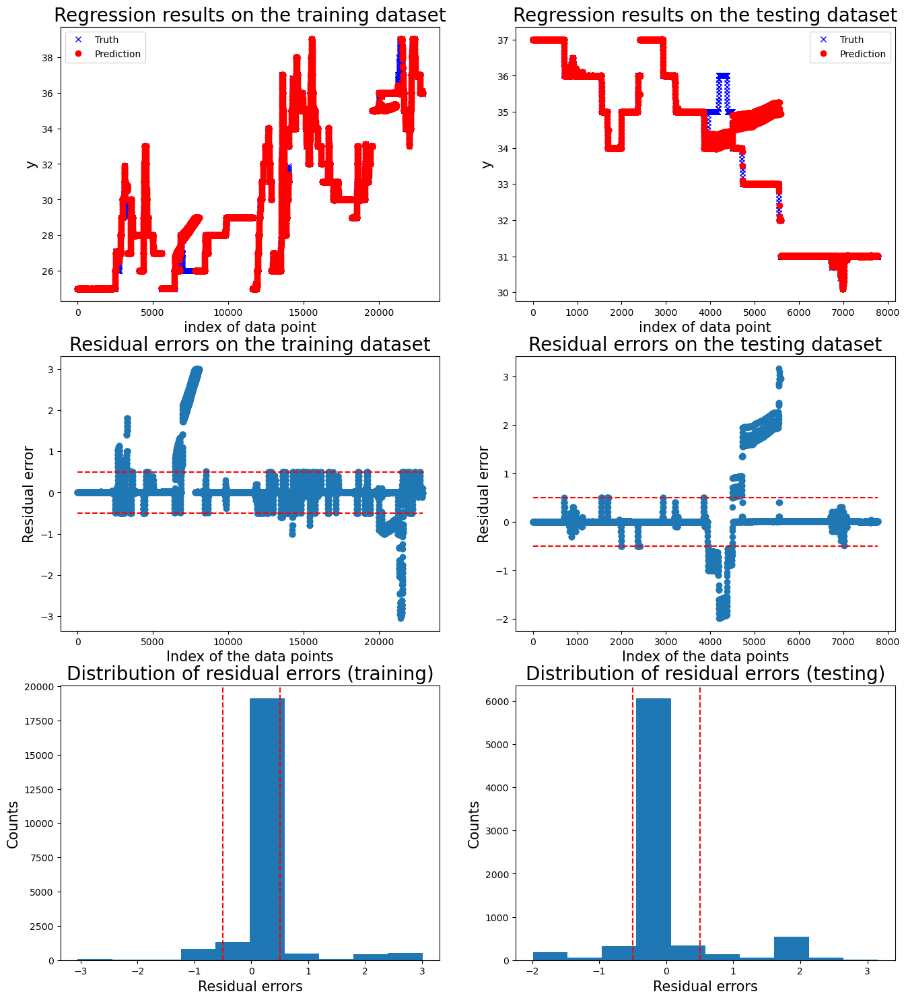

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:05<00:00,  1.75s/it]



 New run:

training performance, max error is: 5.474889191499237
training performance, mean root square error is: 0.6175831008841648
training performance, residual error > 0.5: 11.593588928899244%

 New run:

testing performance, max error is: 6.904649600149678
testing performance, mean root square error is: 0.7177538182727928
testing performance, residual error > 0.5: 14.566473988439308%


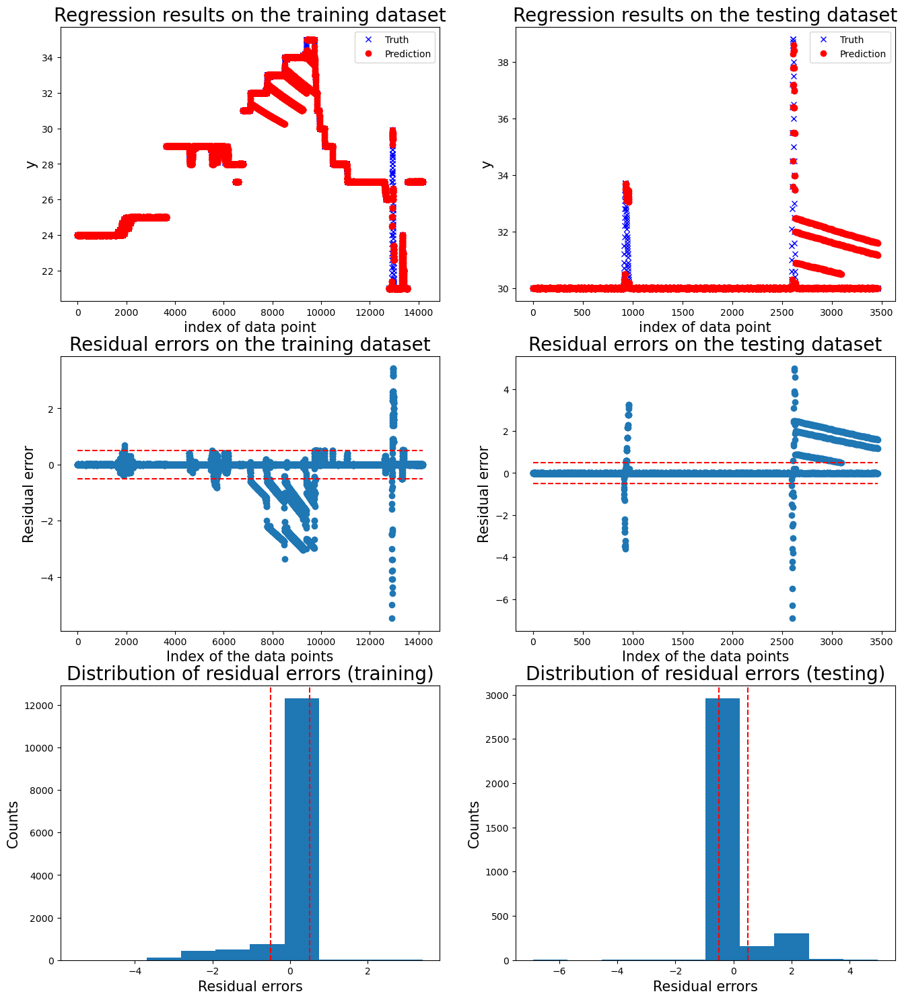

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:05<00:00,  2.71s/it]



 New run:

training performance, max error is: 3.3123857712857614
training performance, mean root square error is: 0.16093954523397028
training performance, residual error > 0.5658503906251318: 0.9216886883660973%

 New run:

testing performance, max error is: 4.822192136036076
testing performance, mean root square error is: 0.6249118303312063
testing performance, residual error > 0.5658503906251318: 13.017543859649122%


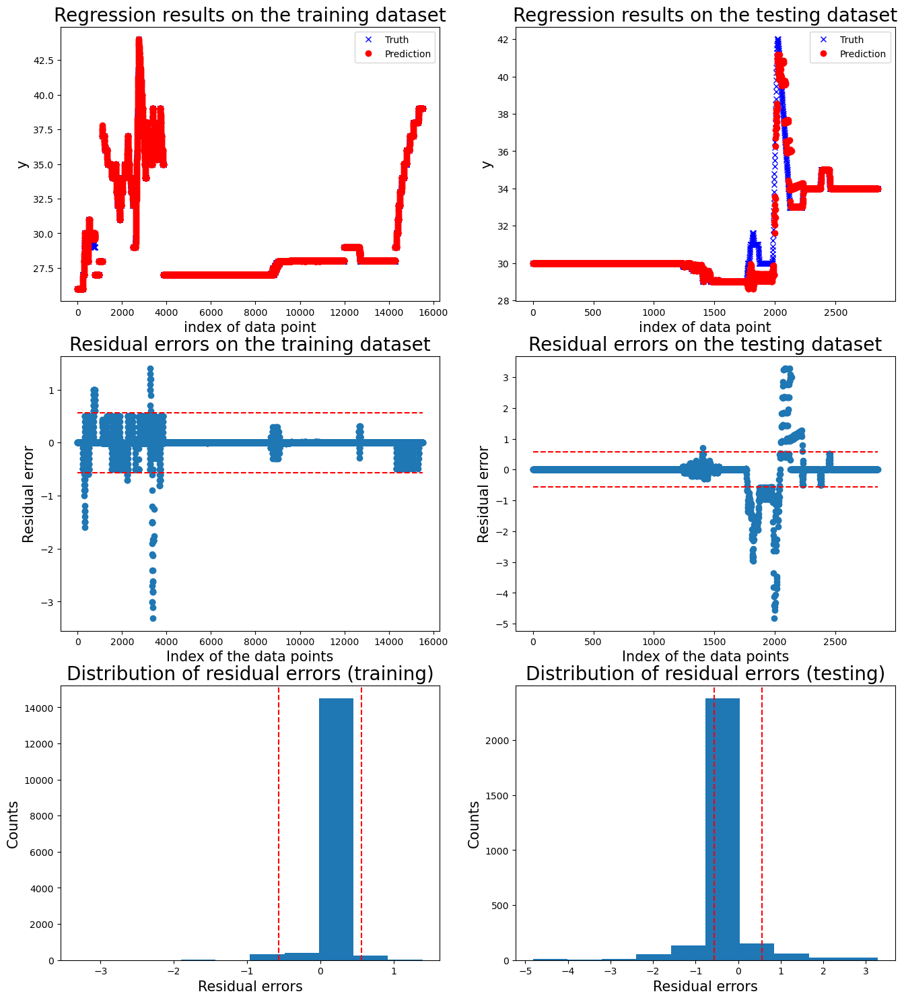

Motor  3
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:12<00:00,  4.03s/it]



 New run:

training performance, max error is: 3.029919380261461
training performance, mean root square error is: 0.6243915267387886
training performance, residual error > 0.5041250456318878: 12.421926184756497%

 New run:

testing performance, max error is: 3.453170342760391
testing performance, mean root square error is: 0.6050553233531523
testing performance, residual error > 0.5041250456318878: 13.016077170418006%


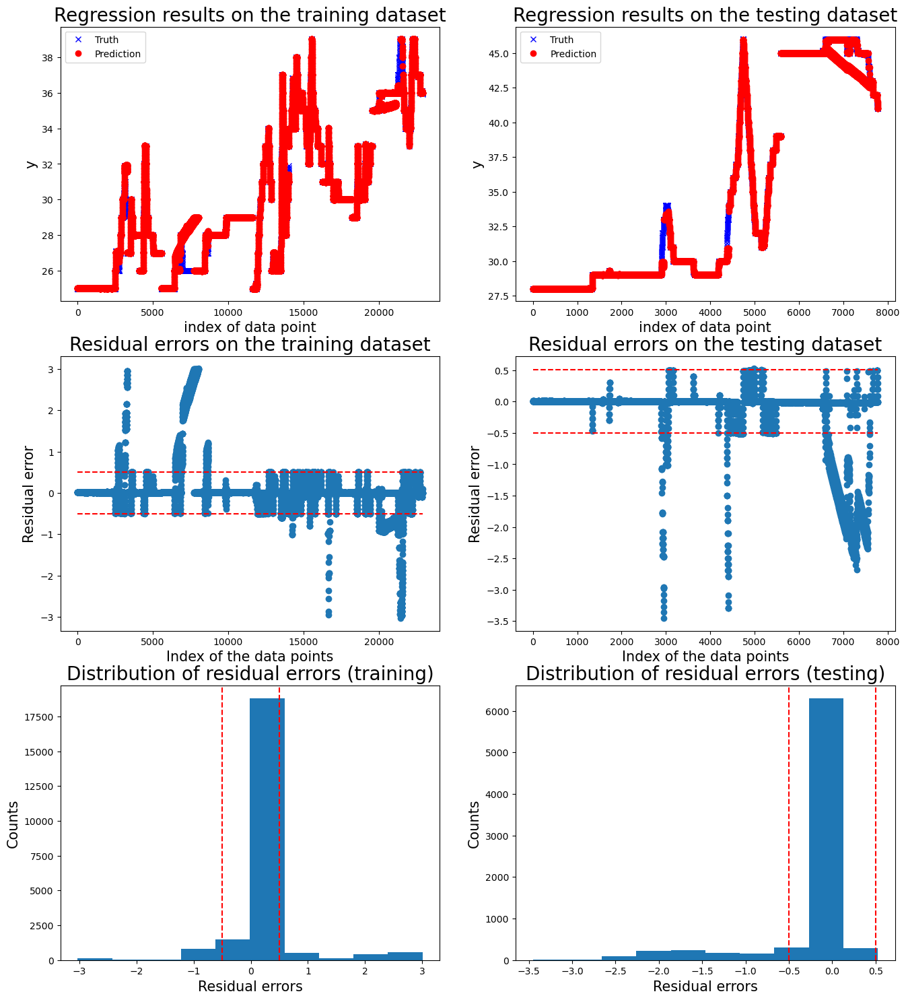

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:05<00:00,  1.73s/it]



 New run:

training performance, max error is: 5.4884319249101665
training performance, mean root square error is: 0.6179800189620477
training performance, residual error > 0.5: 11.515921767987008%

 New run:

testing performance, max error is: 4.600312106719215
testing performance, mean root square error is: 0.3590493421351326
testing performance, residual error > 0.5: 8.352601156069364%


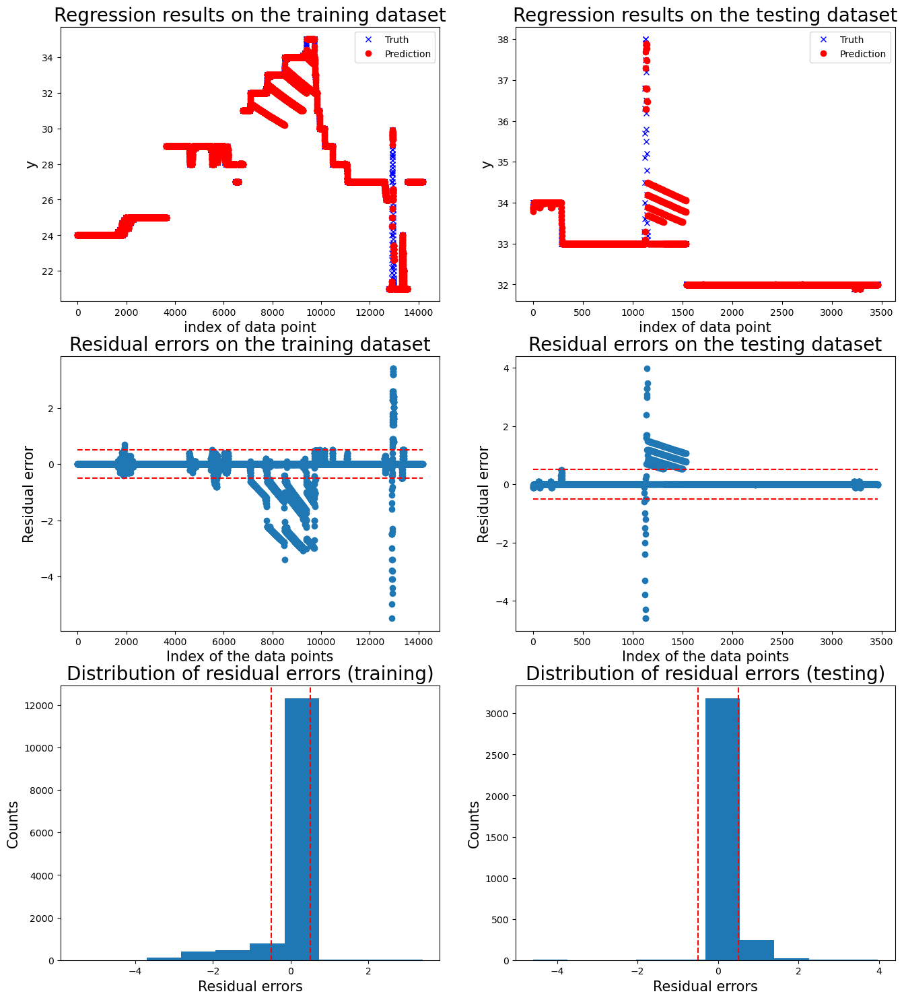

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.43s/it]



 New run:

training performance, max error is: 3.3067705746592964
training performance, mean root square error is: 0.16105943526851885
training performance, residual error > 0.5: 2.0560747663551404%

 New run:

testing performance, max error is: 1.7936454154838053
testing performance, mean root square error is: 0.1191289964507481
testing performance, residual error > 0.5: 1.2982456140350878%


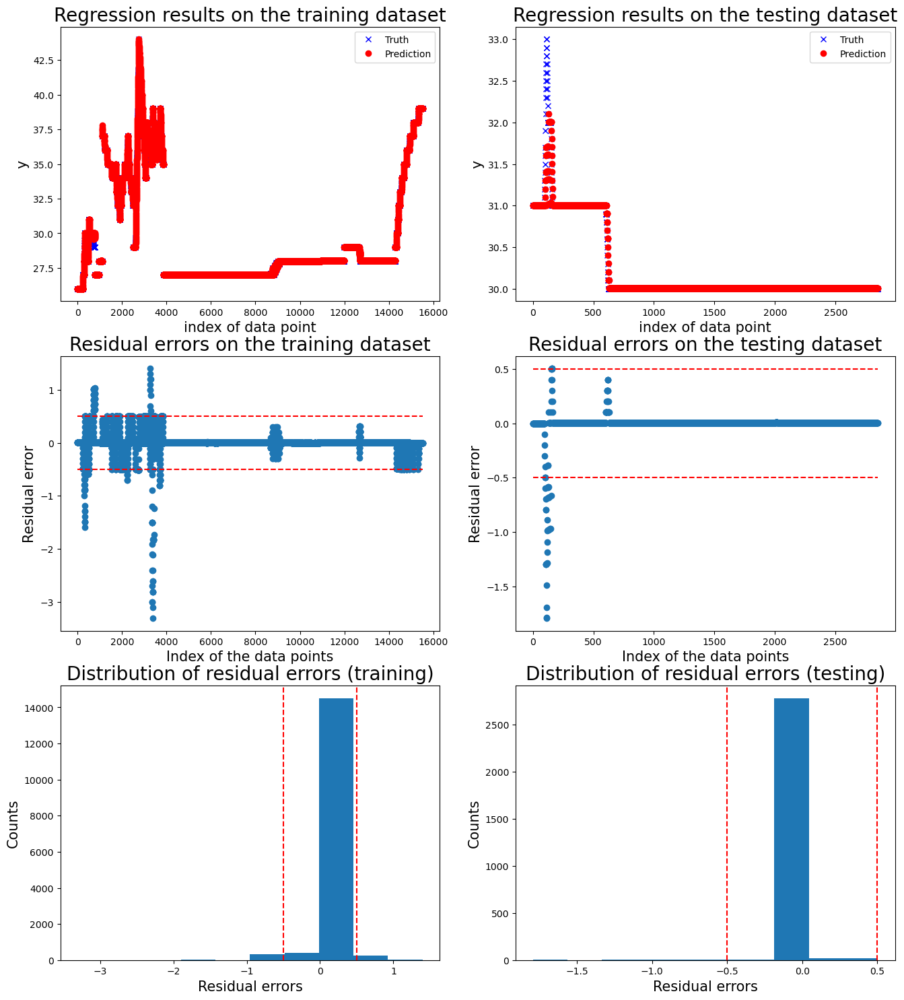

Motor  4
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:13<00:00,  4.34s/it]



 New run:

training performance, max error is: 2.9977968189528177
training performance, mean root square error is: 0.2789798237226491
training performance, residual error > 0.7076551876380313: 4.782703647084516%

 New run:

testing performance, max error is: 3.228740599842155
testing performance, mean root square error is: 0.7789975885516606
testing performance, residual error > 0.7076551876380313: 15.125401929260452%


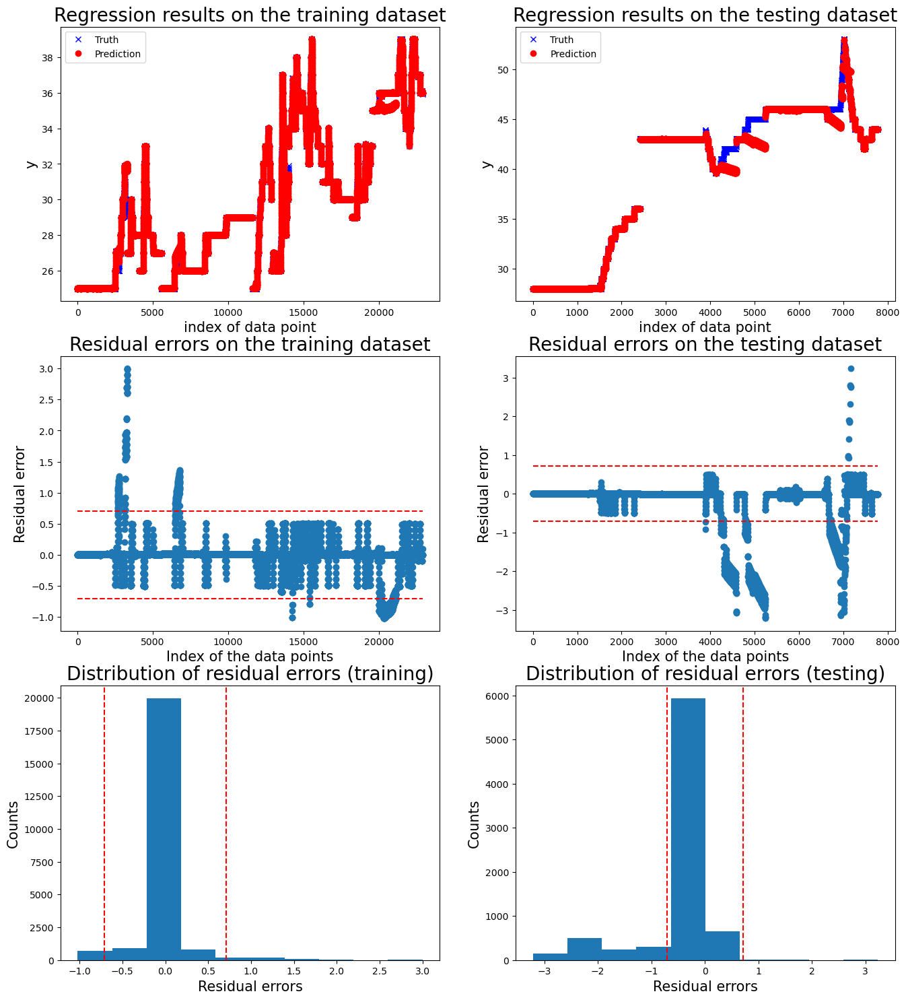

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:05<00:00,  1.68s/it]



 New run:

training performance, max error is: 5.4909109015649555
training performance, mean root square error is: 0.6188152552547032
training performance, residual error > 0.5: 11.52298241897903%

 New run:

testing performance, max error is: 6.927302594633304
testing performance, mean root square error is: 0.4724644144725126
testing performance, residual error > 0.5: 7.08092485549133%


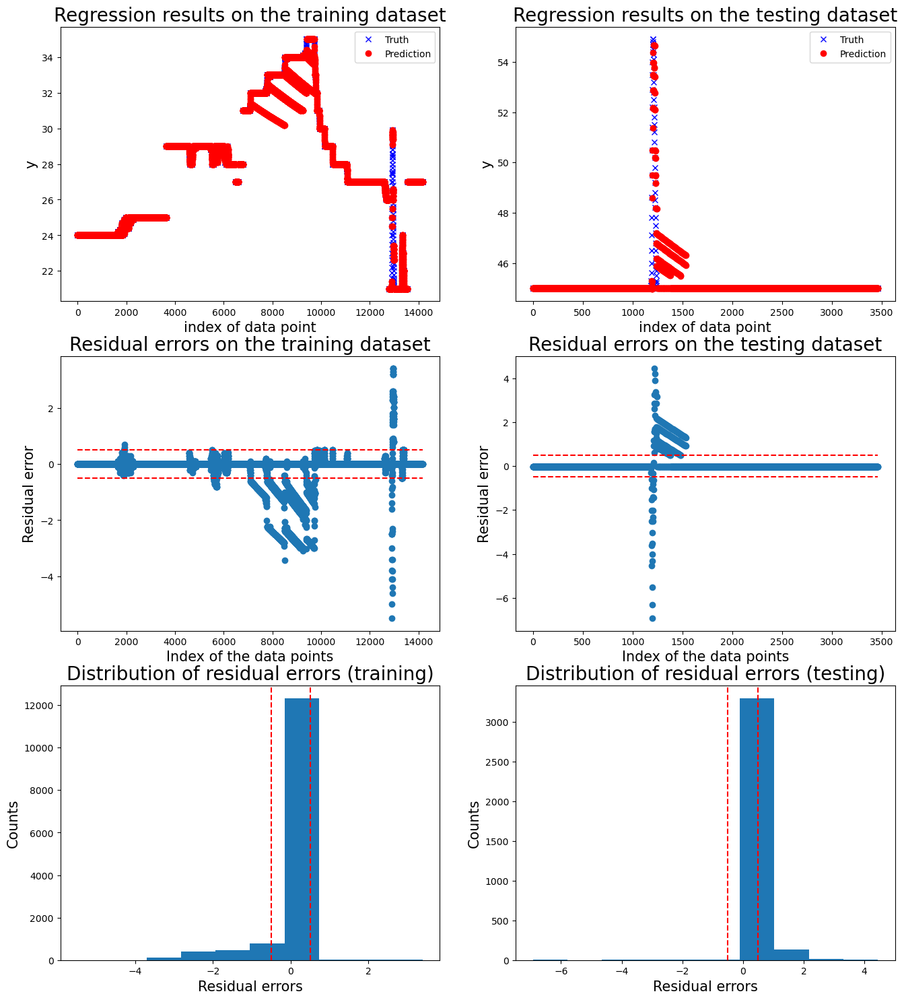

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.32s/it]



 New run:

training performance, max error is: 3.30809010540748
training performance, mean root square error is: 0.16275918764758
training performance, residual error > 0.5: 1.9658395101514663%

 New run:

testing performance, max error is: 1.9748287281775845
testing performance, mean root square error is: 0.6639061917645496
testing performance, residual error > 0.5: 29.543859649122805%


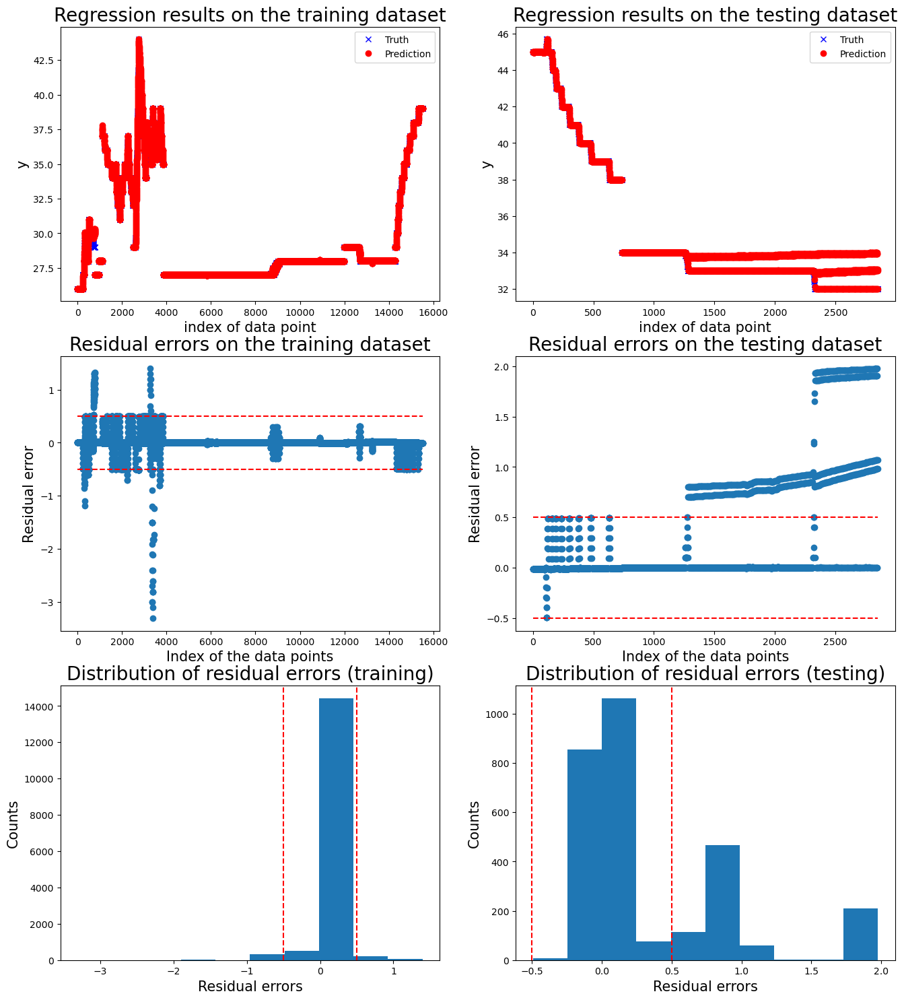

Motor  5
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:13<00:00,  4.35s/it]



 New run:

training performance, max error is: 3.027556552834696
training performance, mean root square error is: 0.31802069997253435
training performance, residual error > 0.5669804464264244: 5.922690543786853%

 New run:

testing performance, max error is: 3.8589964405334882
testing performance, mean root square error is: 0.24938228807989368
testing performance, residual error > 0.5669804464264244: 0.6688102893890675%


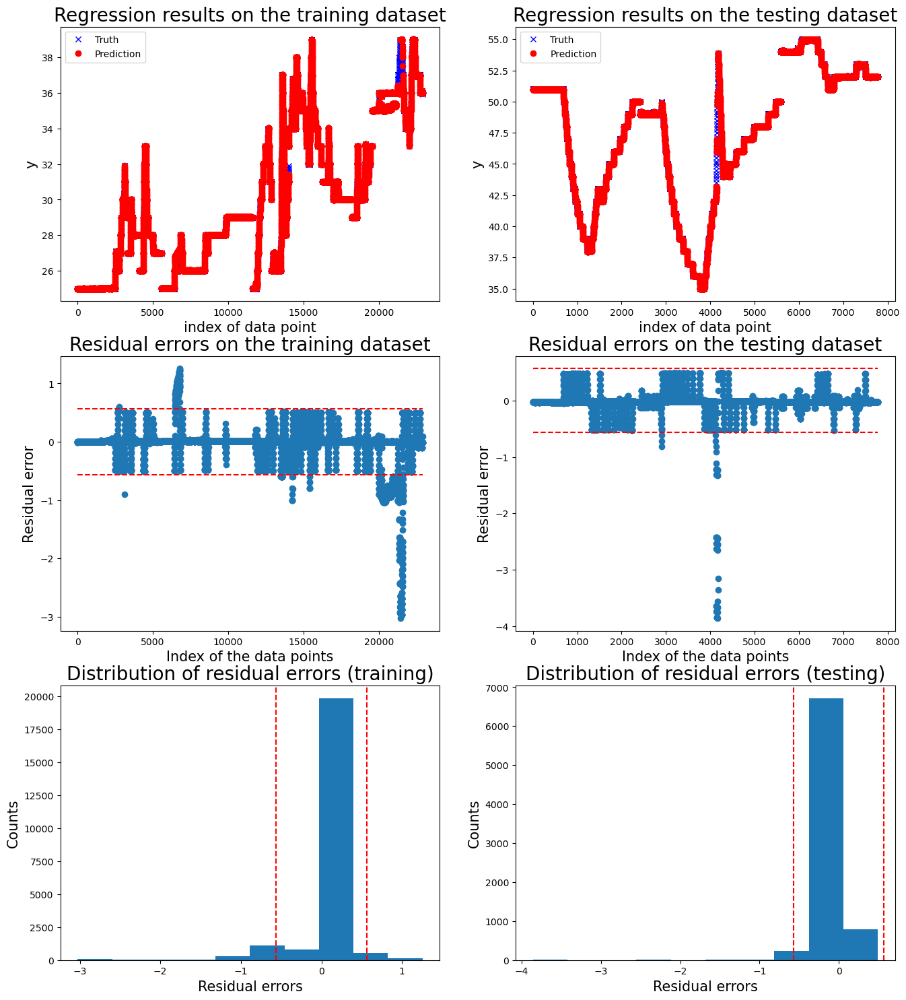

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:06<00:00,  2.01s/it]



 New run:

training performance, max error is: 5.462274465076387
training performance, mean root square error is: 0.5473318539598958
training performance, residual error > 0.5: 9.658970557085363%

 New run:

testing performance, max error is: 5.053494342067644
testing performance, mean root square error is: 0.5343062956342112
testing performance, residual error > 0.5: 7.023121387283238%


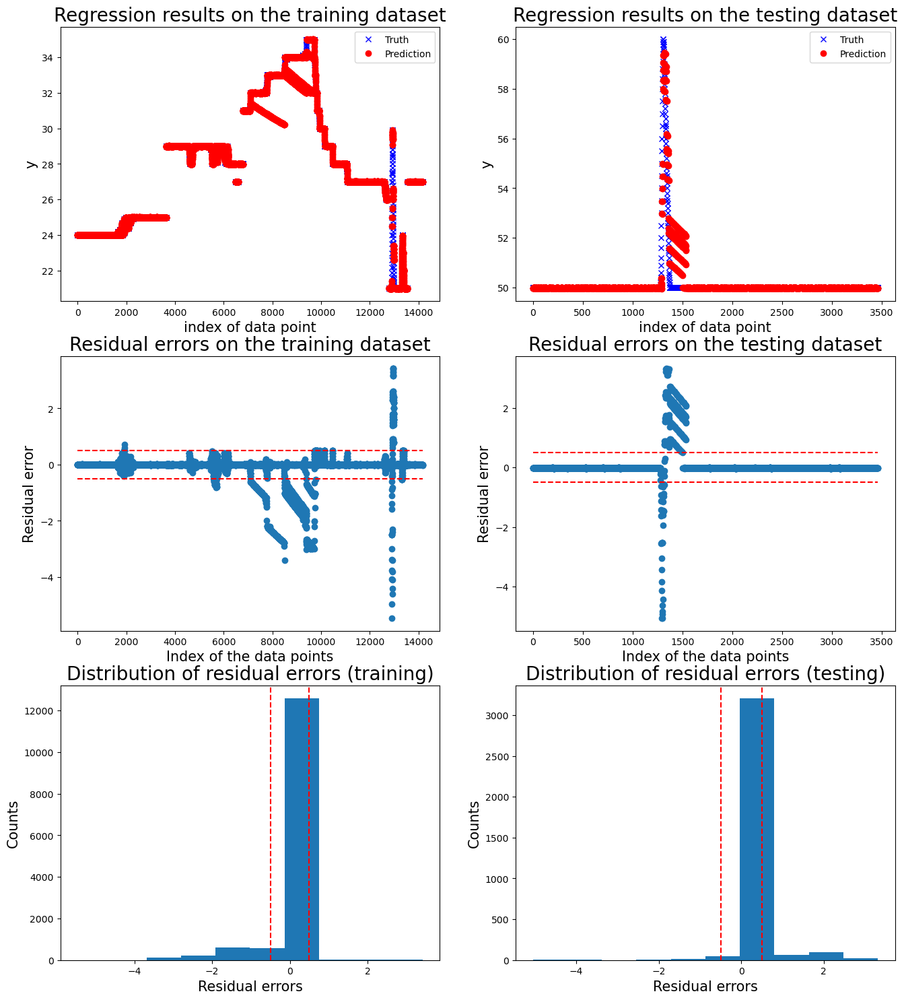

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.41s/it]



 New run:

training performance, max error is: 3.3366653202551433
training performance, mean root square error is: 0.15242237992367808
training performance, residual error > 0.5: 1.6757976152110858%

 New run:

testing performance, max error is: 0.49472590208532097
testing performance, mean root square error is: 0.08854043344255817
testing performance, residual error > 0.5: 0.0%


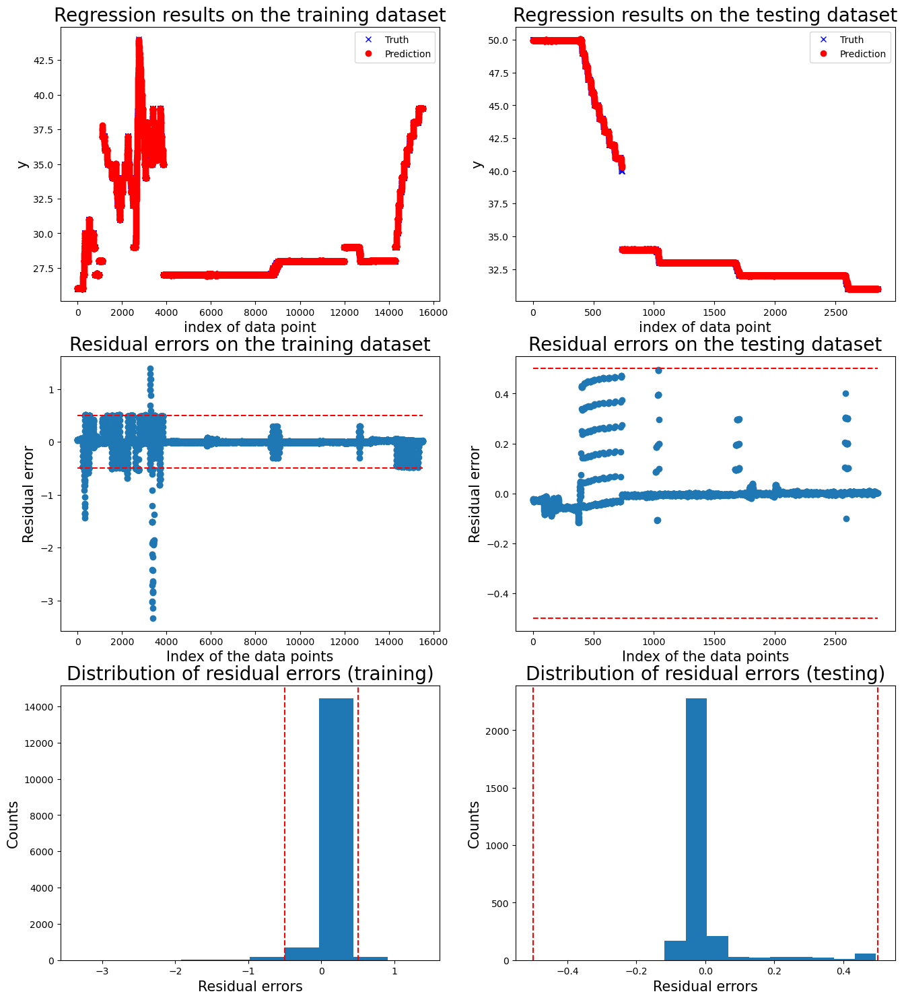

Motor  6
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:13<00:00,  4.57s/it]



 New run:

training performance, max error is: 3.2354003087117
training performance, mean root square error is: 0.5548240297479572
training performance, residual error > 0.5: 9.611583544012872%

 New run:

testing performance, max error is: 3.366811824976331
testing performance, mean root square error is: 0.4015813876724313
testing performance, residual error > 0.5: 6.868167202572348%


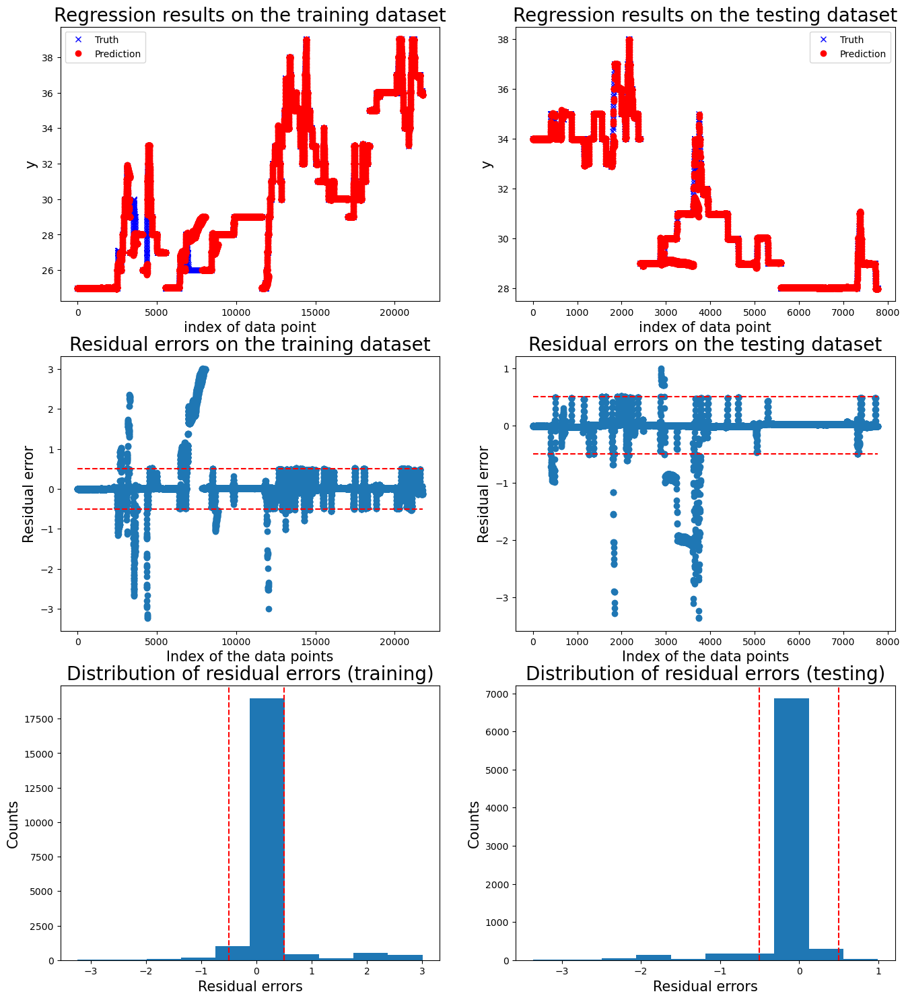

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:05<00:00,  1.76s/it]



 New run:

training performance, max error is: 3.2139037396554215
training performance, mean root square error is: 0.5720814247508244
training performance, residual error > 0.5: 11.538461538461538%

 New run:

testing performance, max error is: 5.490991523403963
testing performance, mean root square error is: 0.5560180607830753
testing performance, residual error > 0.5: 8.670520231213873%


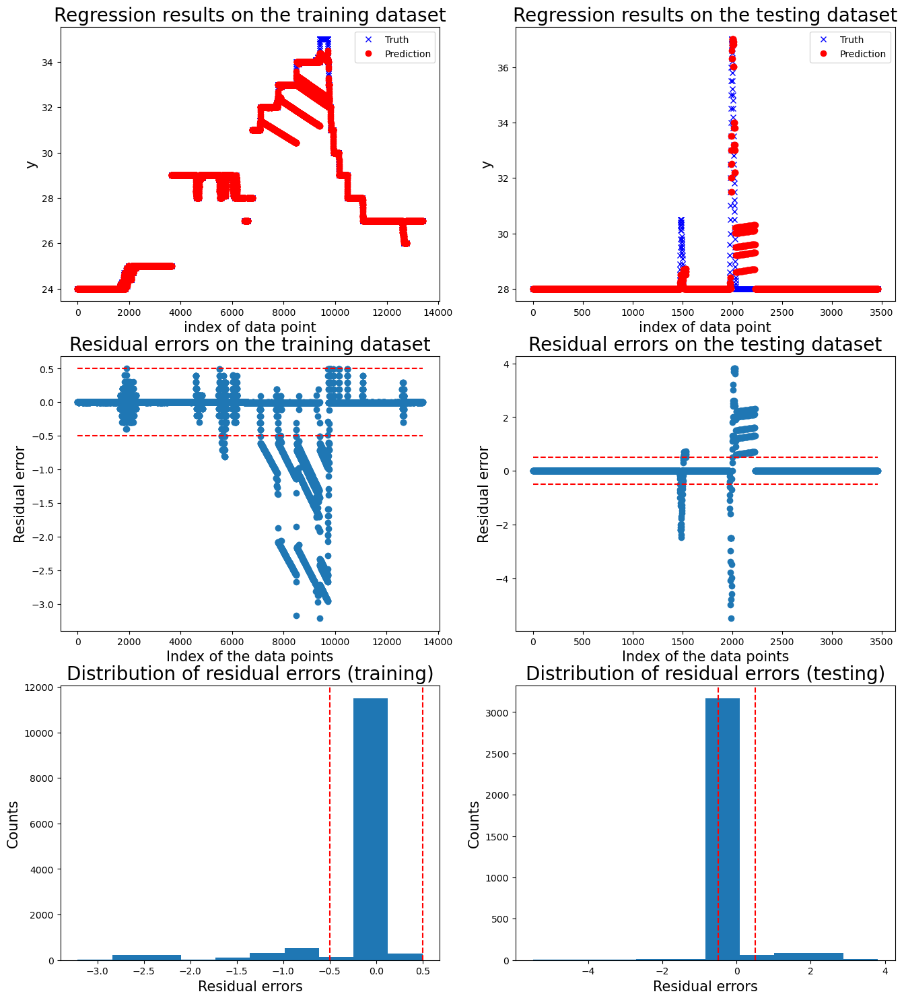

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.28s/it]



 New run:

training performance, max error is: 3.310530391536826
training performance, mean root square error is: 0.2515943110780738
training performance, residual error > 0.5: 2.2462386098749736%

 New run:

testing performance, max error is: 4.533275541493154
testing performance, mean root square error is: 0.3637701647858652
testing performance, residual error > 0.5: 6.035087719298246%


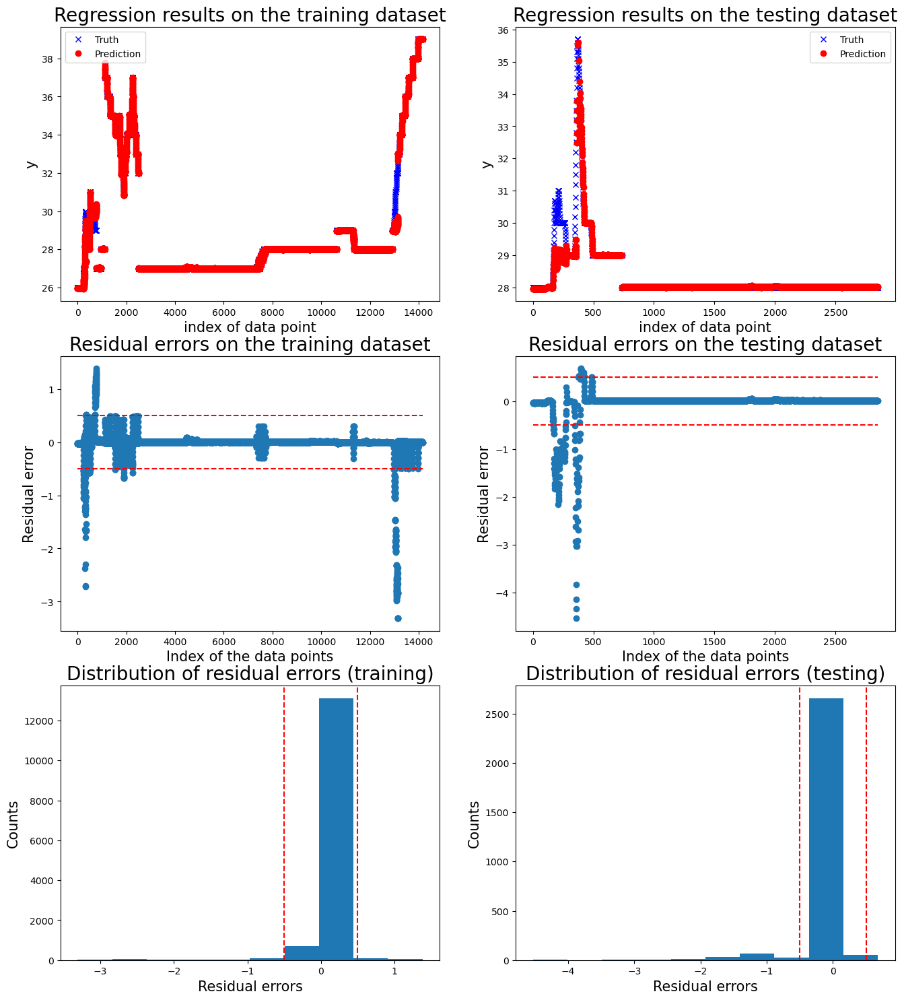

In [9]:
# Attempt 2 - 30,6% on Public Result

sys.path.insert(0, 'C:/Users/gioca/GitHub/projects/maintenance_industry_4_2024/supporting_scripts/WP_4_20240528/')
from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg, read_all_csvs_one_test, run_cv_one_motor, show_reg_result, show_clf_result

df_pred_dict = {}

for motor_number in range(1, 7):
    print("Motor ", motor_number)
    
    df_pred = pd.DataFrame(columns=['time', f'data_motor_{motor_number}_label', 'test_condition'])
    df_pred['time'] = df_te['time']
    df_pred['test_condition'] = df_te['test_condition']

    # Inizializzazione di all_results
    all_results = []

    train_conditions = find_train_conditions_for_motor_x(df_tr, motor_number)
    df_train_motor = df_tr[df_tr['test_condition'].isin(train_conditions)]
    df_test_motor = df_te.copy()

    for operation in list_operations:
        print("Operation: ", operation)

        df_train = df_train_motor[df_train_motor['operation']==operation]
        df_test = df_test_motor[df_test_motor['operation']==operation]

        features_x = [f'data_motor_{motor_number}_position', f'data_motor_{motor_number}_voltage']

        tests = pd.unique(df_test.test_condition).tolist()
        print(tests)

        if len(tests) != 0:

            results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=10, ss=5, plt=1, thr=0.5, al=3, testid=tests, motor=motor_number)
            
            # Aggiungiamo il tempo ai risultati
            results_with_time = [(time, result) for time, result in zip(df_test['time'], results)]
            
            # Concateniamo i risultati a all_results
            all_results.extend(results_with_time)

    # Inseriamo i valori di all_results nella colonna corrispondente di df_pred
    for time, result in all_results:
        df_pred.loc[df_pred['time'] == time, f'data_motor_{motor_number}_label'] = result

    # Dove non c'è corrispondenza, inseriamo 0
    df_pred[f'data_motor_{motor_number}_label'].fillna(0, inplace=True)
    
    # Salviamo il DataFrame df_pred nel dizionario df_pred_dict
    df_pred_dict[motor_number] = df_pred

df_pred = df_pred_dict[1][['time', 'test_condition']]

for i in range (1, 7):
    df_pred[f'data_motor_{i}_label'] = df_pred_dict[i][[f'data_motor_{i}_label']]

df_pred.drop(columns=['time'], inplace=True)
df_pred.reset_index(inplace=True)
df_pred.rename(columns={'index': 'idx'}, inplace=True)
test_condition = df_pred.pop('test_condition')
df_pred['test_condition'] = test_condition

df_pred.to_csv('df_pred_new.csv', index=False)

Motor  1
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:13<00:00,  4.60s/it]



 New run:

training performance, max error is: 3.0697685809260093
training performance, mean root square error is: 0.3137242045740972
training performance, residual error > 0.8263171913862105: 3.2015723957195896%

 New run:

testing performance, max error is: 3.391035135166277
testing performance, mean root square error is: 0.7029327059852376
testing performance, residual error > 0.8263171913862105: 12.55305466237942%


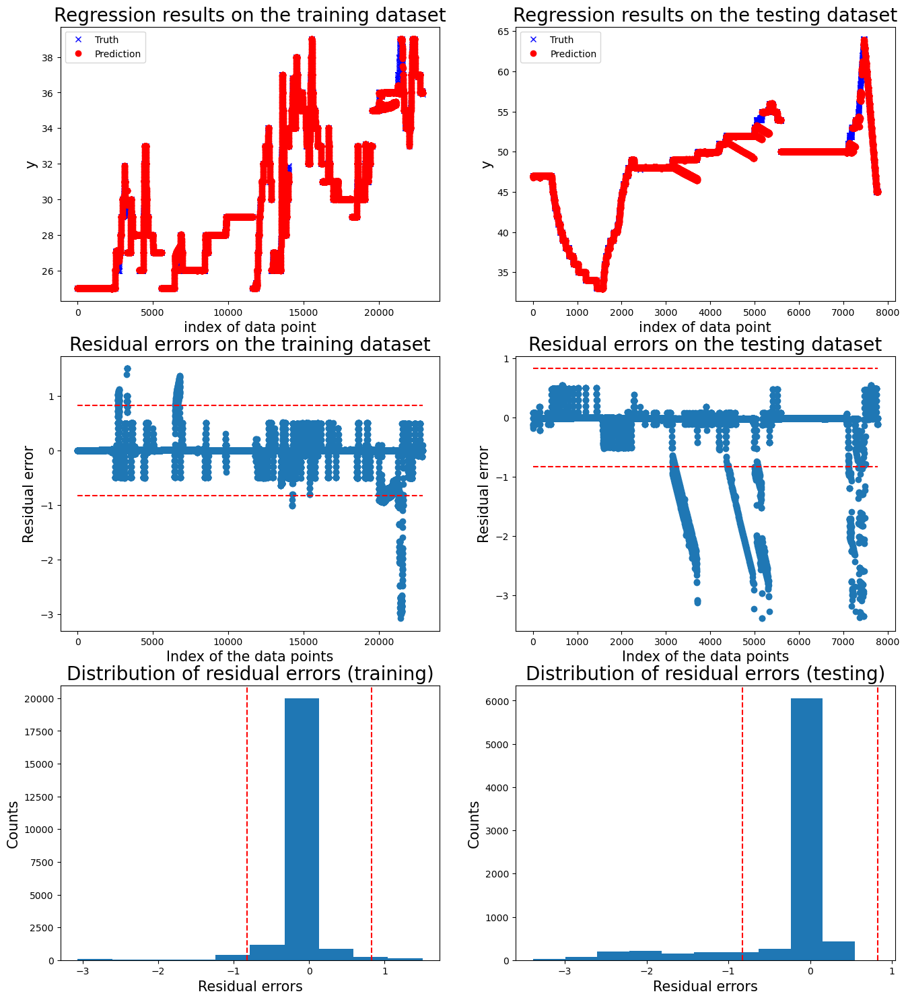

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:06<00:00,  2.13s/it]



 New run:

training performance, max error is: 5.486659115778245
training performance, mean root square error is: 1.0383587913556271
training performance, residual error > 0.4: 33.81061332939701%

 New run:

testing performance, max error is: 1.7467806496417495
testing performance, mean root square error is: 0.11495780325343127
testing performance, residual error > 0.4: 1.2716763005780347%


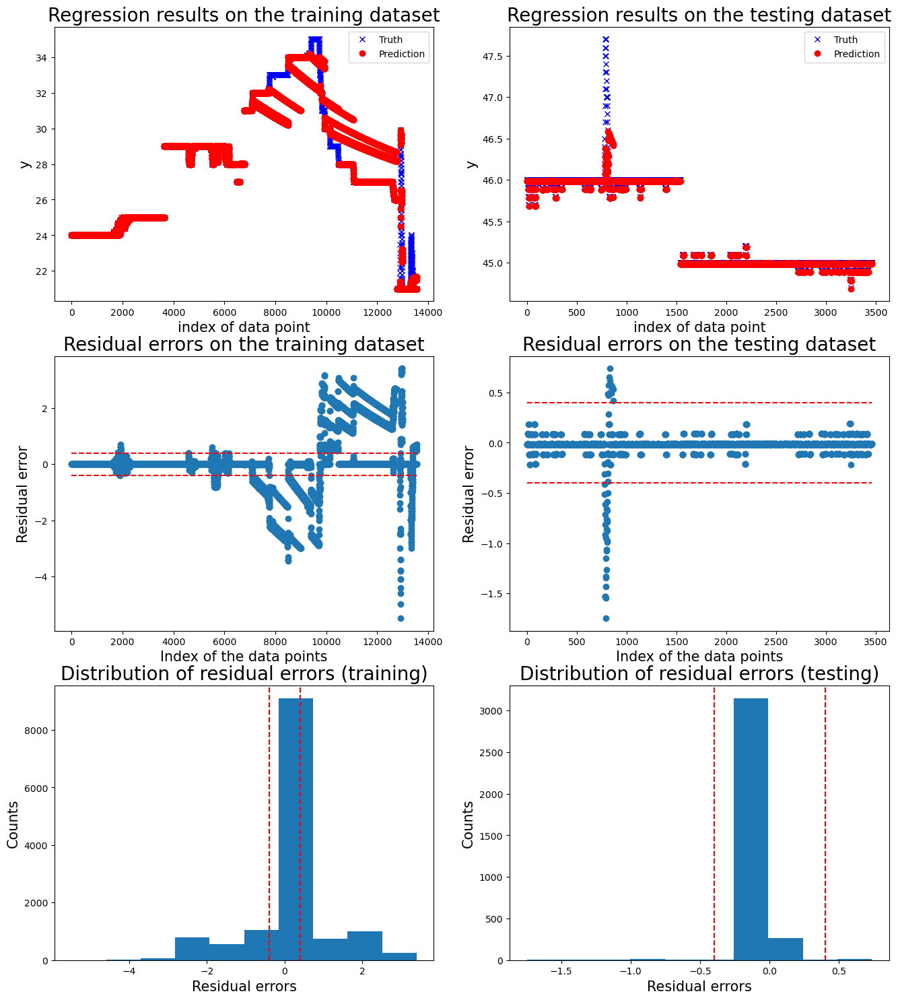

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.20s/it]



 New run:

training performance, max error is: 3.3039996149239883
training performance, mean root square error is: 0.2880650812777739
training performance, residual error > 0.5: 4.594754486294617%

 New run:

testing performance, max error is: 7.6206170762786485
testing performance, mean root square error is: 0.7952229636441436
testing performance, residual error > 0.5: 20.0%


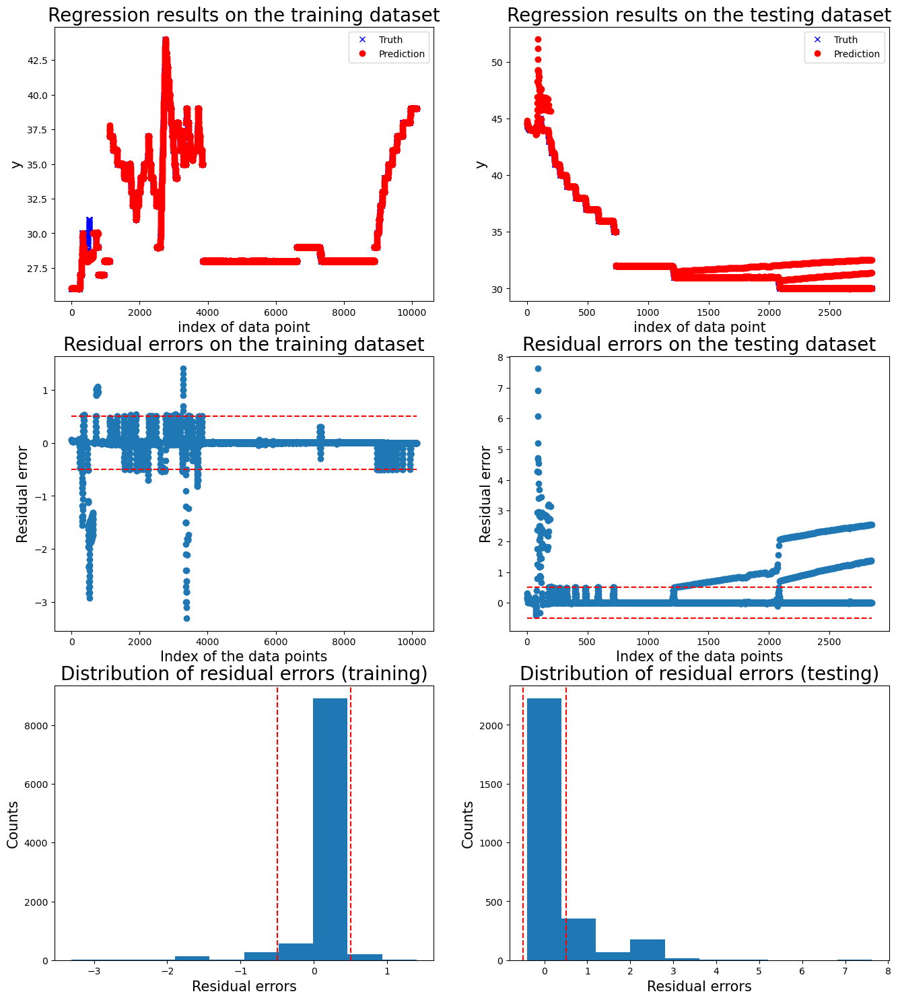

Motor  2
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:12<00:00,  4.07s/it]



 New run:

training performance, max error is: 3.052767198026345
training performance, mean root square error is: 0.6034071294758884
training performance, residual error > 0.5: 12.622843415592925%

 New run:

testing performance, max error is: 3.155957818427524
testing performance, mean root square error is: 0.6668215958681937
testing performance, residual error > 0.5: 18.2508038585209%


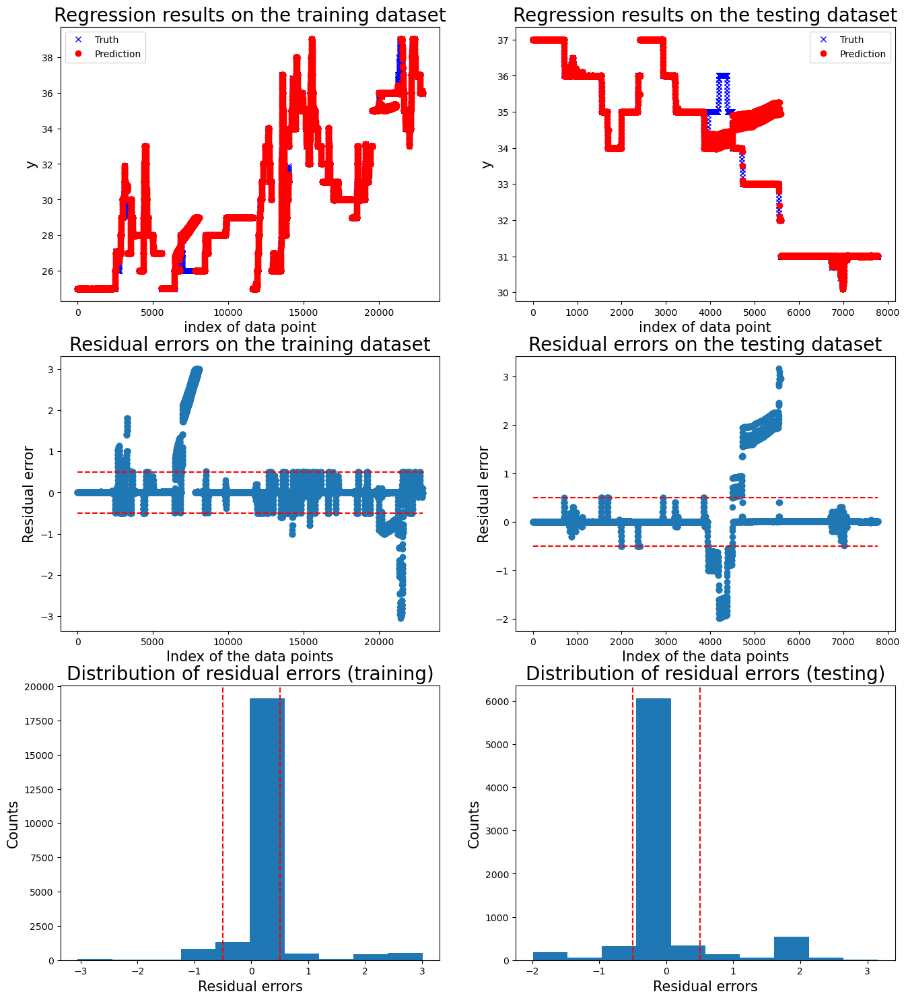

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:05<00:00,  1.90s/it]



 New run:

training performance, max error is: 5.474889191499237
training performance, mean root square error is: 0.6175831008841648
training performance, residual error > 0.5: 11.593588928899244%

 New run:

testing performance, max error is: 6.904649600149678
testing performance, mean root square error is: 0.7177538182727928
testing performance, residual error > 0.5: 14.566473988439308%


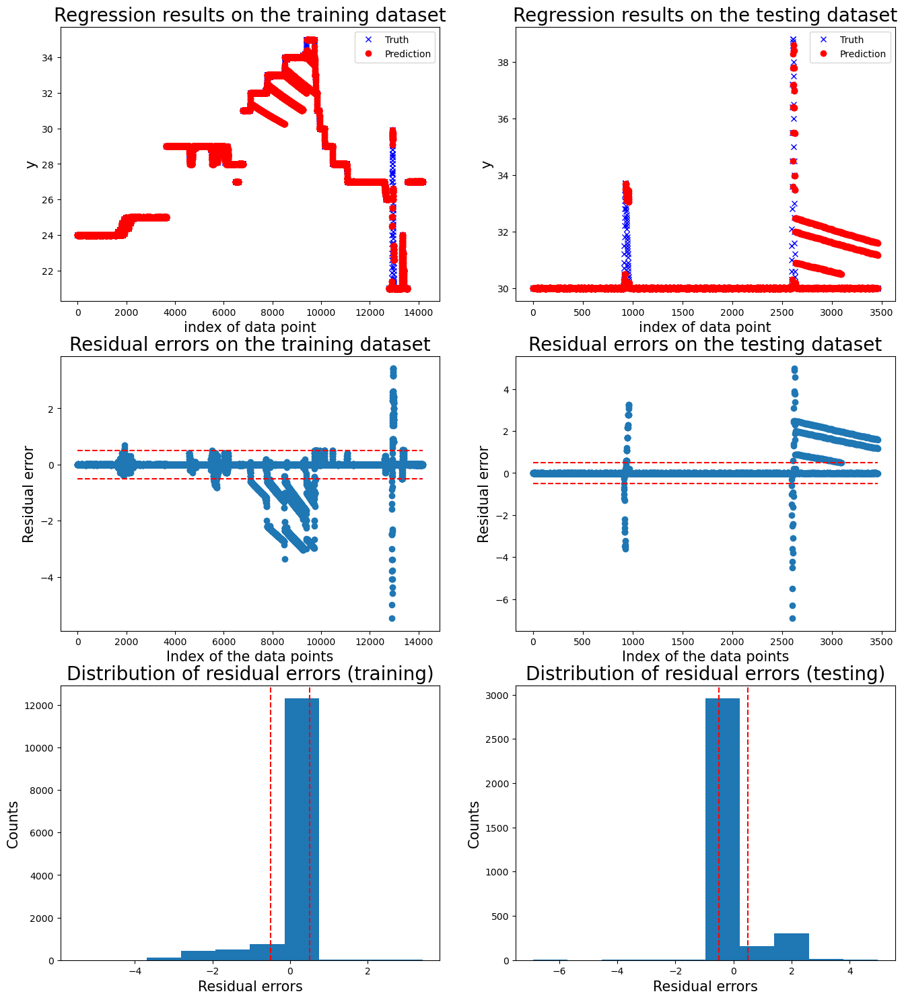

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.20s/it]



 New run:

training performance, max error is: 3.555920660036385
training performance, mean root square error is: 0.4053063062149538
training performance, residual error > 0.41193111993901266: 6.735417338059942%

 New run:

testing performance, max error is: 4.822192136036076
testing performance, mean root square error is: 0.8456856972587308
testing performance, residual error > 0.41193111993901266: 30.0%


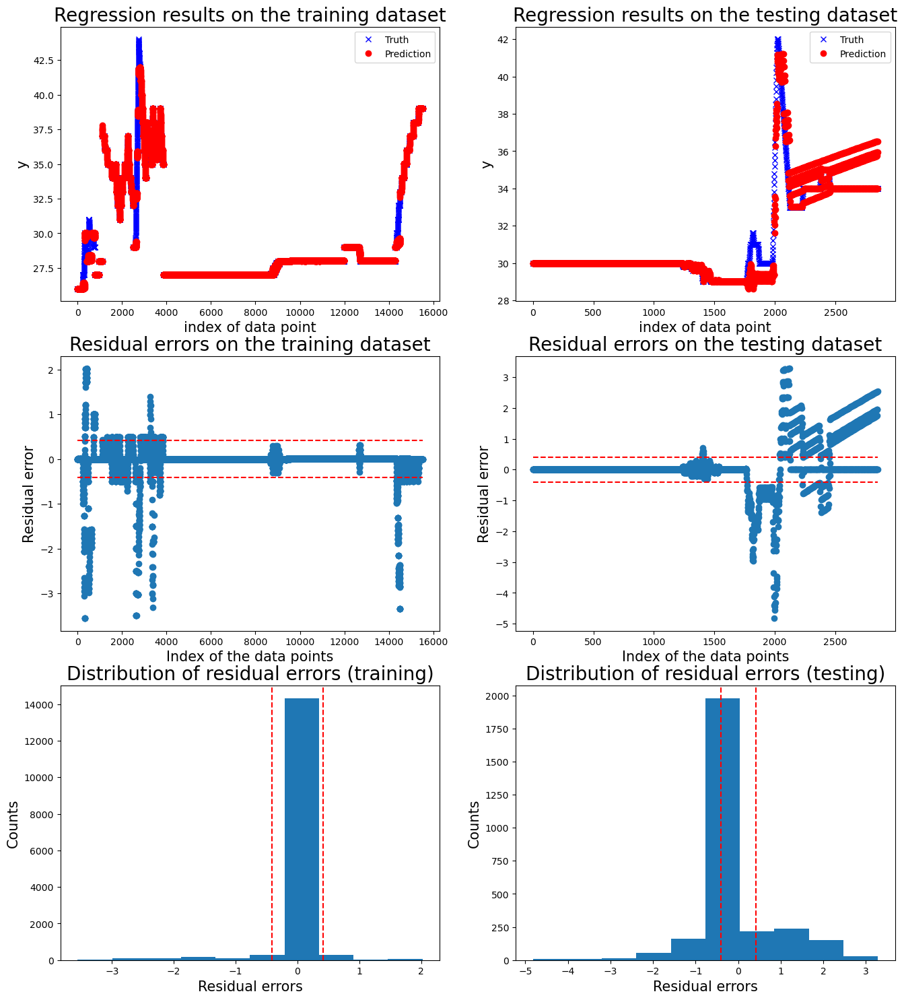

Motor  3
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:16<00:00,  5.35s/it]



 New run:

training performance, max error is: 3.4686951561994803
training performance, mean root square error is: 1.2038945982710811
training performance, residual error > 0.15: 61.441213653603036%

 New run:

testing performance, max error is: 3.2900790433547087
testing performance, mean root square error is: 1.273443707427651
testing performance, residual error > 0.15: 57.63451907024528%


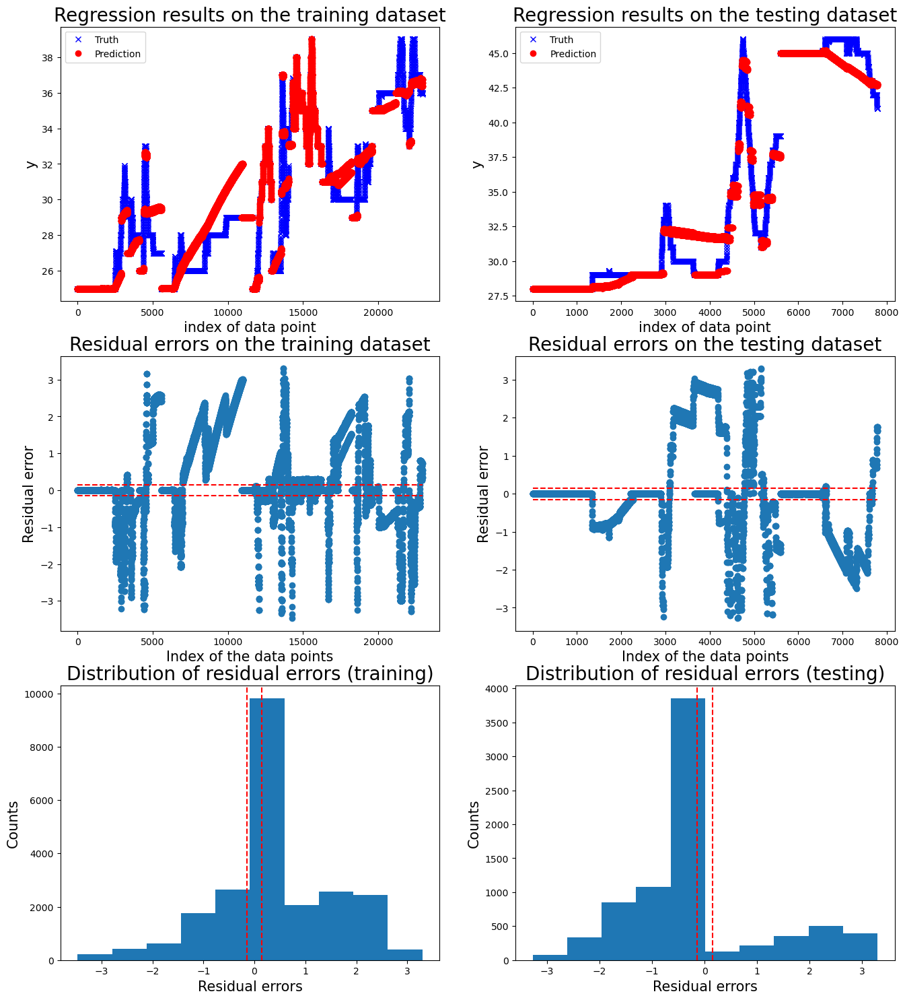

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:06<00:00,  2.01s/it]



 New run:

training performance, max error is: 4.300054373738689
training performance, mean root square error is: 0.13209398197810904
training performance, residual error > 0.5: 0.3804156393096161%

 New run:

testing performance, max error is: 4.39646085857602
testing performance, mean root square error is: 0.29575389320502693
testing performance, residual error > 0.5: 4.464285714285714%


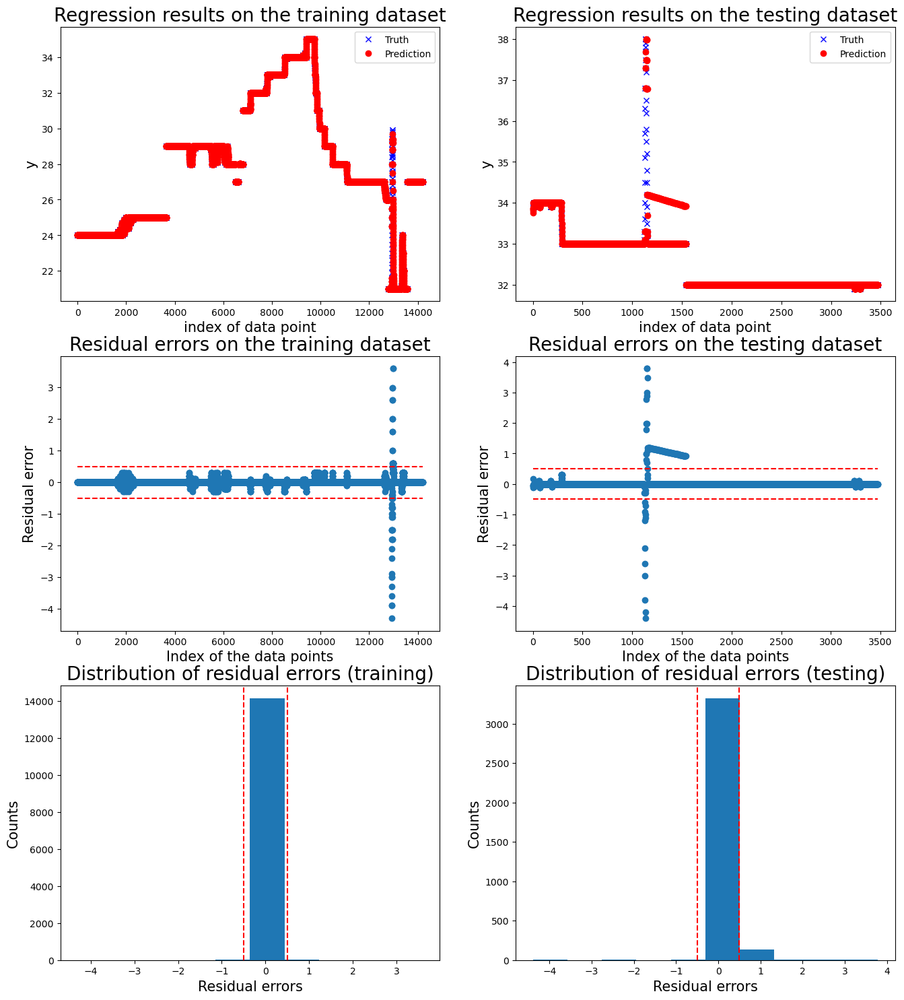

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.40s/it]



 New run:

training performance, max error is: 3.68590989785055
training performance, mean root square error is: 0.8311663649115585
training performance, residual error > 0.1: 25.562359007412184%

 New run:

testing performance, max error is: 1.9926857402684028
testing performance, mean root square error is: 0.2870322355773699
testing performance, residual error > 0.1: 9.894736842105264%


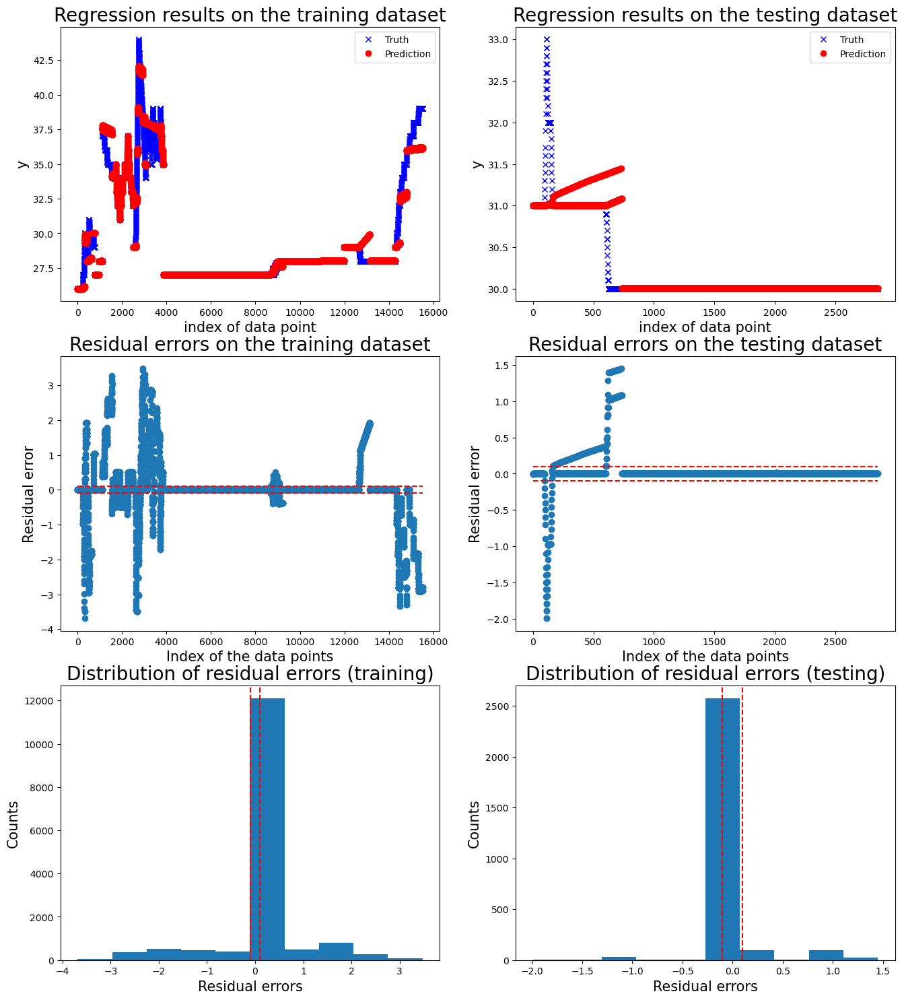

Motor  4
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:15<00:00,  5.02s/it]



 New run:

training performance, max error is: 2.9977968189528177
training performance, mean root square error is: 0.2789798237226491
training performance, residual error > 0.7076551876380313: 4.782703647084516%

 New run:

testing performance, max error is: 3.228740599842155
testing performance, mean root square error is: 0.7789975885516606
testing performance, residual error > 0.7076551876380313: 15.125401929260452%


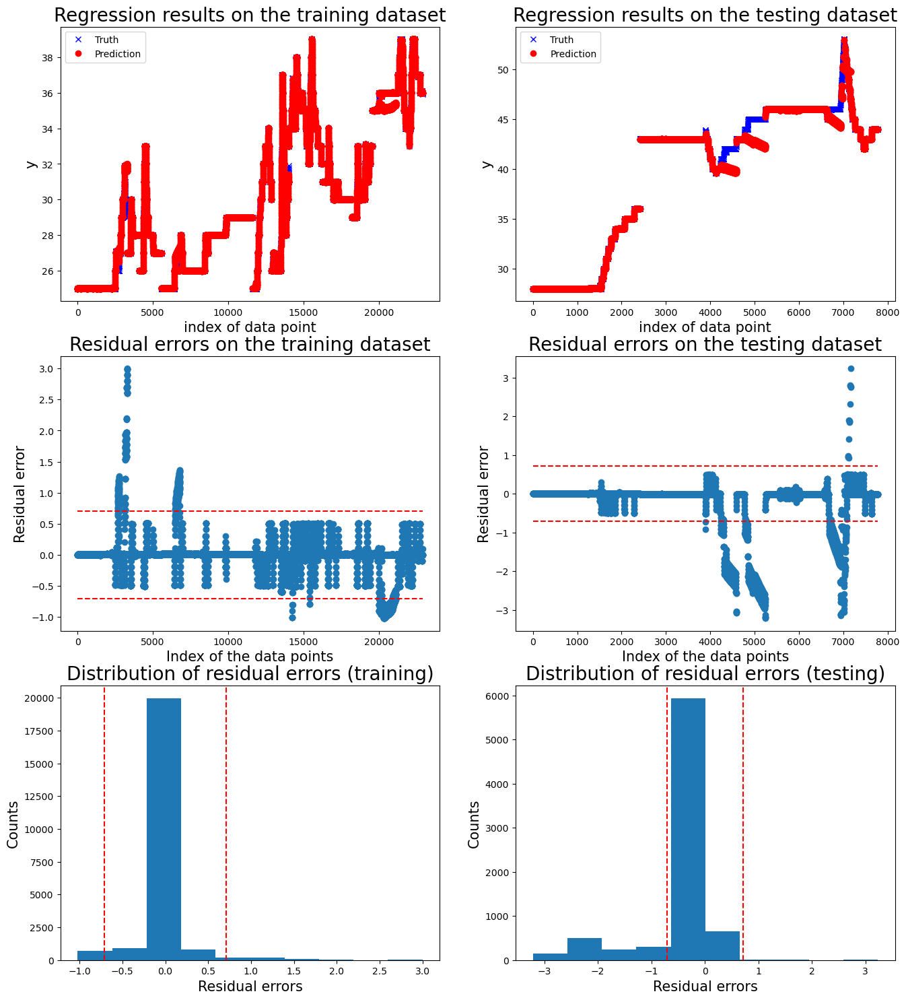

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:05<00:00,  1.83s/it]



 New run:

training performance, max error is: 5.4909109015649555
training performance, mean root square error is: 0.6188152552547032
training performance, residual error > 0.5: 11.52298241897903%

 New run:

testing performance, max error is: 6.927302594633304
testing performance, mean root square error is: 0.4724644144725126
testing performance, residual error > 0.5: 7.08092485549133%


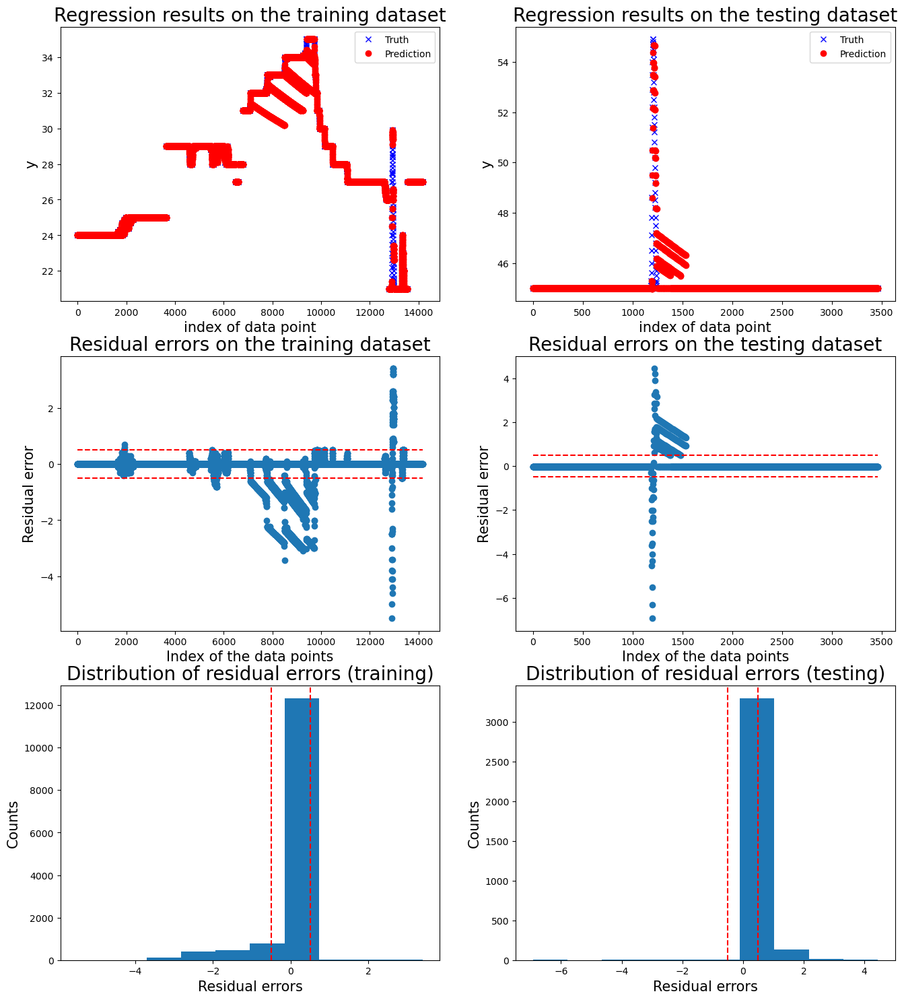

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.30s/it]



 New run:

training performance, max error is: 0.30015326448223334
training performance, mean root square error is: 0.016642960196253293
training performance, residual error > 1: 0.0%

 New run:

testing performance, max error is: 0.1497344554064668
testing performance, mean root square error is: 0.010986179895846224
testing performance, residual error > 1: 0.0%


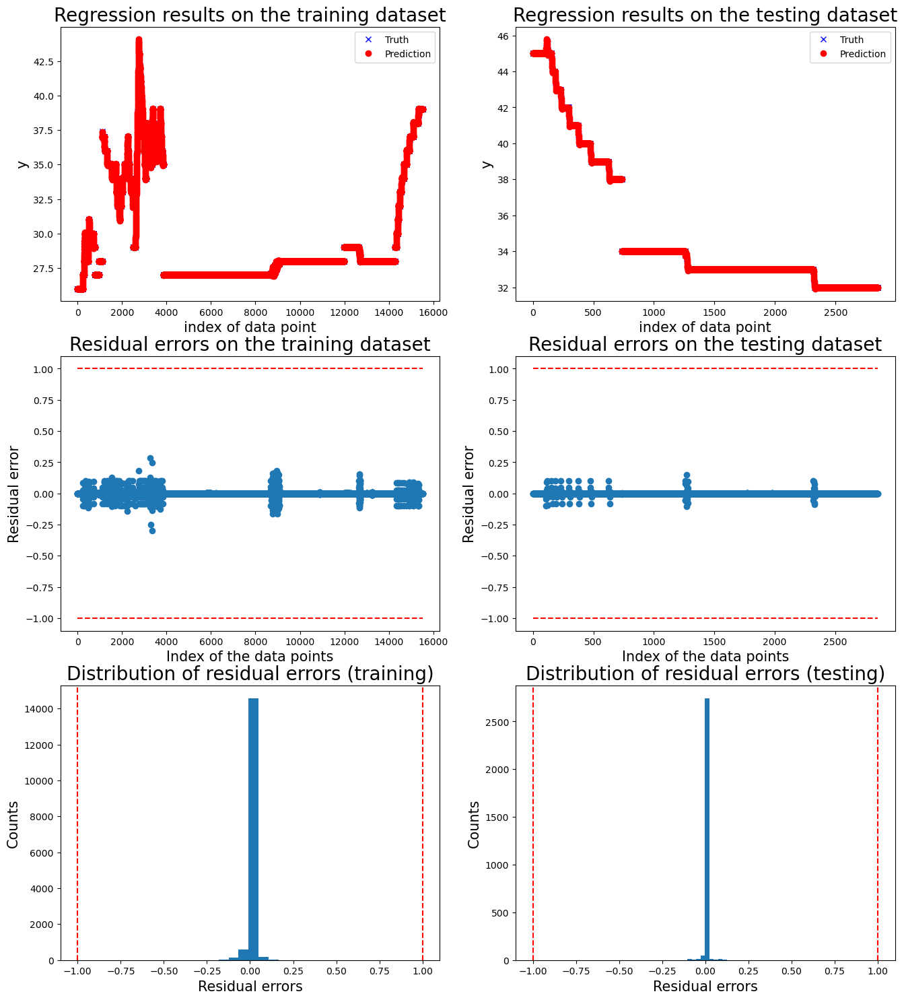

Motor  5
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:12<00:00,  4.12s/it]



 New run:

training performance, max error is: 3.027556552834696
training performance, mean root square error is: 0.31802069997253435
training performance, residual error > 0.5669804464264244: 5.922690543786853%

 New run:

testing performance, max error is: 3.8589964405334882
testing performance, mean root square error is: 0.24938228807989368
testing performance, residual error > 0.5669804464264244: 0.6688102893890675%


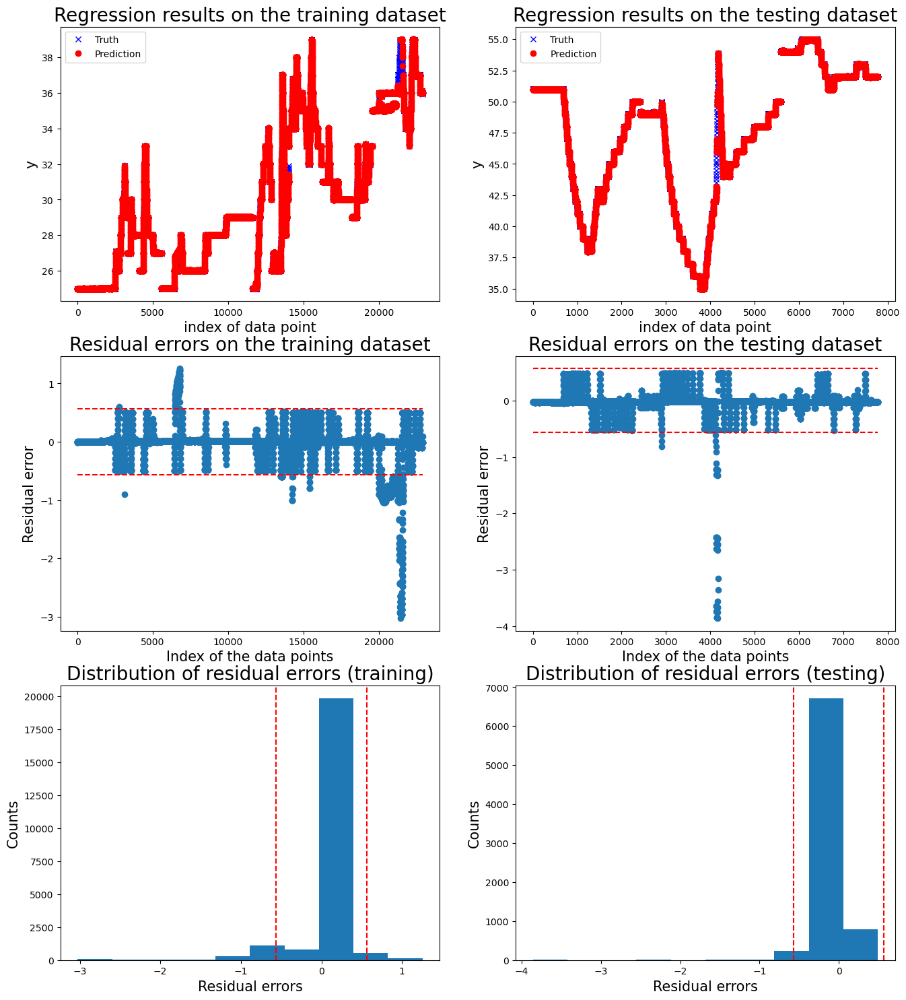

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:05<00:00,  1.70s/it]



 New run:

training performance, max error is: 5.462274465076387
training performance, mean root square error is: 0.5473318539598958
training performance, residual error > 0.5: 9.658970557085363%

 New run:

testing performance, max error is: 5.053494342067644
testing performance, mean root square error is: 0.5343062956342112
testing performance, residual error > 0.5: 7.023121387283238%


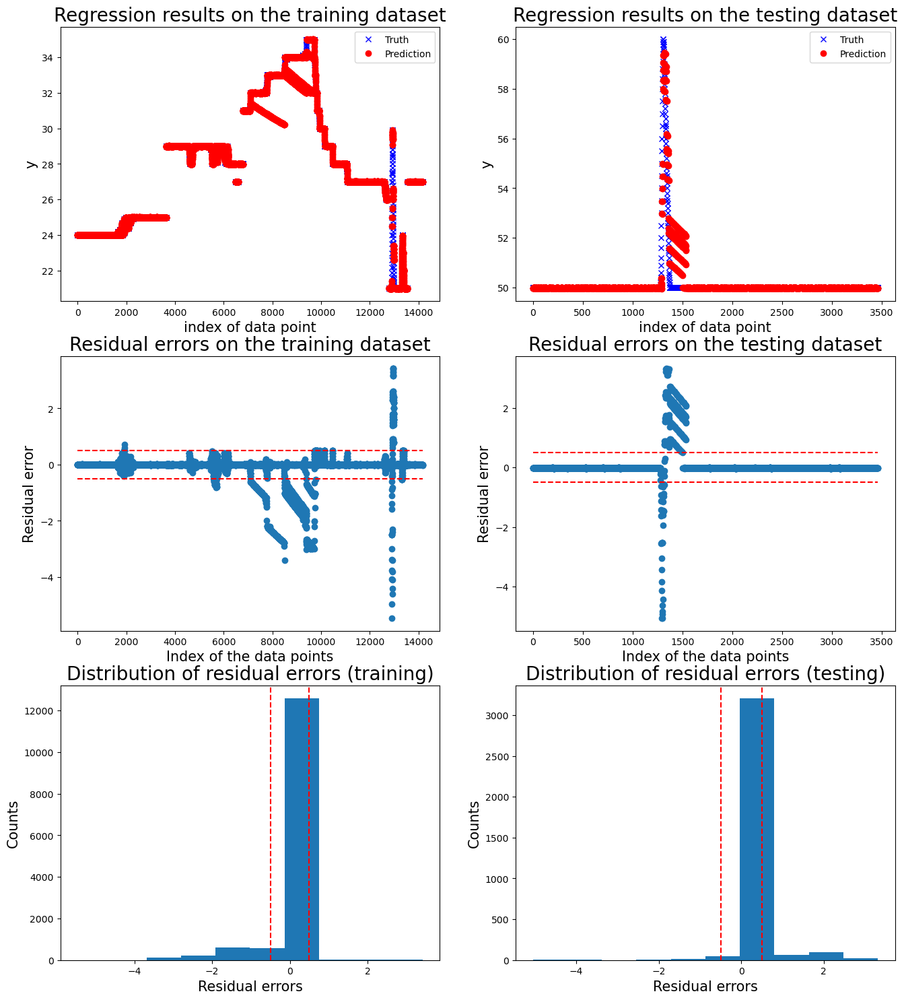

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.34s/it]



 New run:

training performance, max error is: 3.3366653202551433
training performance, mean root square error is: 0.15242237992367808
training performance, residual error > 0.5: 1.6757976152110858%

 New run:

testing performance, max error is: 0.49472590208532097
testing performance, mean root square error is: 0.08854043344255817
testing performance, residual error > 0.5: 0.0%


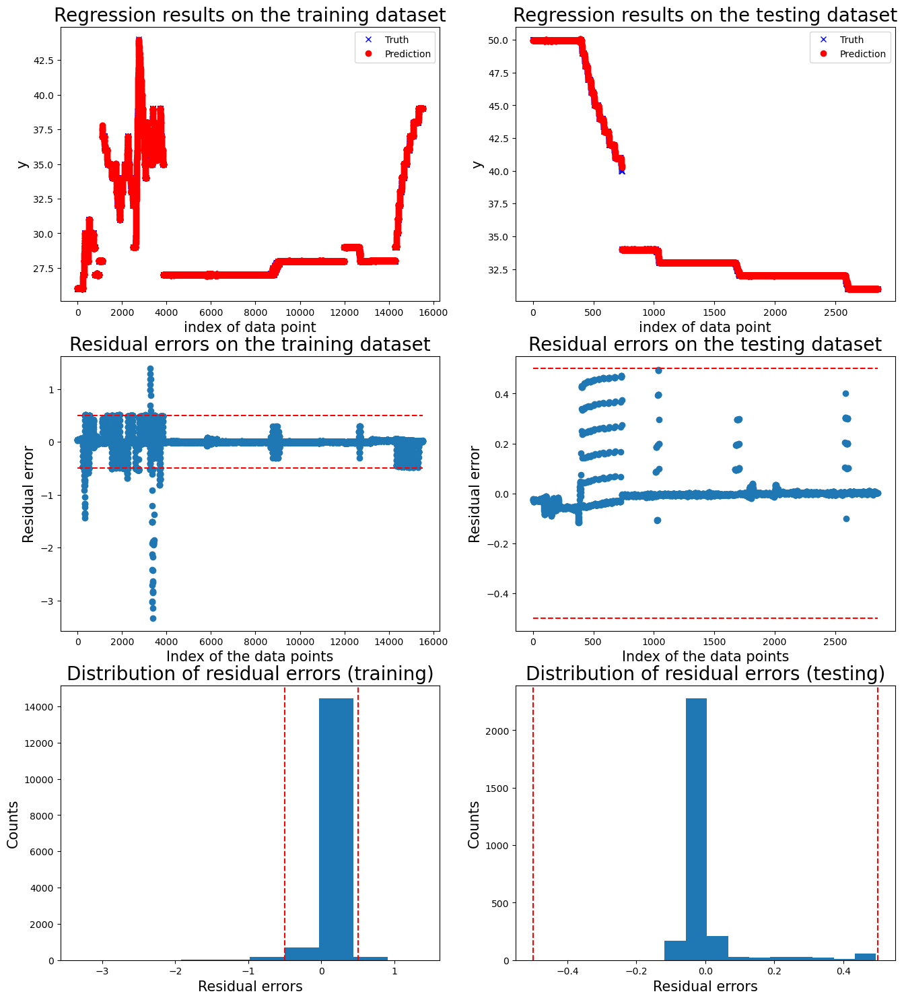

Motor  6
Operation:  Transfer goods
['20240527_094865', '20240527_100759', '20240527_101627']


100%|██████████| 3/3 [00:12<00:00,  4.08s/it]



 New run:

training performance, max error is: 3.2354003087117
training performance, mean root square error is: 0.5548240297479572
training performance, residual error > 0.5: 9.611583544012872%

 New run:

testing performance, max error is: 3.366811824976331
testing performance, mean root square error is: 0.4015813876724313
testing performance, residual error > 0.5: 6.868167202572348%


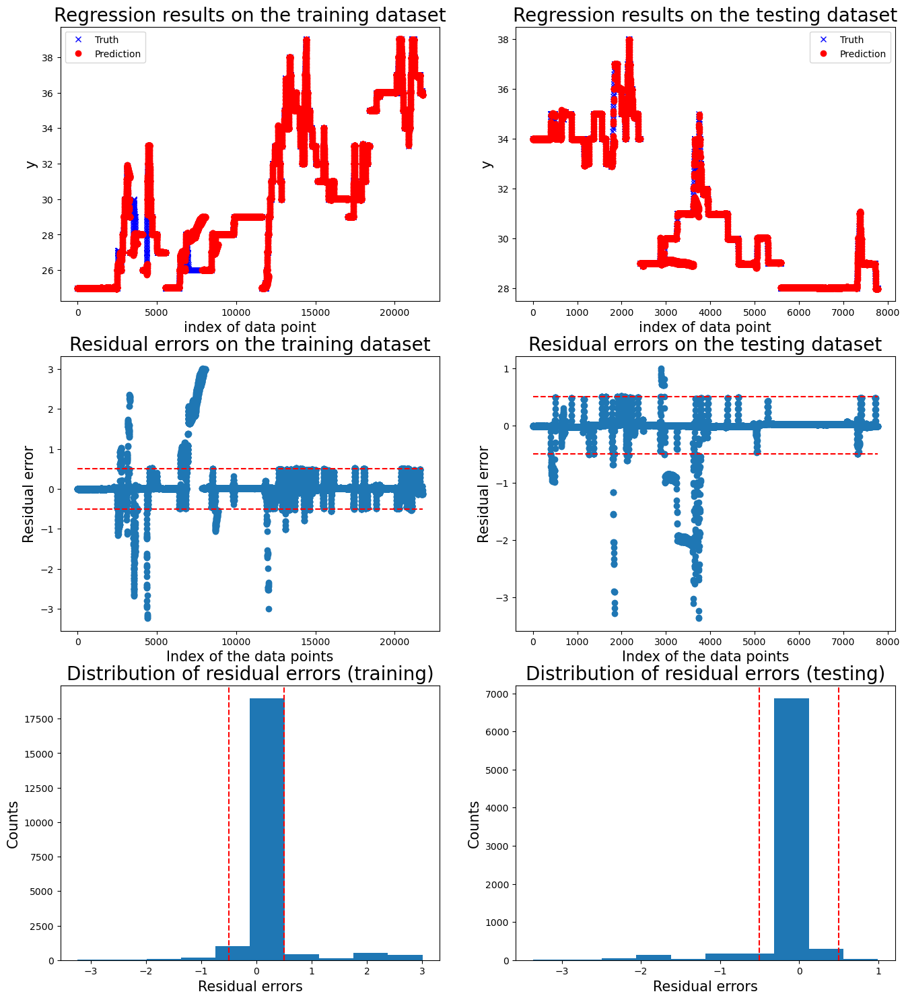

Operation:  Not moving
['20240527_102436', '20240527_102919', '20240527_103311']


100%|██████████| 3/3 [00:05<00:00,  1.74s/it]



 New run:

training performance, max error is: 0.5044669064234455
training performance, mean root square error is: 0.06344559242750678
training performance, residual error > 0.6: 0.0%

 New run:

testing performance, max error is: 5.490991523403963
testing performance, mean root square error is: 0.5137017421850747
testing performance, residual error > 0.6: 8.208092485549132%


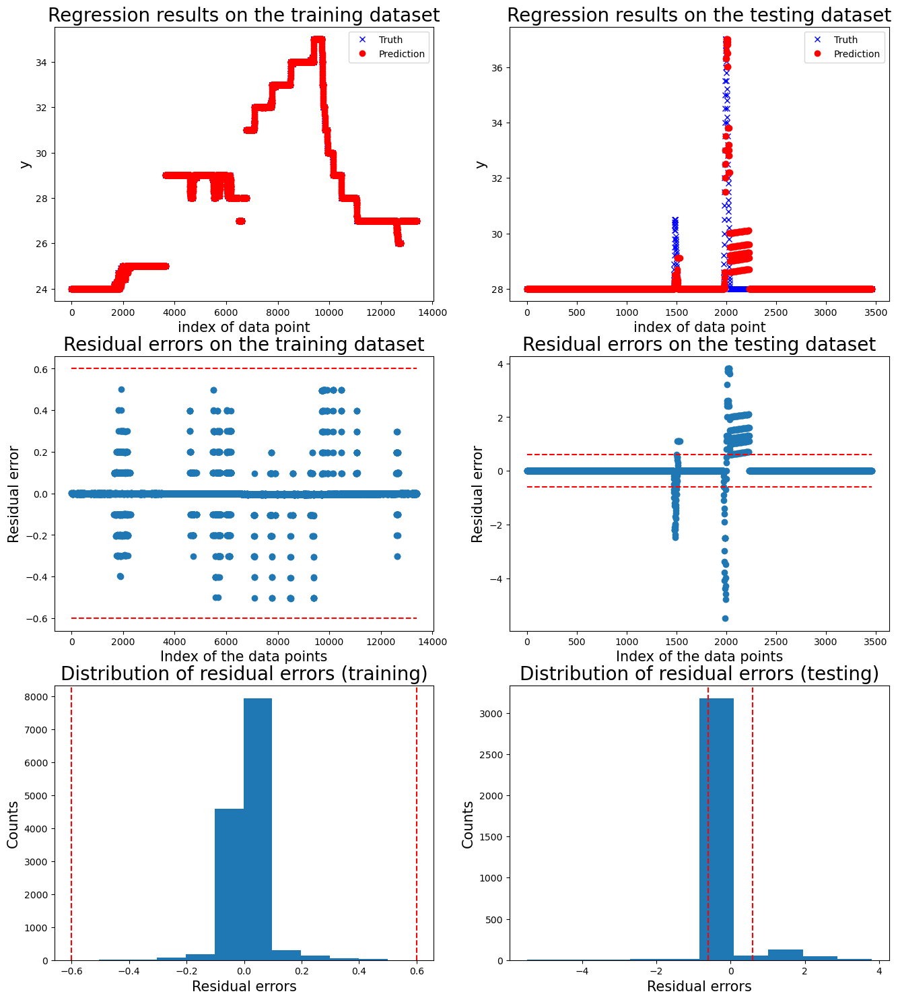

Operation:  Moving one motor
['20240527_103690', '20240527_104247']


100%|██████████| 2/2 [00:04<00:00,  2.08s/it]



 New run:

training performance, max error is: 3.310530391536826
training performance, mean root square error is: 0.2515943110780738
training performance, residual error > 0.5: 2.2462386098749736%

 New run:

testing performance, max error is: 4.533275541493154
testing performance, mean root square error is: 0.3637701647858652
testing performance, residual error > 0.5: 6.035087719298246%


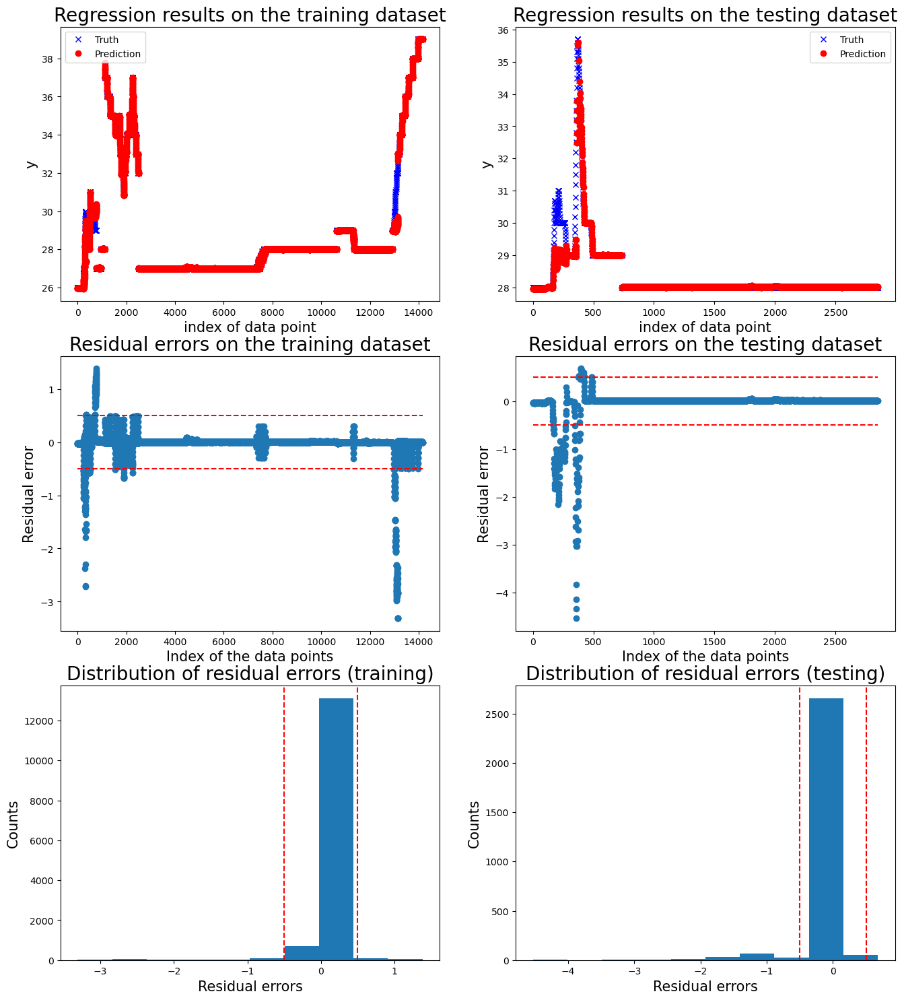

In [21]:
# Attempt 3 - 30,0% on Public Result

sys.path.insert(0, 'C:/Users/gioca/GitHub/projects/maintenance_industry_4_2024/supporting_scripts/WP_4_20240528/')
from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg, read_all_csvs_one_test, run_cv_one_motor, show_reg_result, show_clf_result

df_pred_dict = {}

for motor_number in range(1, 7):
    print("Motor ", motor_number)
    
    df_pred = pd.DataFrame(columns=['time', f'data_motor_{motor_number}_label', 'test_condition'])
    df_pred['time'] = df_te['time']
    df_pred['test_condition'] = df_te['test_condition']

    # Inizializzazione di all_results
    all_results = []

    train_conditions = find_train_conditions_for_motor_x(df_tr, motor_number)
    df_train_motor = df_tr[df_tr['test_condition'].isin(train_conditions)]
    df_test_motor = df_te.copy()

    for operation in list_operations:
        print("Operation: ", operation)

        df_train = df_train_motor[df_train_motor['operation']==operation]
        df_test = df_test_motor[df_test_motor['operation']==operation]

        # df_train['delta_position'] = df_train[f'data_motor_{motor_number}_position'].diff().fillna(0)
        # df_test['delta_position'] = df_test[f'data_motor_{motor_number}_position'].diff().fillna(0)

        features_x = [f'data_motor_{motor_number}_position', f'data_motor_{motor_number}_voltage']

        tests = pd.unique(df_test.test_condition).tolist()
        print(tests)

        if len(tests) != 0:
            if ((motor_number == 1 and operation == 'Not moving') or (motor_number == 2 and operation == 'Moving one motor')):
               results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=10, ss=5, plt=1, thr=0.4, al=3, testid=tests, motor=motor_number) 
            elif (motor_number == 3 and operation == 'Transfer goods'):
               results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=6, ss=3, plt=1, thr=0.15, al=3, testid=tests, motor=motor_number)
            elif (motor_number == 3 and operation == 'Not moving'):
               results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=6, ss=3, plt=1, thr=0.5, al=3, testid=tests, motor=motor_number)  
            elif (motor_number == 3 and operation == 'Moving one motor'):
               results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=10, ss=5, plt=1, thr=0.1, al=3, testid=tests, motor=motor_number)      
            elif (motor_number == 4 and operation == 'Moving one motor'):
               results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=10, ss=1, plt=1, thr=1, al=3, testid=tests, motor=motor_number)
            elif (motor_number == 6 and operation == 'Not moving'):
               results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=10, ss=5, plt=1, thr=0.6, al=3, testid=tests, motor=motor_number)
            else:
               results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=10, ss=5, plt=1, thr=0.5, al=3, testid=tests, motor=motor_number)
            
            # Aggiungiamo il tempo ai risultati
            results_with_time = [(time, result) for time, result in zip(df_test['time'], results)]
            
            # Concateniamo i risultati a all_results
            all_results.extend(results_with_time)

    # Inseriamo i valori di all_results nella colonna corrispondente di df_pred
    for time, result in all_results:
        df_pred.loc[df_pred['time'] == time, f'data_motor_{motor_number}_label'] = result

    # Dove non c'è corrispondenza, inseriamo 0
    df_pred[f'data_motor_{motor_number}_label'].fillna(0, inplace=True)
    
    # Salviamo il DataFrame df_pred nel dizionario df_pred_dict
    df_pred_dict[motor_number] = df_pred

df_pred = df_pred_dict[1][['time', 'test_condition']]

for i in range (1, 7):
    df_pred[f'data_motor_{i}_label'] = df_pred_dict[i][[f'data_motor_{i}_label']]

df_pred.drop(columns=['time'], inplace=True)
df_pred.reset_index(inplace=True)
df_pred.rename(columns={'index': 'idx'}, inplace=True)
test_condition = df_pred.pop('test_condition')
df_pred['test_condition'] = test_condition

df_pred.to_csv('df_pred_new_try.csv', index=False)

# Hyper Parameter Tuning Analysis

Looking at the graphs we noticed that the results are often in contrast with F1 score. We can sum-up with these statements:

1. Hyper parametr tuning should be performed using avarage and anlyzing datasets individually even if in the same operation mode to avoid connection among datasets;
2. Having more datasets with failure would improve the reliability of the F1 score;
3. The model has a great property: the explainaibility, since we can observe if the results are in line with our expectations looking at the graphs.

# Explainability Exploitation

We found three possible ways to develop our model.
Firstly we could use parameters obtained before ignoring the fact that graphs are not in line with results, which is not a good idea.
Secondly we could try different parameters looking at the F1 score of public dataset, but the model would be overfitted on those data. 
Finally we could exploit explainaibility looking at the graphs of the entire dataset. We chose this last option knowing that the corresponding parameter choice for each motor could be overfitted on the public plus private, but considering that we divided by motor and by operation mode we are confident that the entire dataset is big enough to create a robust model also for future challenges.

# Numerical Results and Quantitative Approach

Regarding the data preprocessing, we based our approach on the Work Packages, and we decided to Remove Outliers and Smooth the original data.

As explained in the previous sections, the first decision of our proposed methodology for the Regression Based models has been the feature selection. By analyzing the results obtained in the previous Work Packages, we noted that a narrow selection of features was the one ensuring the best results. In particular, in the past analysis, we compared the following possible selections:
- all the features;
- all the features but the voltage ones;
- the features with a correlation with the temperature higher than 0,25;
- only the temperature and voltage features of the motor under analysis.
Out of these possibilities, the last has always proven to be the one ensuring the best results, so we considered it to be the starting point of our approach.

As explained, to make our model more accurate, we tried to adapt it on two levers: the motor and the operation mode. In fact, our aim was to identify a set of parameters (window size, sample step and threshold) specific for each motor in each operation mode, so that our solution in the end could be the most specific and accurate. By doing this, in the end we could have obtained up to 18 models. At this point, counting on the results obtained in the WP3, we already had a sample of generally possible valid parameters for the fault detection. To understand which of these results could be the best, we tried a "hyper-parameter tuning" approach which gave the following results:

| Model (ws, ss, thr)  | Motor 1 | Motor 2 | Motor 3 | Motor 4 | Motor 5 | Motor 6 |
|----------------------|---------|---------|---------|---------|---------|---------|
| 10, 10, 1 |      30,0%     |    79,1%     |    8,24%     |     78,9%    |    13,6%     |    28,1%     | 
| 16,  8,  0.15 |    35,9%       |    73,3%     |    9,9%     |    63,0%     |     14,5%    |    32,3%     |
| 16,  8,  0.5 |      40,0%     |    71,0%     |    10,9%     |    51,8%     |    13,1%     |    34,0%     |
| 10,  5,  0.5 |      43,0%     |    50,8%     |    9,4%     |    41,0%     |     9,5%    |    52,9%     |
| 20, 10,  0.2 |     36,8%      |      74,1%   |        10,1% |    61,5%     |    14,2%     |    32,6%     |
| 20, 10,  0.5 |     39,4%      |     70,9%    |    10,4%     |     53,1%    |     12,5%    |     31,7%    |         
| 50, 10,  1 |     19,1%      |     7,2%    |     4,5%    |     7,9%    |    11,1%     |     33,3%    |         
| 100, 50,  1 |     35,7%      |     33,1%    |    8,4%     |     30,4%    |    10,8%     |    31,7%     |        
| 6,  3,  0.5|     0,1%      |    2,0%     |    11,2%     |    3,1%     |   7,8%      |    43,1%     |         
| 10,  3,  0.15 |    35,1%       |     73,5%    |    71,3%     |   71,3%      |    14,7%     |    31,9%     |      
| 20,  5,  0.5 |     43,6%      |      17,1%   |     48,9%    |     48,9%    |     15,3%    |     48,0%    |       
| 20,  5,  0.15 |         34,4%  |     76,1%    |    66,9%     |     66,9%    |     14,8%    |     34,3%    |      

Looking at these F1 results, obtained by training the model for each motor in datasets without any failure for each of three conditions (Transfer goods, Not moving and Moving one motor) and testing it on datasets of that condition with failures of that motor, we chose two possible strategies. These approaches are given by the trade-off between precision and overfitting (on the testing datasets).

The first was trying to find a model enabling to achieve a balanced and trustable result for each model and for each operation mode. Looking at the results and the graphs of the predicted vs actual temperature, we found that this model was the following: ws = 10, ss = 5, thr = 0,5. This solution had already given good results in the Work Package 3, so we believed it could be versatile, avoiding the over-fitting problem, but of course it lacked in accuracy. This approach are reported in Attempt 1 and 2.

The second approach was the opposite: we picked for each motor the model which on our testing condition gave the highest results (among those reported in the table above). This solution can be considered more accurate, but the over-fitting risk is higher, since the high F1 scores could be particularly good for the specific datasets we used even if the model isn't good in general. After this, we looked at the plots of the predicted vs actual temperature and we tried to figure out how to improve the model, and we decided to adjust our parameters for each of the 18 cases. This approach is reported in Attempt 3. In the end we chose the following parameters: [ws, ss, thr]

|   | Transfer Goods | Not Moving | Moving One Motor | 
|-----------------|----------------|------------|------------------|
| Motor 1 |      10, 5, 0.5     |   10, 5, 0.4      |    10, 5, 0.5     |
| Motor 2 |      10, 5, 0.5     |    10, 5, 0.5     |    10, 5, 0.4     |
| Motor 3 |      6, 3, 0.15     |    6, 3, 0.15     |    10, 5, 0.1     |
| Motor 4 |      10, 5, 0.5     |    10, 5, 0.5     |    10, 5, 0.5     |
| Motor 5 |      10, 5, 0.5     |    10, 5, 0.5     |    10, 5, 0.5     |
| Motor 6 |      10, 5, 0.5     |    10, 5, 0.6     |    10, 5, 0.5     |

# Possible Improvements

Looking at the results we have seen how analyzing carefully the way regression based models work is fundamental. Probably the results that are not good looking at the graph would have lower F1 score with more data tests.
So in general, to obtain better results we should get more data with failures in order to test properly the regression based model allowing a better hyper parameter tuning process. In general, more failure datasets could be also used to train classification models and to consider the adoption of different algorithms for different motors.

We decided to improve our model in the following way:
- testing the model trained for specific operation modes of specific motors on each single dataset instead of aggregate datasets;
- lowering the abnormal limit parameter.

Motor  1
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:04<00:00,  4.44s/it]



 New run:

training performance, max error is: 4.389923389784549
training performance, mean root square error is: 1.0416782638714899
training performance, residual error > 0.4022920755655659: 18.610844320265432%

 New run:

testing performance, max error is: 0.32842201980832897
testing performance, mean root square error is: 0.068094543535419
testing performance, residual error > 0.4022920755655659: 0.0%


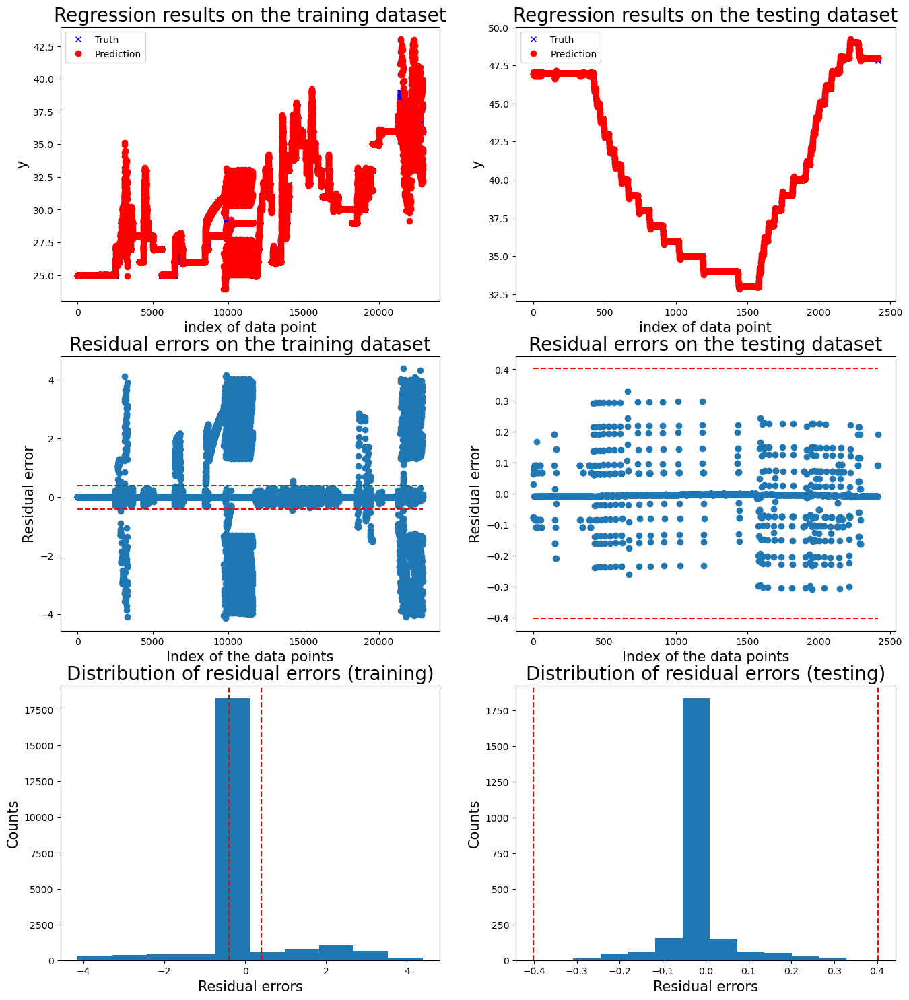

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:04<00:00,  4.87s/it]



 New run:

training performance, max error is: 4.389923389784549
training performance, mean root square error is: 1.0416782638714899
training performance, residual error > 0.3: 18.955732122587968%

 New run:

testing performance, max error is: 4.3186240564370095
testing performance, mean root square error is: 1.7161550481820684
testing performance, residual error > 0.3: 40.92481912551117%


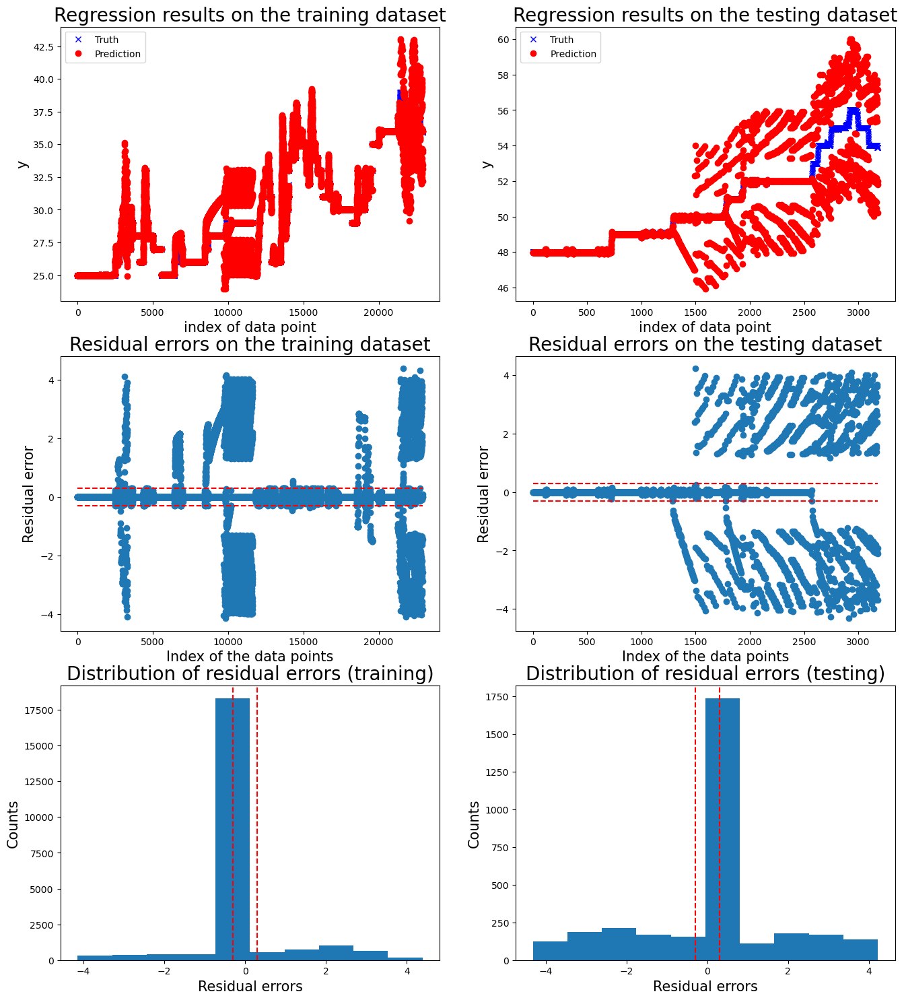

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.45s/it]



 New run:

training performance, max error is: 4.389923389784549
training performance, mean root square error is: 1.0416782638714899
training performance, residual error > 0.3: 18.955732122587968%

 New run:

testing performance, max error is: 4.482378802939756
testing performance, mean root square error is: 1.2968637127912725
testing performance, residual error > 0.3: 22.802197802197803%


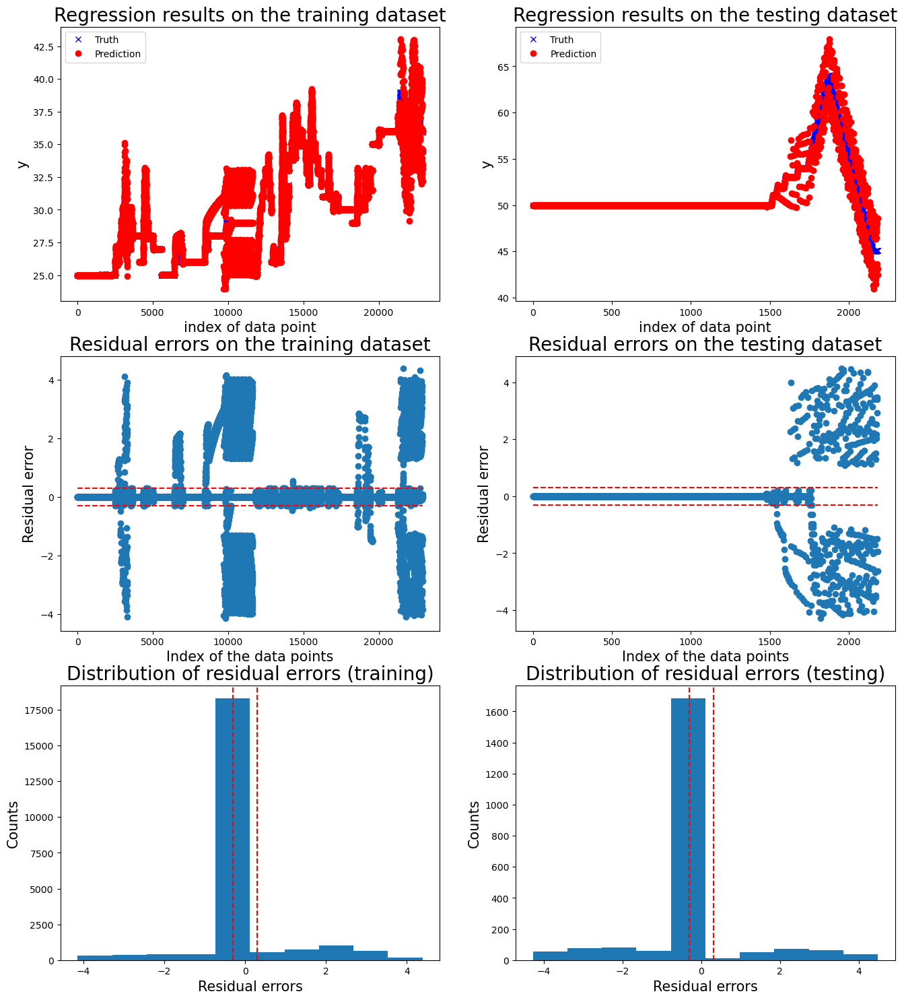

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.46s/it]



 New run:

training performance, max error is: 4.369878475366317
training performance, mean root square error is: 1.3767564989898005
training performance, residual error > 0.4086407851484997: 38.064325759811155%

 New run:

testing performance, max error is: 0.38722995668626226
testing performance, mean root square error is: 0.053647396172367995
testing performance, residual error > 0.4086407851484997: 0.0%


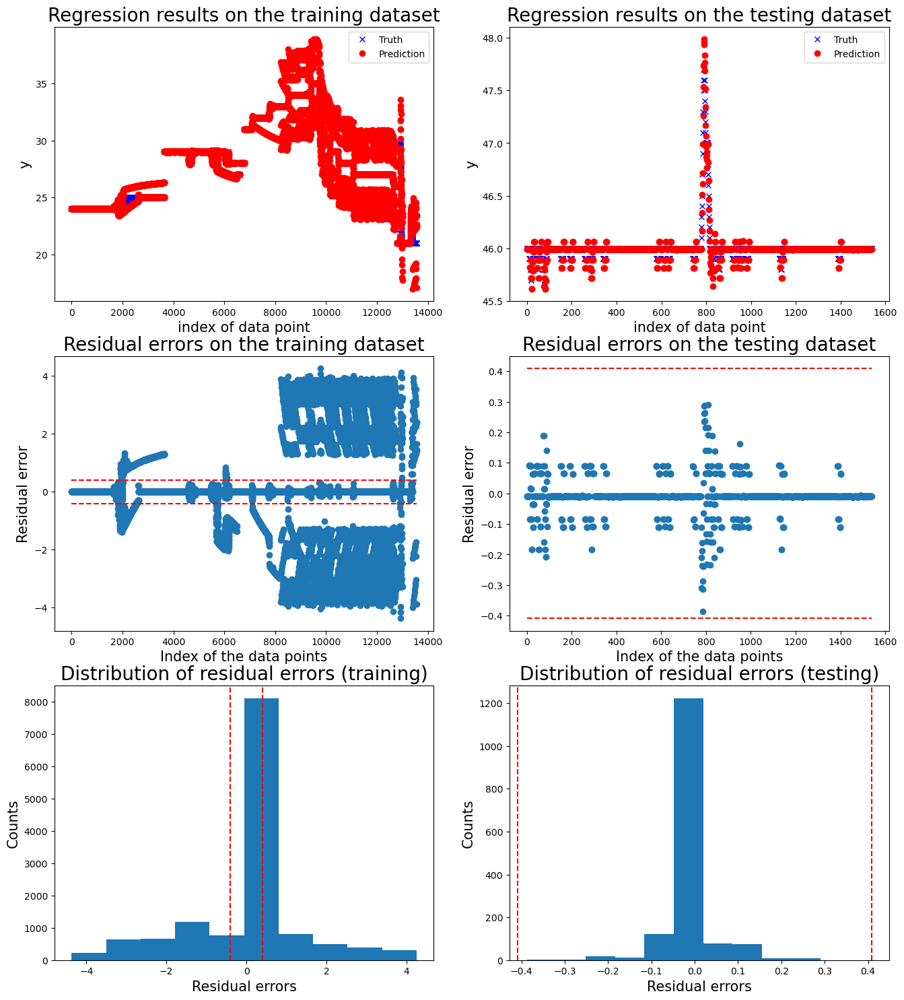

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:01<00:00,  1.63s/it]



 New run:

training performance, max error is: 4.369878475366317
training performance, mean root square error is: 1.3767564989898005
training performance, residual error > 0.3: 38.63233992328121%

 New run:

testing performance, max error is: 0.20847710130708208
testing performance, mean root square error is: 0.04132482516068366
testing performance, residual error > 0.3: 0.0%


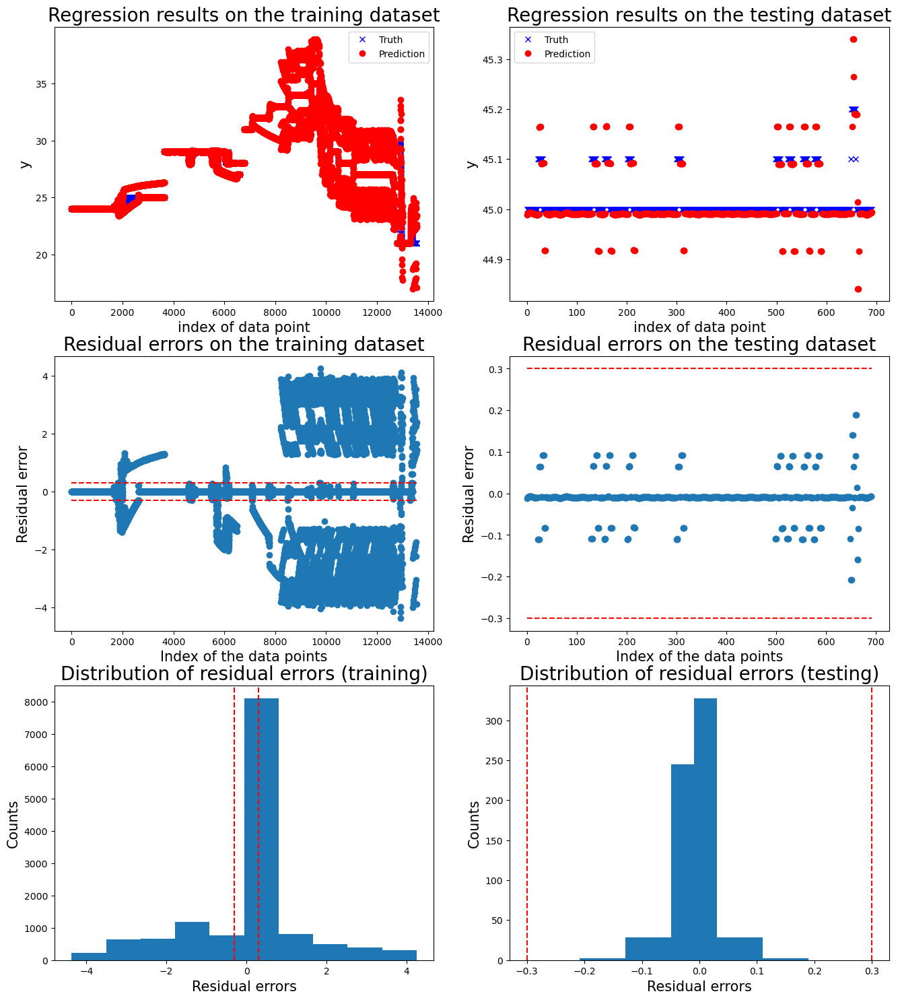

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:02<00:00,  2.14s/it]



 New run:

training performance, max error is: 4.369878475366317
training performance, mean root square error is: 1.3767564989898005
training performance, residual error > 0.3: 38.63233992328121%

 New run:

testing performance, max error is: 0.28494415378782634
testing performance, mean root square error is: 0.04184980065326178
testing performance, residual error > 0.3: 0.0%


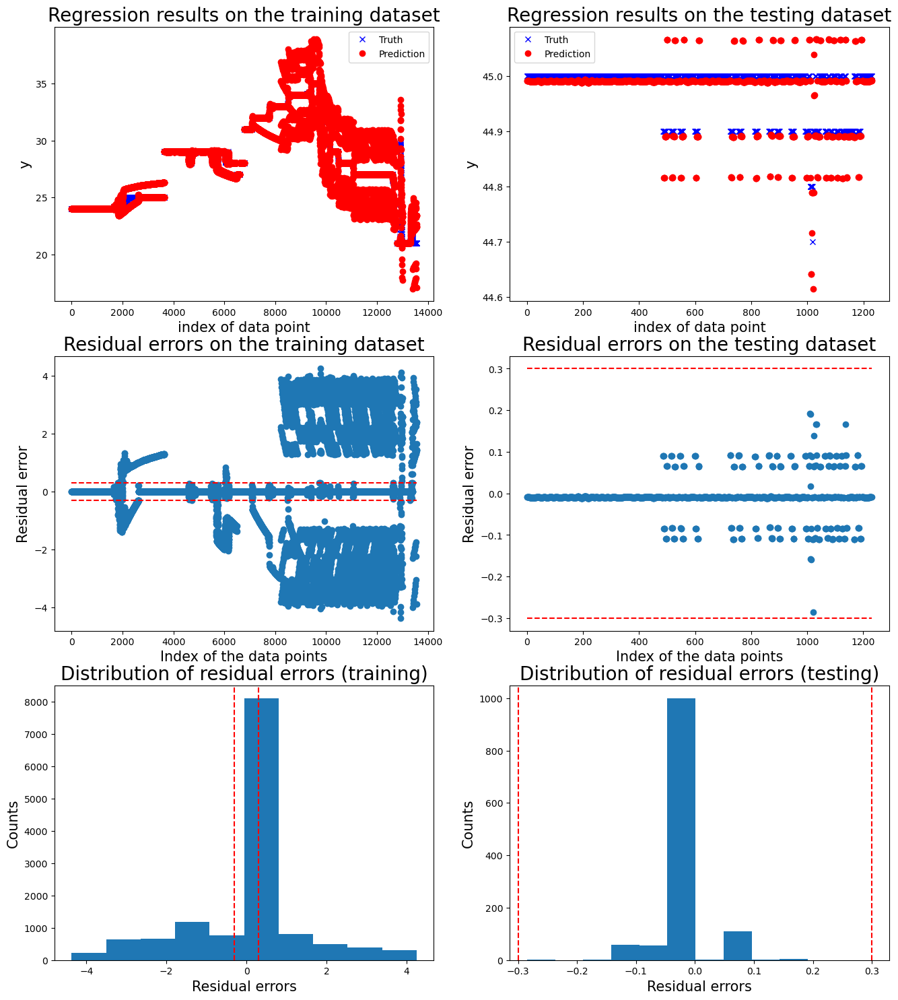

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:01<00:00,  1.08s/it]



 New run:

training performance, max error is: 4.724806195765083
training performance, mean root square error is: 0.6851288906489605
training performance, residual error > 1.2180679486407944: 6.568193008370262%

 New run:

testing performance, max error is: 4.491492790316293
testing performance, mean root square error is: 0.7896442233545496
testing performance, residual error > 1.2180679486407944: 7.055630936227951%


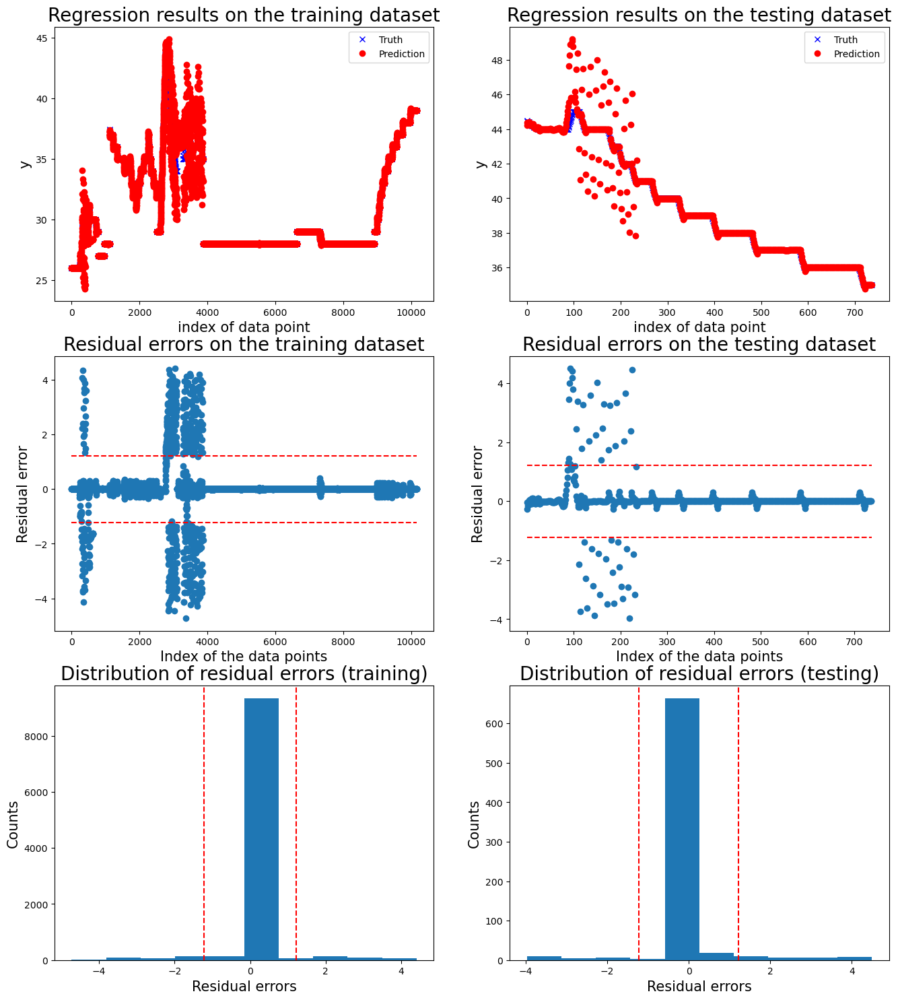

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.97s/it]



 New run:

training performance, max error is: 4.724806195765083
training performance, mean root square error is: 0.6851288906489605
training performance, residual error > 0.3: 7.287050713934022%

 New run:

testing performance, max error is: 4.2563655564729785
testing performance, mean root square error is: 1.2014392213452993
testing performance, residual error > 0.3: 25.91016548463357%


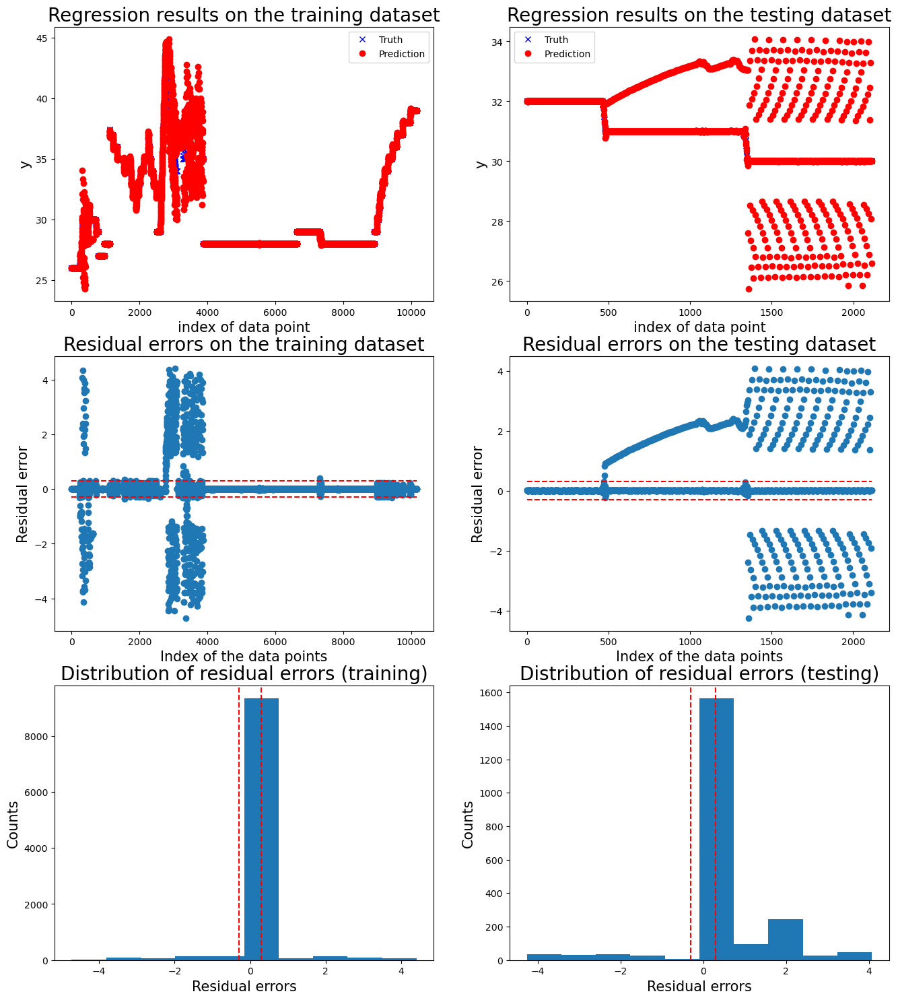

Motor  2
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:04<00:00,  4.59s/it]



 New run:

training performance, max error is: 1.0026354489866307
training performance, mean root square error is: 0.12215567105797226
training performance, residual error > 0.7: 0.04367765887748416%

 New run:

testing performance, max error is: 0.5000585434065528
testing performance, mean root square error is: 0.07279278121450446
testing performance, residual error > 0.7: 0.0%


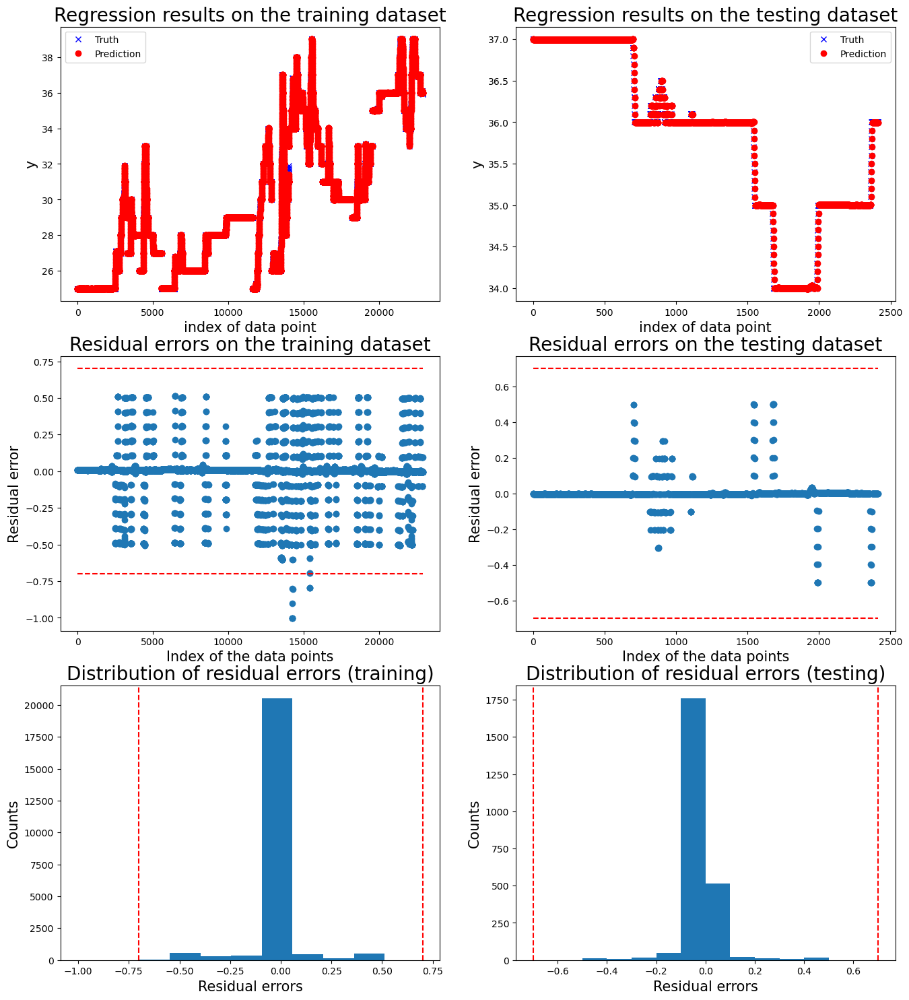

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:05<00:00,  5.52s/it]



 New run:

training performance, max error is: 1.0026354489866307
training performance, mean root square error is: 0.12215567105797226
training performance, residual error > 0.7: 0.04367765887748416%

 New run:

testing performance, max error is: 0.5026228551706922
testing performance, mean root square error is: 0.07281939402808203
testing performance, residual error > 0.7: 0.0%


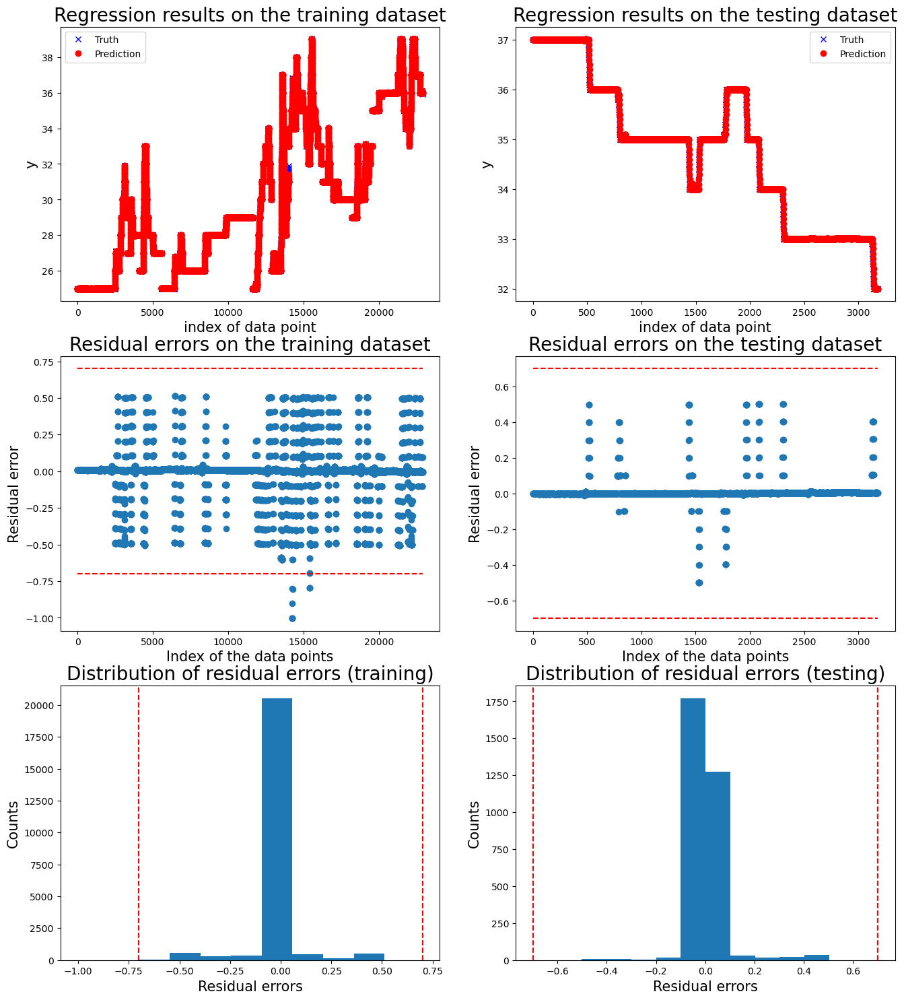

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.71s/it]



 New run:

training performance, max error is: 1.0026354489866307
training performance, mean root square error is: 0.12215567105797226
training performance, residual error > 0.7: 0.04367765887748416%

 New run:

testing performance, max error is: 0.4948273199376203
testing performance, mean root square error is: 0.05031937361447325
testing performance, residual error > 0.7: 0.0%


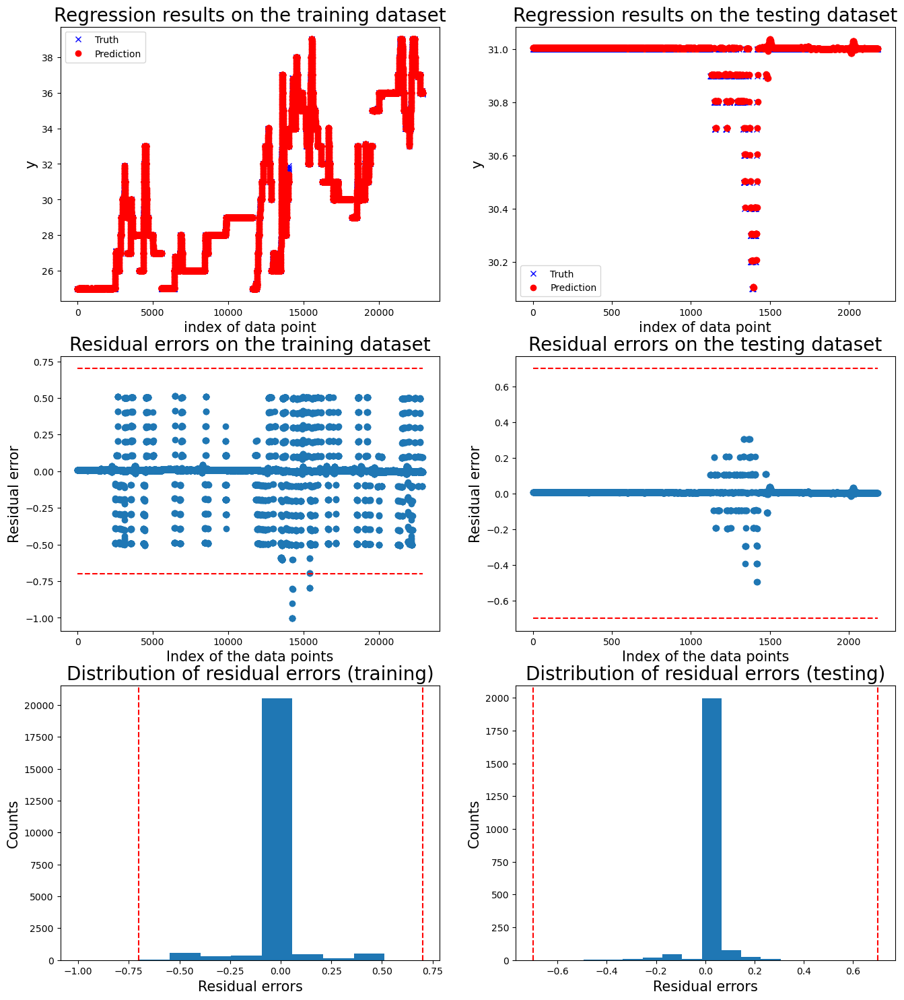

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.19s/it]



 New run:

training performance, max error is: 2.4989447515484144
training performance, mean root square error is: 0.11622863141005783
training performance, residual error > 0.7: 0.48012426745745956%

 New run:

testing performance, max error is: 1.6036922585486266
testing performance, mean root square error is: 0.14406871337367683
testing performance, residual error > 0.7: 0.7797270955165692%


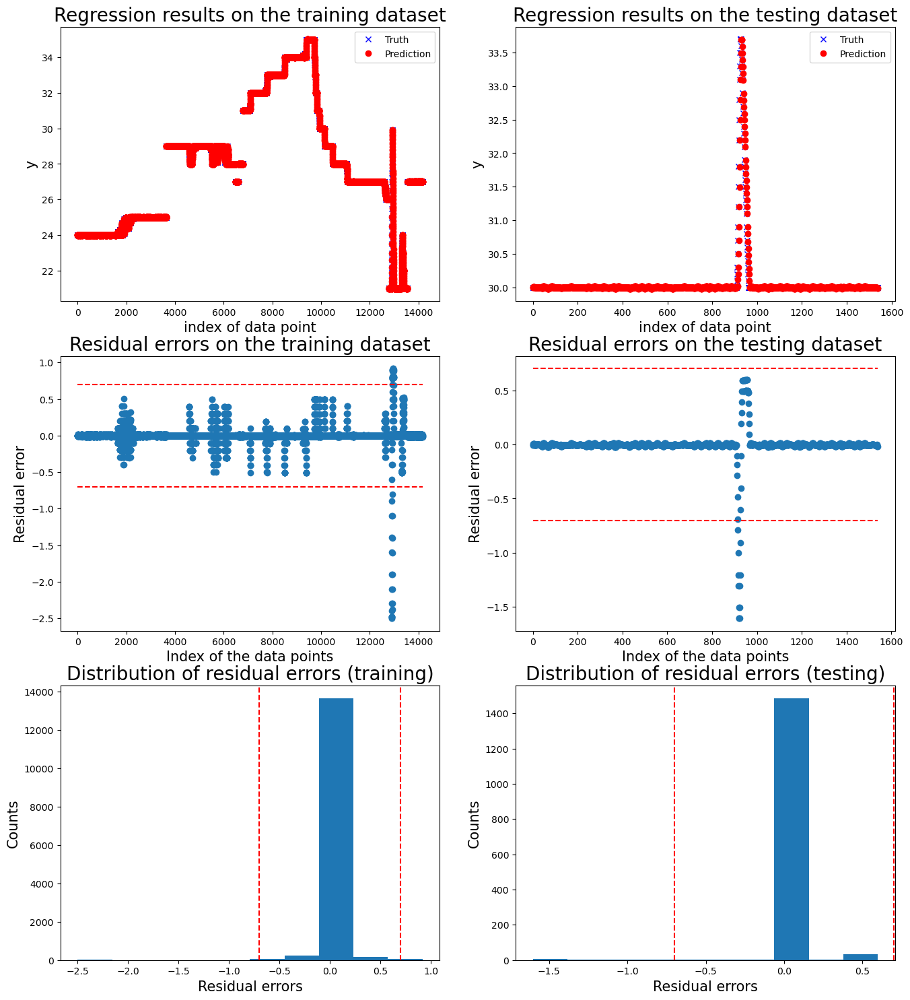

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:00<00:00,  1.07it/s]



 New run:

training performance, max error is: 2.4989447515484144
training performance, mean root square error is: 0.11622863141005783
training performance, residual error > 0.7: 0.48012426745745956%

 New run:

testing performance, max error is: 0.02252528161832501
testing performance, mean root square error is: 0.008636164374723015
testing performance, residual error > 0.7: 0.0%


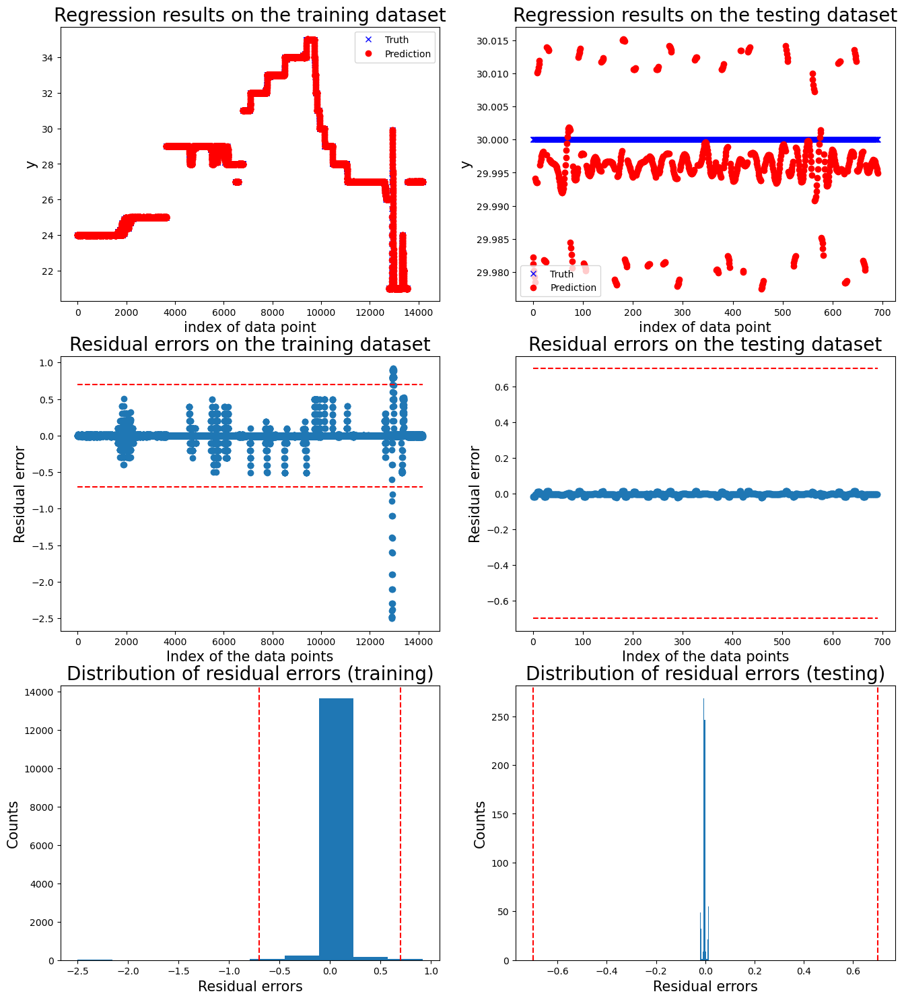

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:02<00:00,  2.19s/it]



 New run:

training performance, max error is: 2.4989447515484144
training performance, mean root square error is: 0.11622863141005783
training performance, residual error > 0.7: 0.48012426745745956%

 New run:

testing performance, max error is: 4.403517240095198
testing performance, mean root square error is: 0.4340163736693996
testing performance, residual error > 0.7: 2.8455284552845526%


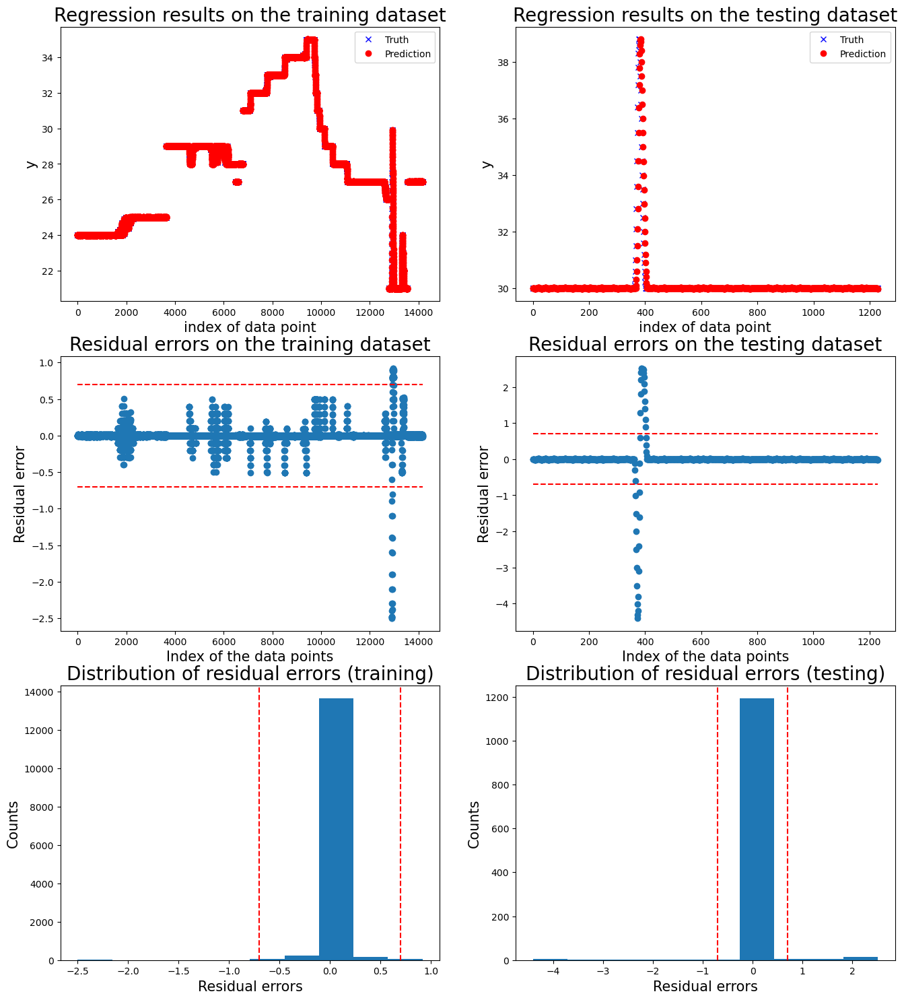

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:01<00:00,  1.12s/it]



 New run:

training performance, max error is: 1.503106742186766
training performance, mean root square error is: 0.11845476855624784
training performance, residual error > 0.7: 0.2191427650660651%

 New run:

testing performance, max error is: 0.002200486372110788
testing performance, mean root square error is: 0.0004778071439374372
testing performance, residual error > 0.7: 0.0%


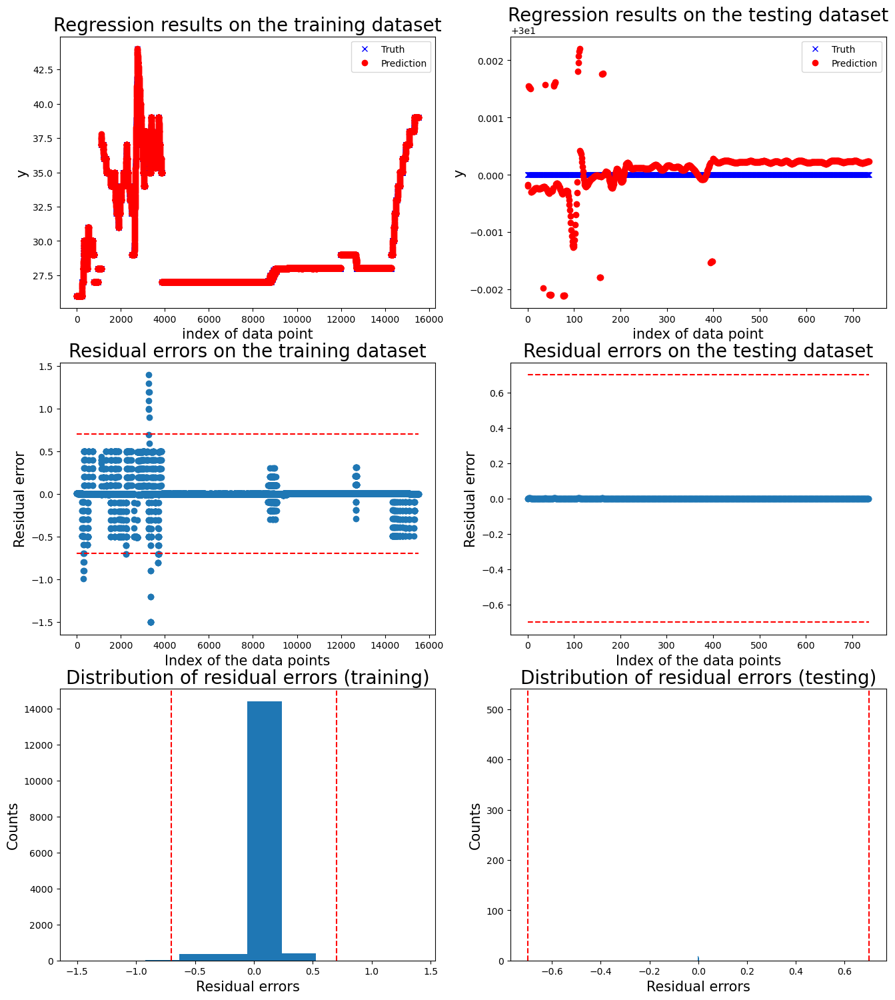

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.03s/it]



 New run:

training performance, max error is: 1.503106742186766
training performance, mean root square error is: 0.11845476855624784
training performance, residual error > 0.9584093737905133: 0.10312600708991299%

 New run:

testing performance, max error is: 2.3797407830999973
testing performance, mean root square error is: 0.2646889204494365
testing performance, residual error > 0.9584093737905133: 1.7029328287606436%


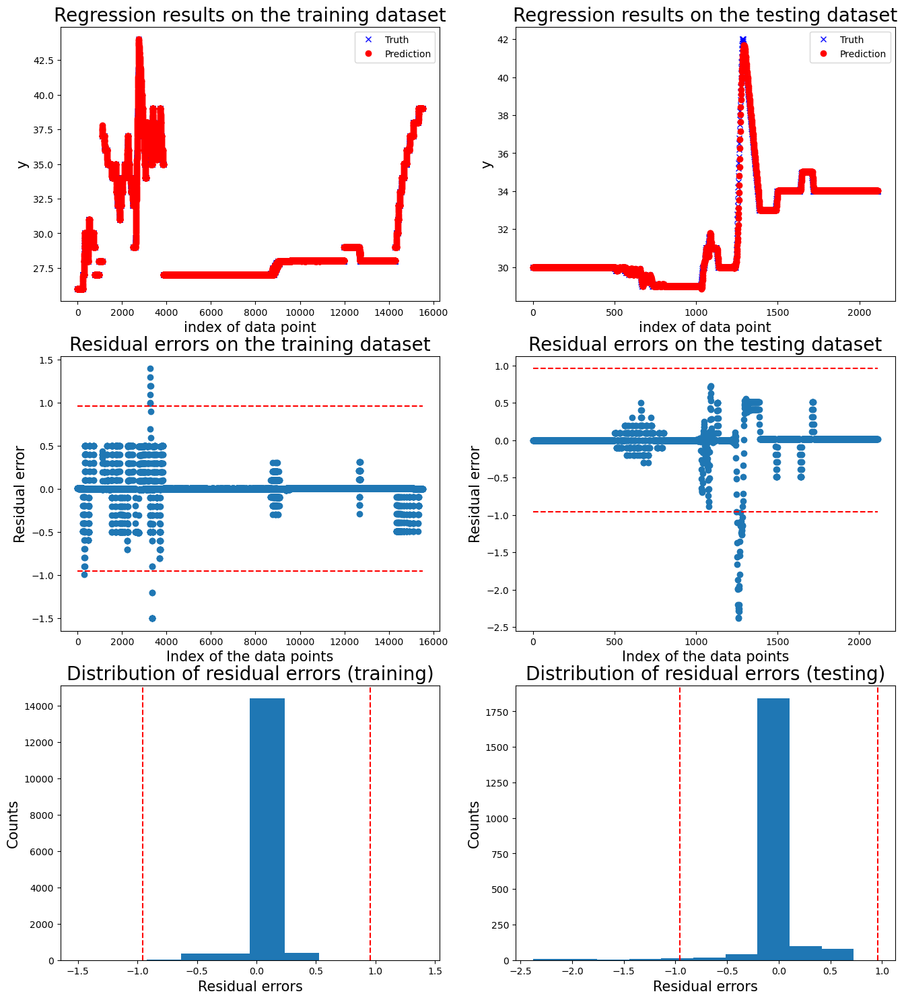

Motor  3
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.48s/it]



 New run:

training performance, max error is: 1.0023384923631014
training performance, mean root square error is: 0.12212403295800316
training performance, residual error > 0.5: 1.602970080803669%

 New run:

testing performance, max error is: 0.46564235849651325
testing performance, mean root square error is: 0.033012656950105634
testing performance, residual error > 0.5: 0.0%


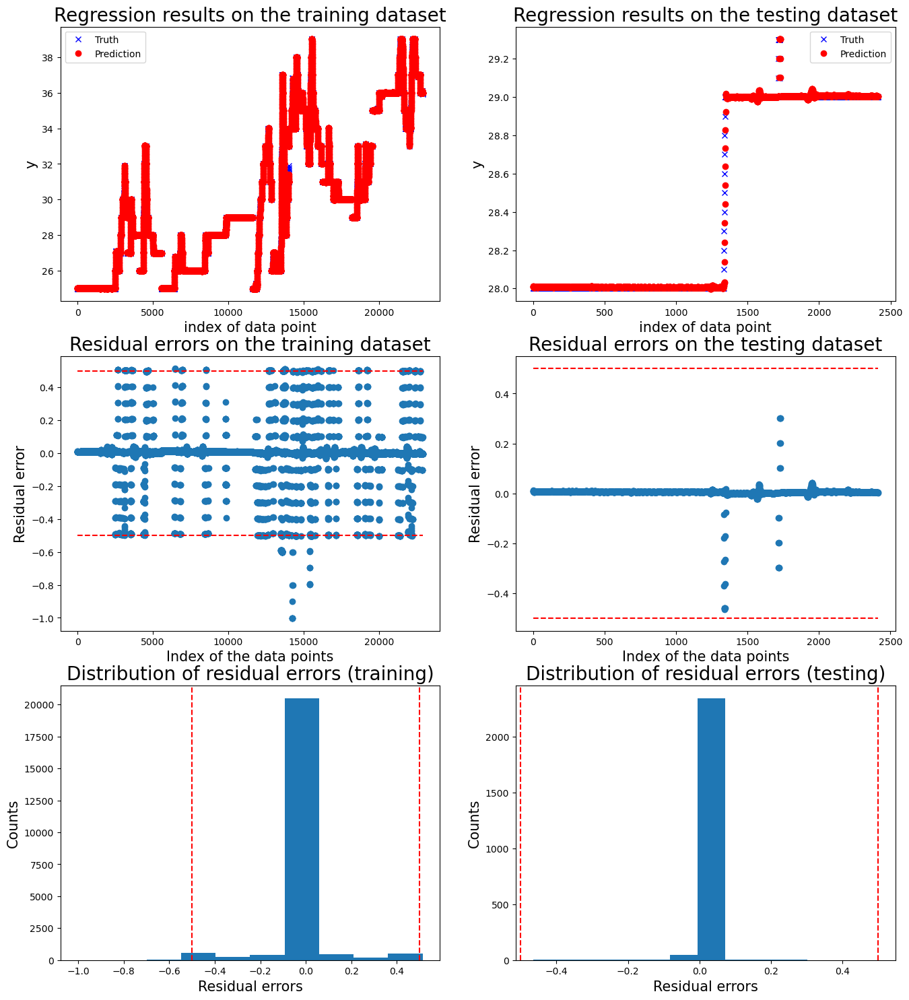

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:05<00:00,  5.80s/it]



 New run:

training performance, max error is: 1.0023384923631014
training performance, mean root square error is: 0.12212403295800316
training performance, residual error > 1.0671759684613475: 0.0%

 New run:

testing performance, max error is: 0.9983320626998022
testing performance, mean root square error is: 0.18474805882674797
testing performance, residual error > 1.0671759684613475: 0.0%


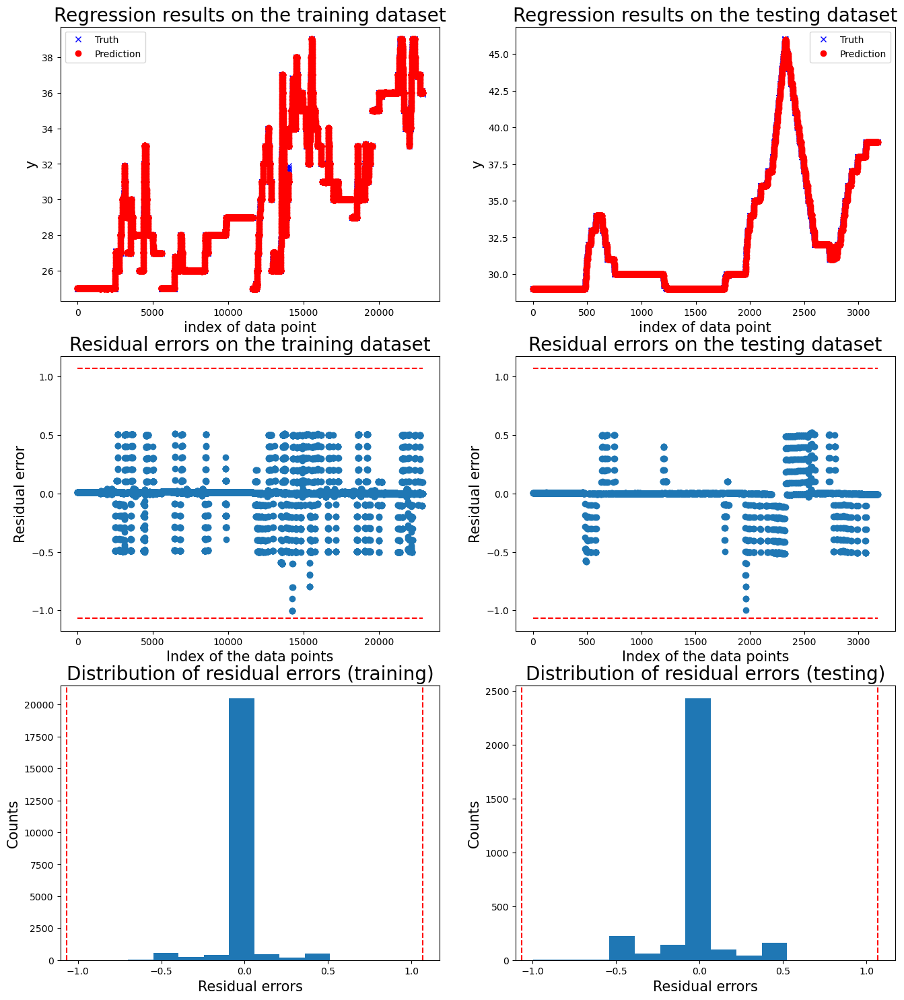

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.17s/it]



 New run:

training performance, max error is: 1.0023384923631014
training performance, mean root square error is: 0.12212403295800316
training performance, residual error > 0.56602940579102: 0.2882725485913955%

 New run:

testing performance, max error is: 0.5192068666015857
testing performance, mean root square error is: 0.10186811757256169
testing performance, residual error > 0.56602940579102: 0.0%


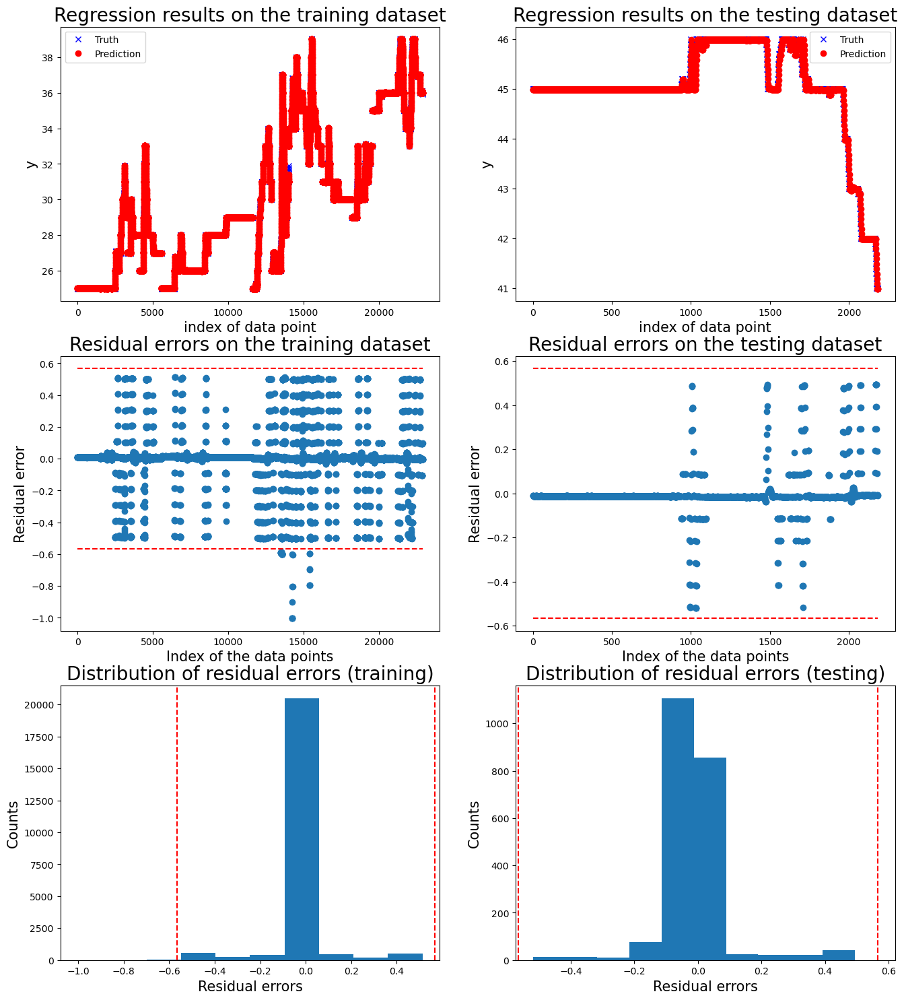

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.23s/it]



 New run:

training performance, max error is: 2.5001153232719915
training performance, mean root square error is: 0.1163064941237486
training performance, residual error > 0.5325995113475654: 0.515427522417567%

 New run:

testing performance, max error is: 2.8002270291802063
testing performance, mean root square error is: 0.23984795998320893
testing performance, residual error > 0.5325995113475654: 1.8843404808317088%


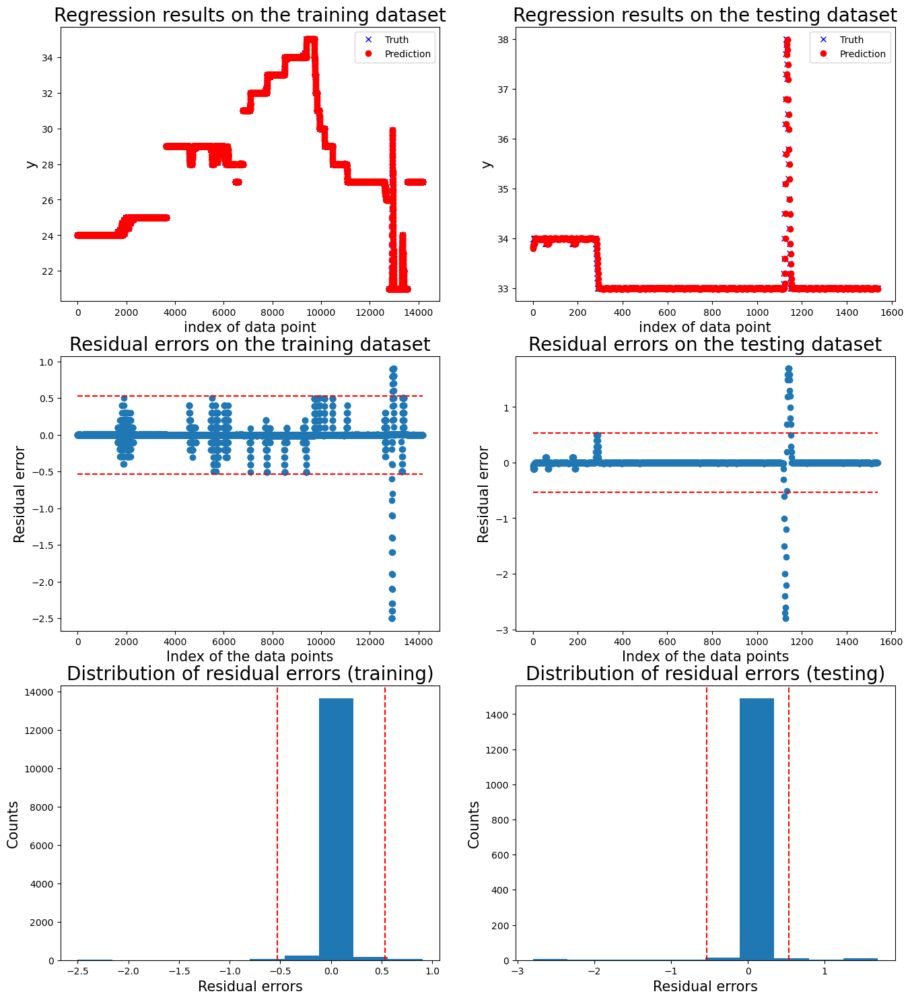

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:00<00:00,  1.13it/s]



 New run:

training performance, max error is: 2.5001153232719915
training performance, mean root square error is: 0.1163064941237486
training performance, residual error > 0.5: 0.790792911106404%

 New run:

testing performance, max error is: 0.007794835041273984
testing performance, mean root square error is: 0.0042808157978424435
testing performance, residual error > 0.5: 0.0%


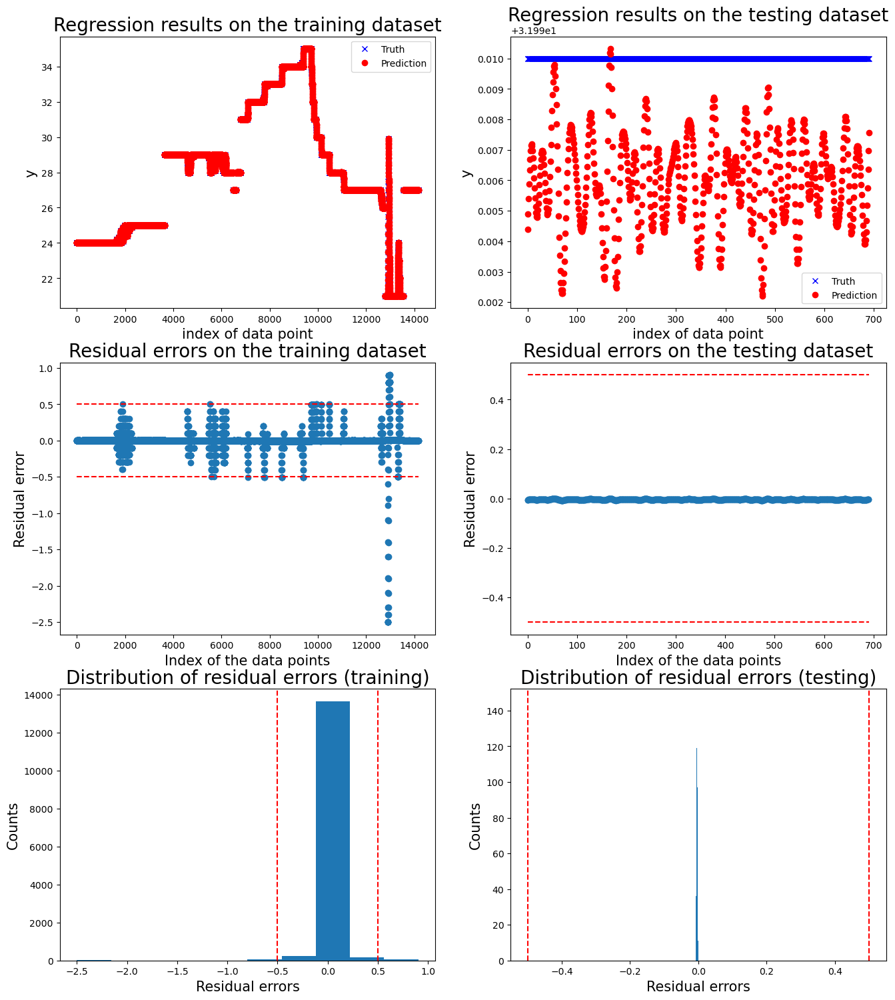

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.56s/it]



 New run:

training performance, max error is: 2.5001153232719915
training performance, mean root square error is: 0.1163064941237486
training performance, residual error > 0.5: 0.790792911106404%

 New run:

testing performance, max error is: 0.10404762930046019
testing performance, mean root square error is: 0.013497188712810427
testing performance, residual error > 0.5: 0.0%


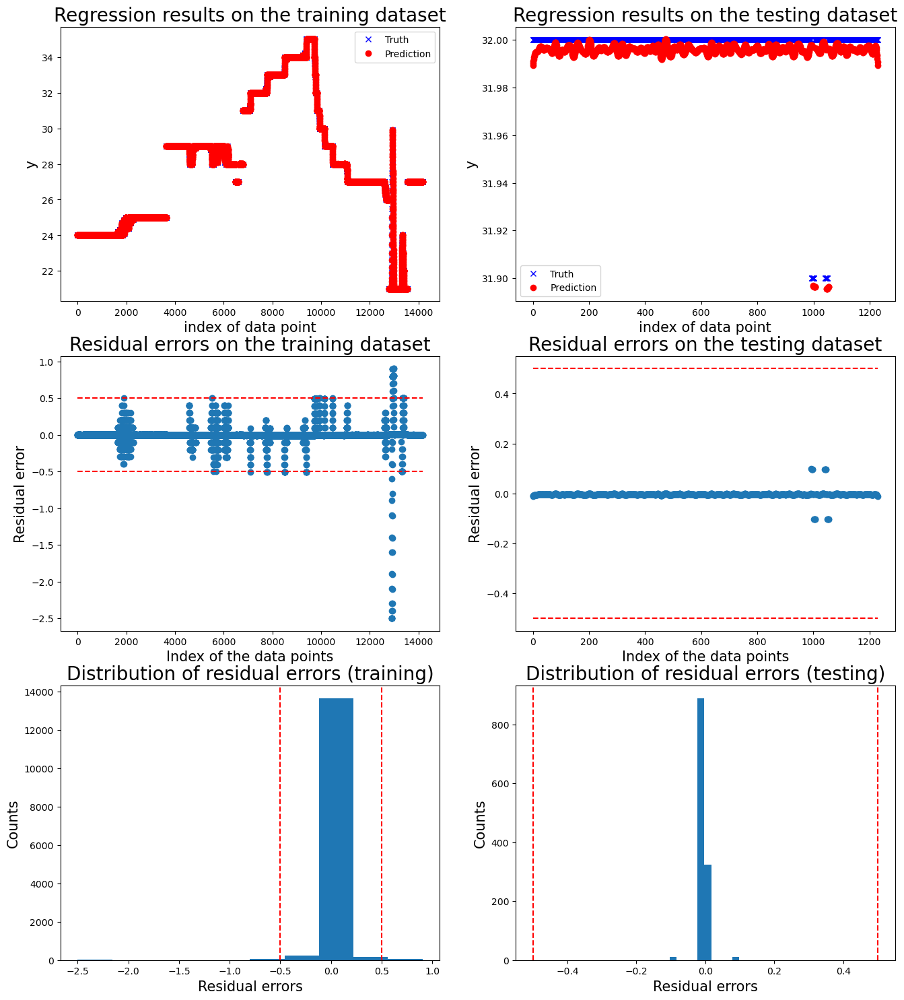

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:00<00:00,  1.09it/s]



 New run:

training performance, max error is: 1.5028262899530418
training performance, mean root square error is: 0.11844551379204436
training performance, residual error > 1.1325840286937678: 0.07734450531743474%

 New run:

testing performance, max error is: 0.7981456661637445
testing performance, mean root square error is: 0.12269357974769356
testing performance, residual error > 1.1325840286937678: 0.0%


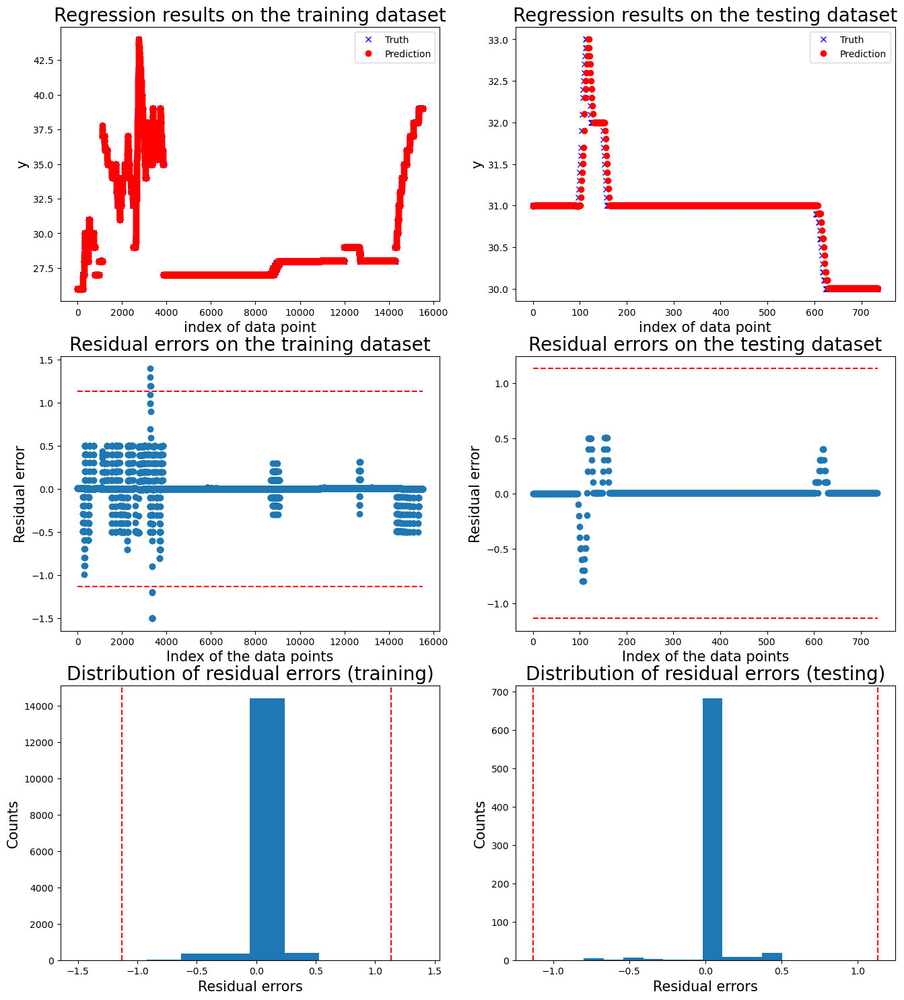

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.48s/it]



 New run:

training performance, max error is: 1.5028262899530418
training performance, mean root square error is: 0.11844551379204436
training performance, residual error > 0.5: 1.527553980019336%

 New run:

testing performance, max error is: 0.009161293920325164
testing performance, mean root square error is: 0.004505054907944771
testing performance, residual error > 0.5: 0.0%


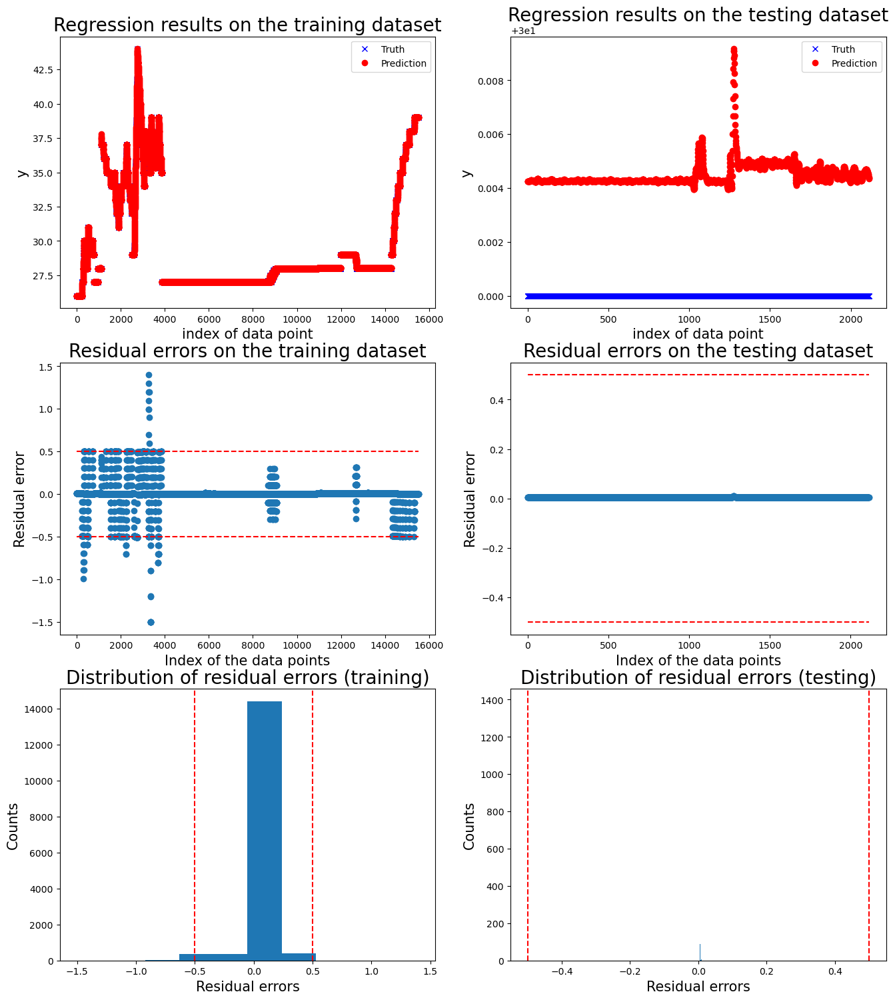

Motor  4
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.56s/it]



 New run:

training performance, max error is: 1.0078648329800828
training performance, mean root square error is: 0.12208804807134416
training performance, residual error > 0.35: 5.402926403144791%

 New run:

testing performance, max error is: 0.505329994664244
testing performance, mean root square error is: 0.08301797832379244
testing performance, residual error > 0.35: 2.651201325600663%


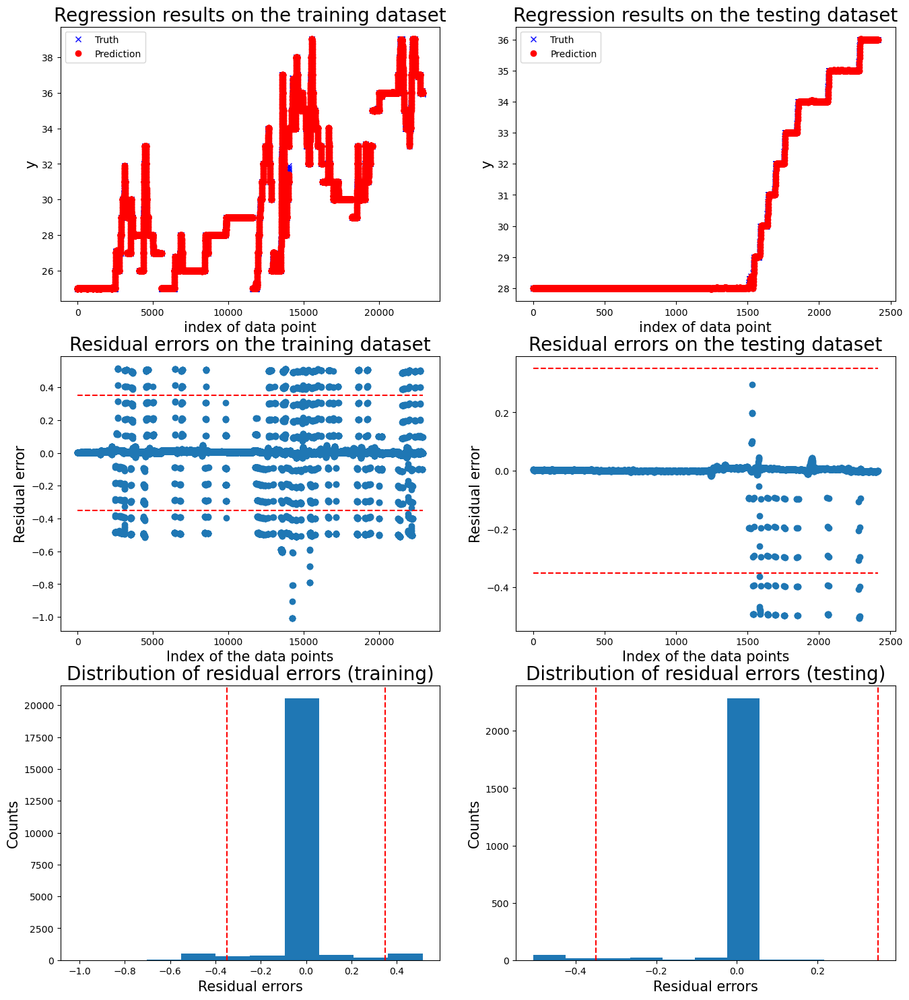

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:04<00:00,  4.77s/it]



 New run:

training performance, max error is: 1.0078648329800828
training performance, mean root square error is: 0.12208804807134416
training performance, residual error > 0.35: 5.402926403144791%

 New run:

testing performance, max error is: 0.516256733518631
testing performance, mean root square error is: 0.08827882164588612
testing performance, residual error > 0.35: 2.8319697923222154%


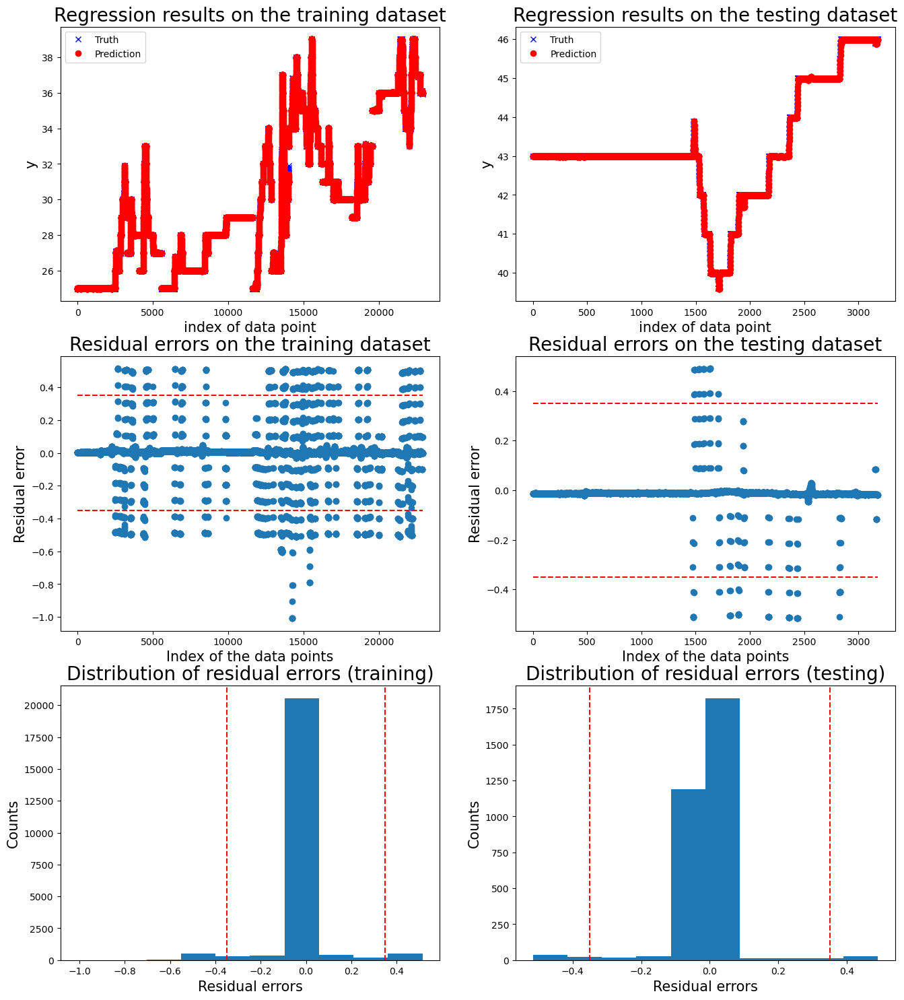

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.67s/it]



 New run:

training performance, max error is: 1.0078648329800828
training performance, mean root square error is: 0.12208804807134416
training performance, residual error > 0.4495787118409829: 3.9659314260755627%

 New run:

testing performance, max error is: 0.5298191589138384
testing performance, mean root square error is: 0.14856940179626063
testing performance, residual error > 0.4495787118409829: 5.771873568483739%


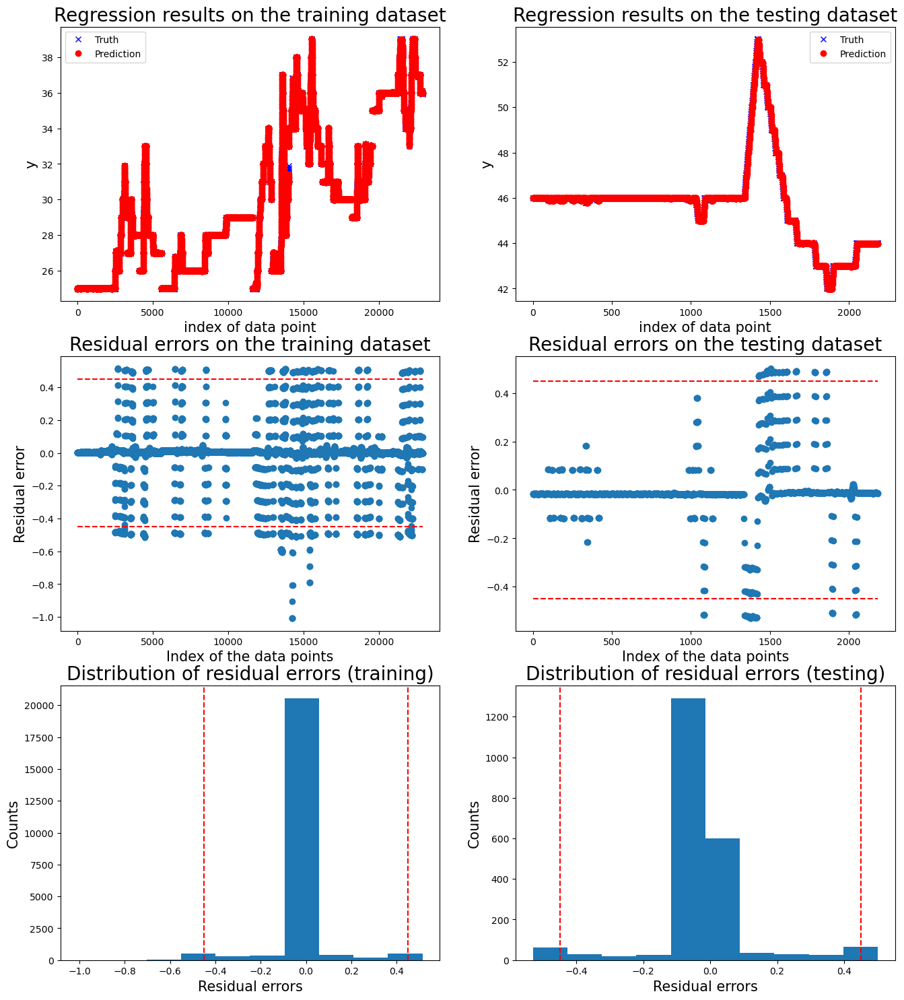

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.30s/it]



 New run:

training performance, max error is: 2.4999724264276146
training performance, mean root square error is: 0.11631253019360742
training performance, residual error > 0.35: 1.7581020970133445%

 New run:

testing performance, max error is: 4.415623481895949
testing performance, mean root square error is: 0.38738099837056034
testing performance, residual error > 0.35: 3.378817413905133%


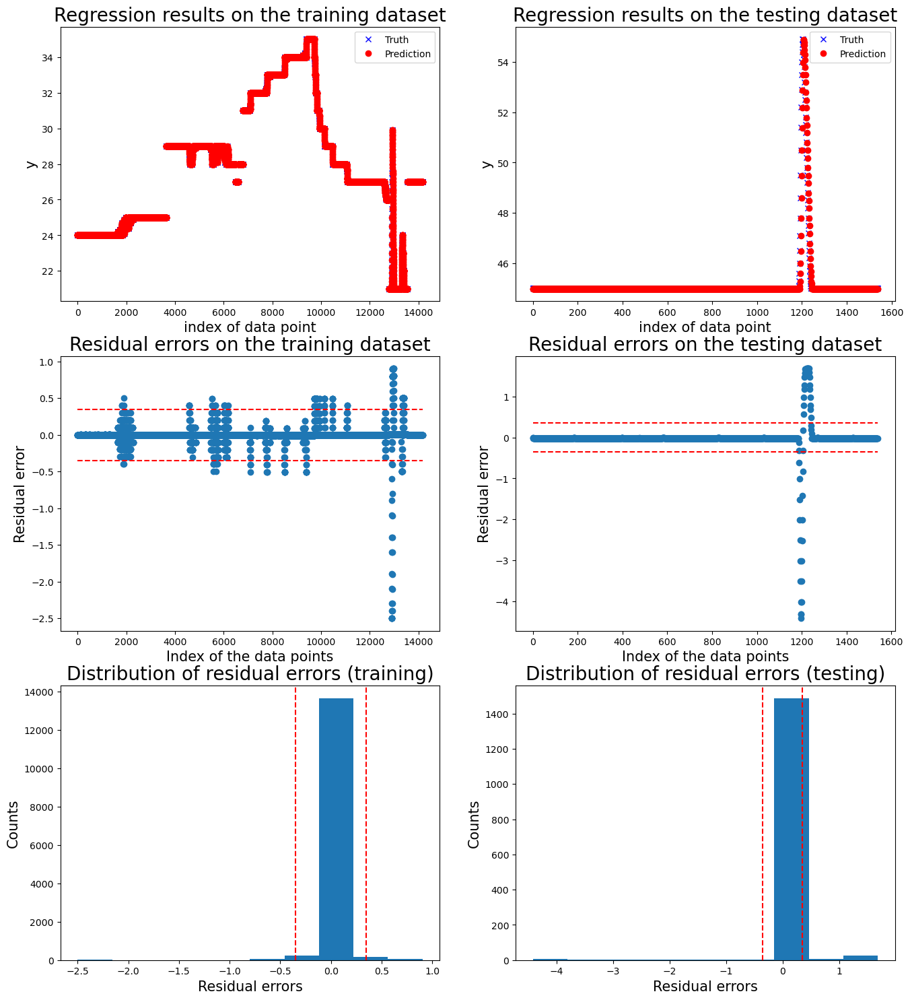

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:00<00:00,  1.16it/s]



 New run:

training performance, max error is: 2.4999724264276146
training performance, mean root square error is: 0.11631253019360742
training performance, residual error > 0.35: 1.7581020970133445%

 New run:

testing performance, max error is: 0.015419929744759031
testing performance, mean root square error is: 0.013583170151168566
testing performance, residual error > 0.35: 0.0%


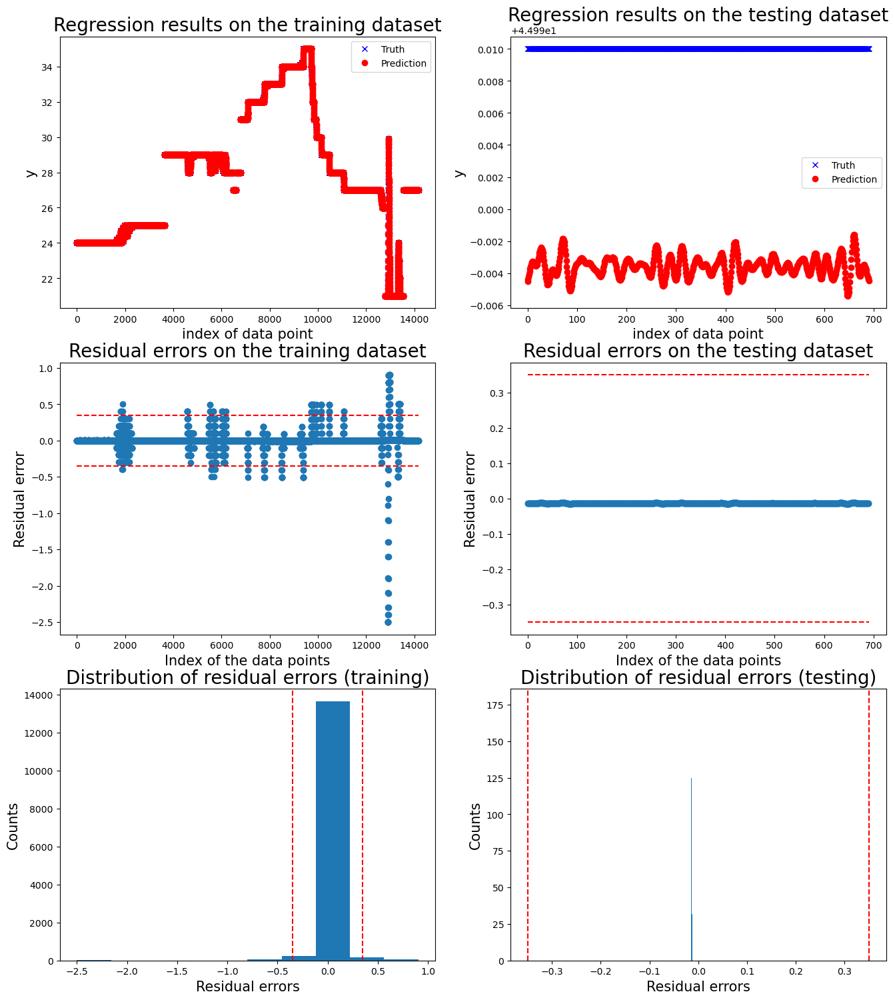

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.72s/it]



 New run:

training performance, max error is: 2.4999724264276146
training performance, mean root square error is: 0.11631253019360742
training performance, residual error > 0.35: 1.7581020970133445%

 New run:

testing performance, max error is: 0.015027218655149
testing performance, mean root square error is: 0.013565844956762819
testing performance, residual error > 0.35: 0.0%


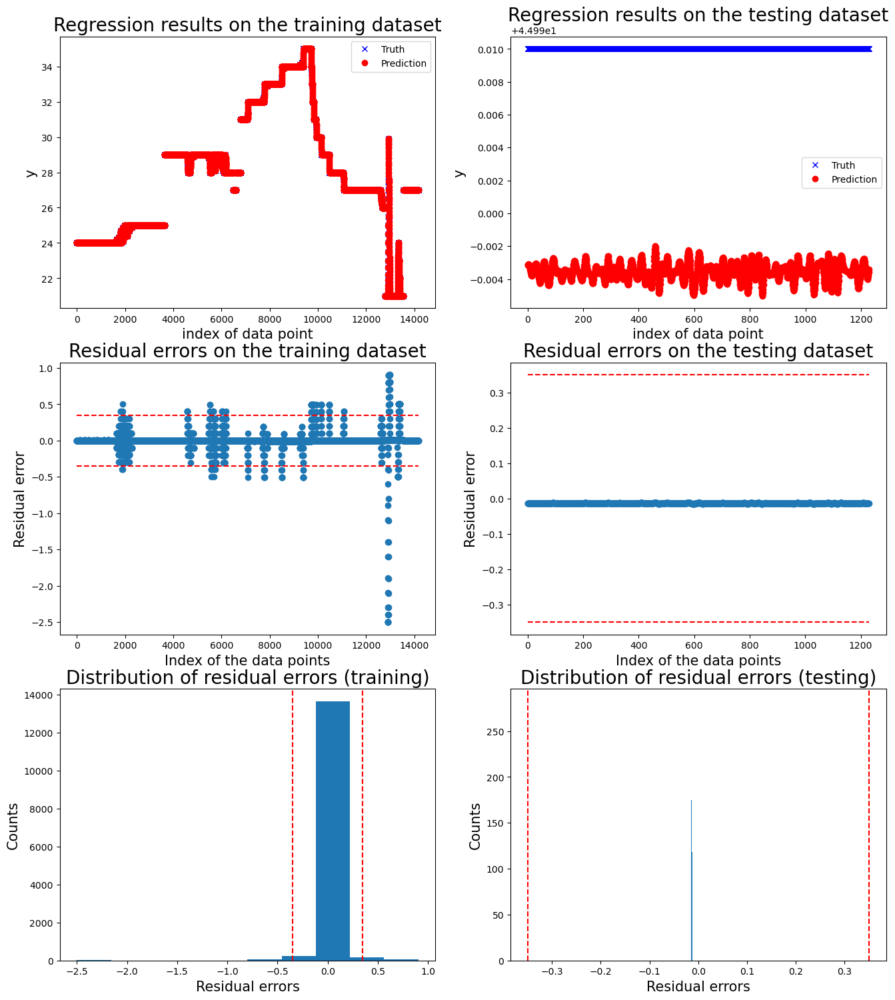

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:01<00:00,  1.52s/it]



 New run:

training performance, max error is: 1.503291077994966
training performance, mean root square error is: 0.11810921608697701
training performance, residual error > 0.9091194715905723: 0.09668063164679343%

 New run:

testing performance, max error is: 0.49498674811943744
testing performance, mean root square error is: 0.15054224281400236
testing performance, residual error > 0.9091194715905723: 0.0%


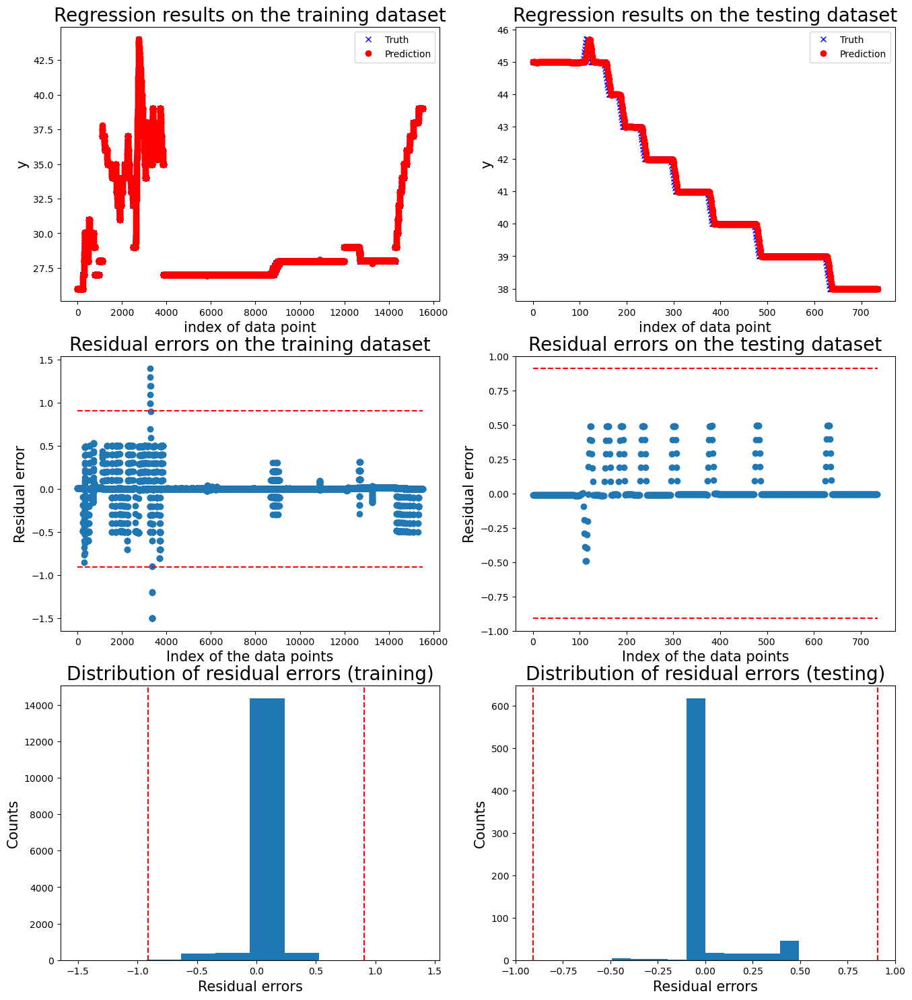

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.21s/it]



 New run:

training performance, max error is: 1.503291077994966
training performance, mean root square error is: 0.11810921608697701
training performance, residual error > 0.35: 4.3957460522075404%

 New run:

testing performance, max error is: 0.5024461921562207
testing performance, mean root square error is: 0.03926160921749753
testing performance, residual error > 0.35: 0.47303689687795647%


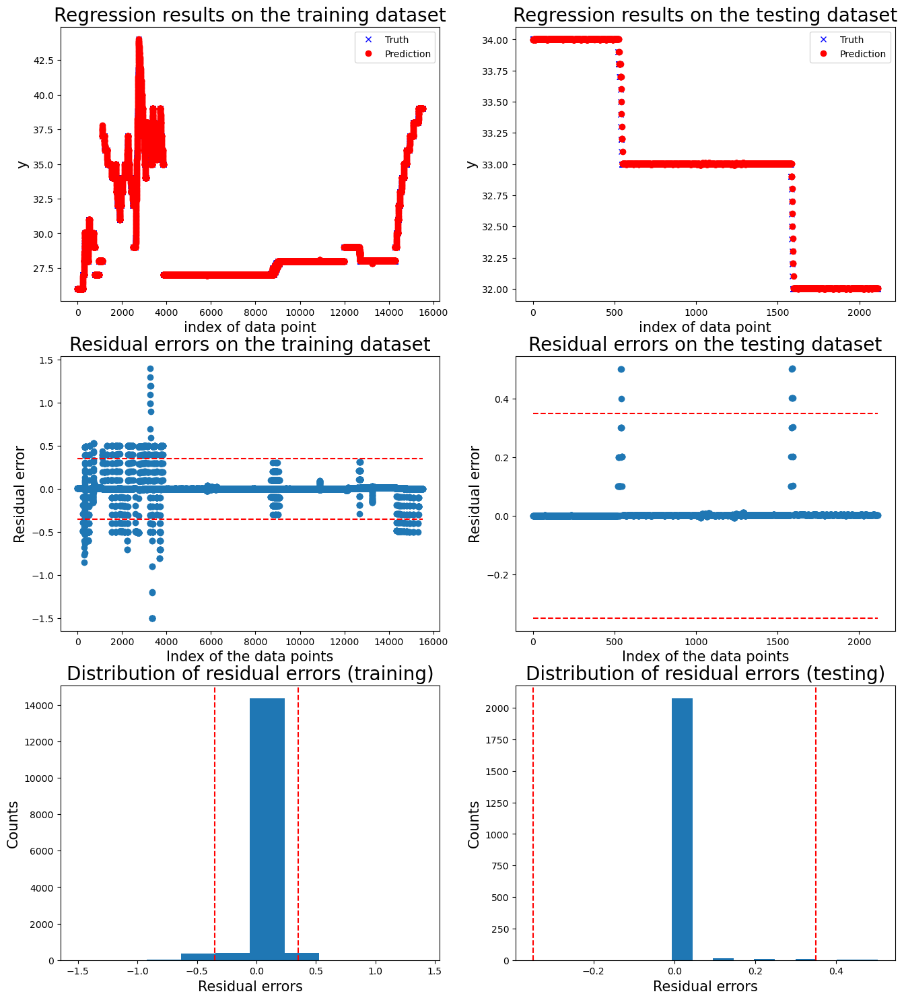

Motor  5
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.66s/it]



 New run:

training performance, max error is: 1.003580247590385
training performance, mean root square error is: 0.12197698532531824
training performance, residual error > 0.9076231436649242: 0.01747106355099367%

 New run:

testing performance, max error is: 0.5219170450195421
testing performance, mean root square error is: 0.1504586839077748
testing performance, residual error > 0.9076231436649242: 0.0%


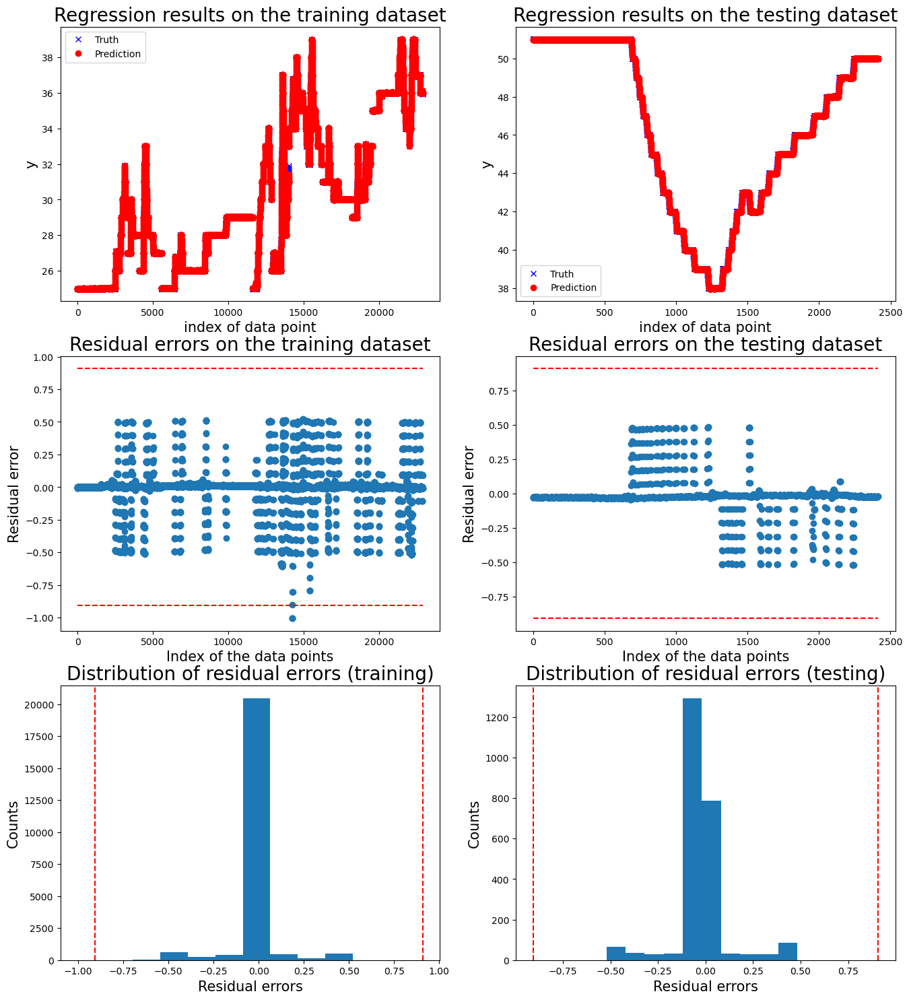

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:04<00:00,  4.68s/it]



 New run:

training performance, max error is: 1.003580247590385
training performance, mean root square error is: 0.12197698532531824
training performance, residual error > 1.1213201983378707: 0.0%

 New run:

testing performance, max error is: 1.3304195249886703
testing performance, mean root square error is: 0.22203673853701686
testing performance, residual error > 1.1213201983378707: 1.2586532410320956%


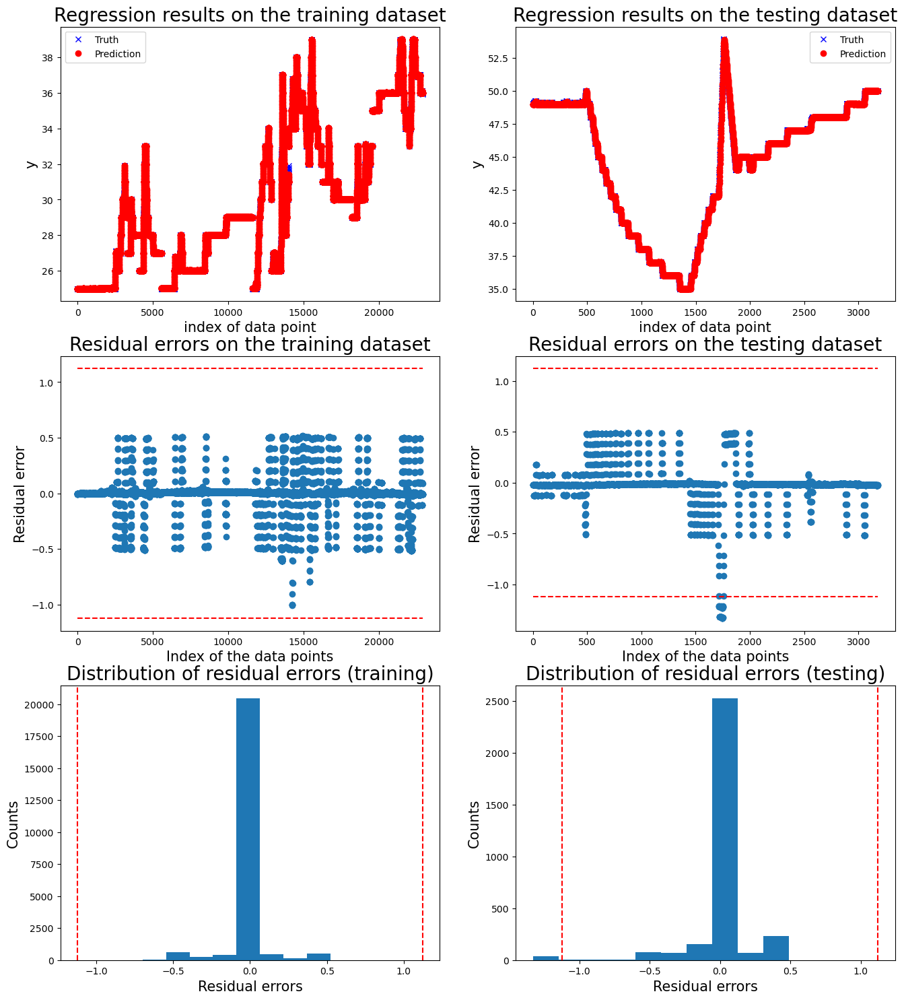

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.23s/it]



 New run:

training performance, max error is: 1.003580247590385
training performance, mean root square error is: 0.12197698532531824
training performance, residual error > 0.5669804464264244: 0.2882725485913955%

 New run:

testing performance, max error is: 0.5233583946582314
testing performance, mean root square error is: 0.09009449808938441
testing performance, residual error > 0.5669804464264244: 0.0%


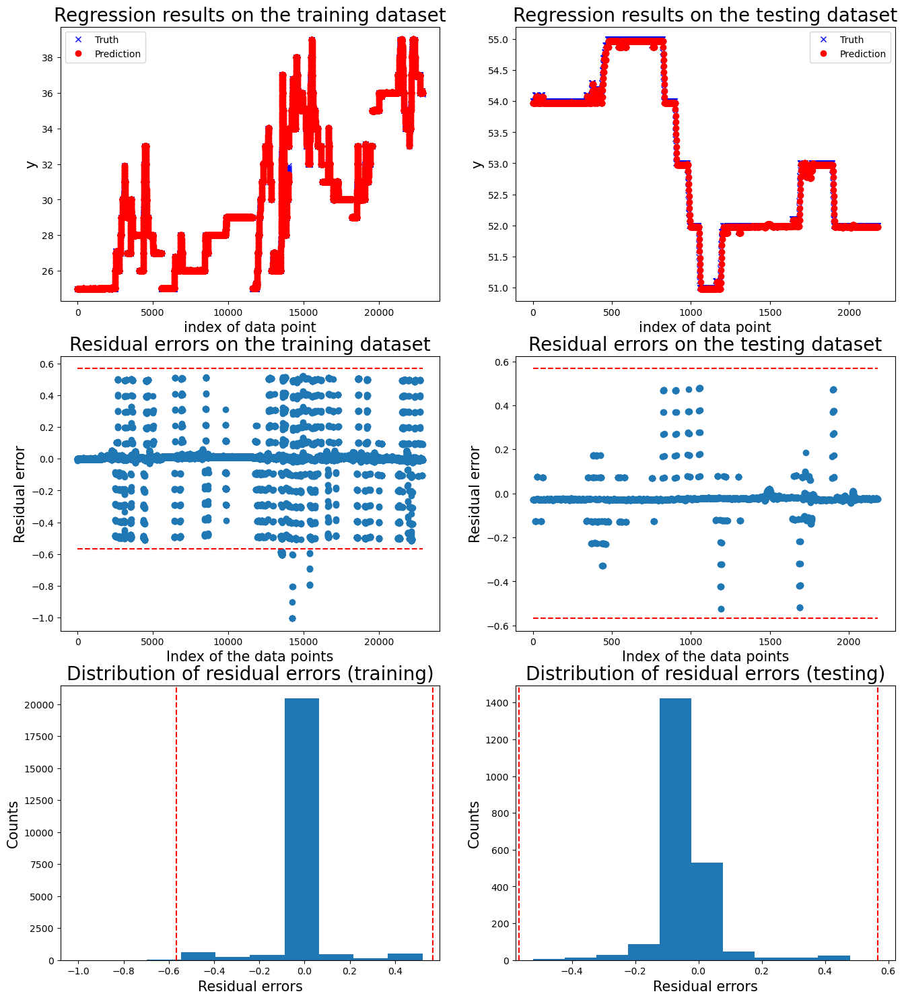

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.34s/it]



 New run:

training performance, max error is: 2.499171786202524
training performance, mean root square error is: 0.11615637385859279
training performance, residual error > 0.5: 0.7696109581303396%

 New run:

testing performance, max error is: 2.5248420375952207
testing performance, mean root square error is: 0.30383644087315037
testing performance, residual error > 0.5: 5.3281351526965555%


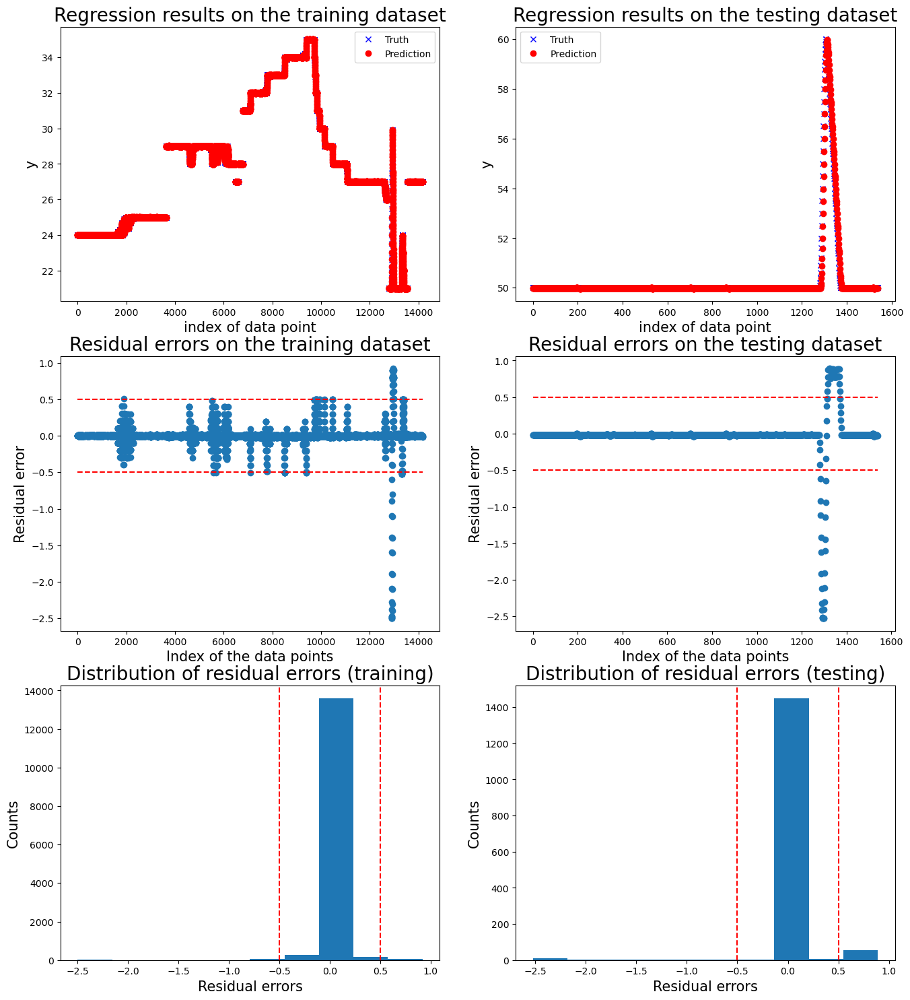

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:00<00:00,  1.12it/s]



 New run:

training performance, max error is: 2.499171786202524
training performance, mean root square error is: 0.11615637385859279
training performance, residual error > 0.5: 0.7696109581303396%

 New run:

testing performance, max error is: 0.03739599658173631
testing performance, mean root square error is: 0.018592279037834506
testing performance, residual error > 0.5: 0.0%


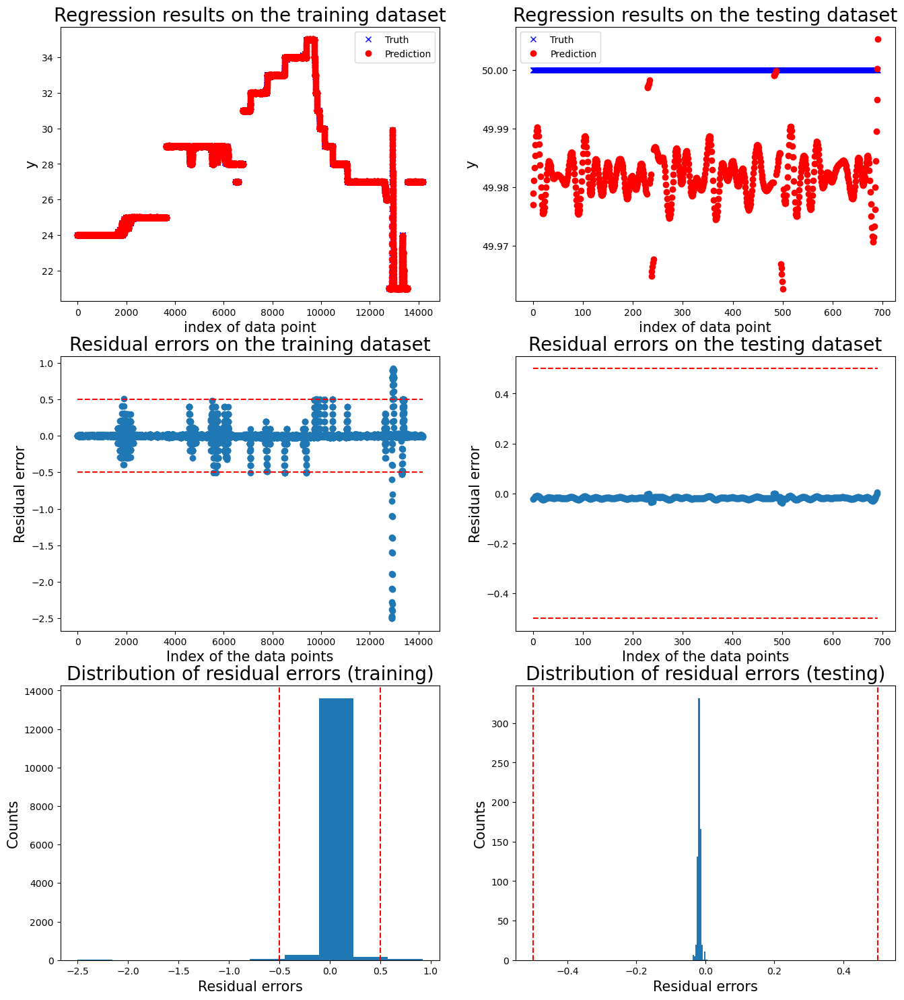

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.90s/it]



 New run:

training performance, max error is: 2.499171786202524
training performance, mean root square error is: 0.11615637385859279
training performance, residual error > 0.5: 0.7696109581303396%

 New run:

testing performance, max error is: 0.039639324922021046
testing performance, mean root square error is: 0.018546982881836725
testing performance, residual error > 0.5: 0.0%


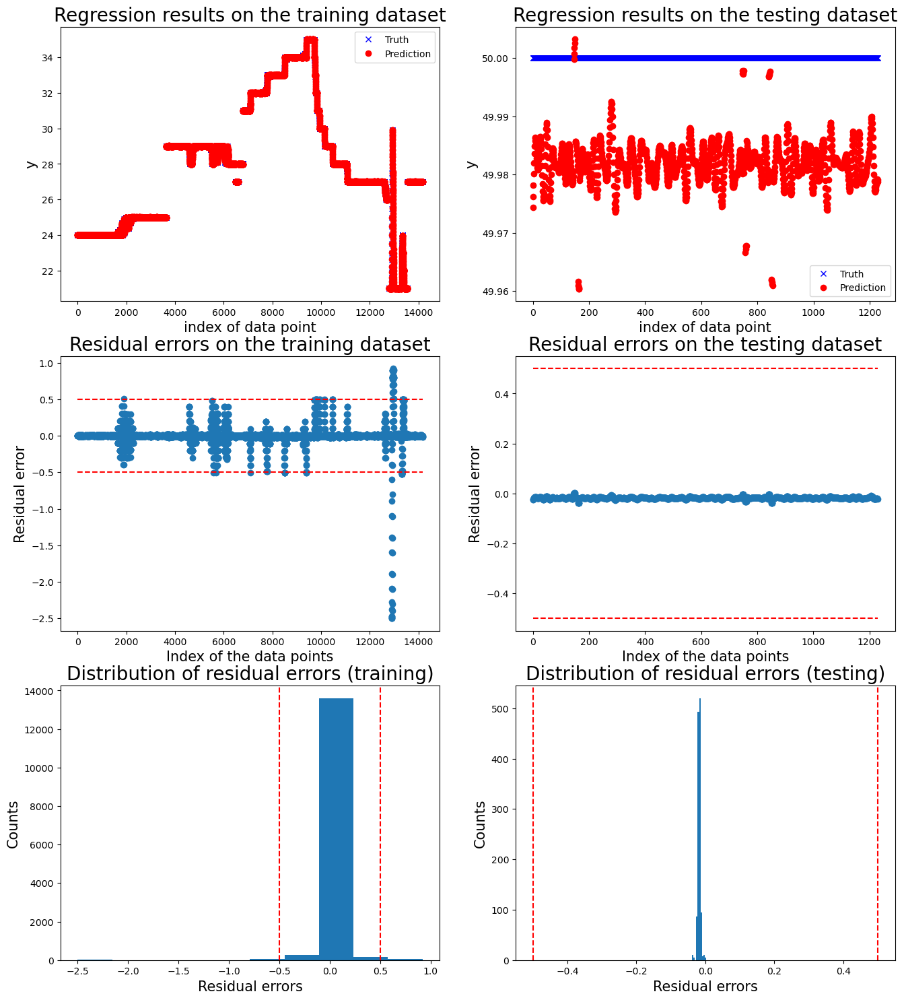

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:00<00:00,  1.06it/s]



 New run:

training performance, max error is: 1.5123492729860146
training performance, mean root square error is: 0.11748942866736338
training performance, residual error > 0.8411133278735982: 0.12246213341927166%

 New run:

testing performance, max error is: 0.4726519393779256
testing performance, mean root square error is: 0.1570183086158581
testing performance, residual error > 0.8411133278735982: 0.0%


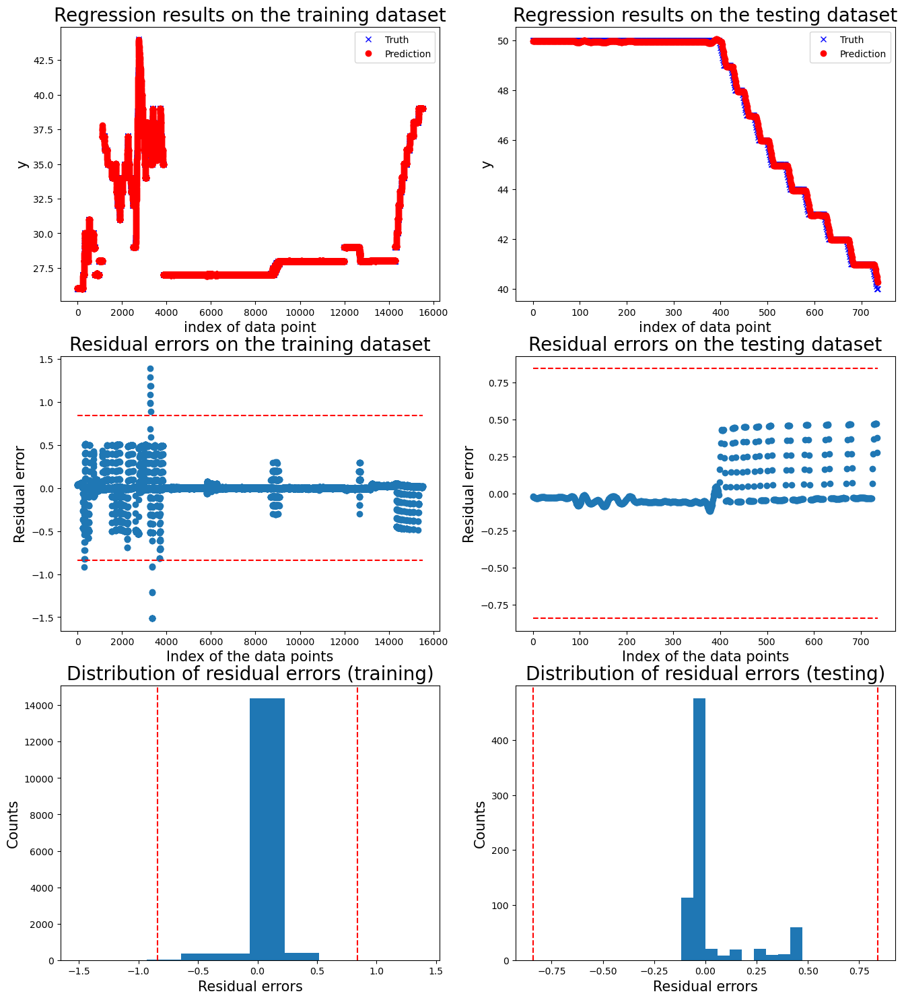

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.34s/it]



 New run:

training performance, max error is: 1.5123492729860146
training performance, mean root square error is: 0.11748942866736338
training performance, residual error > 0.5: 1.5211086045762165%

 New run:

testing performance, max error is: 0.49472590208532097
testing performance, mean root square error is: 0.0445540202785796
testing performance, residual error > 0.5: 0.0%


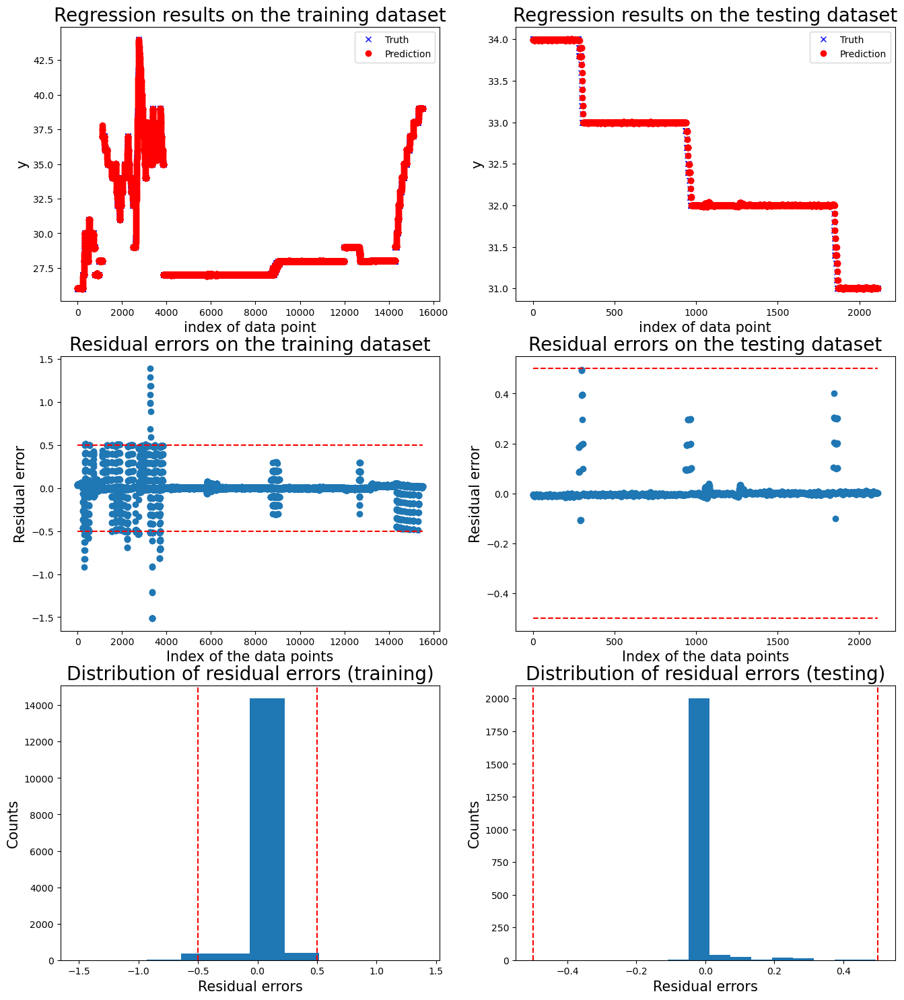

Motor  6
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.68s/it]



 New run:

training performance, max error is: 1.0139225972142043
training performance, mean root square error is: 0.11206369297475288
training performance, residual error > 0.8463620218578458: 0.022983222247759134%

 New run:

testing performance, max error is: 0.6817857643023686
testing performance, mean root square error is: 0.14696969712366734
testing performance, residual error > 0.8463620218578458: 0.0%


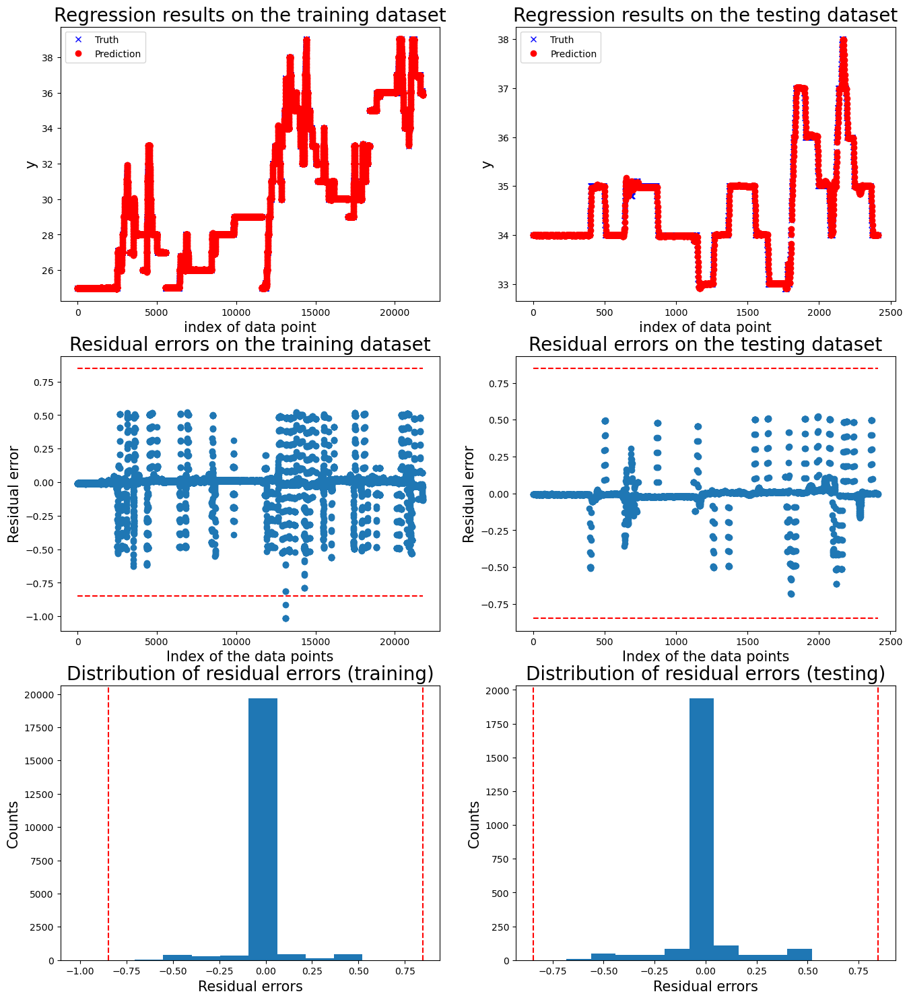

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:05<00:00,  5.63s/it]



 New run:

training performance, max error is: 1.0139225972142043
training performance, mean root square error is: 0.11206369297475288
training performance, residual error > 0.8010660857950836: 0.03217651114686279%

 New run:

testing performance, max error is: 0.8276056021427252
testing performance, mean root square error is: 0.11574695133932332
testing performance, residual error > 0.8010660857950836: 0.18879798615481436%


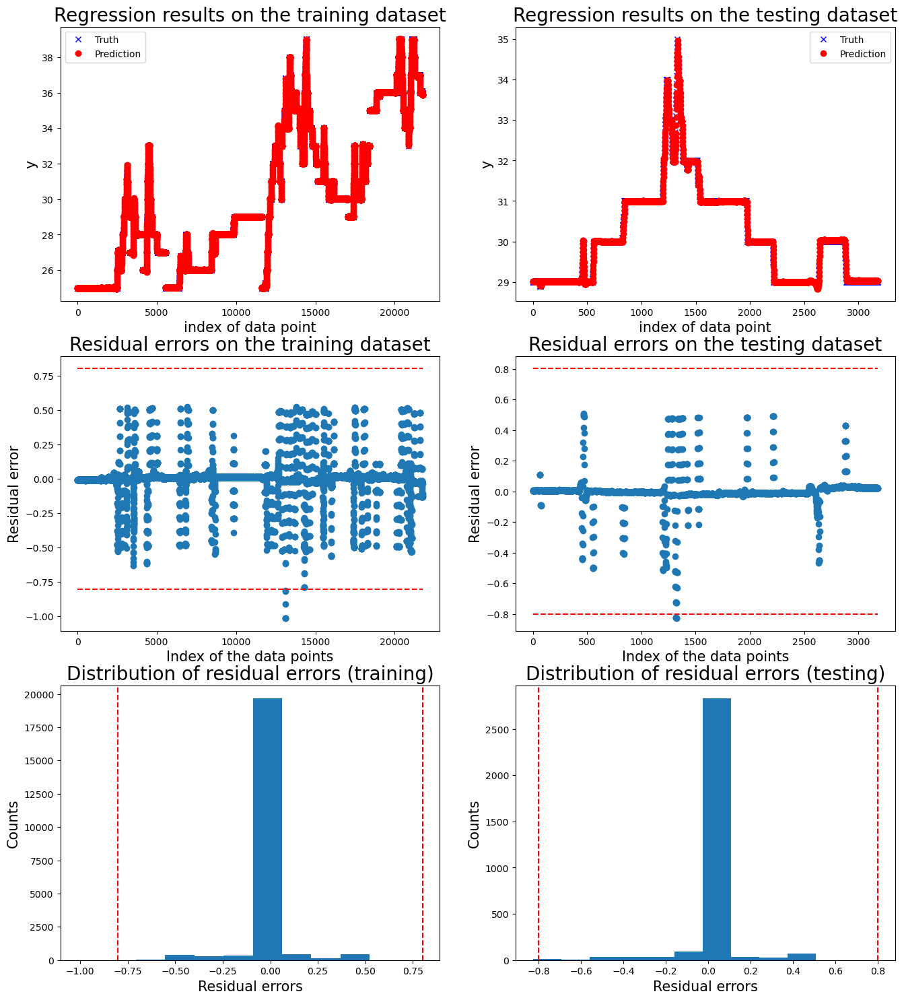

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.82s/it]



 New run:

training performance, max error is: 1.0139225972142043
training performance, mean root square error is: 0.11206369297475288
training performance, residual error > 0.5: 1.0848080900942312%

 New run:

testing performance, max error is: 0.49970502471223455
testing performance, mean root square error is: 0.07163563890276765
testing performance, residual error > 0.5: 0.0%


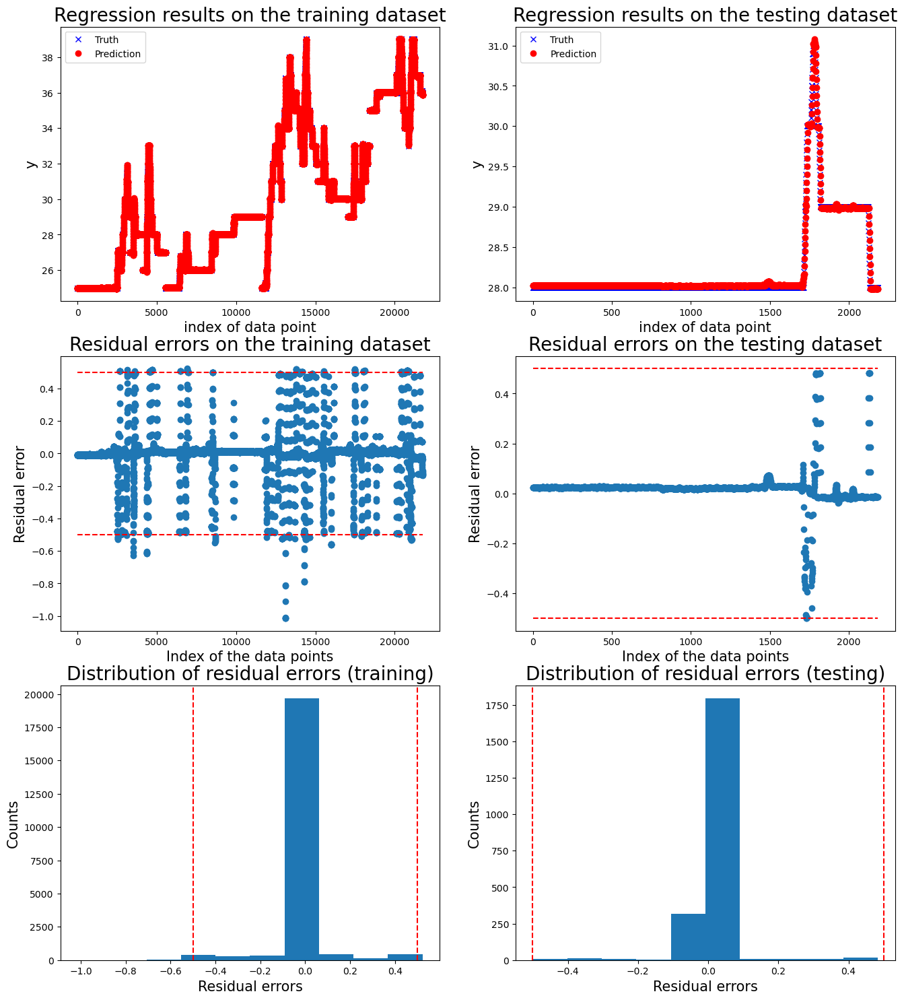

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.35s/it]



 New run:

training performance, max error is: 0.5044669064234455
training performance, mean root square error is: 0.06344559242750678
training performance, residual error > 0.5: 0.13442867811799852%

 New run:

testing performance, max error is: 1.397090530854129
testing performance, mean root square error is: 0.11154298928115647
testing performance, residual error > 0.5: 1.8843404808317088%


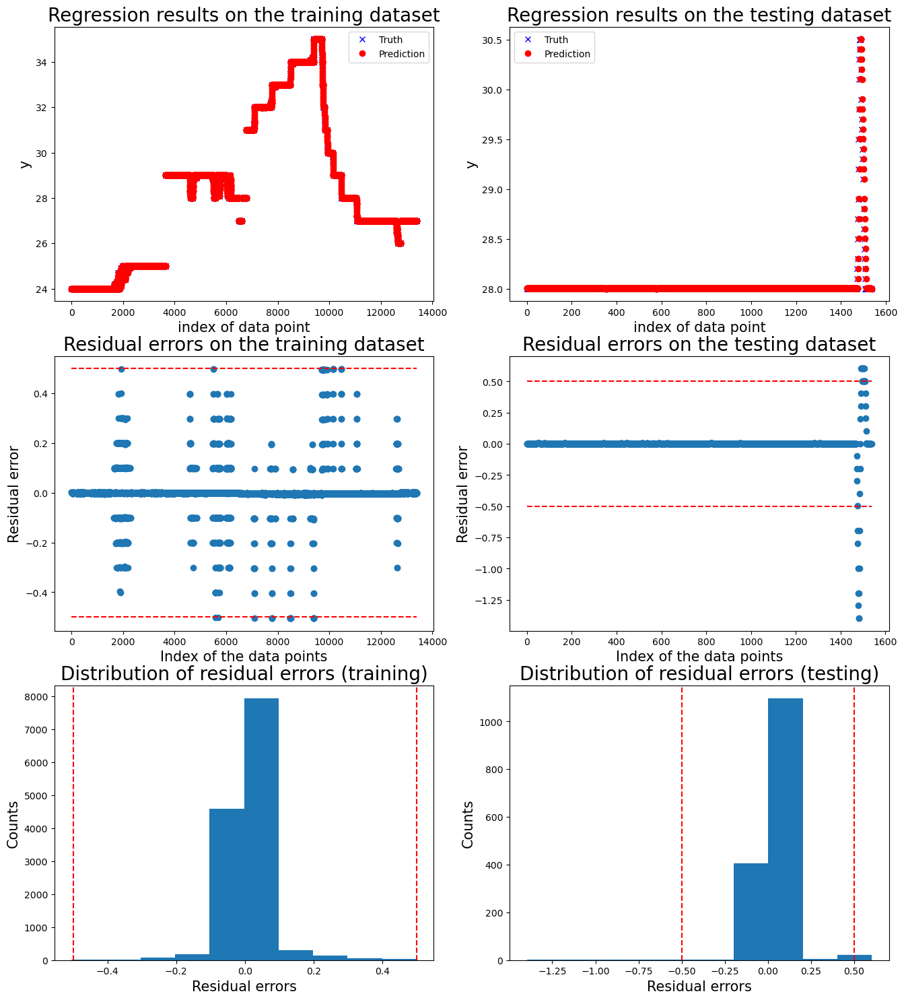

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:01<00:00,  1.16s/it]



 New run:

training performance, max error is: 0.5044669064234455
training performance, mean root square error is: 0.06344559242750678
training performance, residual error > 0.5: 0.13442867811799852%

 New run:

testing performance, max error is: 2.4979967435210426
testing performance, mean root square error is: 0.458246471366383
testing performance, residual error > 0.5: 8.827785817655572%


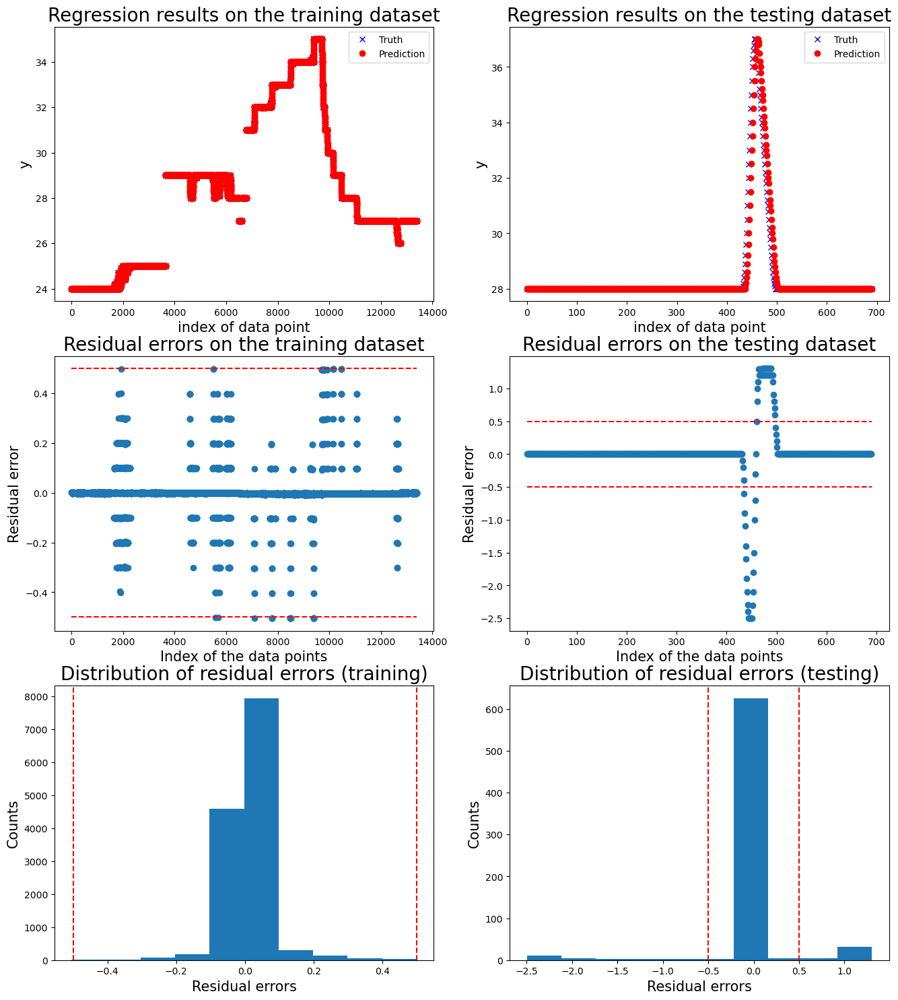

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.92s/it]



 New run:

training performance, max error is: 0.5044669064234455
training performance, mean root square error is: 0.06344559242750678
training performance, residual error > 0.5: 0.13442867811799852%

 New run:

testing performance, max error is: 0.0035726002712053173
testing performance, mean root square error is: 0.0030250815961194452
testing performance, residual error > 0.5: 0.0%


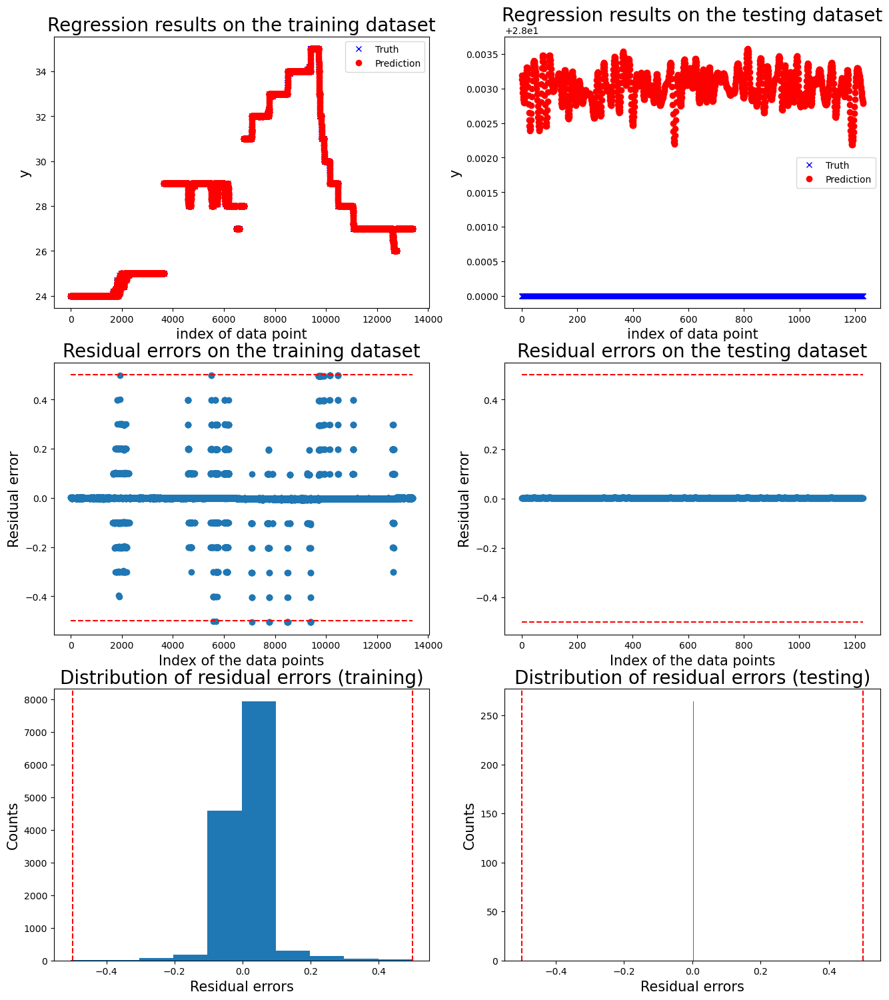

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:01<00:00,  1.07s/it]



 New run:

training performance, max error is: 0.828983628506414
training performance, mean root square error is: 0.07955105923957201
training performance, residual error > 1.3768878959819388: 0.0%

 New run:

testing performance, max error is: 1.7178914901026232
testing performance, mean root square error is: 0.3246734737642313
testing performance, residual error > 1.3768878959819388: 1.9021739130434785%


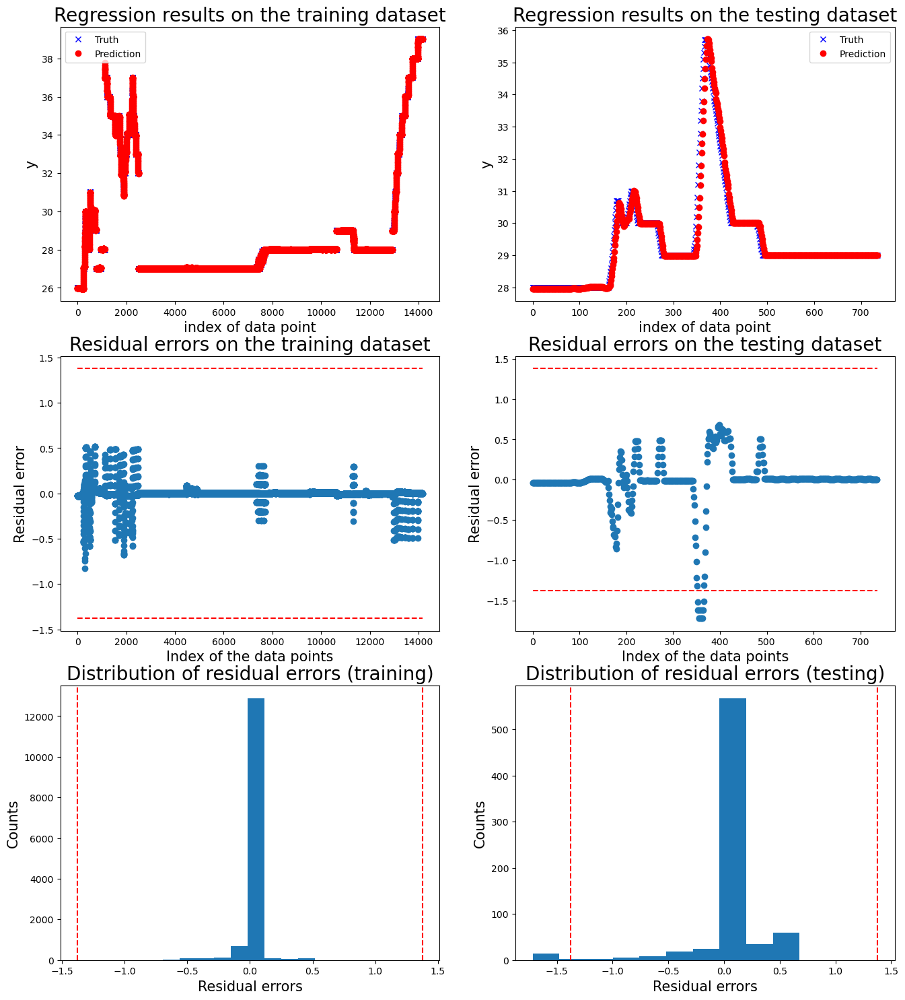

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.16s/it]



 New run:

training performance, max error is: 0.828983628506414
training performance, mean root square error is: 0.07955105923957201
training performance, residual error > 0.5: 0.473264109627746%

 New run:

testing performance, max error is: 0.04972366303634601
testing performance, mean root square error is: 0.013395619901214486
testing performance, residual error > 0.5: 0.0%


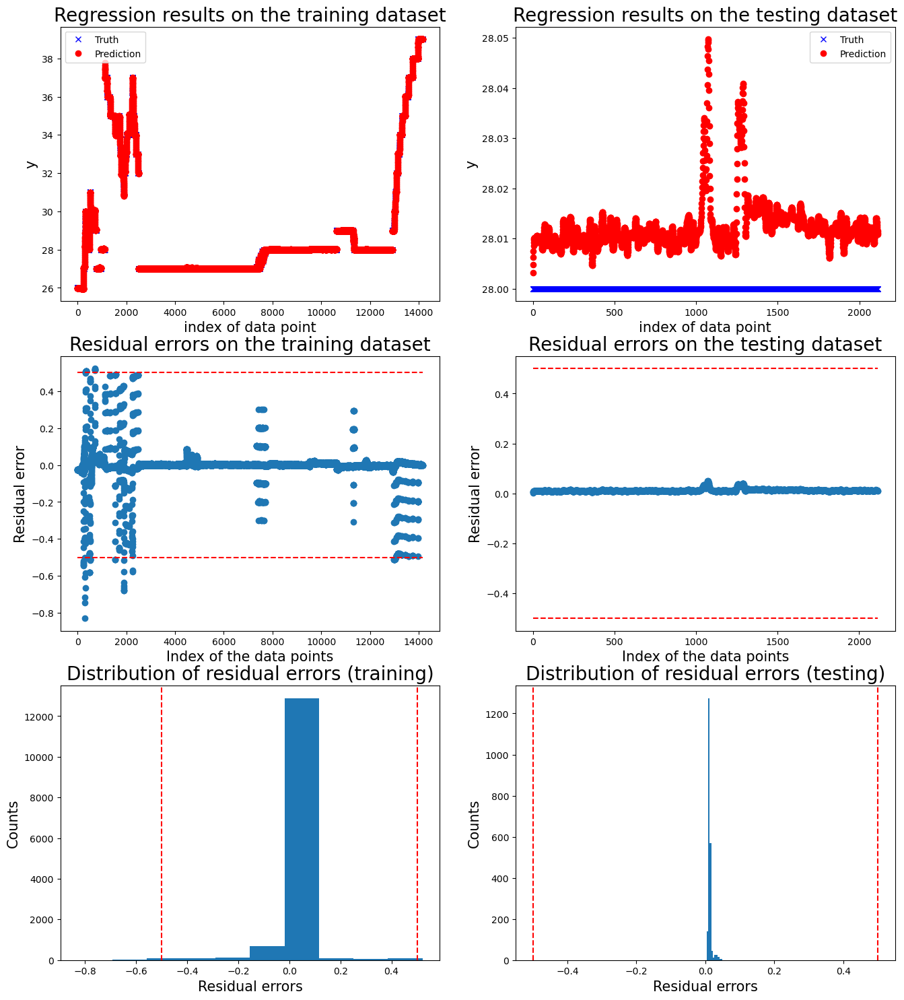

In [29]:
# Best Model

df_best_dict = {}

sys.path.insert(0, 'C:/Users/gioca/GitHub/projects/maintenance_industry_4_2024/supporting_scripts/WP_4_20240528/')
from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg, read_all_csvs_one_test, run_cv_one_motor, show_reg_result, show_clf_result

# Motor 1

motor_number = 1

if (motor_number == 1):
    print("Motor ", motor_number)
    
    df_best_x = pd.DataFrame(columns=['time', f'data_motor_{motor_number}_label', 'test_condition'])
    df_best_x['time'] = df_te['time']
    df_best_x['test_condition'] = df_te['test_condition']

    # Inizializzazione di all_results
    all_results = []

    train_conditions = find_train_conditions_for_motor_x(df_tr, motor_number)
    df_train_motor = df_tr[df_tr['test_condition'].isin(train_conditions)]
    df_test_motor = df_te.copy()

    for test in list_test_conditions:

        operation = test_conditions.loc[test_conditions['Test id'] == test, 'Description'].iloc[0]
        print("Operation: ", operation)

        df_train = df_train_motor[df_train_motor['operation']==operation]
        df_test = df_test_motor[df_test_motor['test_condition']==test]

        features_x = [f'data_motor_{motor_number}_position', f'data_motor_{motor_number}_voltage']

        tests = pd.unique(df_test.test_condition).tolist()
        print(tests)

        if (len(tests)!=0):

            results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=9, ss=3, plt=1, thr=0.3, al=0.00000000000007, testid=tests, motor=motor_number)
            
            # Aggiungiamo il tempo ai risultati
            results_with_time = [(time, result) for time, result in zip(df_test['time'], results)]
            
            # Concateniamo i risultati a all_results
            all_results.extend(results_with_time)

    # Inseriamo i valori di all_results nella colonna corrispondente di df_best_x
    for time, result in all_results:
        df_best_x.loc[df_best_x['time'] == time, f'data_motor_{motor_number}_label'] = result

    # Dove non c'è corrispondenza, inseriamo 0
    df_best_x[f'data_motor_{motor_number}_label'].fillna(0, inplace=True)
    
    # Salviamo il DataFrame df_best_x nel dizionario df_pred_dict
    df_best_dict[motor_number] = df_best_x

# Other motors

for motor_number in range(2, 7):
    print("Motor ", motor_number)
    
    df_best_x = pd.DataFrame(columns=['time', f'data_motor_{motor_number}_label', 'test_condition'])
    df_best_x['time'] = df_te['time']
    df_best_x['test_condition'] = df_te['test_condition']

    # Inizializzazione di all_results
    all_results = []

    train_conditions = find_train_conditions_for_motor_x(df_tr, motor_number)
    df_train_motor = df_tr[df_tr['test_condition'].isin(train_conditions)]
    df_test_motor = df_te.copy()

    for test in list_test_conditions:

        operation = test_conditions.loc[test_conditions['Test id'] == test, 'Description'].iloc[0]
        print("Operation: ", operation)

        df_train = df_train_motor[df_train_motor['operation']==operation]
        df_test = df_test_motor[df_test_motor['test_condition']==test]

        features_x = [f'data_motor_{motor_number}_position', f'data_motor_{motor_number}_voltage']

        tests = pd.unique(df_test.test_condition).tolist()
        print(tests)

        if (len(tests)!=0):

            winsiz = 10
            sampstep = 5

            if (motor_number == 3):
                threshold = 0.7
            elif (motor_number == 4):
                threshold = 0.35
            else:
                threshold = 0.5
            
            results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=winsiz, ss=sampstep, plt=1, thr=threshold, al=0.00000000000007, testid=tests, motor=motor_number)
            
            # Aggiungiamo il tempo ai risultati
            results_with_time = [(time, result) for time, result in zip(df_test['time'], results)]
            
            # Concateniamo i risultati a all_results
            all_results.extend(results_with_time)

    # Inseriamo i valori di all_results nella colonna corrispondente di df_best_x
    for time, result in all_results:
        df_best_x.loc[df_best_x['time'] == time, f'data_motor_{motor_number}_label'] = result

    # Dove non c'è corrispondenza, inseriamo 0
    df_best_x[f'data_motor_{motor_number}_label'].fillna(0, inplace=True)
    
    # Salviamo il DataFrame df_best_x nel dizionario df_pred_dict
    df_best_dict[motor_number] = df_best_x

df_best = df_best_dict[1][['time', 'test_condition']]
for i in range (1, 7):
    df_best[f'data_motor_{i}_label'] = df_best_dict[i][[f'data_motor_{i}_label']]

df_best.drop(columns=['time'], inplace=True)
df_best.reset_index(inplace=True)
df_best.rename(columns={'index': 'idx'}, inplace=True)
test_condition = df_best.pop('test_condition')
df_best['test_condition'] = test_condition
df_best.to_csv('df_best.csv', index=False)

Motor  1
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.45s/it]



 New run:

training performance, max error is: 0.8023678551033626
training performance, mean root square error is: 0.09969733646825635
training performance, residual error > 0.7907615609189763: 0.021817864467425927%

 New run:

testing performance, max error is: 0.4406345912209204
testing performance, mean root square error is: 0.13202914603939114
testing performance, residual error > 0.7907615609189763: 0.0%


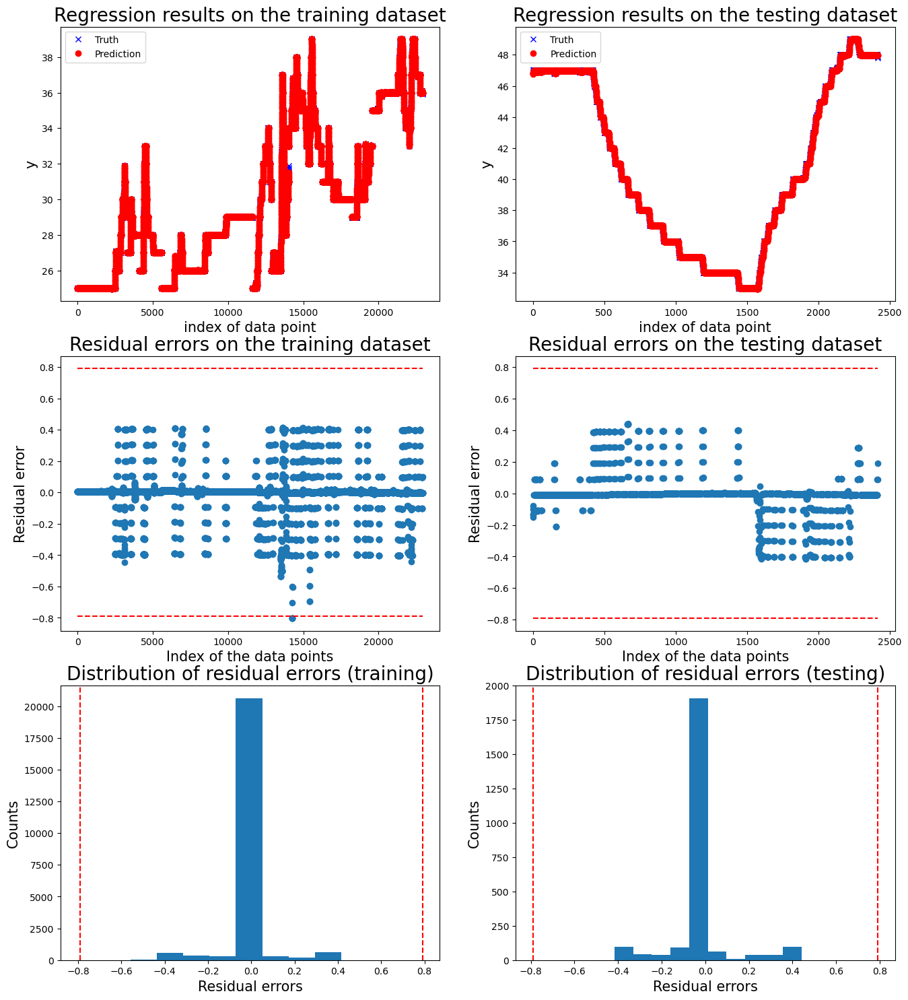

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:04<00:00,  4.51s/it]



 New run:

training performance, max error is: 0.8023678551033626
training performance, mean root square error is: 0.09969733646825635
training performance, residual error > 0.2050678752592862: 6.270454247938212%

 New run:

testing performance, max error is: 0.4145816450496227
testing performance, mean root square error is: 0.07089648207627817
testing performance, residual error > 0.2050678752592862: 3.30188679245283%


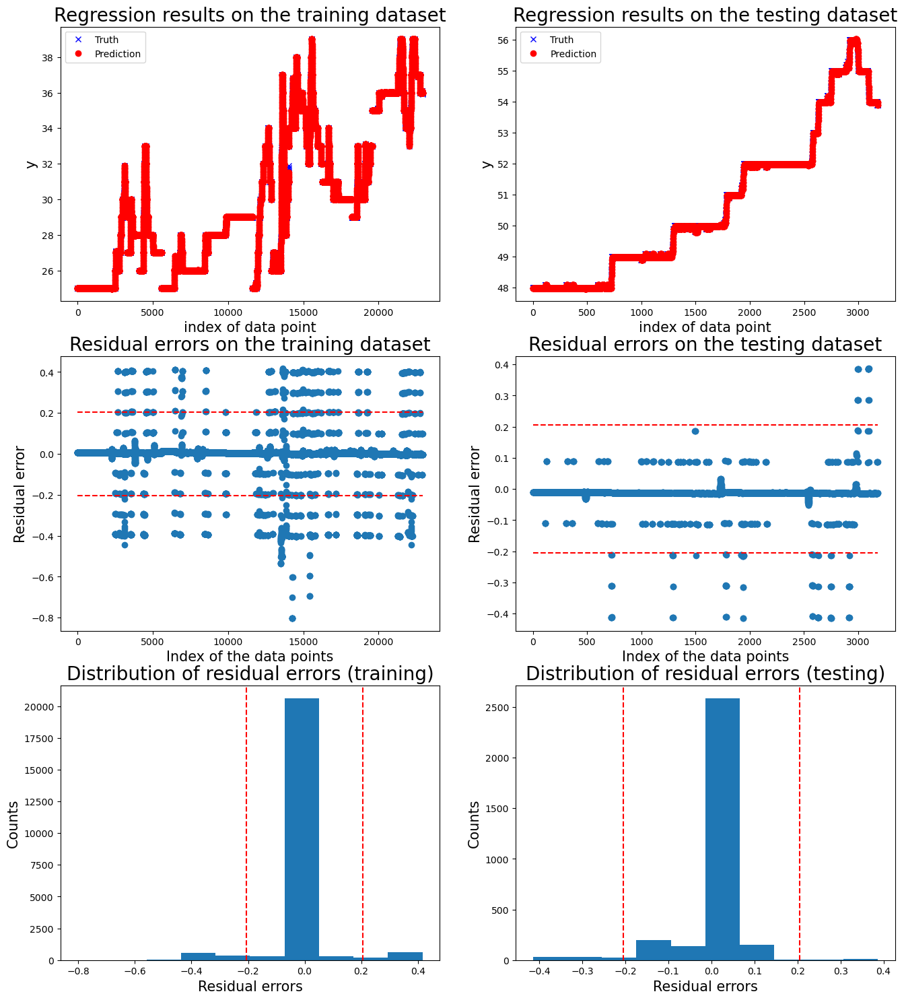

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:04<00:00,  4.11s/it]



 New run:

training performance, max error is: 0.8023678551033626
training performance, mean root square error is: 0.09969733646825635
training performance, residual error > 0.20005530449565828: 6.855173015665226%

 New run:

testing performance, max error is: 0.438514526983397
testing performance, mean root square error is: 0.14557180182672055
testing performance, residual error > 0.20005530449565828: 15.011441647597254%


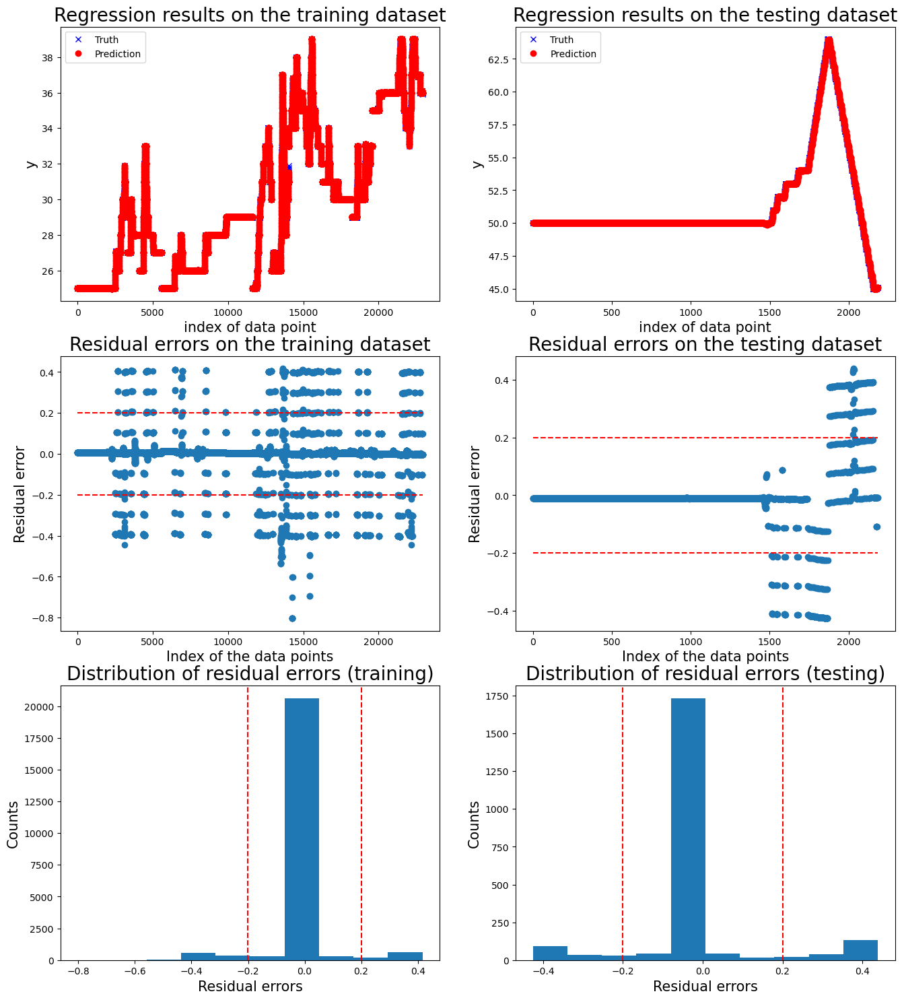

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.29s/it]



 New run:

training performance, max error is: 2.000213484637932
training performance, mean root square error is: 0.09710032237278848
training performance, residual error > 0.43218702098911627: 0.53085600530856%

 New run:

testing performance, max error is: 0.8109870507372321
testing performance, mean root square error is: 0.07560554276412428
testing performance, residual error > 0.43218702098911627: 0.45425048669695006%


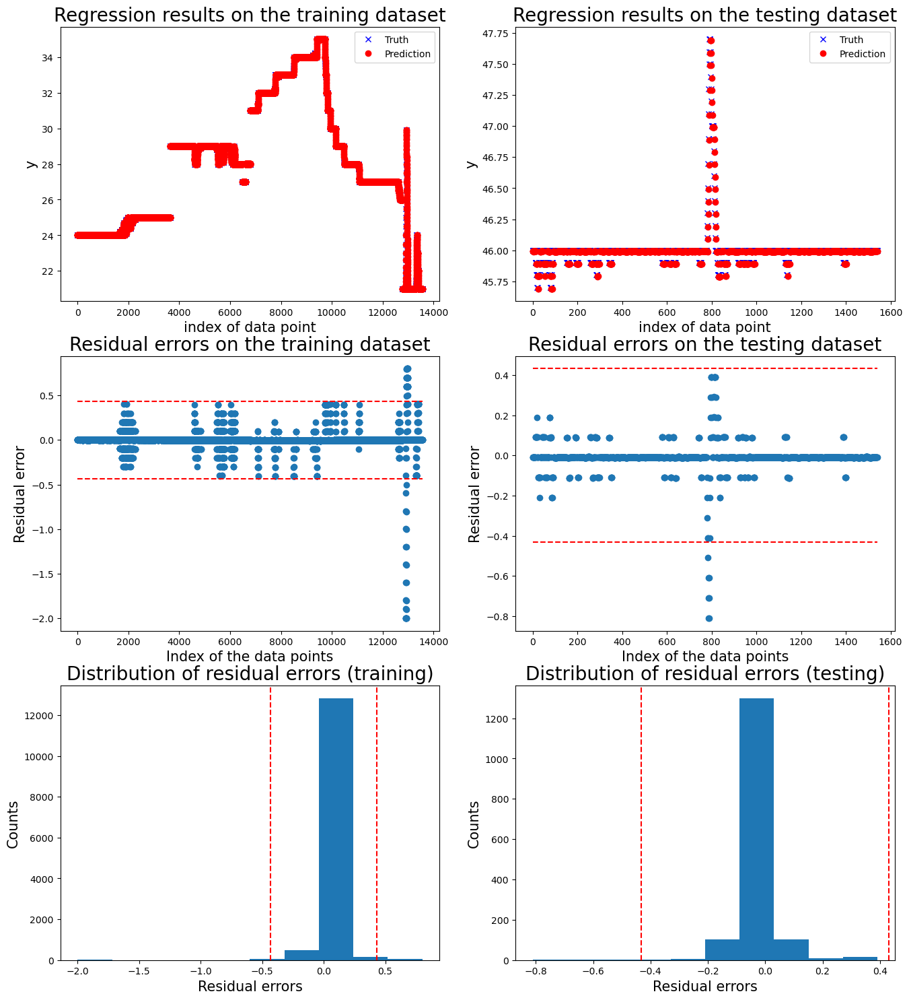

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:01<00:00,  1.54s/it]



 New run:

training performance, max error is: 2.000213484637932
training performance, mean root square error is: 0.09710032237278848
training performance, residual error > 0.2064587777036949: 2.32986802329868%

 New run:

testing performance, max error is: 0.2082019553894554
testing performance, mean root square error is: 0.039318050208483425
testing performance, residual error > 0.2064587777036949: 0.4329004329004329%


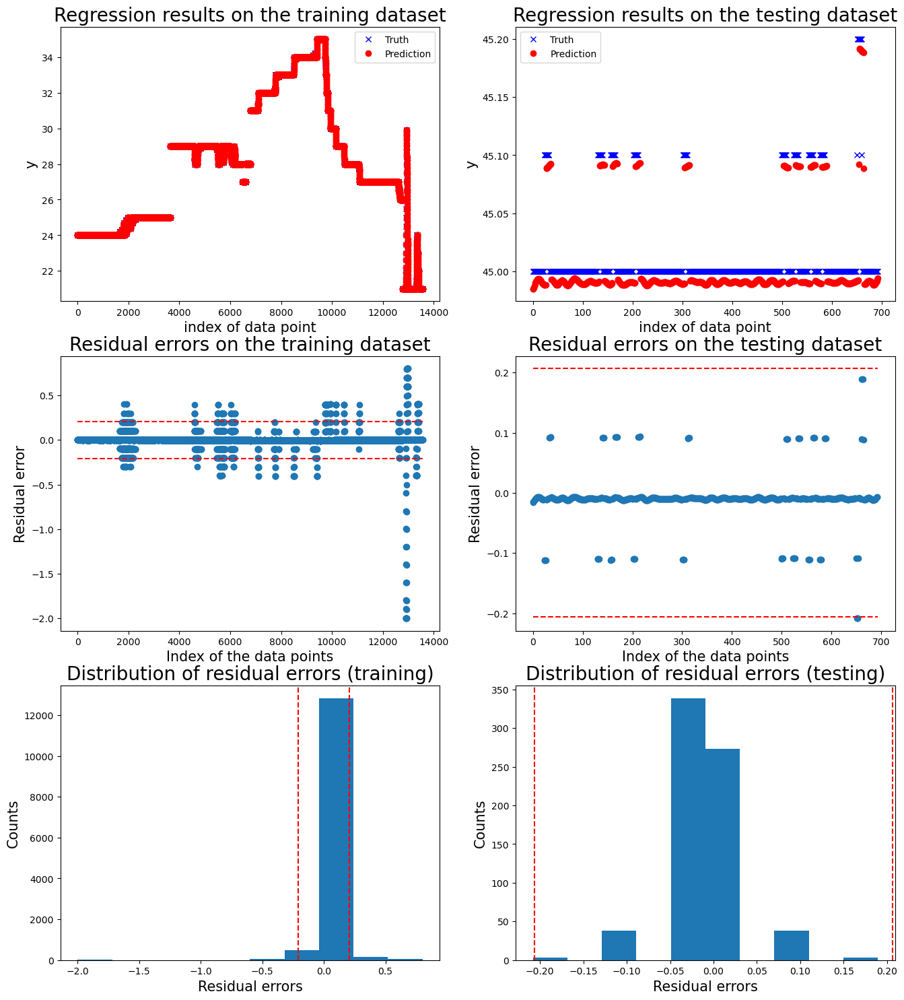

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]



 New run:

training performance, max error is: 2.000213484637932
training performance, mean root square error is: 0.09710032237278848
training performance, residual error > 0.18554061963896307: 4.40905404409054%

 New run:

testing performance, max error is: 0.21178103116164948
testing performance, mean root square error is: 0.03835688248370434
testing performance, residual error > 0.18554061963896307: 0.3246753246753247%


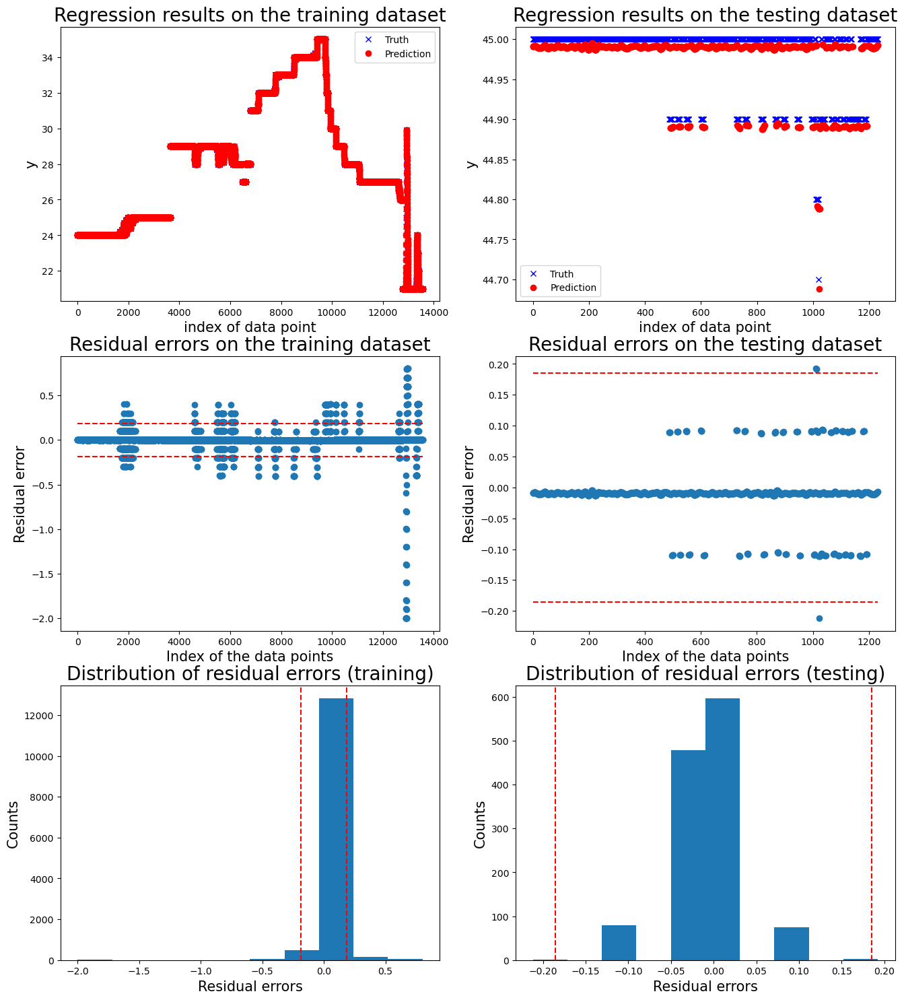

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:01<00:00,  1.39s/it]



 New run:

training performance, max error is: 1.2021849677279803
training performance, mean root square error is: 0.11761680972624806
training performance, residual error > 0.9808563803418986: 0.0983477576711251%

 New run:

testing performance, max error is: 2.8499674347101944
testing performance, mean root square error is: 0.37703883721469145
testing performance, residual error > 0.9808563803418986: 2.303523035230352%


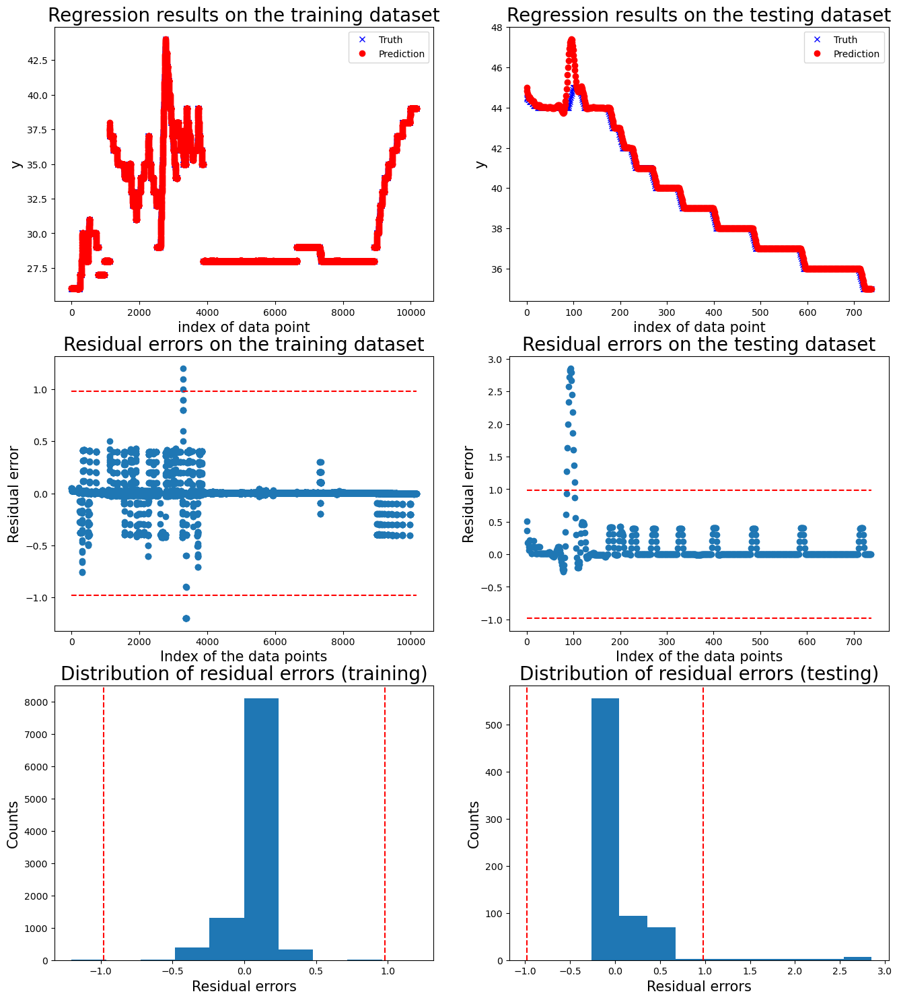

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.53s/it]



 New run:

training performance, max error is: 1.2021849677279803
training performance, mean root square error is: 0.11761680972624806
training performance, residual error > 0.2: 8.379228953579858%

 New run:

testing performance, max error is: 0.4062110174274096
testing performance, mean root square error is: 0.032915663738748234
testing performance, residual error > 0.2: 1.0869565217391304%


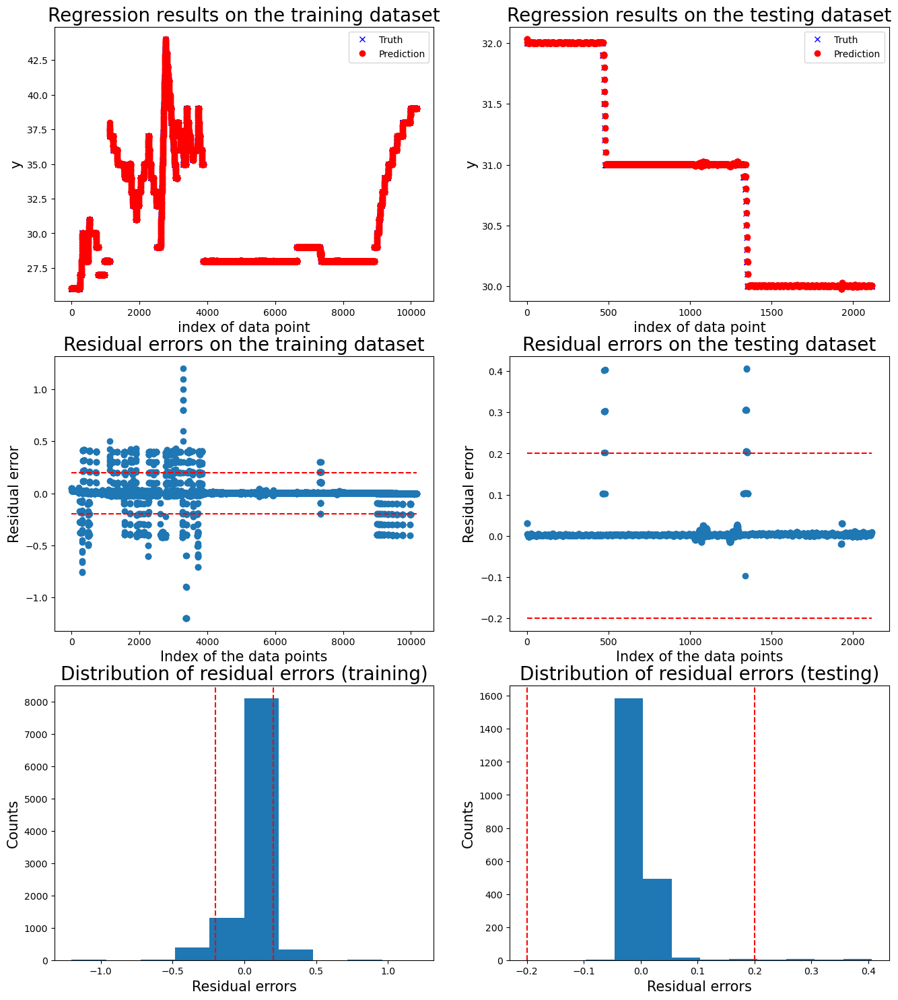

Motor  2
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.75s/it]



 New run:

training performance, max error is: 1.0026354489866307
training performance, mean root square error is: 0.12215567105797226
training performance, residual error > 0.5: 1.6684865691198953%

 New run:

testing performance, max error is: 0.5000585434065528
testing performance, mean root square error is: 0.07279278121450446
testing performance, residual error > 0.5: 0.08285004142502071%


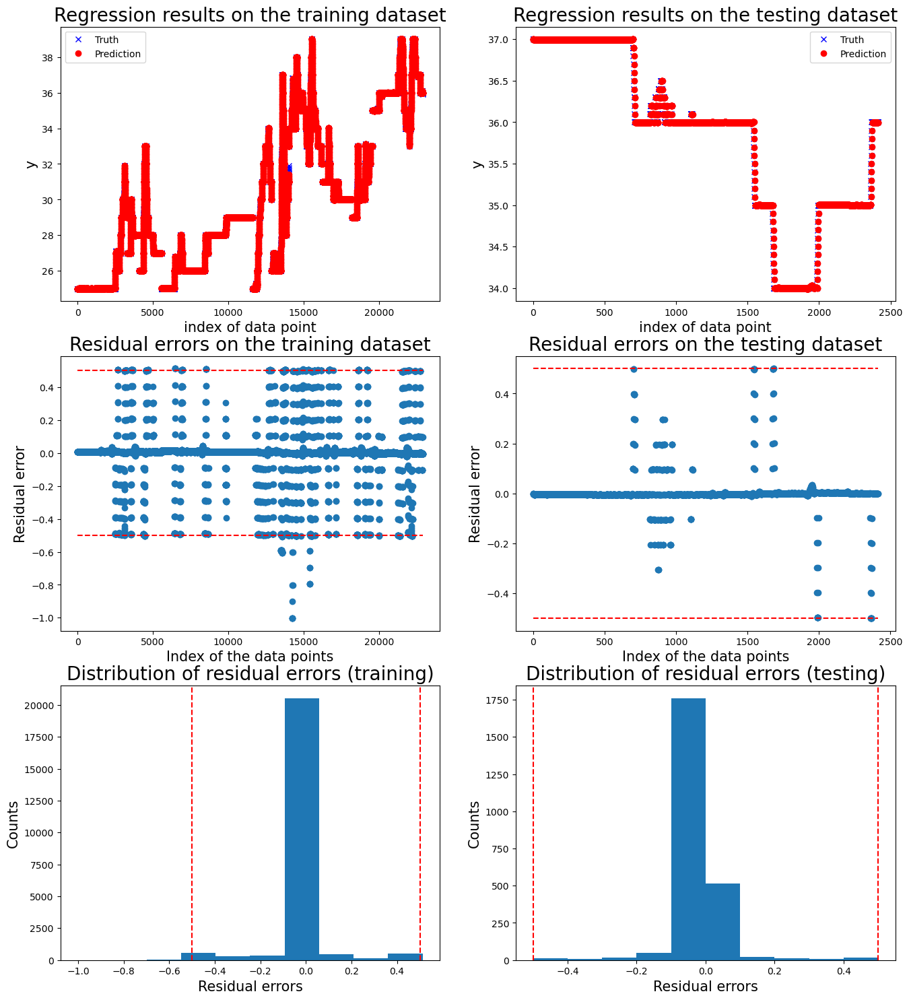

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:04<00:00,  4.55s/it]



 New run:

training performance, max error is: 1.0026354489866307
training performance, mean root square error is: 0.12215567105797226
training performance, residual error > 0.5: 1.6684865691198953%

 New run:

testing performance, max error is: 0.5026228551706922
testing performance, mean root square error is: 0.07281939402808203
testing performance, residual error > 0.5: 0.5034612964128383%


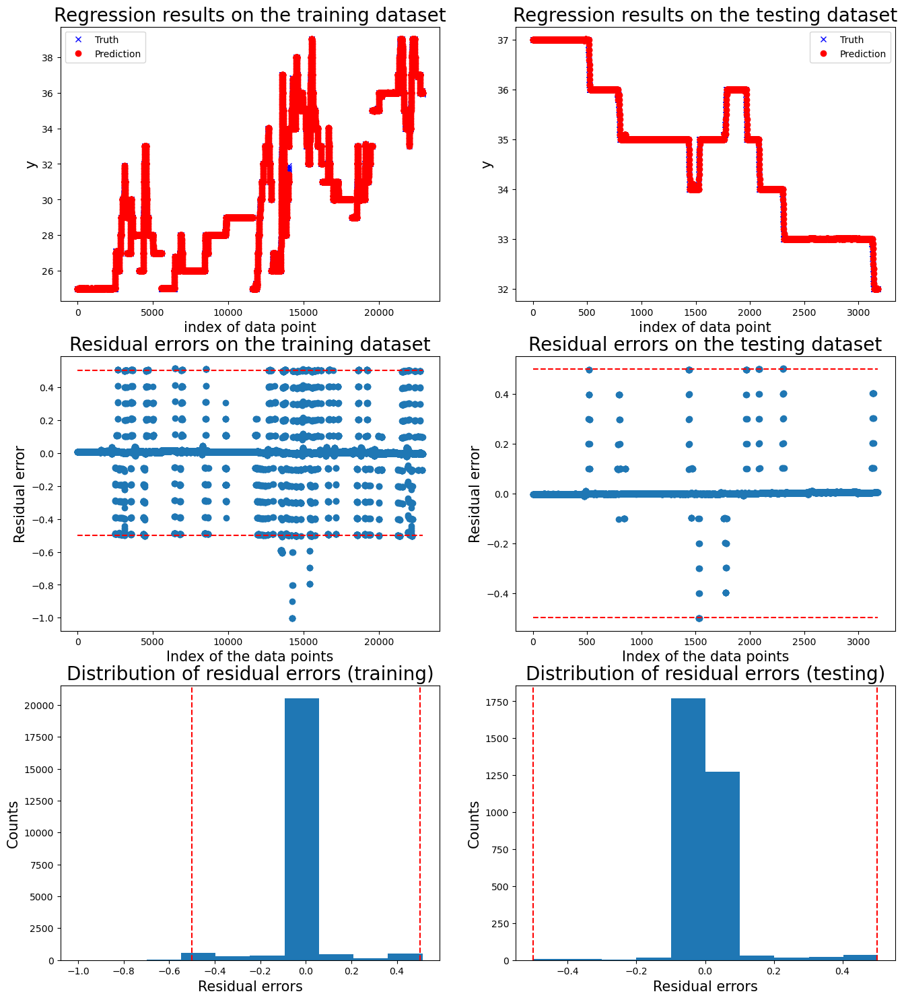

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.28s/it]



 New run:

training performance, max error is: 1.0026354489866307
training performance, mean root square error is: 0.12215567105797226
training performance, residual error > 0.5: 1.6684865691198953%

 New run:

testing performance, max error is: 0.4948273199376203
testing performance, mean root square error is: 0.05031937361447325
testing performance, residual error > 0.5: 0.0%


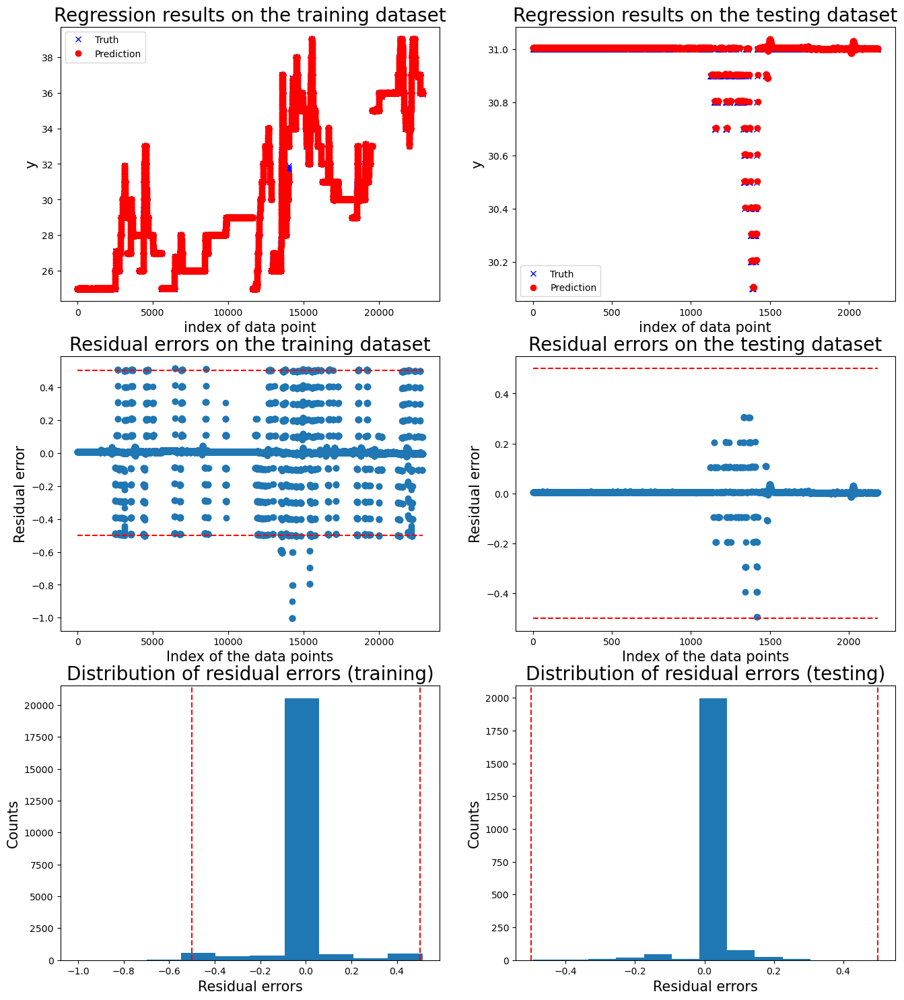

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.26s/it]



 New run:

training performance, max error is: 2.4989447515484144
training performance, mean root square error is: 0.11622863141005783
training performance, residual error > 0.1: 7.194803360869873%

 New run:

testing performance, max error is: 1.6036922585486266
testing performance, mean root square error is: 0.14406871337367683
testing performance, residual error > 0.1: 3.6387264457439894%


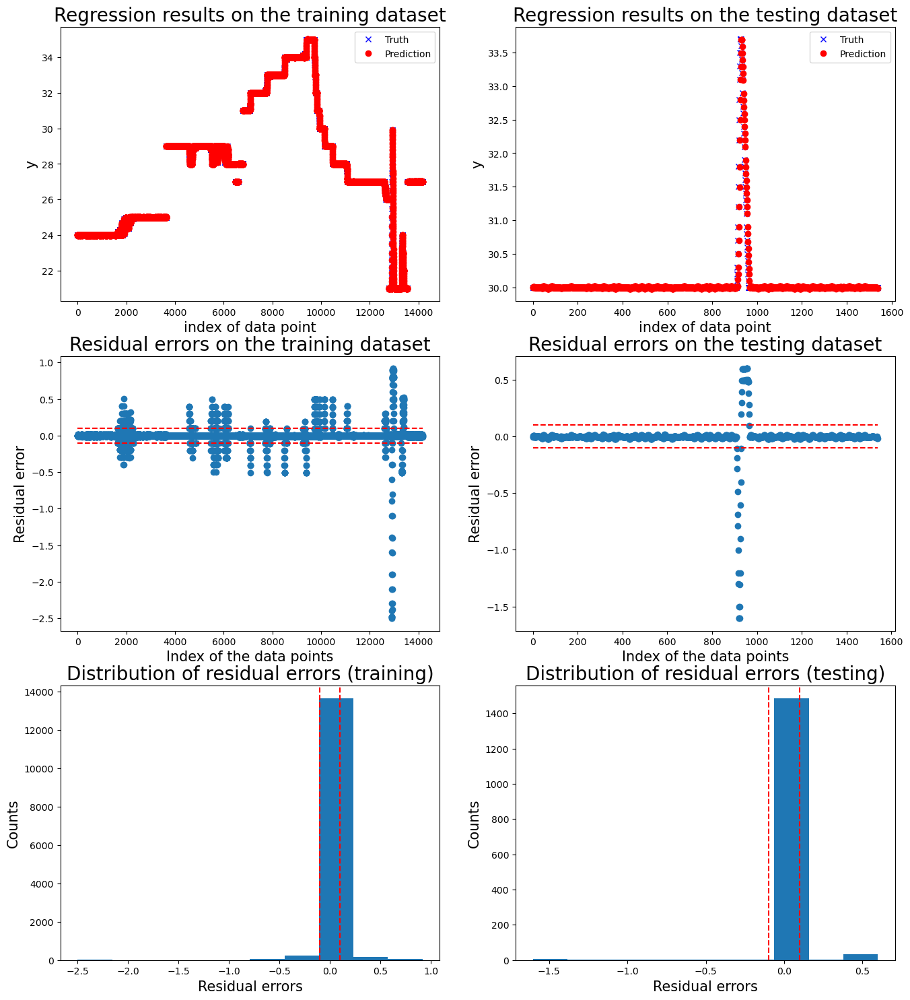

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:00<00:00,  1.29it/s]



 New run:

training performance, max error is: 2.4989447515484144
training performance, mean root square error is: 0.11622863141005783
training performance, residual error > 0.1: 7.194803360869873%

 New run:

testing performance, max error is: 0.02252528161832501
testing performance, mean root square error is: 0.008636164374723015
testing performance, residual error > 0.1: 0.0%


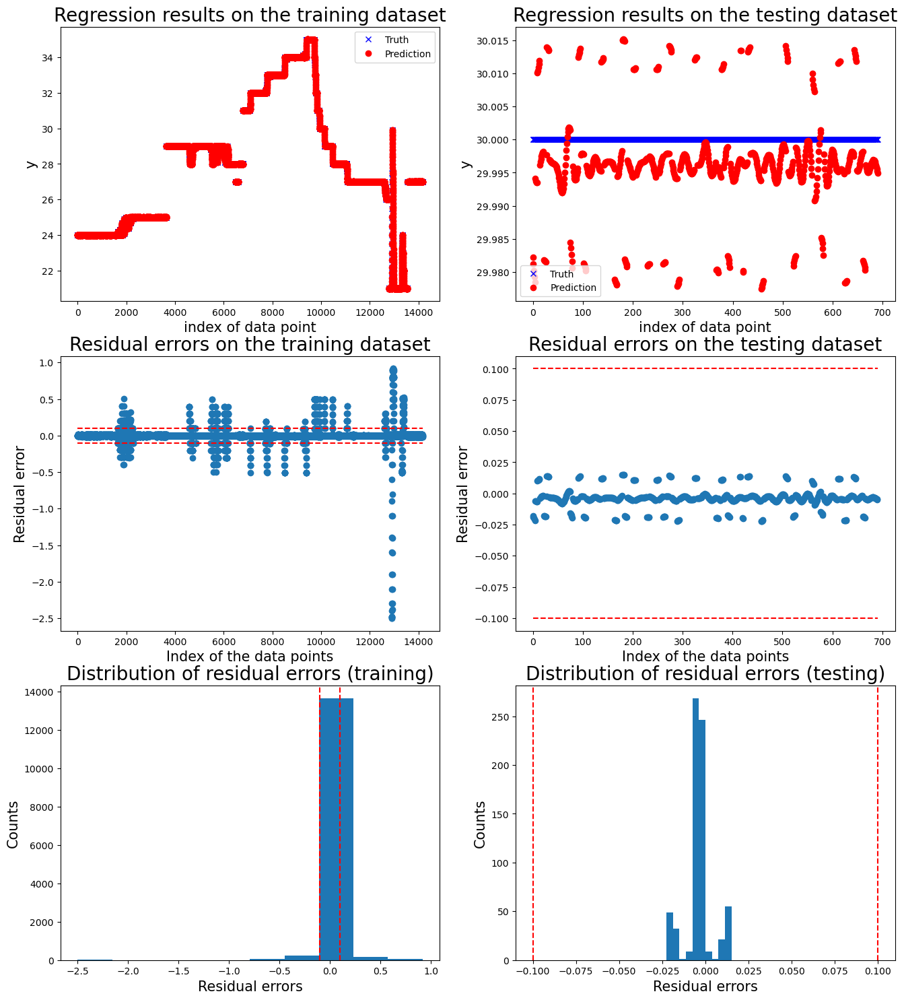

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]



 New run:

training performance, max error is: 2.4989447515484144
training performance, mean root square error is: 0.11622863141005783
training performance, residual error > 0.1: 7.194803360869873%

 New run:

testing performance, max error is: 4.403517240095198
testing performance, mean root square error is: 0.4340163736693996
testing performance, residual error > 0.1: 3.495934959349593%


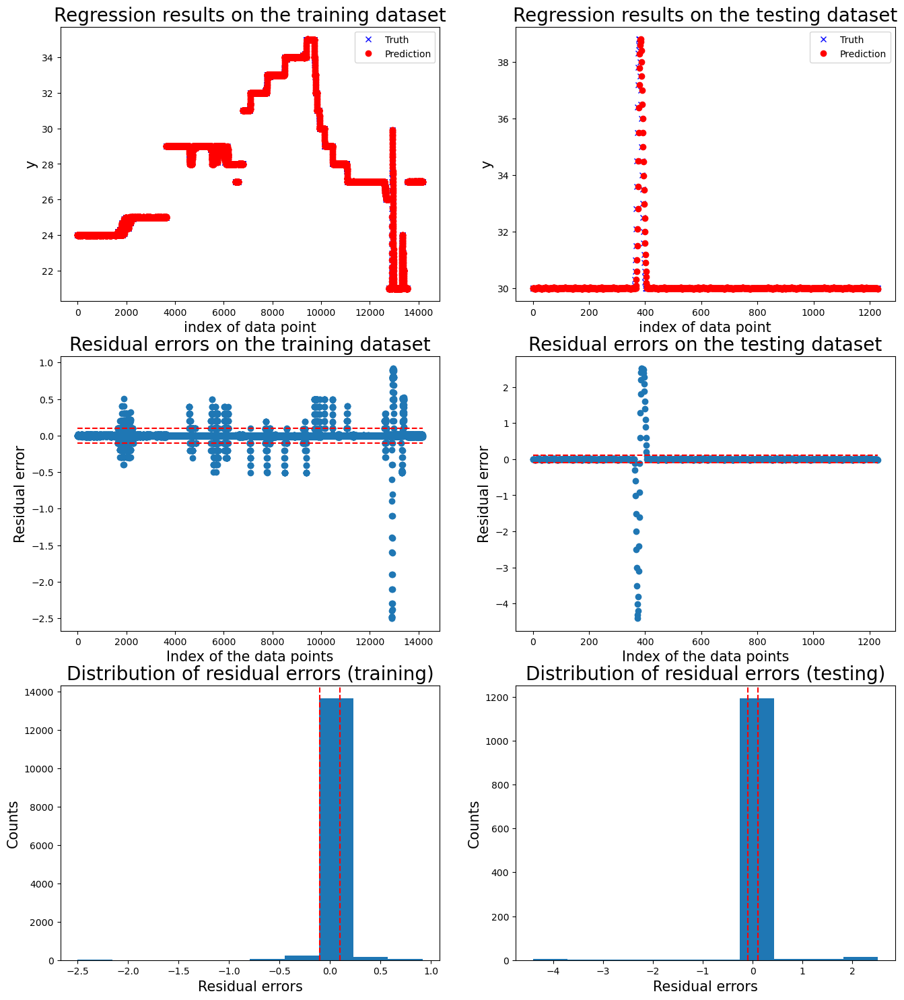

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]



 New run:

training performance, max error is: 1.503106742186766
training performance, mean root square error is: 0.11845476855624784
training performance, residual error > 0.5: 1.7531421205285207%

 New run:

testing performance, max error is: 0.002200486372110788
testing performance, mean root square error is: 0.0004778071439374372
testing performance, residual error > 0.5: 0.0%


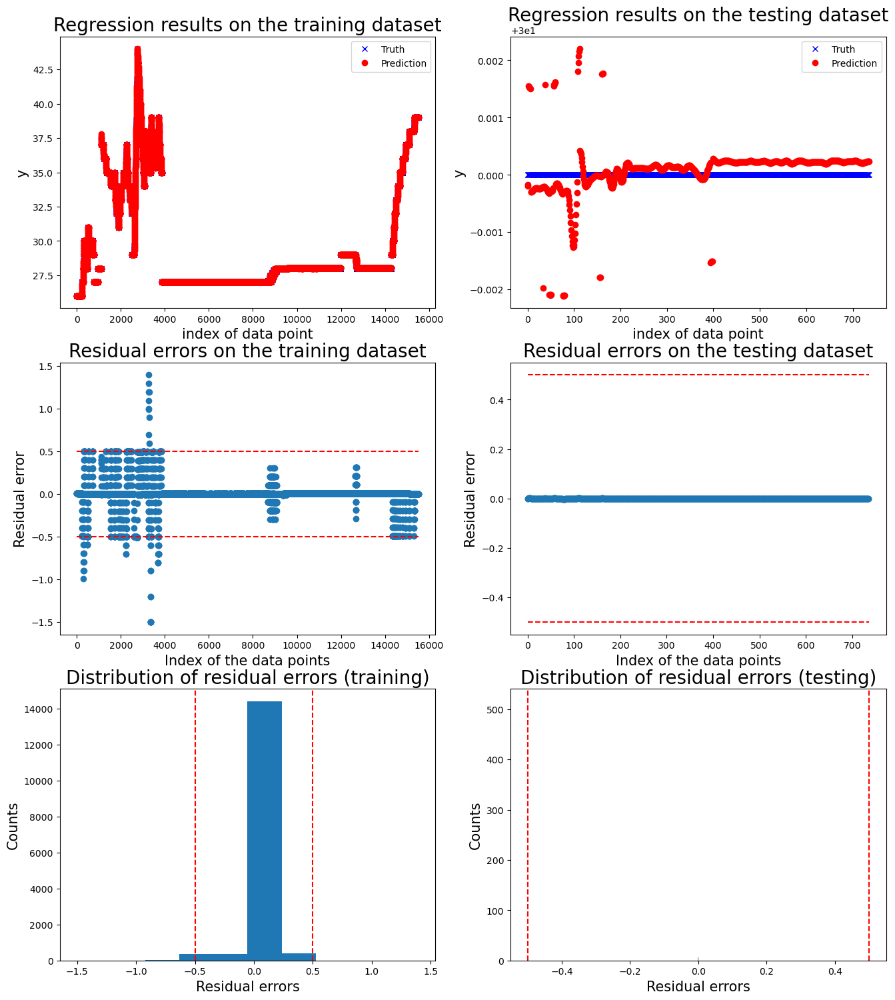

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:04<00:00,  4.33s/it]



 New run:

training performance, max error is: 1.503106742186766
training performance, mean root square error is: 0.11845476855624784
training performance, residual error > 0.8539434412470019: 0.1353528843055108%

 New run:

testing performance, max error is: 2.3797407830999973
testing performance, mean root square error is: 0.2646889204494365
testing performance, residual error > 0.8539434412470019: 1.8448438978240302%


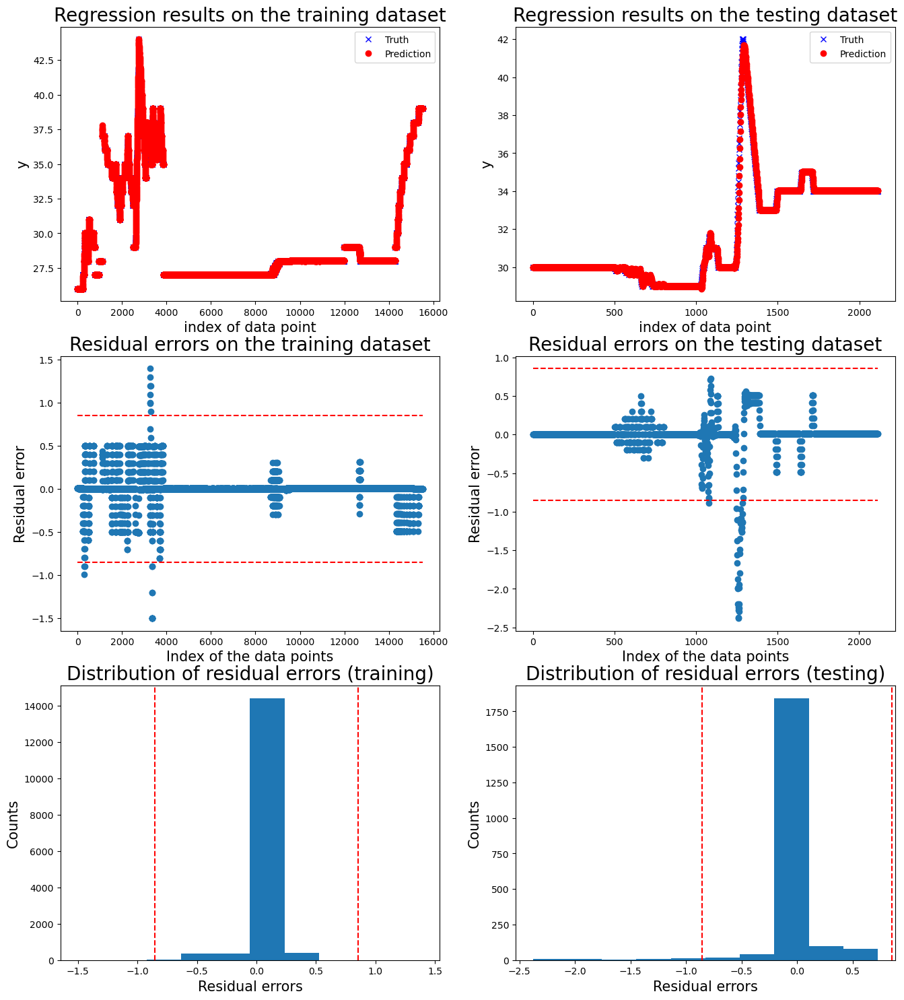

Motor  3
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.48s/it]



 New run:

training performance, max error is: 1.0023384923631014
training performance, mean root square error is: 0.12212403295800316
training performance, residual error > 0.7: 0.04367765887748416%

 New run:

testing performance, max error is: 0.46564235849651325
testing performance, mean root square error is: 0.033012656950105634
testing performance, residual error > 0.7: 0.0%


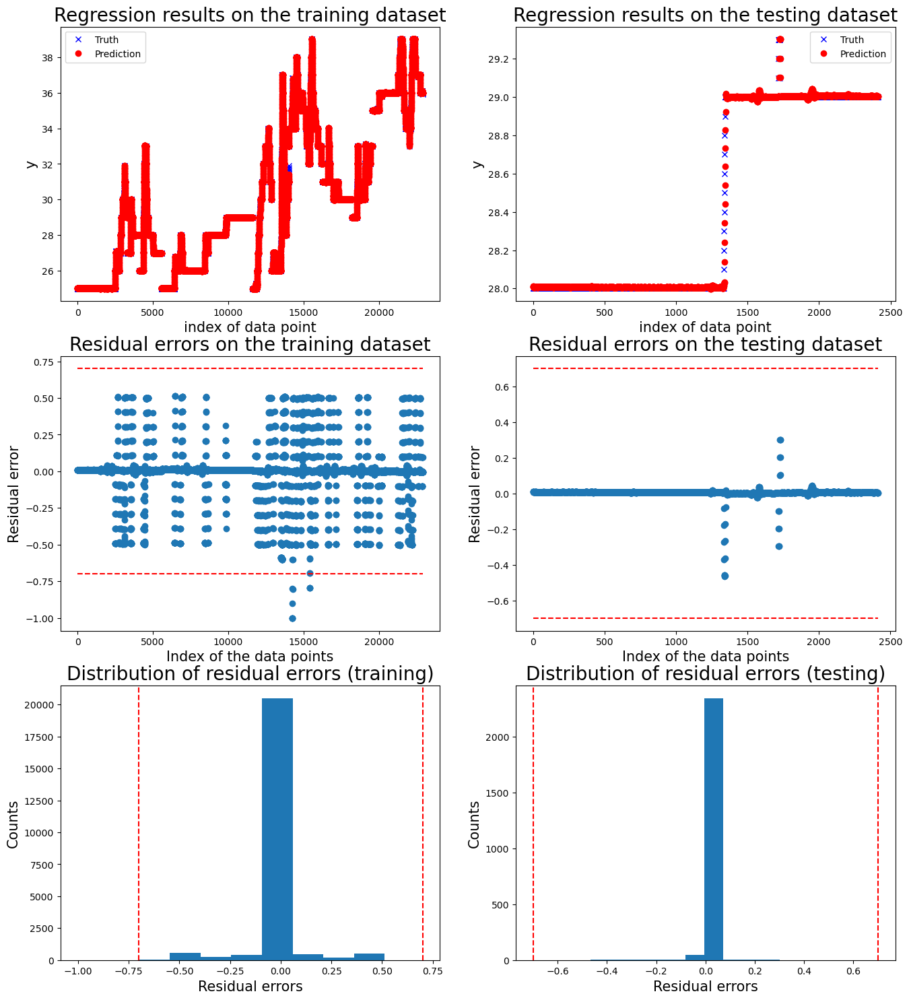

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:04<00:00,  4.55s/it]



 New run:

training performance, max error is: 1.0023384923631014
training performance, mean root square error is: 0.12212403295800316
training performance, residual error > 1.0858973696570937: 0.0%

 New run:

testing performance, max error is: 0.9983320626998022
testing performance, mean root square error is: 0.18474805882674797
testing performance, residual error > 1.0858973696570937: 0.0%


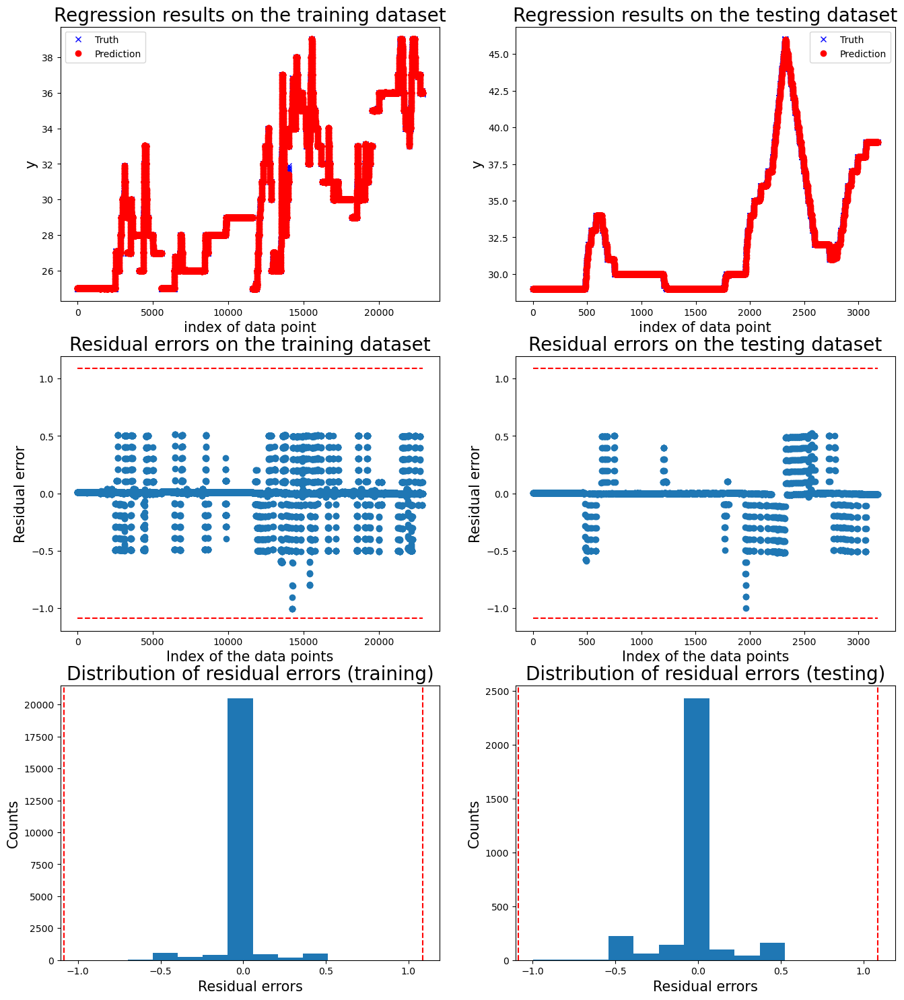

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.35s/it]



 New run:

training performance, max error is: 1.0023384923631014
training performance, mean root square error is: 0.12212403295800316
training performance, residual error > 0.7: 0.04367765887748416%

 New run:

testing performance, max error is: 0.5192068666015857
testing performance, mean root square error is: 0.10186811757256169
testing performance, residual error > 0.7: 0.0%


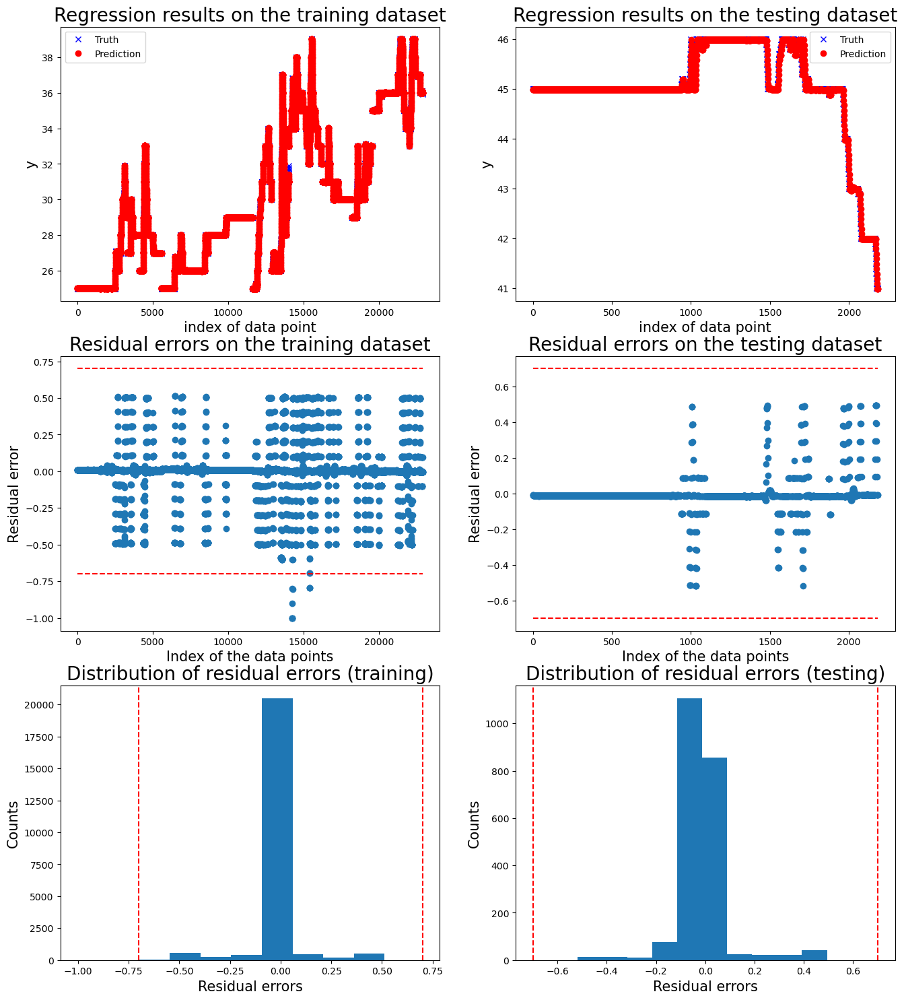

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.00s/it]



 New run:

training performance, max error is: 2.5001153232719915
training performance, mean root square error is: 0.1163064941237486
training performance, residual error > 0.33137639308304956: 1.7581020970133445%

 New run:

testing performance, max error is: 2.8002270291802063
testing performance, mean root square error is: 0.23984795998320893
testing performance, residual error > 0.33137639308304956: 2.53411306042885%


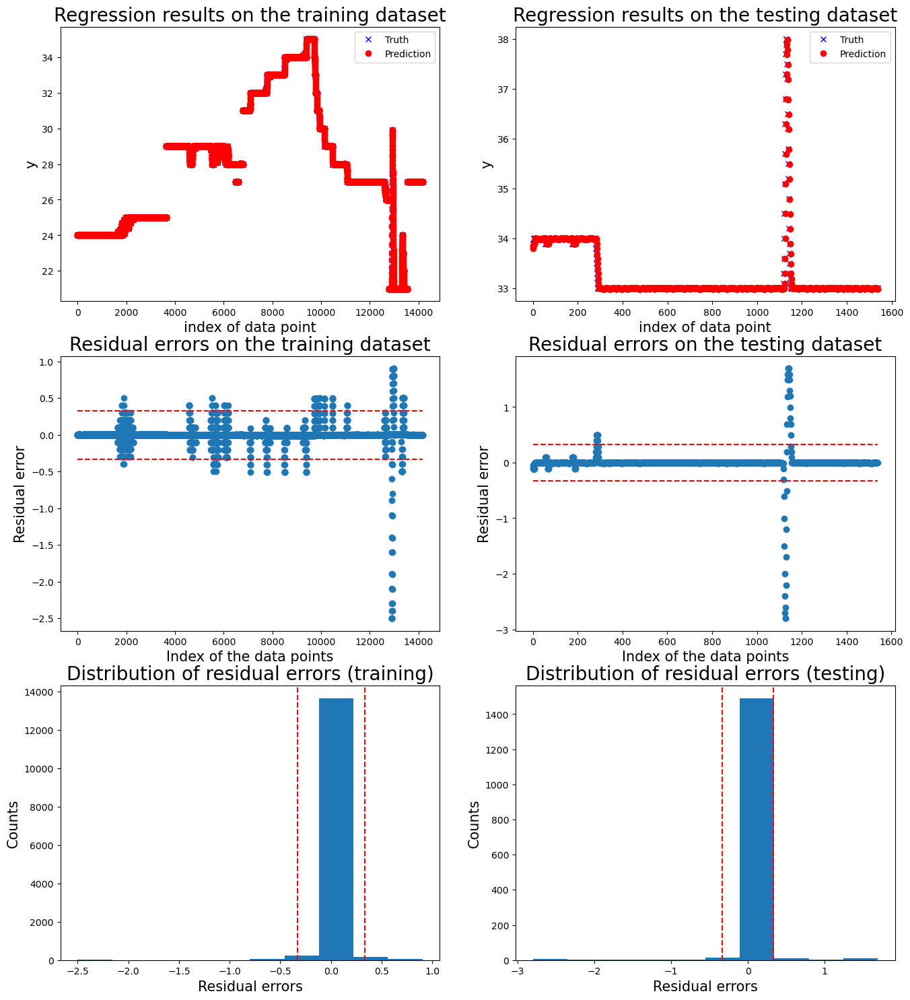

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:01<00:00,  1.17s/it]



 New run:

training performance, max error is: 2.5001153232719915
training performance, mean root square error is: 0.1163064941237486
training performance, residual error > 0.1: 7.265409870790086%

 New run:

testing performance, max error is: 0.007794835041273984
testing performance, mean root square error is: 0.0042808157978424435
testing performance, residual error > 0.1: 0.0%


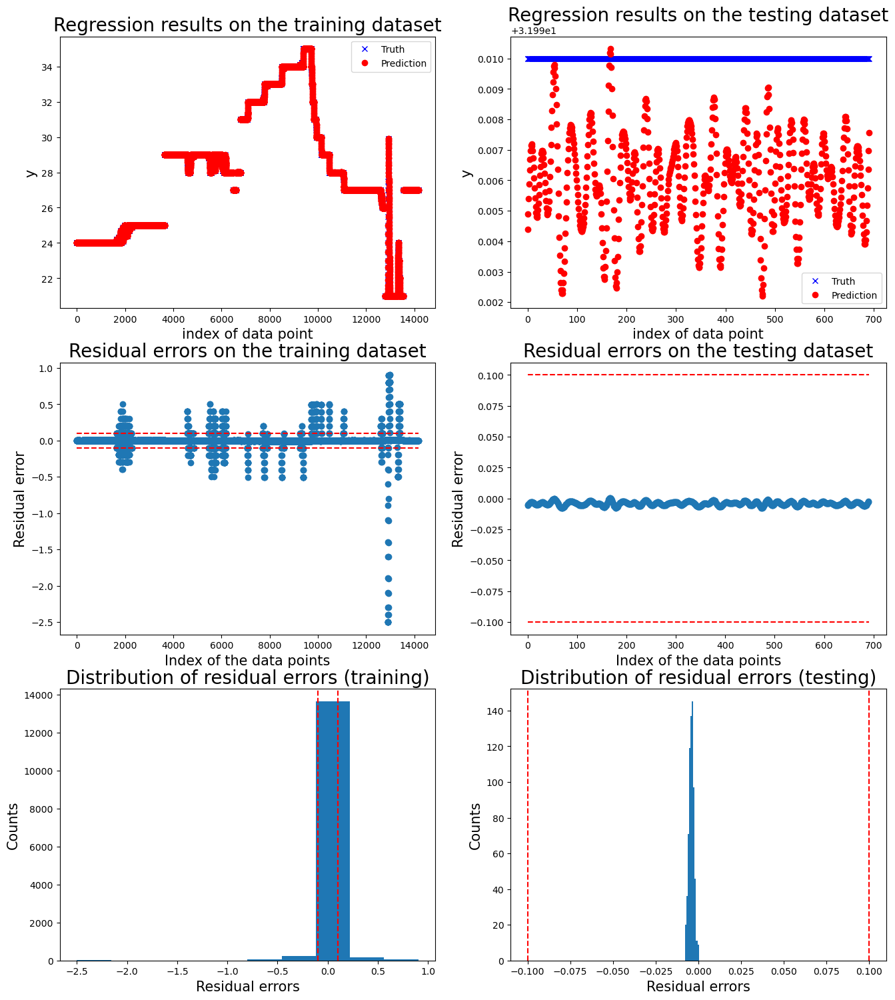

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.75s/it]



 New run:

training performance, max error is: 2.5001153232719915
training performance, mean root square error is: 0.1163064941237486
training performance, residual error > 0.1: 7.265409870790086%

 New run:

testing performance, max error is: 0.10404762930046019
testing performance, mean root square error is: 0.013497188712810427
testing performance, residual error > 0.1: 0.8130081300813009%


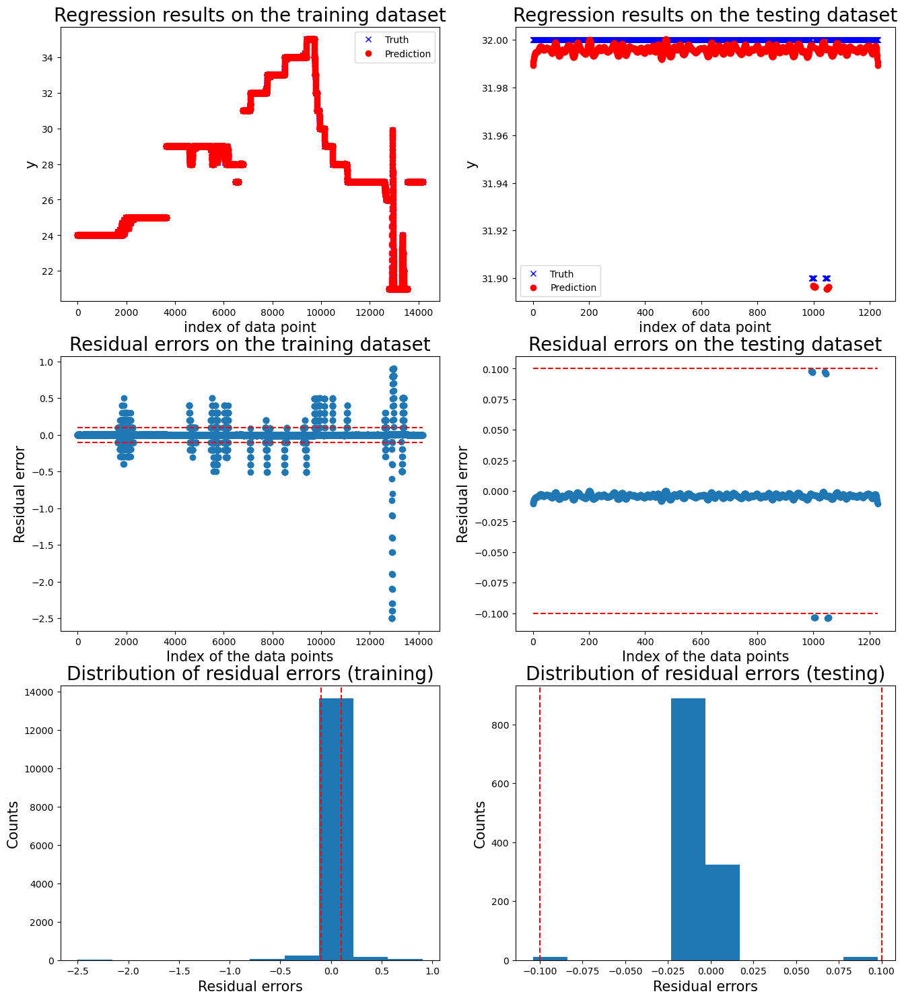

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:00<00:00,  1.06it/s]



 New run:

training performance, max error is: 1.5028262899530418
training performance, mean root square error is: 0.11844551379204436
training performance, residual error > 1.4161444804102357: 0.03867225265871737%

 New run:

testing performance, max error is: 0.7981456661637445
testing performance, mean root square error is: 0.12269357974769356
testing performance, residual error > 1.4161444804102357: 0.0%


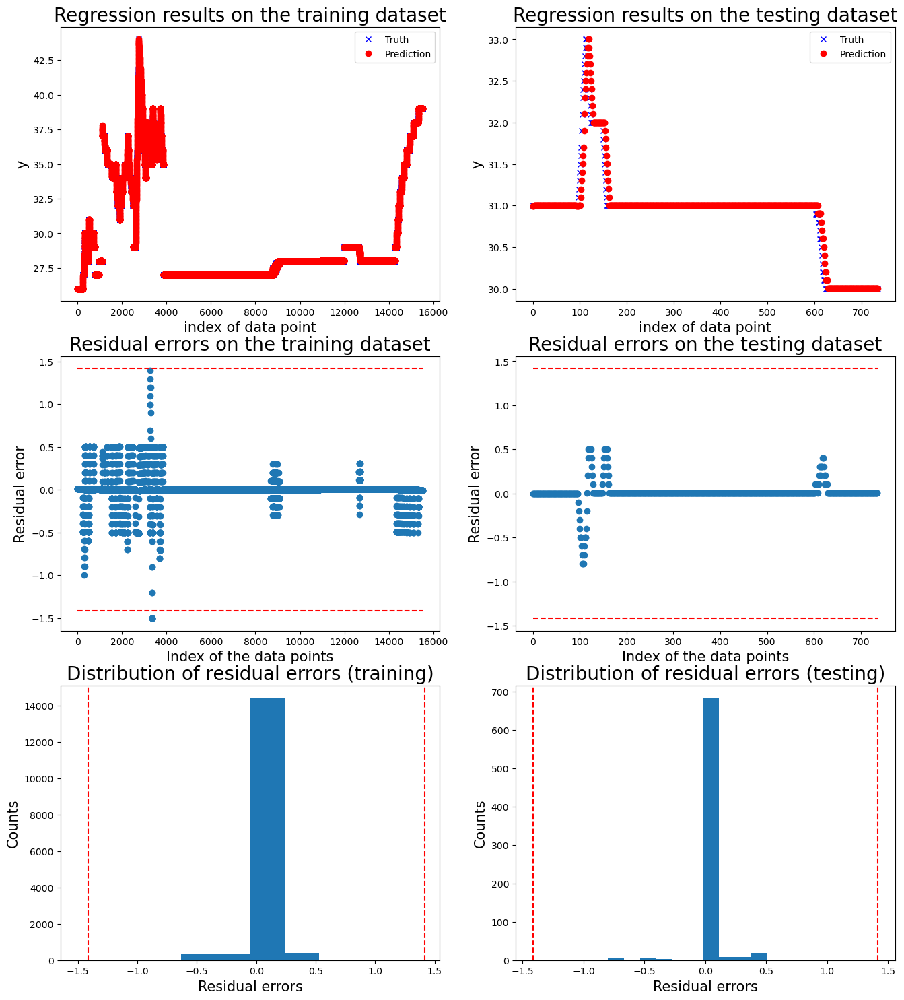

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.19s/it]



 New run:

training performance, max error is: 1.5028262899530418
training performance, mean root square error is: 0.11844551379204436
training performance, residual error > 0.7: 0.2191427650660651%

 New run:

testing performance, max error is: 0.009161293920325164
testing performance, mean root square error is: 0.004505054907944771
testing performance, residual error > 0.7: 0.0%


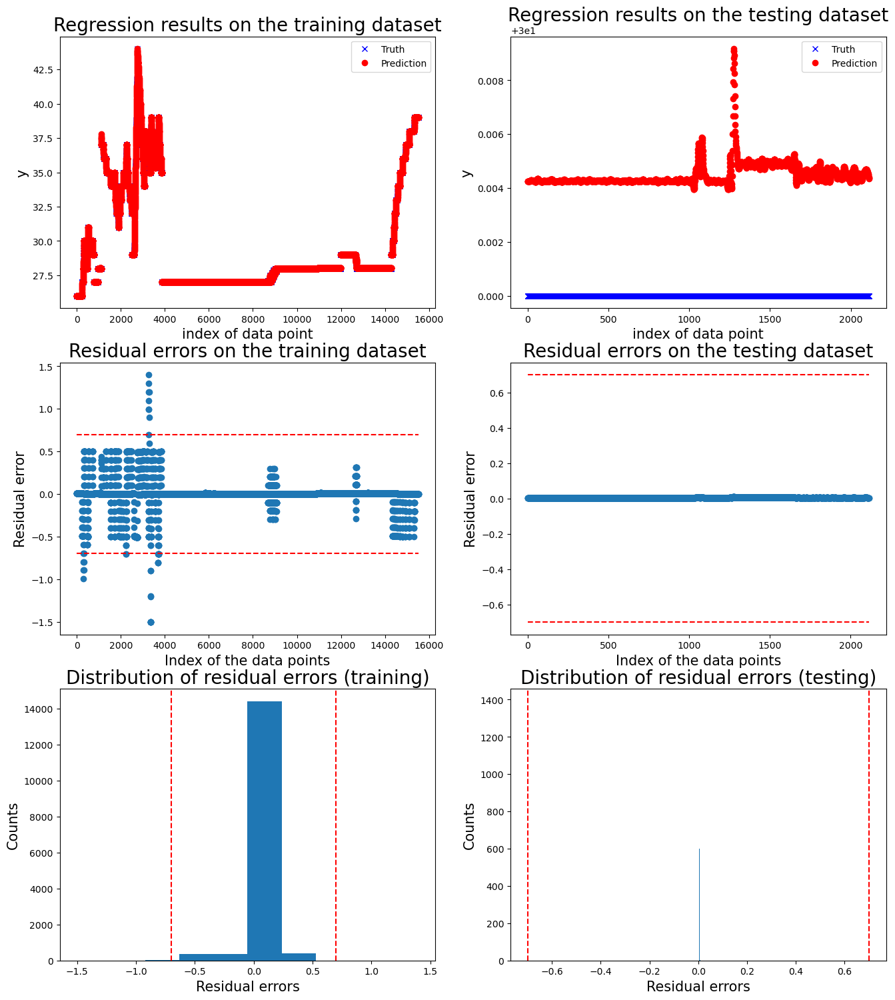

Motor  4
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.44s/it]



 New run:

training performance, max error is: 1.0078648329800828
training performance, mean root square error is: 0.12208804807134416
training performance, residual error > 0.35: 5.402926403144791%

 New run:

testing performance, max error is: 0.505329994664244
testing performance, mean root square error is: 0.08301797832379244
testing performance, residual error > 0.35: 2.651201325600663%


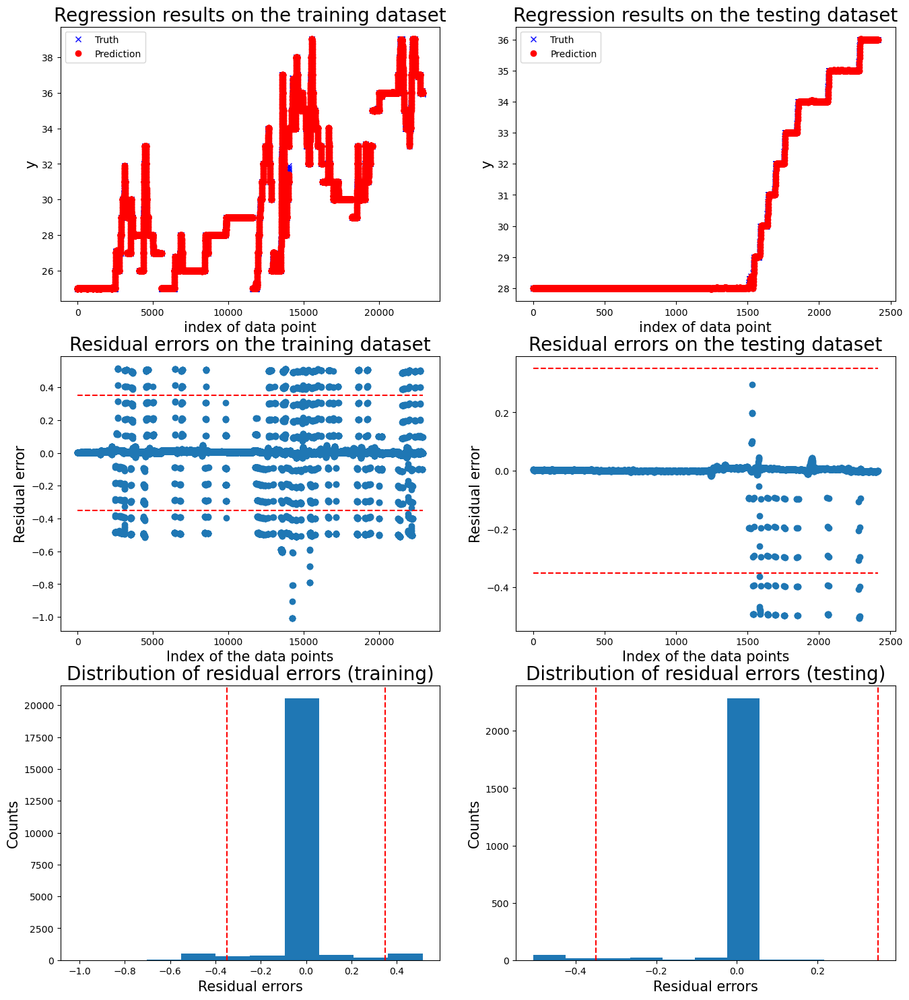

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:04<00:00,  4.69s/it]



 New run:

training performance, max error is: 1.0078648329800828
training performance, mean root square error is: 0.12208804807134416
training performance, residual error > 0.35: 5.402926403144791%

 New run:

testing performance, max error is: 0.516256733518631
testing performance, mean root square error is: 0.08827882164588612
testing performance, residual error > 0.35: 2.8319697923222154%


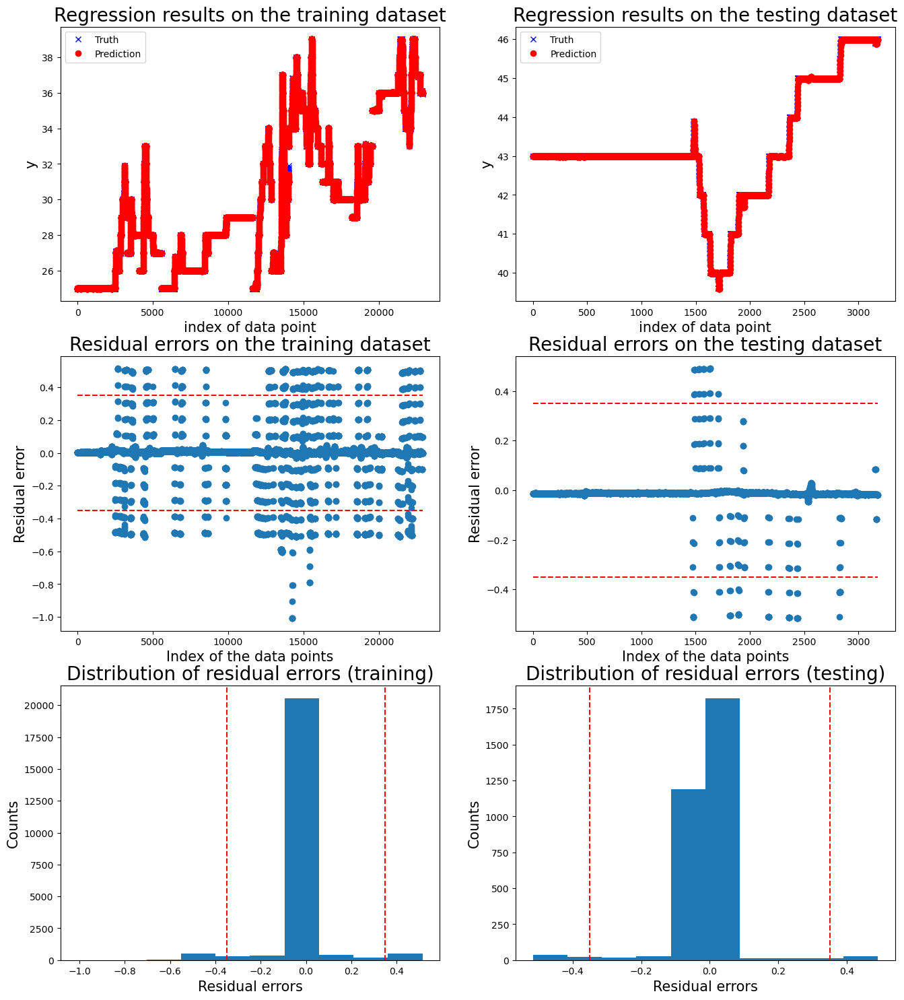

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.12s/it]



 New run:

training performance, max error is: 1.0078648329800828
training performance, mean root square error is: 0.12208804807134416
training performance, residual error > 0.4495787118409829: 3.9659314260755627%

 New run:

testing performance, max error is: 0.5298191589138384
testing performance, mean root square error is: 0.14856940179626063
testing performance, residual error > 0.4495787118409829: 5.771873568483739%


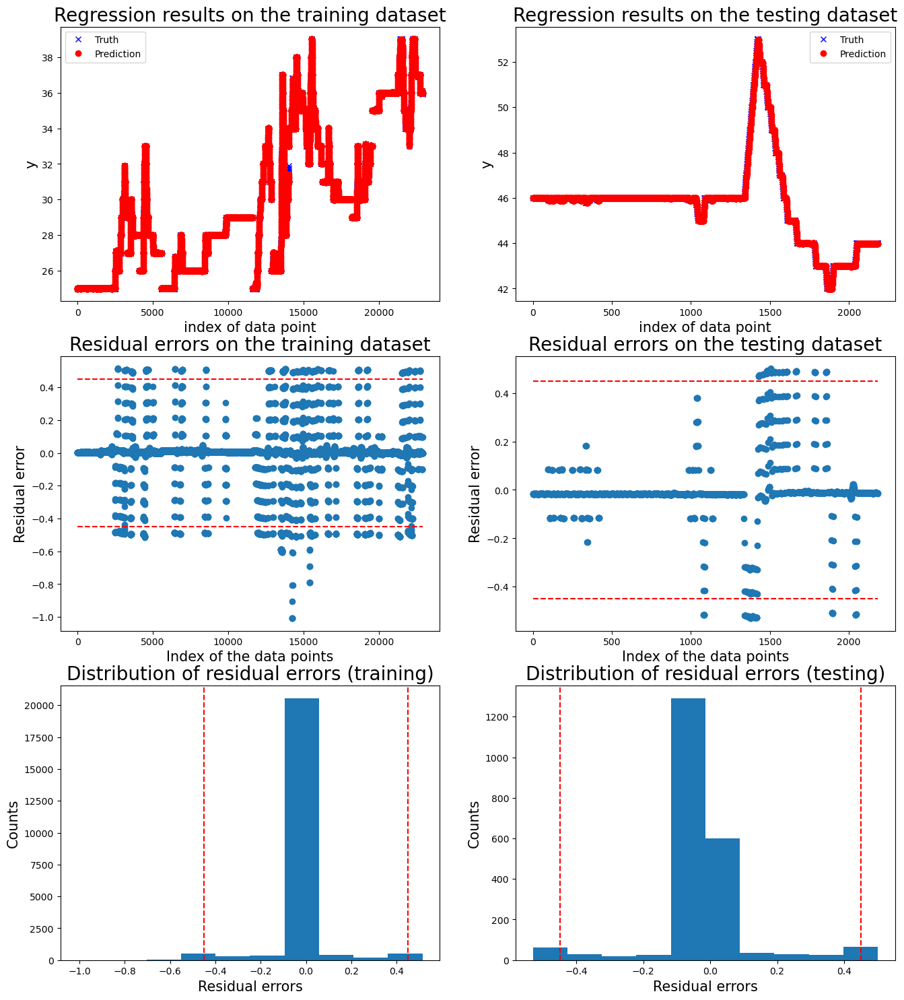

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.21s/it]



 New run:

training performance, max error is: 2.4999724264276146
training performance, mean root square error is: 0.11631253019360742
training performance, residual error > 0.1: 7.159500105909765%

 New run:

testing performance, max error is: 4.415623481895949
testing performance, mean root square error is: 0.38738099837056034
testing performance, residual error > 0.1: 3.7686809616634176%


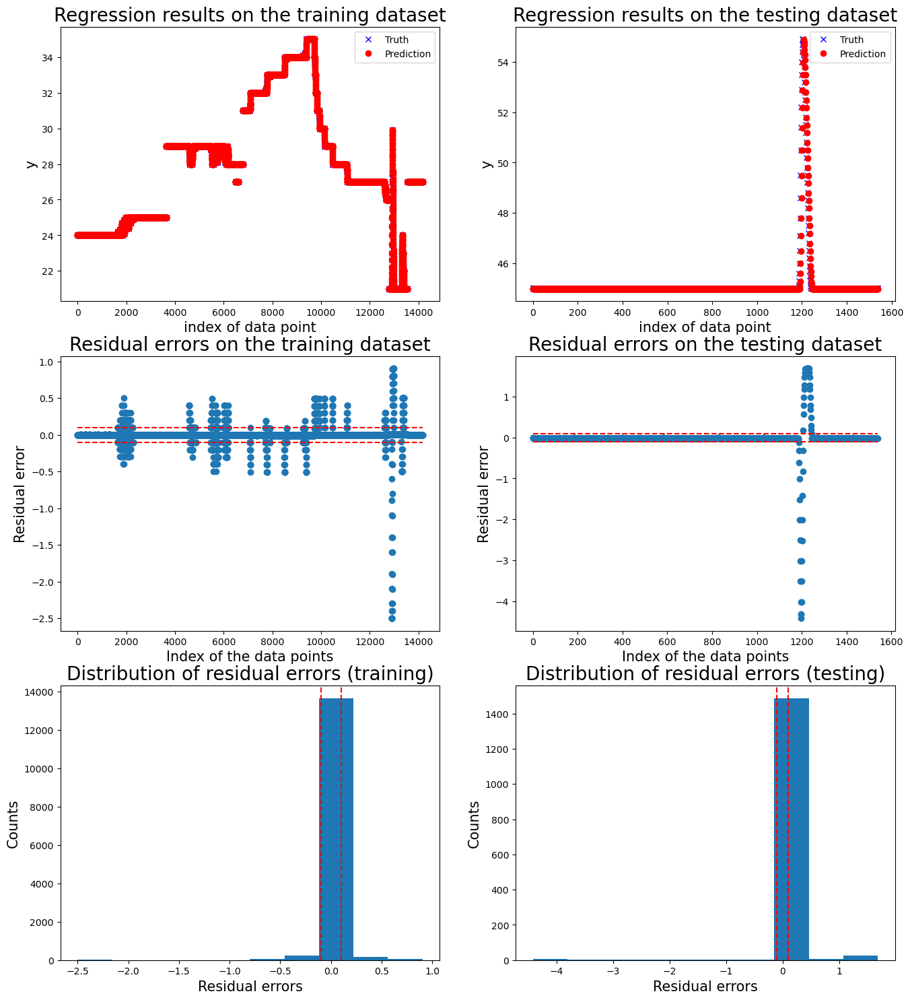

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:00<00:00,  1.17it/s]



 New run:

training performance, max error is: 2.4999724264276146
training performance, mean root square error is: 0.11631253019360742
training performance, residual error > 0.1: 7.159500105909765%

 New run:

testing performance, max error is: 0.015419929744759031
testing performance, mean root square error is: 0.013583170151168566
testing performance, residual error > 0.1: 0.0%


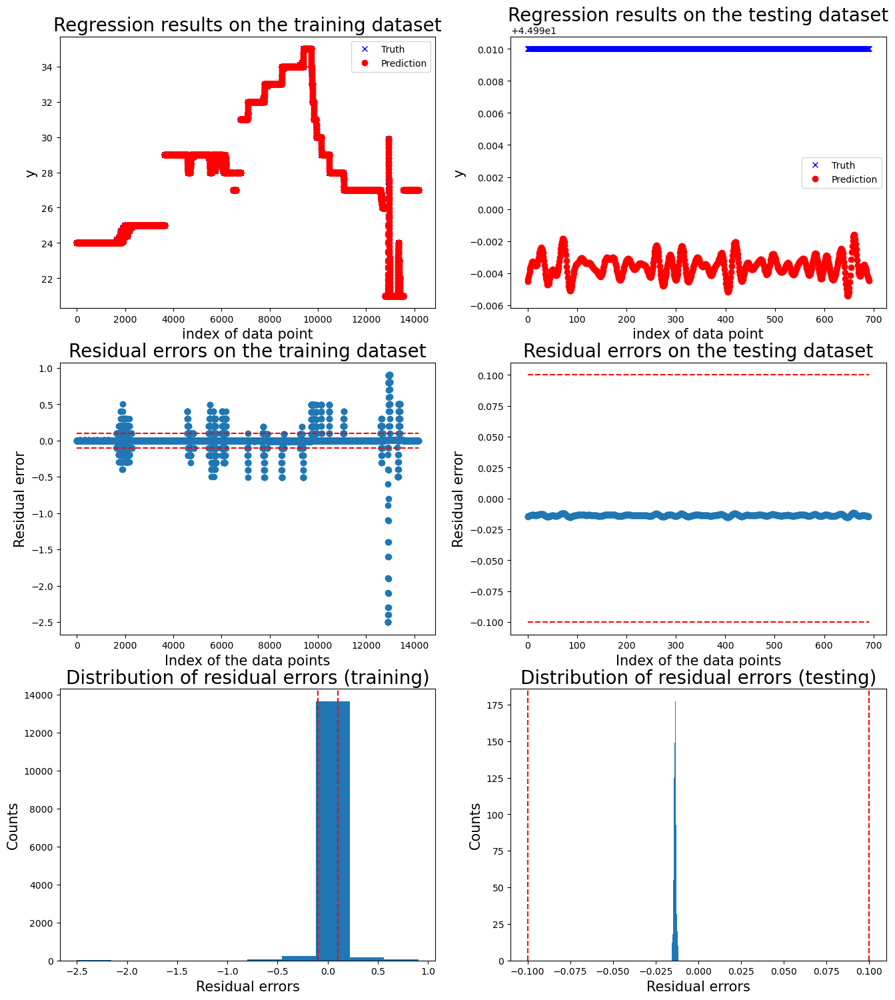

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.77s/it]



 New run:

training performance, max error is: 2.4999724264276146
training performance, mean root square error is: 0.11631253019360742
training performance, residual error > 0.1: 7.159500105909765%

 New run:

testing performance, max error is: 0.015027218655149
testing performance, mean root square error is: 0.013565844956762819
testing performance, residual error > 0.1: 0.0%


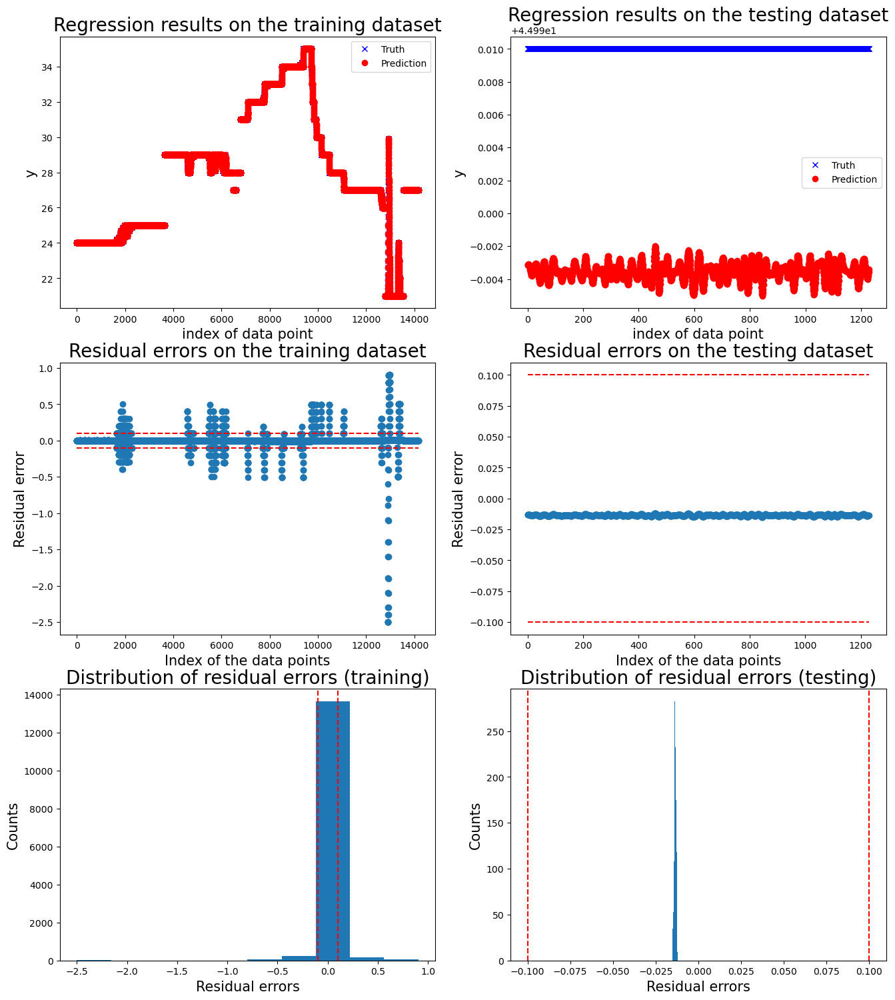

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:01<00:00,  1.04s/it]



 New run:

training performance, max error is: 1.503291077994966
training performance, mean root square error is: 0.11810921608697701
training performance, residual error > 0.9091194715905723: 0.09668063164679343%

 New run:

testing performance, max error is: 0.49498674811943744
testing performance, mean root square error is: 0.15054224281400236
testing performance, residual error > 0.9091194715905723: 0.0%


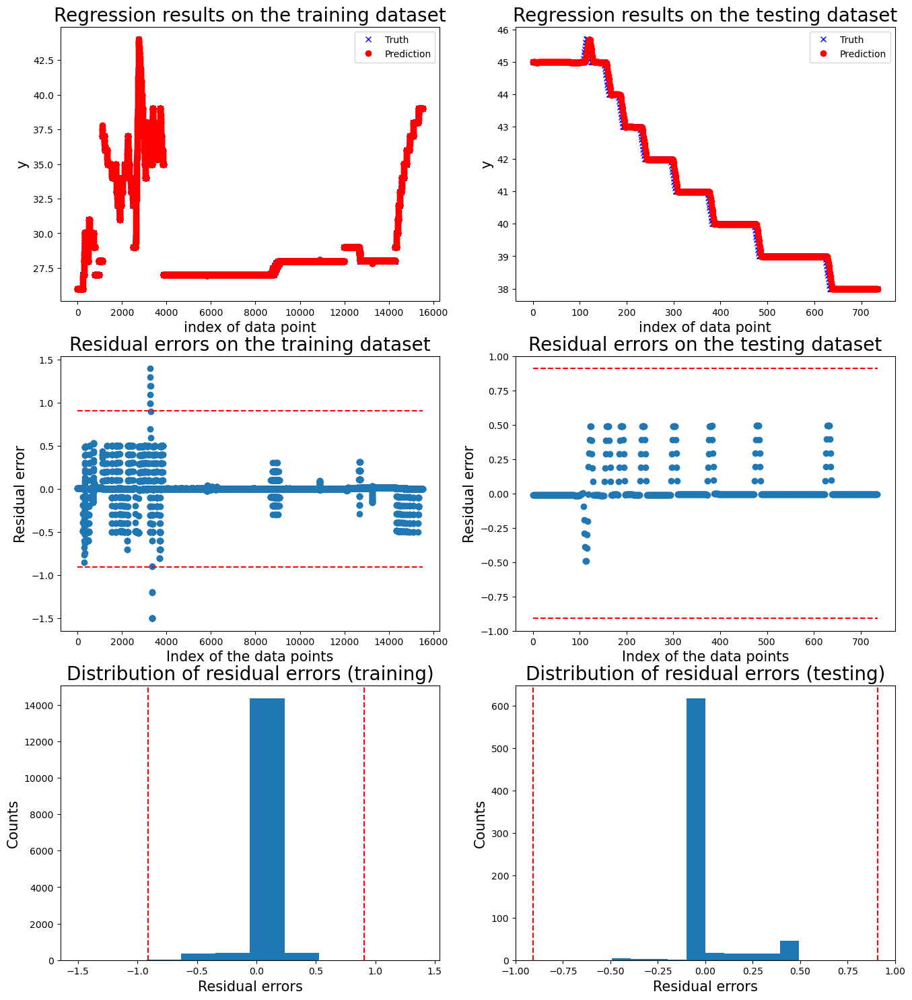

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.17s/it]



 New run:

training performance, max error is: 1.503291077994966
training performance, mean root square error is: 0.11810921608697701
training performance, residual error > 0.35: 4.3957460522075404%

 New run:

testing performance, max error is: 0.5024461921562207
testing performance, mean root square error is: 0.03926160921749753
testing performance, residual error > 0.35: 0.47303689687795647%


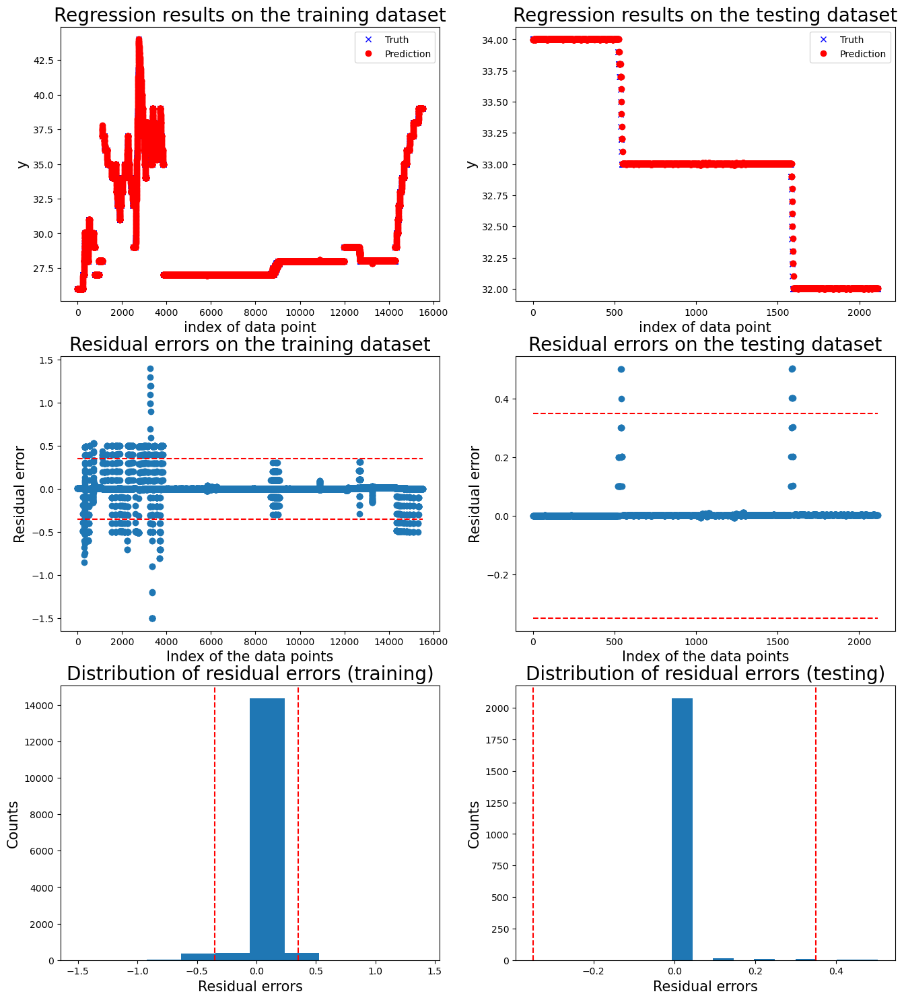

Motor  5
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.46s/it]



 New run:

training performance, max error is: 1.003580247590385
training performance, mean root square error is: 0.12197698532531824
training performance, residual error > 0.9076231436649242: 0.01747106355099367%

 New run:

testing performance, max error is: 0.5219170450195421
testing performance, mean root square error is: 0.1504586839077748
testing performance, residual error > 0.9076231436649242: 0.0%


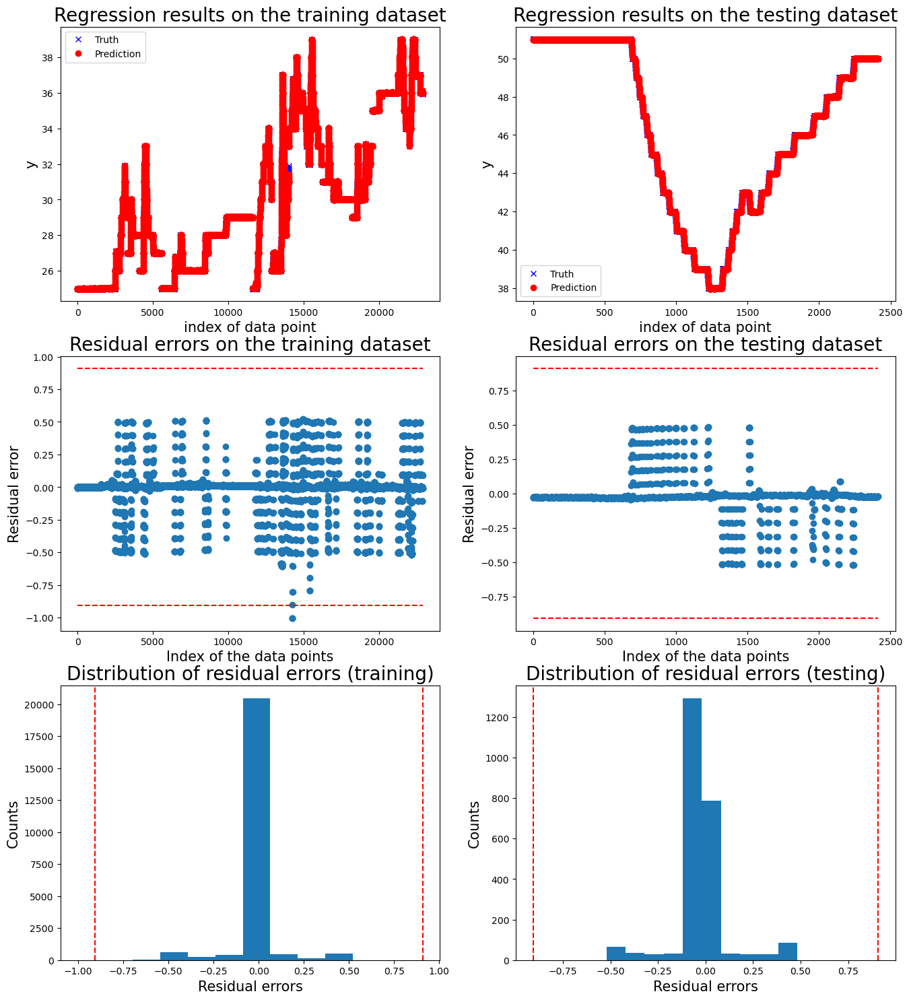

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:04<00:00,  4.64s/it]



 New run:

training performance, max error is: 1.003580247590385
training performance, mean root square error is: 0.12197698532531824
training performance, residual error > 1.1213201983378707: 0.0%

 New run:

testing performance, max error is: 1.3304195249886703
testing performance, mean root square error is: 0.22203673853701686
testing performance, residual error > 1.1213201983378707: 1.2586532410320956%


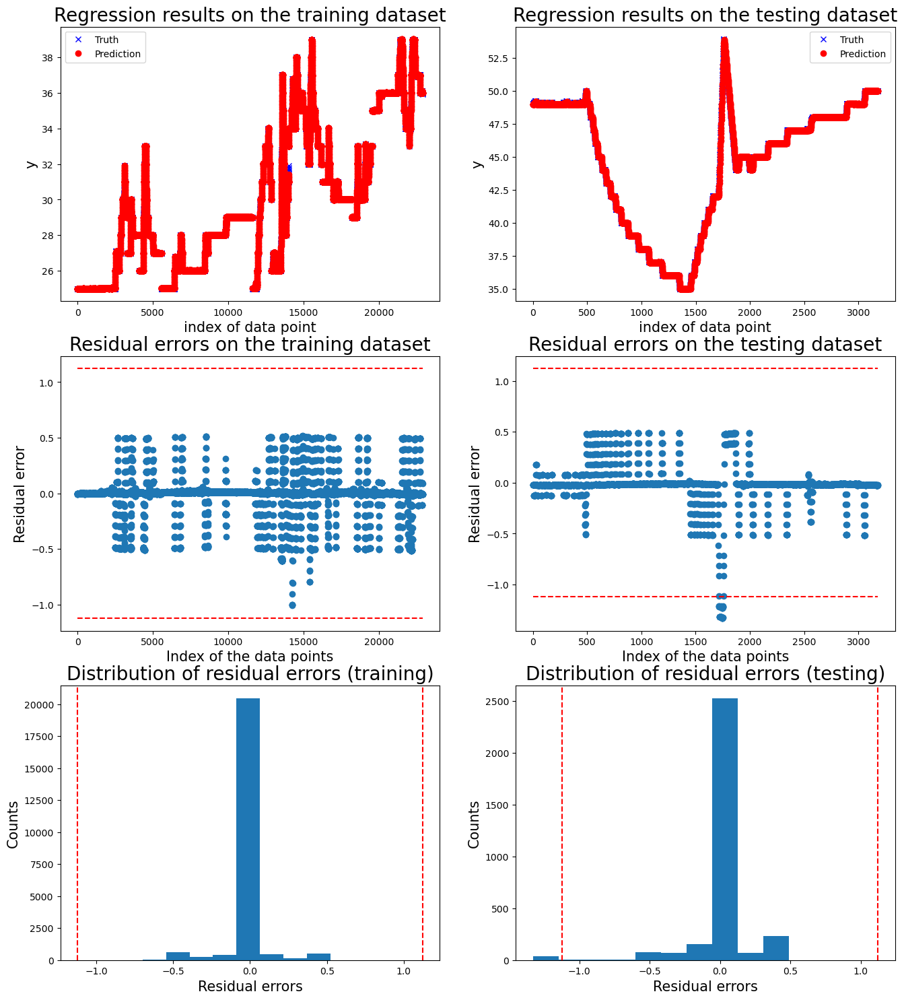

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.15s/it]



 New run:

training performance, max error is: 1.003580247590385
training performance, mean root square error is: 0.12197698532531824
training performance, residual error > 0.5669804464264244: 0.2882725485913955%

 New run:

testing performance, max error is: 0.5233583946582314
testing performance, mean root square error is: 0.09009449808938441
testing performance, residual error > 0.5669804464264244: 0.0%


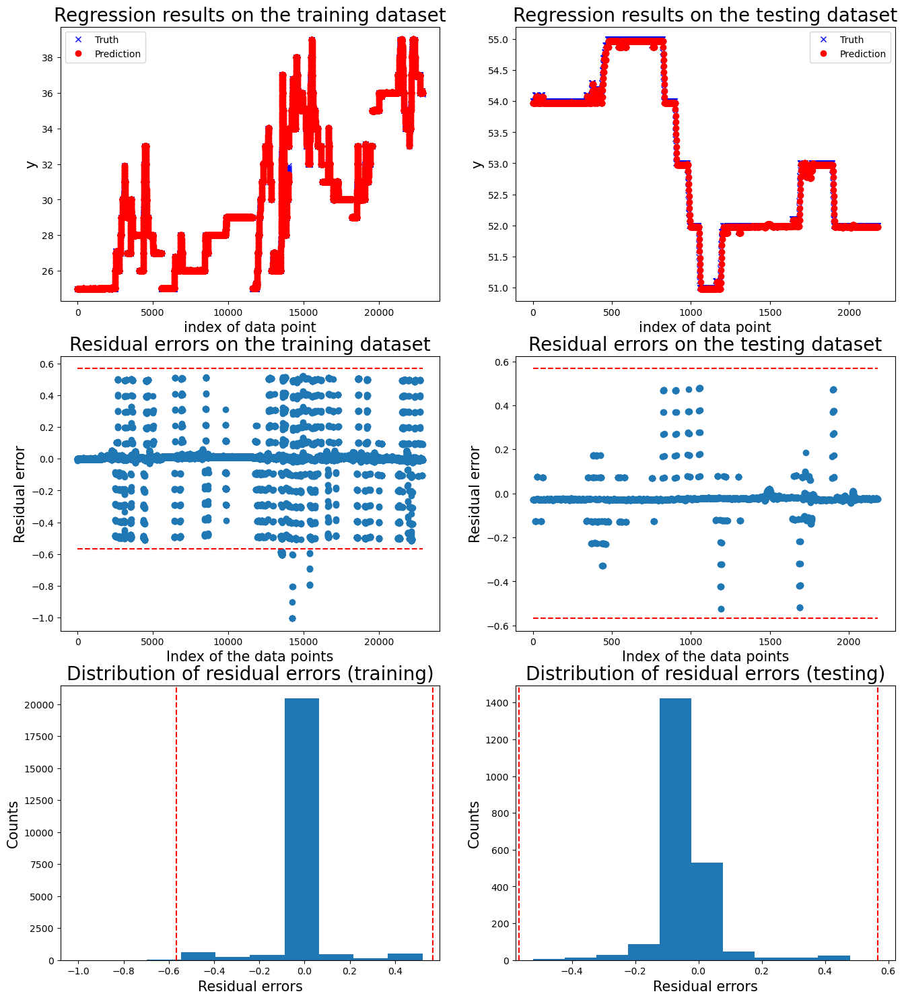

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.30s/it]



 New run:

training performance, max error is: 2.499171786202524
training performance, mean root square error is: 0.11615637385859279
training performance, residual error > 0.1: 7.3077737767422155%

 New run:

testing performance, max error is: 2.5248420375952207
testing performance, mean root square error is: 0.30383644087315037
testing performance, residual error > 0.1: 6.172839506172839%


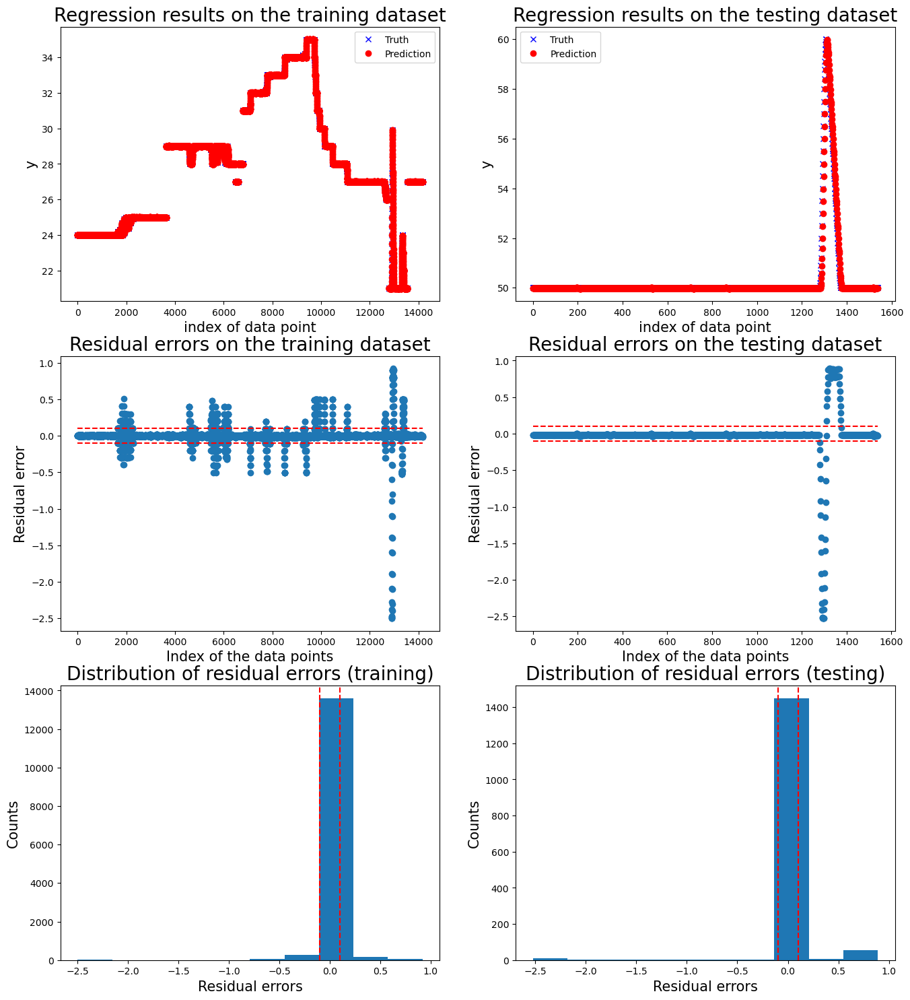

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:00<00:00,  1.23it/s]



 New run:

training performance, max error is: 2.499171786202524
training performance, mean root square error is: 0.11615637385859279
training performance, residual error > 0.1: 7.3077737767422155%

 New run:

testing performance, max error is: 0.03739599658173631
testing performance, mean root square error is: 0.018592279037834506
testing performance, residual error > 0.1: 0.0%


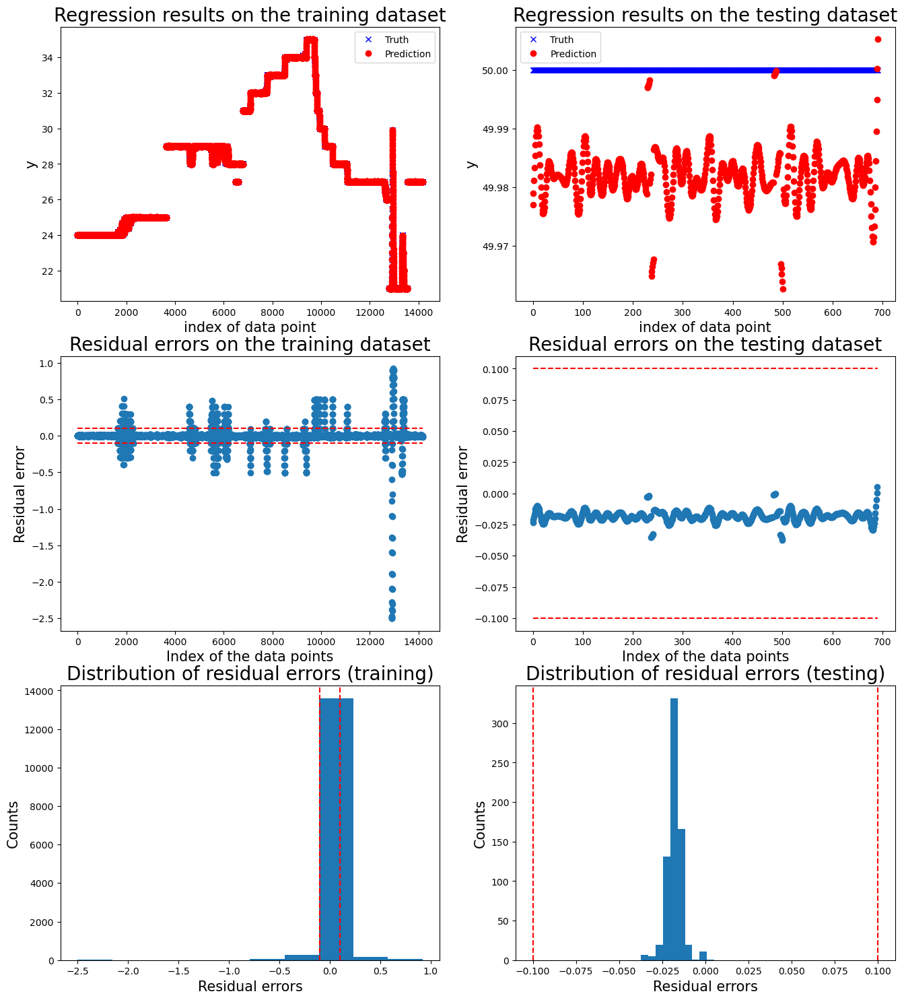

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.61s/it]



 New run:

training performance, max error is: 2.499171786202524
training performance, mean root square error is: 0.11615637385859279
training performance, residual error > 0.1: 7.3077737767422155%

 New run:

testing performance, max error is: 0.039639324922021046
testing performance, mean root square error is: 0.018546982881836725
testing performance, residual error > 0.1: 0.0%


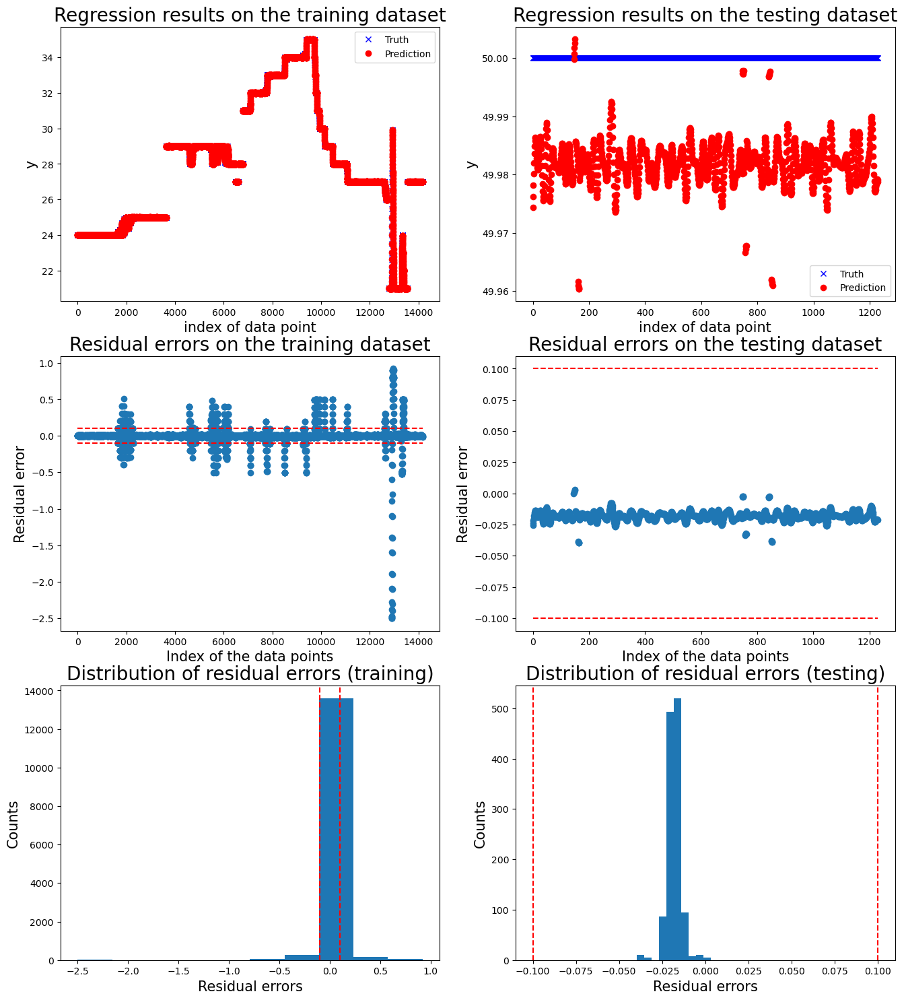

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:00<00:00,  1.19it/s]



 New run:

training performance, max error is: 1.5123492729860146
training performance, mean root square error is: 0.11748942866736338
training performance, residual error > 0.8411133278735982: 0.12246213341927166%

 New run:

testing performance, max error is: 0.4726519393779256
testing performance, mean root square error is: 0.1570183086158581
testing performance, residual error > 0.8411133278735982: 0.0%


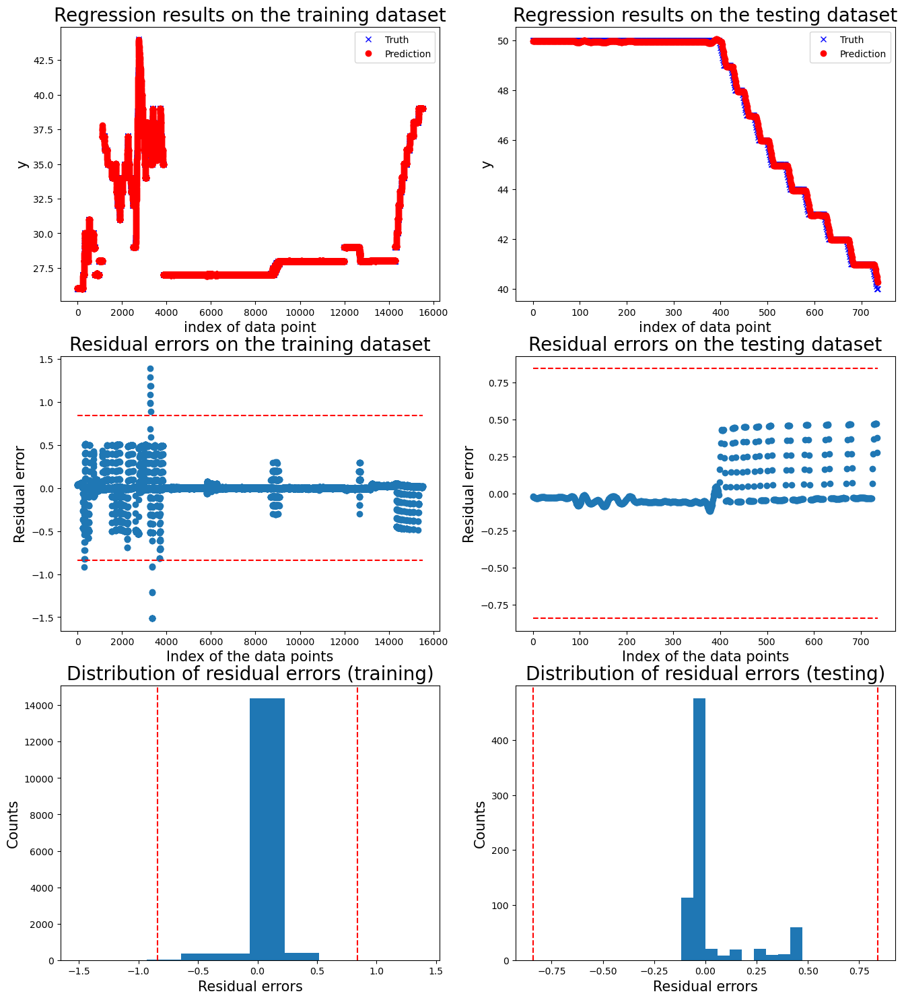

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.54s/it]



 New run:

training performance, max error is: 1.5123492729860146
training performance, mean root square error is: 0.11748942866736338
training performance, residual error > 0.5: 1.5211086045762165%

 New run:

testing performance, max error is: 0.49472590208532097
testing performance, mean root square error is: 0.0445540202785796
testing performance, residual error > 0.5: 0.0%


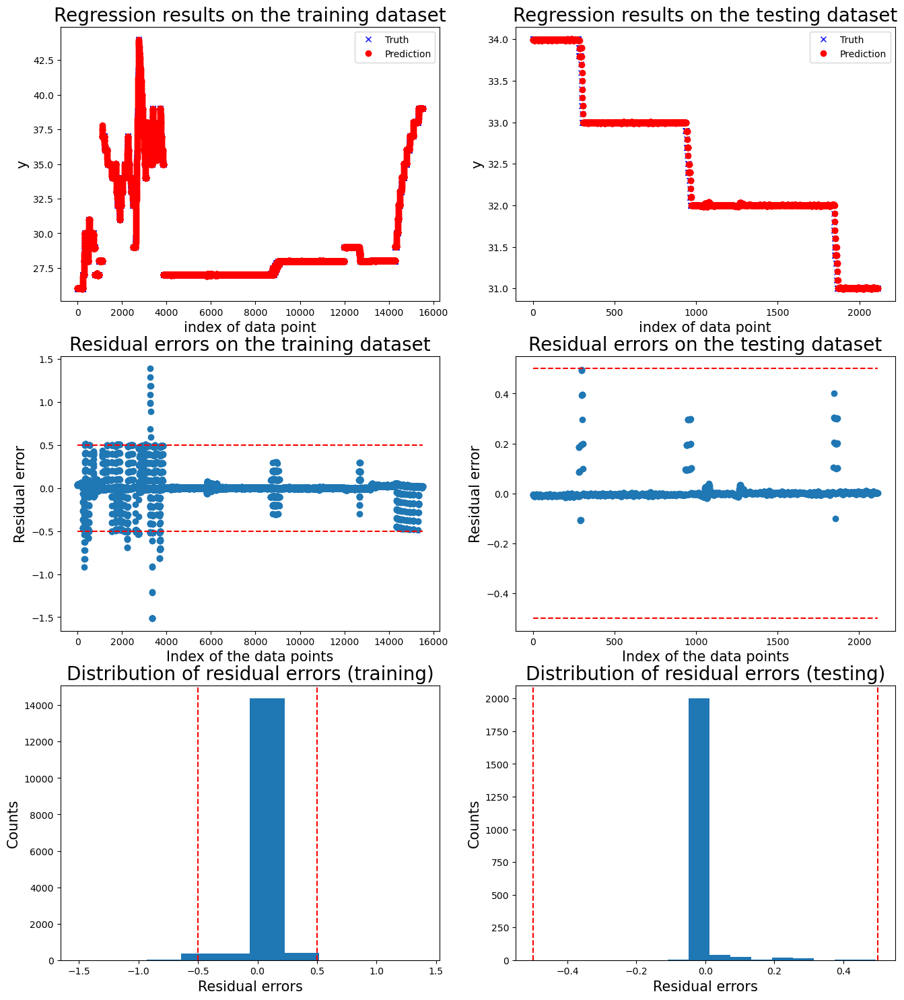

Motor  6
Operation:  Transfer goods
['20240527_094865']


100%|██████████| 1/1 [00:03<00:00,  3.76s/it]



 New run:

training performance, max error is: 1.0139225972142043
training performance, mean root square error is: 0.11206369297475288
training performance, residual error > 0.8463620218578458: 0.022983222247759134%

 New run:

testing performance, max error is: 0.6817857643023686
testing performance, mean root square error is: 0.14696969712366734
testing performance, residual error > 0.8463620218578458: 0.0%


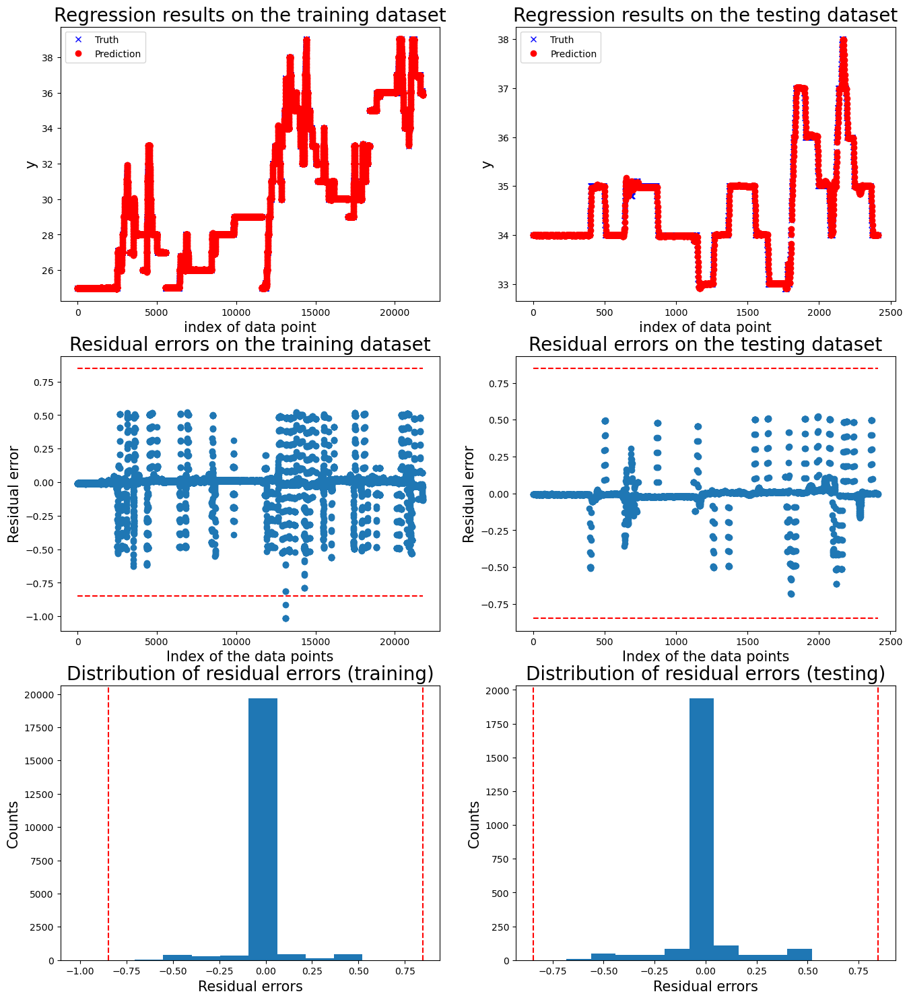

Operation:  Transfer goods
['20240527_100759']


100%|██████████| 1/1 [00:04<00:00,  4.82s/it]



 New run:

training performance, max error is: 1.0139225972142043
training performance, mean root square error is: 0.11206369297475288
training performance, residual error > 0.8010660857950836: 0.03217651114686279%

 New run:

testing performance, max error is: 0.8276056021427252
testing performance, mean root square error is: 0.11574695133932332
testing performance, residual error > 0.8010660857950836: 0.18879798615481436%


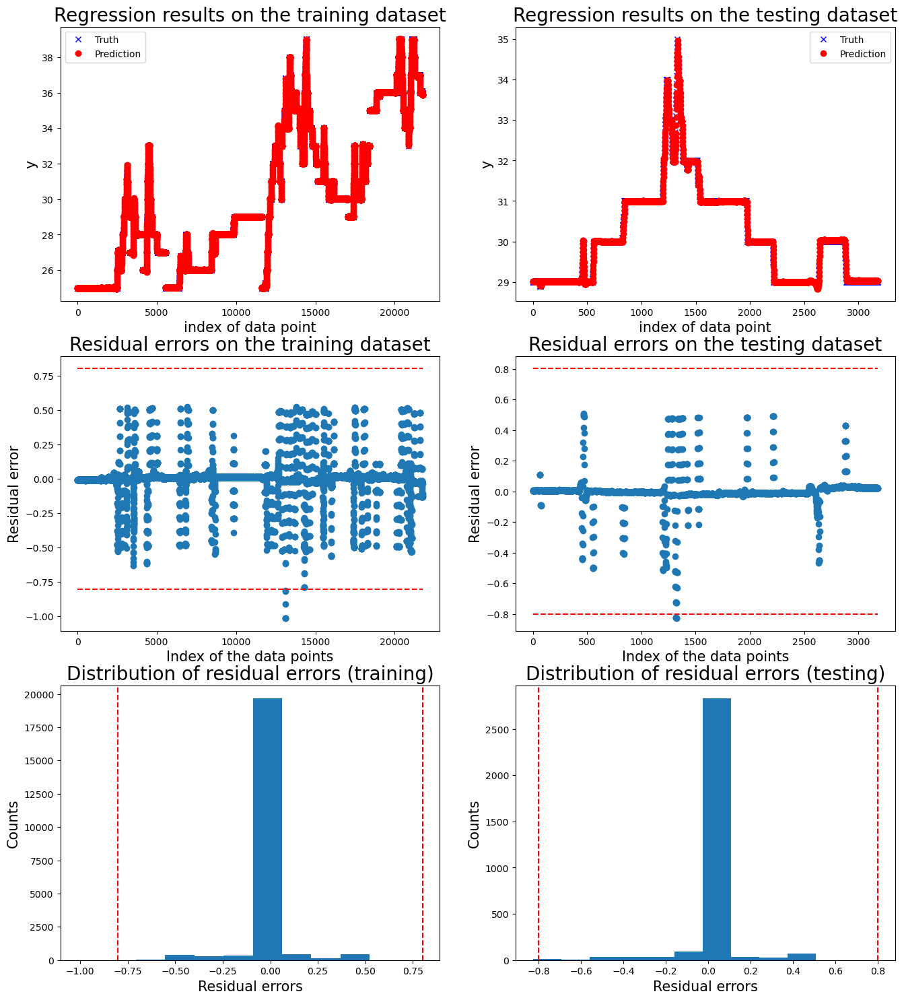

Operation:  Transfer goods
['20240527_101627']


100%|██████████| 1/1 [00:03<00:00,  3.42s/it]



 New run:

training performance, max error is: 1.0139225972142043
training performance, mean root square error is: 0.11206369297475288
training performance, residual error > 0.5: 1.0848080900942312%

 New run:

testing performance, max error is: 0.49970502471223455
testing performance, mean root square error is: 0.07163563890276765
testing performance, residual error > 0.5: 0.0%


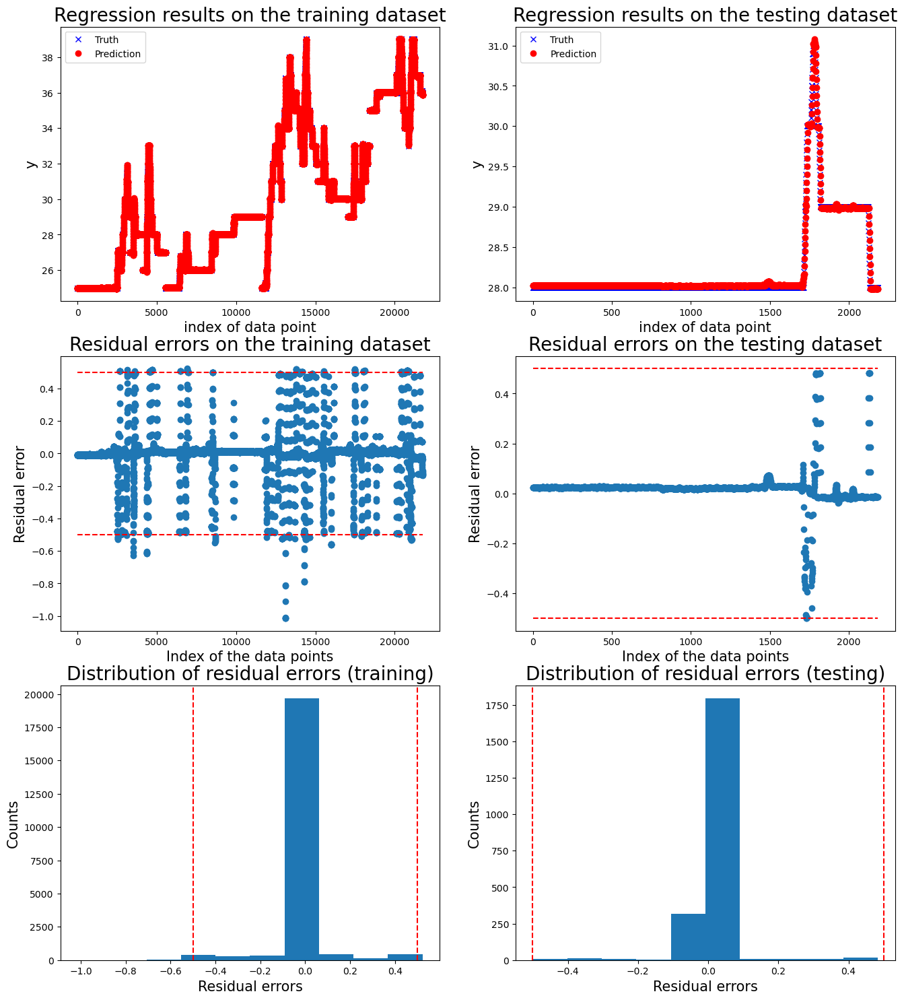

Operation:  Not moving
['20240527_102436']


100%|██████████| 1/1 [00:02<00:00,  2.45s/it]



 New run:

training performance, max error is: 0.5044669064234455
training performance, mean root square error is: 0.06344559242750678
training performance, residual error > 0.1: 6.474981329350261%

 New run:

testing performance, max error is: 1.397090530854129
testing performance, mean root square error is: 0.11154298928115647
testing performance, residual error > 0.1: 2.6640675763482777%


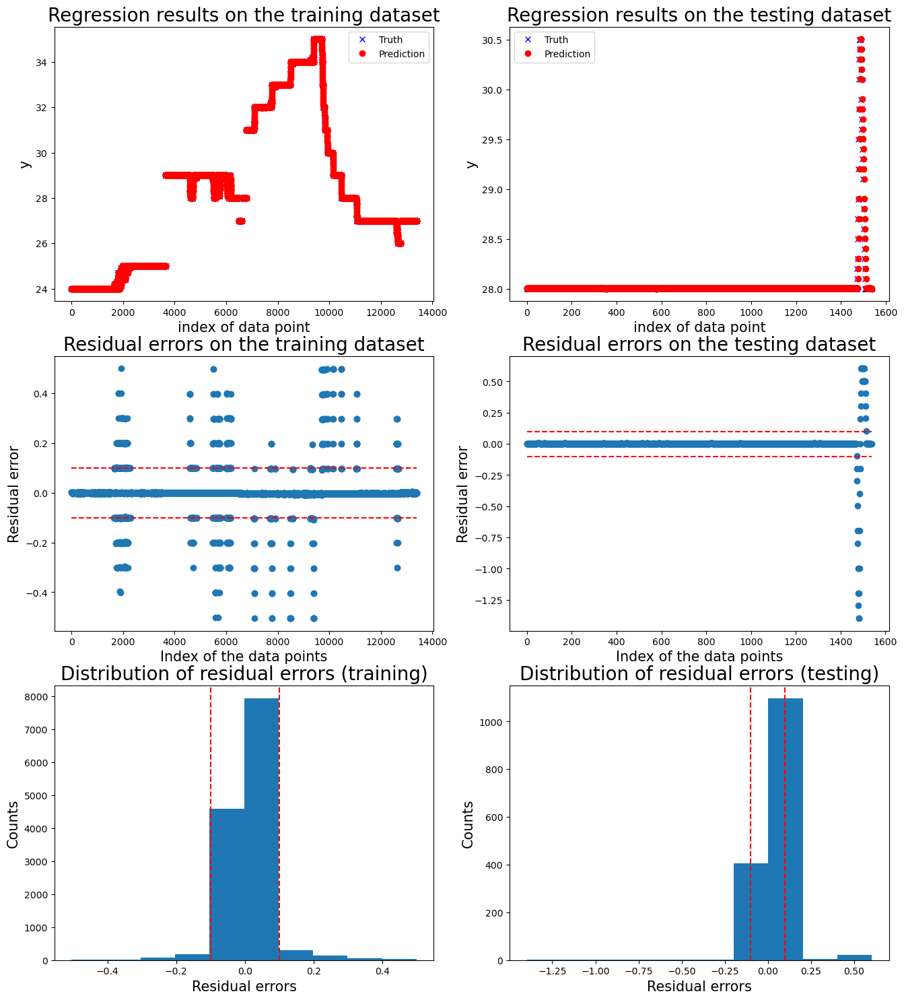

Operation:  Not moving
['20240527_102919']


100%|██████████| 1/1 [00:00<00:00,  1.30it/s]



 New run:

training performance, max error is: 0.5044669064234455
training performance, mean root square error is: 0.06344559242750678
training performance, residual error > 0.1: 6.474981329350261%

 New run:

testing performance, max error is: 2.4979967435210426
testing performance, mean root square error is: 0.458246471366383
testing performance, residual error > 0.1: 9.84081041968162%


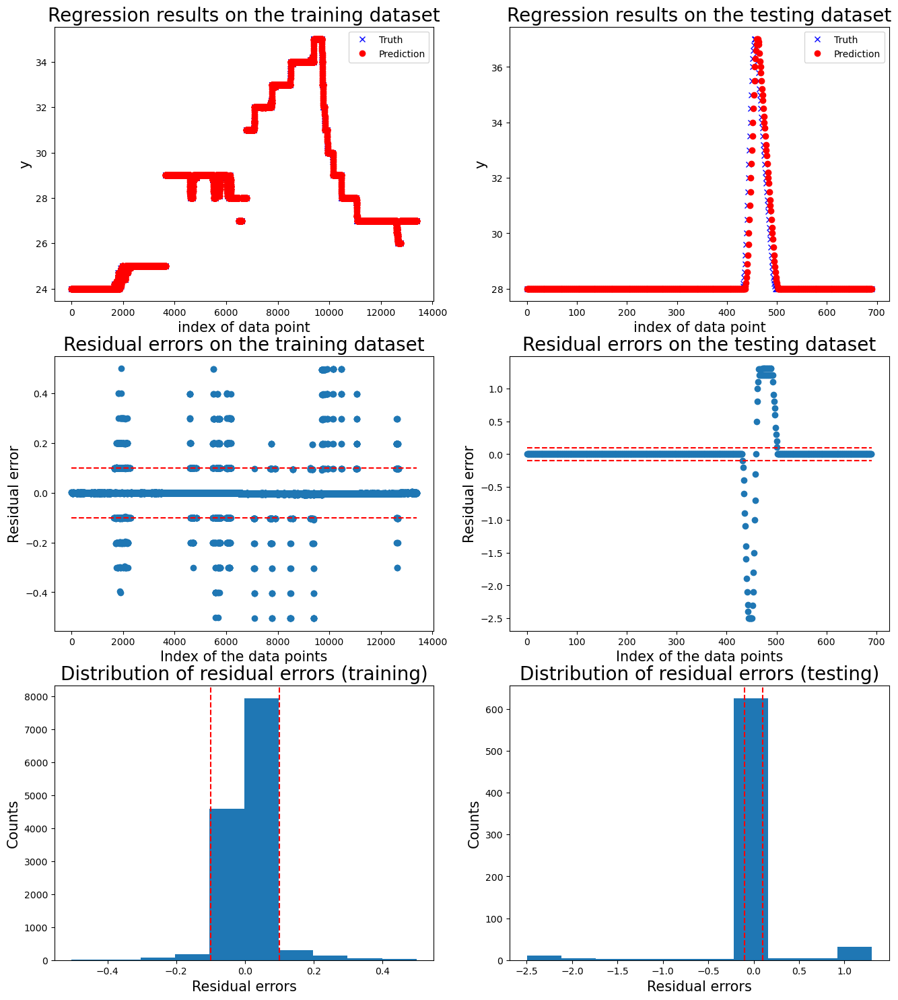

Operation:  Not moving
['20240527_103311']


100%|██████████| 1/1 [00:01<00:00,  1.74s/it]



 New run:

training performance, max error is: 0.5044669064234455
training performance, mean root square error is: 0.06344559242750678
training performance, residual error > 0.1: 6.474981329350261%

 New run:

testing performance, max error is: 0.0035726002712053173
testing performance, mean root square error is: 0.0030250815961194452
testing performance, residual error > 0.1: 0.0%


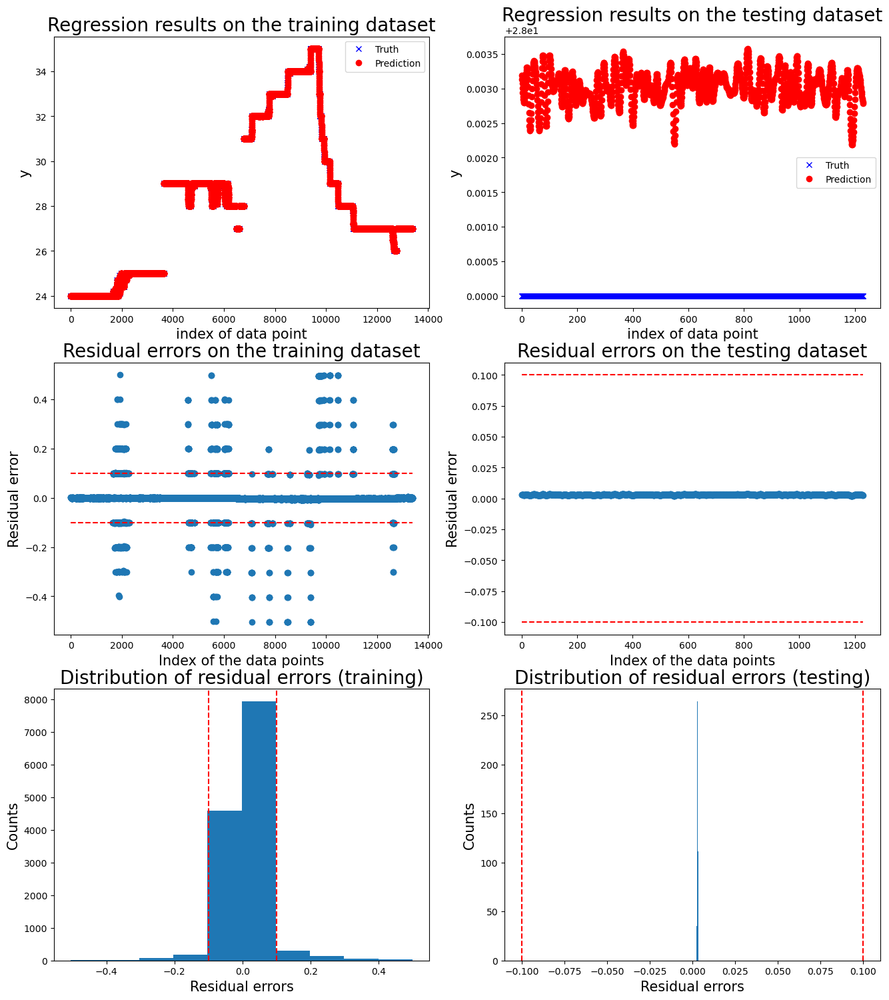

Operation:  Moving one motor
['20240527_103690']


100%|██████████| 1/1 [00:01<00:00,  1.15s/it]



 New run:

training performance, max error is: 0.828983628506414
training performance, mean root square error is: 0.07955105923957201
training performance, residual error > 1.3768878959819388: 0.0%

 New run:

testing performance, max error is: 1.7178914901026232
testing performance, mean root square error is: 0.3246734737642313
testing performance, residual error > 1.3768878959819388: 1.9021739130434785%


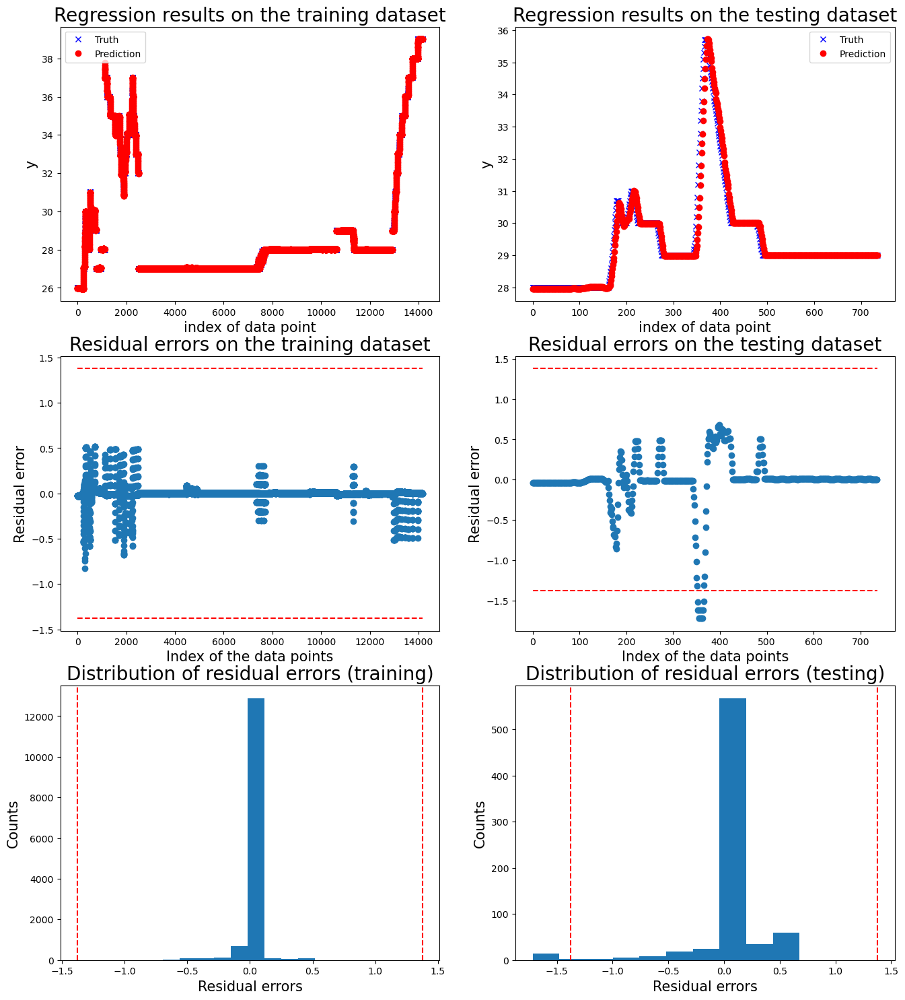

Operation:  Moving one motor
['20240527_104247']


100%|██████████| 1/1 [00:03<00:00,  3.53s/it]



 New run:

training performance, max error is: 0.828983628506414
training performance, mean root square error is: 0.07955105923957201
training performance, residual error > 0.5: 0.473264109627746%

 New run:

testing performance, max error is: 0.04972366303634601
testing performance, mean root square error is: 0.013395619901214486
testing performance, residual error > 0.5: 0.0%


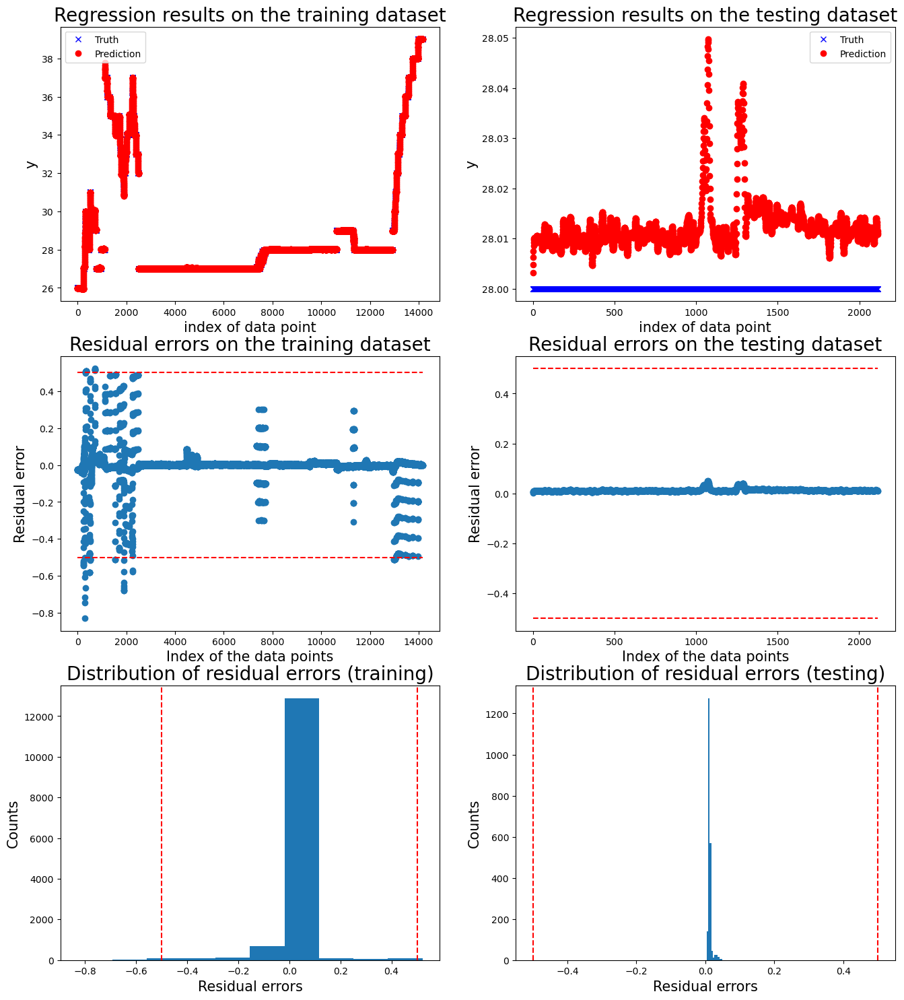

In [9]:
# Best Model New

df_best_dict = {}

# Motor 1

sys.path.insert(0, 'C:/Users/gioca/GitHub/projects/maintenance_industry_4_2024/supporting_scripts/WP_4_20240528/')
from utility import read_all_test_data_from_path, extract_selected_feature, prepare_sliding_window, FaultDetectReg, read_all_csvs_one_test, run_cv_one_motor, show_reg_result, show_clf_result

# Other motors

for motor_number in range(1, 7):
    print("Motor ", motor_number)
    
    df_best_x = pd.DataFrame(columns=['time', f'data_motor_{motor_number}_label', 'test_condition'])
    df_best_x['time'] = df_te['time']
    df_best_x['test_condition'] = df_te['test_condition']

    # Inizializzazione di all_results
    all_results = []

    train_conditions = find_train_conditions_for_motor_x(df_tr, motor_number)
    df_train_motor = df_tr[df_tr['test_condition'].isin(train_conditions)]
    df_test_motor = df_te.copy()

    for test in list_test_conditions:

        operation = test_conditions.loc[test_conditions['Test id'] == test, 'Description'].iloc[0]
        print("Operation: ", operation)

        df_train = df_train_motor[df_train_motor['operation']==operation]
        df_test = df_test_motor[df_test_motor['test_condition']==test]

        features_x = [f'data_motor_{motor_number}_position', f'data_motor_{motor_number}_voltage']

        tests = pd.unique(df_test.test_condition).tolist()
        print(tests)

        if (len(tests)!=0):

            winsiz = 10
            sampstep = 5

            if (motor_number == 1):
                winsiz = 8
                sampstep = 4
                threshold = 0.2
            elif (motor_number == 3):
                threshold = 0.7
            elif (motor_number == 4):
                threshold = 0.35
            else:
                threshold = 0.5
                
            if (operation == 'Not moving'):
                threshold = 0.1
            
            results = rbmodel(ds_training=df_train, ds_test=df_test, features_task=features_x, ws=winsiz, ss=sampstep, plt=1, thr=threshold, al=0.00000000000007, testid=tests, motor=motor_number)
            
            # Aggiungiamo il tempo ai risultati
            results_with_time = [(time, result) for time, result in zip(df_test['time'], results)]
            
            # Concateniamo i risultati a all_results
            all_results.extend(results_with_time)

    # Inseriamo i valori di all_results nella colonna corrispondente di df_best_x
    for time, result in all_results:
        df_best_x.loc[df_best_x['time'] == time, f'data_motor_{motor_number}_label'] = result

    # Dove non c'è corrispondenza, inseriamo 0
    df_best_x[f'data_motor_{motor_number}_label'].fillna(0, inplace=True)
    
    # Salviamo il DataFrame df_best_x nel dizionario df_pred_dict
    df_best_dict[motor_number] = df_best_x

df_best = df_best_dict[1][['time', 'test_condition']]
for i in range (1, 7):
    df_best[f'data_motor_{i}_label'] = df_best_dict[i][[f'data_motor_{i}_label']]

df_best.drop(columns=['time'], inplace=True)
df_best.reset_index(inplace=True)
df_best.rename(columns={'index': 'idx'}, inplace=True)
test_condition = df_best.pop('test_condition')
df_best['test_condition'] = test_condition
df_best.to_csv('df_best.csv', index=False)

The previous codes are the sources of the submitted datasets. The differences among the two are the following:
- We used two different approaches for motor 1: in the first we set a high value of abnormal limit while in the second a low one, also ws, ss and threshold are different;
- Considering motors [2, 6], in the first version we used the same approach for all the testing conditions, only differentiating the threshold motor by motor looking at the graphs. In the second approach we implemented a lower threshold value for the 'Not moving' condition.

# Results Observations

We notice how the parameters can change for different motors and operation mode. This is due to the fact that motors can have for example different behavoir in temperature change and in different operation mode. For example threshold in case of not moving has been set very low because is very easy to predict so a small change induces a failure. We also notice that abnormal limit is foundamental to predict temperature in normal condition because if we use the temperature of the abnormal data and window is significant is difficult to create a robust residual.

# Work Subdivision

We tried to work as much as possible together, especially when defining the approach. Once defined the strategy to adopt, to be quicker in running the experiments, we decided to split in two groups:

- Daniele and Ellen  worked on Motors 2, 6
- Giovanni, Marta and Giorgia worked on Motors 3, 4, 5

We kept updating each other, in order to let the whole group understand the possible improvements and provide the best final model. In particular, for the Motor 1, we tried a different approach, working all together and this resulted in the adoption of slightly different parameters. In the end, we compared each other once again, validating all the results.